<a href="https://colab.research.google.com/github/MarvinMartin24/GAN_FASHION_MNIST/blob/master/Fashion_Generator.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dependancies

In [0]:
import sys
print(sys.version)

# make sure to enable GPU acceleration!
device = 'cuda'

!pip3 install torch torchvision

3.6.7 (default, Oct 22 2018, 11:32:17) 
[GCC 8.2.0]


In [0]:
!apt-get install -y -qq software-properties-common module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}

Selecting previously unselected package google-drive-ocamlfuse.
(Reading database ... 130912 files and directories currently installed.)
Preparing to unpack .../google-drive-ocamlfuse_0.7.3-0ubuntu3~ubuntu18.04.1_amd64.deb ...
Unpacking google-drive-ocamlfuse (0.7.3-0ubuntu3~ubuntu18.04.1) ...
Setting up google-drive-ocamlfuse (0.7.3-0ubuntu3~ubuntu18.04.1) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...
Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&approval_prompt=force
··········
Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&acces

# Mount Google Drive

In [0]:
# Mount your google drive to access files from it 
!mkdir -p drive
!google-drive-ocamlfuse drive

import os
os.chdir("drive/DCGAN_FashionMNIST")

# Import packages

In [0]:
from __future__ import print_function
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
from torch import save
from torch import load

from torchvision.datasets import FashionMNIST
from torch.utils.data import DataLoader

import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from torchvision.utils import make_grid


print('PyTorch version:', torch.__version__)

PyTorch version: 1.1.0


# Load the datasets

In [0]:
batchSize = 64
imageSize = 28

# transform for the training data
transform = transforms.Compose([transforms.Resize(imageSize,imageSize),transforms.ToTensor(), transforms.Normalize(mean=[0.5], std=[0.5])])

# load datasets, downloading if needed
train_set = FashionMNIST('~/.pytorch/F_MNIST_data/', train=True, download=True, transform=transform)


  0%|          | 0/26421880 [00:00<?, ?it/s]

26427392it [00:00, 56560856.31it/s]                              


Extracting /root/.pytorch/F_MNIST_data/FashionMNIST/raw/train-images-idx3-ubyte.gz


32768it [00:00, 469547.68it/s]
  0%|          | 16384/4422102 [00:00<00:27, 162544.24it/s]

Extracting /root/.pytorch/F_MNIST_data/FashionMNIST/raw/train-labels-idx1-ubyte.gz


4423680it [00:00, 21406084.30it/s]                           
8192it [00:00, 189541.69it/s]


Extracting /root/.pytorch/F_MNIST_data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz
Extracting /root/.pytorch/F_MNIST_data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz
Processing...
Done!


In [0]:
print(train_set.train_data.shape)

torch.Size([60000, 28, 28])


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:53: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")


# Preview the data

/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:53: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")


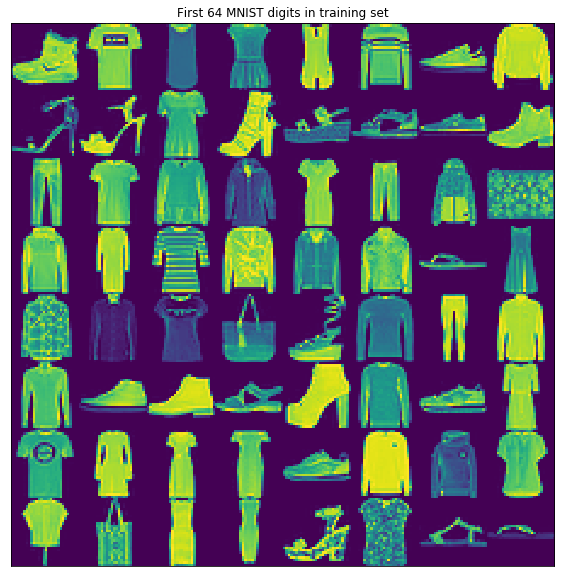

Labels: [9 0 0 3 0 2 7 2 5 5 0 9 5 5 7 9 1 0 6 4 3 1 4 8 4 3 0 2 4 4 5 3 6 6 0 8 5
 2 1 6 6 7 9 5 9 2 7 3 0 3 3 3 7 2 2 6 6 8 3 3 5 0 5 5]


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:43: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")


In [0]:
plt.figure(figsize=(10,10))

sample = train_set.train_data[:64]
# shape (64, 28, 28)
sample = sample.reshape(8,8,28,28)
# shape (8, 8, 28, 28)
sample = sample.permute(0,2,1,3)
# shape (8, 28, 8, 28)
sample = sample.reshape(8*28,8*28)
# shape (8*28, 8*28)
plt.imshow(sample)
plt.xticks([])
plt.yticks([])
plt.grid(False)
plt.title('First 64 MNIST digits in training set')
plt.show()

print('Labels:', train_set.train_labels[:64].numpy())

# Setup the data loaders

In [0]:
dataloader = DataLoader(train_set, batch_size=batchSize, shuffle=True, num_workers = 2)

# Weights Initialisation


In [0]:
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    m.weight.data.normal_(0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    m.weight.data.normal_(1.0, 0.02)
    m.bias.data.fill_(0)

# Generator Network

In [0]:
class G(nn.Module):
  
  def __init__(self):
    super(G, self).__init__()
    self.main = nn.Sequential(
            nn.Linear(100, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.ReLU(),
            nn.Linear(1024,(28*28)),
            nn.Tanh()
        )
    
  def forward(self, input):
    input = input.view(input.size(0), 100)
    output = self.main(input)
    return output.view(output.size(0), 28, 28)


In [0]:
netG = G().cuda()
netG.apply(weights_init)

G(
  (main): Sequential(
    (0): Linear(in_features=100, out_features=256, bias=True)
    (1): ReLU()
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): ReLU()
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): ReLU()
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Tanh()
  )
)

# Descriminator Network

In [0]:
class D(nn.Module):
  
  def __init__(self):
    super(D, self).__init__()
    self.main = nn.Sequential(
            nn.Linear((28*28), 1024),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(1024, 512),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()
  
        )
    
  def forward(self, input):
    input = input.view(input.size(0), 784)
    output = self.main(input)
    return output.squeeze()
 

In [0]:
netD = D().cuda()
netD.apply(weights_init)

D(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.2)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): ReLU()
    (5): Dropout(p=0.2)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): ReLU()
    (8): Dropout(p=0.2)
    (9): Linear(in_features=256, out_features=1, bias=True)
    (10): Sigmoid()
  )
)

# Train the DCGANs

In [0]:
criterion = nn.BCELoss().cuda()
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas =(0.5,0.999))
optimizerG =optim.Adam(netG.parameters(), lr=0.0002, betas =(0.5,0.999))

[Epoch 0/50] [Batch 0/938] [D loss: 1.396132] [G loss: 0.721037]


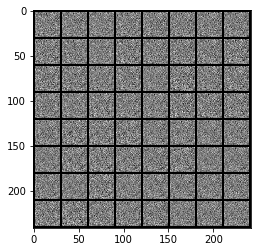

[Epoch 0/50] [Batch 1/938] [D loss: 1.312456] [G loss: 0.716663]
[Epoch 0/50] [Batch 2/938] [D loss: 1.249383] [G loss: 0.710730]
[Epoch 0/50] [Batch 3/938] [D loss: 1.155854] [G loss: 0.703701]
[Epoch 0/50] [Batch 4/938] [D loss: 1.086852] [G loss: 0.689079]
[Epoch 0/50] [Batch 5/938] [D loss: 1.003474] [G loss: 0.661849]
[Epoch 0/50] [Batch 6/938] [D loss: 0.947777] [G loss: 0.625886]
[Epoch 0/50] [Batch 7/938] [D loss: 0.960150] [G loss: 0.592462]
[Epoch 0/50] [Batch 8/938] [D loss: 1.010510] [G loss: 0.561965]
[Epoch 0/50] [Batch 9/938] [D loss: 1.070500] [G loss: 0.567677]
[Epoch 0/50] [Batch 10/938] [D loss: 1.085050] [G loss: 0.612858]
[Epoch 0/50] [Batch 11/938] [D loss: 1.053955] [G loss: 0.671499]
[Epoch 0/50] [Batch 12/938] [D loss: 1.008840] [G loss: 0.749922]
[Epoch 0/50] [Batch 13/938] [D loss: 0.984907] [G loss: 0.803324]
[Epoch 0/50] [Batch 14/938] [D loss: 0.942993] [G loss: 0.868098]
[Epoch 0/50] [Batch 15/938] [D loss: 0.955849] [G loss: 0.896402]
[Epoch 0/50] [Batch

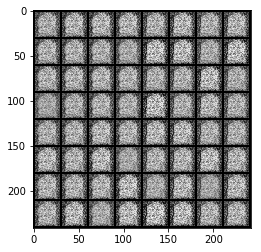

[Epoch 0/50] [Batch 201/938] [D loss: 0.861053] [G loss: 1.974381]
[Epoch 0/50] [Batch 202/938] [D loss: 1.050084] [G loss: 6.955638]
[Epoch 0/50] [Batch 203/938] [D loss: 0.163306] [G loss: 6.380087]
[Epoch 0/50] [Batch 204/938] [D loss: 0.081622] [G loss: 4.078070]
[Epoch 0/50] [Batch 205/938] [D loss: 0.272655] [G loss: 4.387035]
[Epoch 0/50] [Batch 206/938] [D loss: 0.204371] [G loss: 4.448883]
[Epoch 0/50] [Batch 207/938] [D loss: 0.314299] [G loss: 4.069749]
[Epoch 0/50] [Batch 208/938] [D loss: 0.661397] [G loss: 2.592798]
[Epoch 0/50] [Batch 209/938] [D loss: 0.560145] [G loss: 6.023608]
[Epoch 0/50] [Batch 210/938] [D loss: 0.246676] [G loss: 5.702751]
[Epoch 0/50] [Batch 211/938] [D loss: 0.272558] [G loss: 3.335771]
[Epoch 0/50] [Batch 212/938] [D loss: 0.304387] [G loss: 4.123471]
[Epoch 0/50] [Batch 213/938] [D loss: 0.162484] [G loss: 4.621478]
[Epoch 0/50] [Batch 214/938] [D loss: 0.191012] [G loss: 3.764008]
[Epoch 0/50] [Batch 215/938] [D loss: 0.272228] [G loss: 4.454

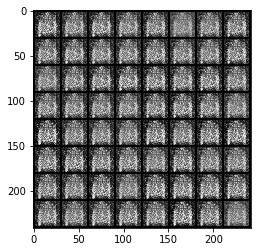

[Epoch 0/50] [Batch 401/938] [D loss: 0.476153] [G loss: 6.814131]
[Epoch 0/50] [Batch 402/938] [D loss: 0.403643] [G loss: 5.431479]
[Epoch 0/50] [Batch 403/938] [D loss: 0.557928] [G loss: 8.046117]
[Epoch 0/50] [Batch 404/938] [D loss: 0.492276] [G loss: 5.549121]
[Epoch 0/50] [Batch 405/938] [D loss: 0.754404] [G loss: 7.464652]
[Epoch 0/50] [Batch 406/938] [D loss: 0.425925] [G loss: 4.852017]
[Epoch 0/50] [Batch 407/938] [D loss: 0.667314] [G loss: 8.880493]
[Epoch 0/50] [Batch 408/938] [D loss: 1.581615] [G loss: 0.350426]
[Epoch 0/50] [Batch 409/938] [D loss: 2.751028] [G loss: 4.799835]
[Epoch 0/50] [Batch 410/938] [D loss: 0.132801] [G loss: 7.091824]
[Epoch 0/50] [Batch 411/938] [D loss: 0.537176] [G loss: 3.962552]
[Epoch 0/50] [Batch 412/938] [D loss: 0.337572] [G loss: 2.133232]
[Epoch 0/50] [Batch 413/938] [D loss: 0.770885] [G loss: 5.573709]
[Epoch 0/50] [Batch 414/938] [D loss: 0.663384] [G loss: 3.326761]
[Epoch 0/50] [Batch 415/938] [D loss: 0.434005] [G loss: 3.320

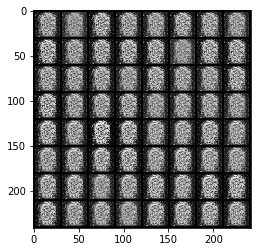

[Epoch 0/50] [Batch 601/938] [D loss: 0.517943] [G loss: 3.393431]
[Epoch 0/50] [Batch 602/938] [D loss: 0.446320] [G loss: 4.143561]
[Epoch 0/50] [Batch 603/938] [D loss: 0.231846] [G loss: 4.566396]
[Epoch 0/50] [Batch 604/938] [D loss: 0.240532] [G loss: 3.942022]
[Epoch 0/50] [Batch 605/938] [D loss: 0.339054] [G loss: 3.930371]
[Epoch 0/50] [Batch 606/938] [D loss: 0.321275] [G loss: 4.391089]
[Epoch 0/50] [Batch 607/938] [D loss: 0.336696] [G loss: 3.838677]
[Epoch 0/50] [Batch 608/938] [D loss: 0.649375] [G loss: 3.883896]
[Epoch 0/50] [Batch 609/938] [D loss: 0.356601] [G loss: 4.130296]
[Epoch 0/50] [Batch 610/938] [D loss: 0.524709] [G loss: 3.214840]
[Epoch 0/50] [Batch 611/938] [D loss: 0.416724] [G loss: 4.912768]
[Epoch 0/50] [Batch 612/938] [D loss: 0.485853] [G loss: 3.616277]
[Epoch 0/50] [Batch 613/938] [D loss: 0.337267] [G loss: 4.119993]
[Epoch 0/50] [Batch 614/938] [D loss: 0.275545] [G loss: 4.720551]
[Epoch 0/50] [Batch 615/938] [D loss: 0.445530] [G loss: 3.206

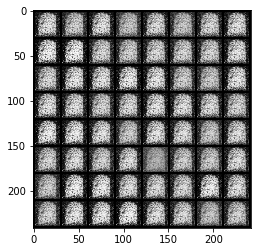

[Epoch 0/50] [Batch 801/938] [D loss: 0.281417] [G loss: 3.610136]
[Epoch 0/50] [Batch 802/938] [D loss: 0.322983] [G loss: 3.253333]
[Epoch 0/50] [Batch 803/938] [D loss: 0.240066] [G loss: 4.060081]
[Epoch 0/50] [Batch 804/938] [D loss: 0.126743] [G loss: 4.519757]
[Epoch 0/50] [Batch 805/938] [D loss: 0.147348] [G loss: 3.995682]
[Epoch 0/50] [Batch 806/938] [D loss: 0.281172] [G loss: 3.265892]
[Epoch 0/50] [Batch 807/938] [D loss: 0.373401] [G loss: 4.357328]
[Epoch 0/50] [Batch 808/938] [D loss: 0.314214] [G loss: 3.938107]
[Epoch 0/50] [Batch 809/938] [D loss: 0.287820] [G loss: 4.020544]
[Epoch 0/50] [Batch 810/938] [D loss: 0.407190] [G loss: 4.110322]
[Epoch 0/50] [Batch 811/938] [D loss: 0.297203] [G loss: 3.751244]
[Epoch 0/50] [Batch 812/938] [D loss: 0.259074] [G loss: 5.027303]
[Epoch 0/50] [Batch 813/938] [D loss: 0.087561] [G loss: 5.240090]
[Epoch 0/50] [Batch 814/938] [D loss: 0.269438] [G loss: 4.320647]
[Epoch 0/50] [Batch 815/938] [D loss: 0.222678] [G loss: 3.819

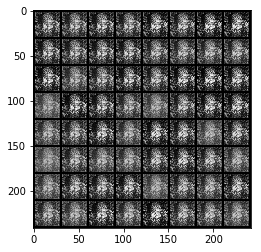

[Epoch 1/50] [Batch 1/938] [D loss: 0.368584] [G loss: 4.011224]
[Epoch 1/50] [Batch 2/938] [D loss: 0.341644] [G loss: 5.117597]
[Epoch 1/50] [Batch 3/938] [D loss: 0.280708] [G loss: 3.578875]
[Epoch 1/50] [Batch 4/938] [D loss: 0.383078] [G loss: 5.253228]
[Epoch 1/50] [Batch 5/938] [D loss: 0.413897] [G loss: 3.764706]
[Epoch 1/50] [Batch 6/938] [D loss: 0.479267] [G loss: 4.256653]
[Epoch 1/50] [Batch 7/938] [D loss: 0.473592] [G loss: 4.244441]
[Epoch 1/50] [Batch 8/938] [D loss: 0.449947] [G loss: 3.030088]
[Epoch 1/50] [Batch 9/938] [D loss: 0.899024] [G loss: 3.034601]
[Epoch 1/50] [Batch 10/938] [D loss: 0.484264] [G loss: 4.405743]
[Epoch 1/50] [Batch 11/938] [D loss: 0.435632] [G loss: 3.426215]
[Epoch 1/50] [Batch 12/938] [D loss: 0.479428] [G loss: 3.143618]
[Epoch 1/50] [Batch 13/938] [D loss: 0.394220] [G loss: 3.597607]
[Epoch 1/50] [Batch 14/938] [D loss: 0.426046] [G loss: 3.189747]
[Epoch 1/50] [Batch 15/938] [D loss: 0.376262] [G loss: 3.220601]
[Epoch 1/50] [Batch

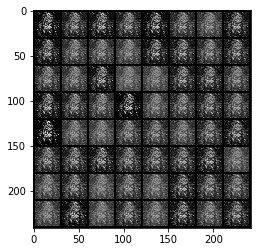

[Epoch 1/50] [Batch 201/938] [D loss: 0.446240] [G loss: 5.780457]
[Epoch 1/50] [Batch 202/938] [D loss: 0.435782] [G loss: 4.881422]
[Epoch 1/50] [Batch 203/938] [D loss: 0.170030] [G loss: 3.348057]
[Epoch 1/50] [Batch 204/938] [D loss: 0.214808] [G loss: 3.542040]
[Epoch 1/50] [Batch 205/938] [D loss: 0.133516] [G loss: 3.812213]
[Epoch 1/50] [Batch 206/938] [D loss: 0.115757] [G loss: 3.787698]
[Epoch 1/50] [Batch 207/938] [D loss: 0.112521] [G loss: 4.083067]
[Epoch 1/50] [Batch 208/938] [D loss: 0.132347] [G loss: 4.306510]
[Epoch 1/50] [Batch 209/938] [D loss: 0.229022] [G loss: 3.509299]
[Epoch 1/50] [Batch 210/938] [D loss: 0.213003] [G loss: 4.514774]
[Epoch 1/50] [Batch 211/938] [D loss: 0.193697] [G loss: 3.904999]
[Epoch 1/50] [Batch 212/938] [D loss: 0.207255] [G loss: 3.350516]
[Epoch 1/50] [Batch 213/938] [D loss: 0.235132] [G loss: 4.636971]
[Epoch 1/50] [Batch 214/938] [D loss: 0.328379] [G loss: 2.616086]
[Epoch 1/50] [Batch 215/938] [D loss: 0.356020] [G loss: 6.232

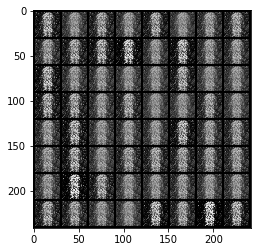

[Epoch 1/50] [Batch 401/938] [D loss: 0.166227] [G loss: 3.248486]
[Epoch 1/50] [Batch 402/938] [D loss: 0.285556] [G loss: 4.473601]
[Epoch 1/50] [Batch 403/938] [D loss: 0.141849] [G loss: 3.670824]
[Epoch 1/50] [Batch 404/938] [D loss: 0.080305] [G loss: 3.703250]
[Epoch 1/50] [Batch 405/938] [D loss: 0.100135] [G loss: 3.726266]
[Epoch 1/50] [Batch 406/938] [D loss: 0.078079] [G loss: 4.160315]
[Epoch 1/50] [Batch 407/938] [D loss: 0.151602] [G loss: 3.510901]
[Epoch 1/50] [Batch 408/938] [D loss: 0.152706] [G loss: 4.434755]
[Epoch 1/50] [Batch 409/938] [D loss: 0.167890] [G loss: 3.736833]
[Epoch 1/50] [Batch 410/938] [D loss: 0.151217] [G loss: 4.961133]
[Epoch 1/50] [Batch 411/938] [D loss: 0.093127] [G loss: 4.787815]
[Epoch 1/50] [Batch 412/938] [D loss: 0.240386] [G loss: 2.917403]
[Epoch 1/50] [Batch 413/938] [D loss: 0.207930] [G loss: 4.790800]
[Epoch 1/50] [Batch 414/938] [D loss: 0.056201] [G loss: 5.066721]
[Epoch 1/50] [Batch 415/938] [D loss: 0.097202] [G loss: 4.243

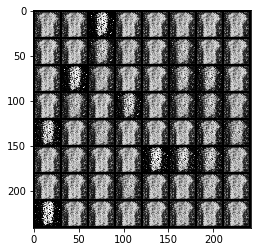

[Epoch 1/50] [Batch 601/938] [D loss: 0.185152] [G loss: 7.193089]
[Epoch 1/50] [Batch 602/938] [D loss: 0.412771] [G loss: 6.083705]
[Epoch 1/50] [Batch 603/938] [D loss: 0.182360] [G loss: 4.844534]
[Epoch 1/50] [Batch 604/938] [D loss: 0.247157] [G loss: 3.453901]
[Epoch 1/50] [Batch 605/938] [D loss: 0.439313] [G loss: 8.313890]
[Epoch 1/50] [Batch 606/938] [D loss: 0.322298] [G loss: 8.245558]
[Epoch 1/50] [Batch 607/938] [D loss: 0.574749] [G loss: 5.496821]
[Epoch 1/50] [Batch 608/938] [D loss: 0.314469] [G loss: 4.242733]
[Epoch 1/50] [Batch 609/938] [D loss: 0.123767] [G loss: 4.121334]
[Epoch 1/50] [Batch 610/938] [D loss: 0.165839] [G loss: 5.275086]
[Epoch 1/50] [Batch 611/938] [D loss: 0.054507] [G loss: 5.578693]
[Epoch 1/50] [Batch 612/938] [D loss: 0.264832] [G loss: 3.490705]
[Epoch 1/50] [Batch 613/938] [D loss: 0.312504] [G loss: 4.090352]
[Epoch 1/50] [Batch 614/938] [D loss: 0.296784] [G loss: 4.260223]
[Epoch 1/50] [Batch 615/938] [D loss: 0.121473] [G loss: 4.983

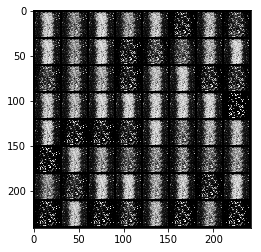

[Epoch 1/50] [Batch 801/938] [D loss: 0.289701] [G loss: 6.623849]
[Epoch 1/50] [Batch 802/938] [D loss: 0.228537] [G loss: 4.714798]
[Epoch 1/50] [Batch 803/938] [D loss: 0.199769] [G loss: 6.861096]
[Epoch 1/50] [Batch 804/938] [D loss: 0.132645] [G loss: 5.538084]
[Epoch 1/50] [Batch 805/938] [D loss: 0.258488] [G loss: 5.007384]
[Epoch 1/50] [Batch 806/938] [D loss: 0.133297] [G loss: 5.976090]
[Epoch 1/50] [Batch 807/938] [D loss: 0.073245] [G loss: 6.597041]
[Epoch 1/50] [Batch 808/938] [D loss: 0.171189] [G loss: 4.273513]
[Epoch 1/50] [Batch 809/938] [D loss: 0.225743] [G loss: 9.537903]
[Epoch 1/50] [Batch 810/938] [D loss: 0.633861] [G loss: 4.820995]
[Epoch 1/50] [Batch 811/938] [D loss: 0.183323] [G loss: 2.776817]
[Epoch 1/50] [Batch 812/938] [D loss: 0.445600] [G loss: 10.158037]
[Epoch 1/50] [Batch 813/938] [D loss: 0.846940] [G loss: 7.547374]
[Epoch 1/50] [Batch 814/938] [D loss: 0.465925] [G loss: 3.900566]
[Epoch 1/50] [Batch 815/938] [D loss: 0.122258] [G loss: 3.37

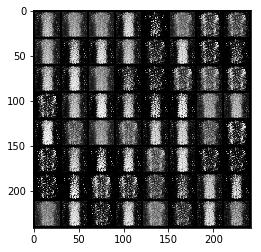

[Epoch 2/50] [Batch 1/938] [D loss: 0.190807] [G loss: 4.314748]
[Epoch 2/50] [Batch 2/938] [D loss: 0.236134] [G loss: 3.783921]
[Epoch 2/50] [Batch 3/938] [D loss: 0.289022] [G loss: 3.766443]
[Epoch 2/50] [Batch 4/938] [D loss: 0.317968] [G loss: 5.942453]
[Epoch 2/50] [Batch 5/938] [D loss: 0.456356] [G loss: 4.138227]
[Epoch 2/50] [Batch 6/938] [D loss: 0.323376] [G loss: 3.778505]
[Epoch 2/50] [Batch 7/938] [D loss: 0.382279] [G loss: 4.778998]
[Epoch 2/50] [Batch 8/938] [D loss: 0.328769] [G loss: 4.623392]
[Epoch 2/50] [Batch 9/938] [D loss: 0.433663] [G loss: 3.147795]
[Epoch 2/50] [Batch 10/938] [D loss: 0.460654] [G loss: 5.290063]
[Epoch 2/50] [Batch 11/938] [D loss: 0.282551] [G loss: 4.791742]
[Epoch 2/50] [Batch 12/938] [D loss: 0.321056] [G loss: 2.724134]
[Epoch 2/50] [Batch 13/938] [D loss: 0.298980] [G loss: 6.204062]
[Epoch 2/50] [Batch 14/938] [D loss: 0.566828] [G loss: 4.658768]
[Epoch 2/50] [Batch 15/938] [D loss: 0.279562] [G loss: 3.875042]
[Epoch 2/50] [Batch

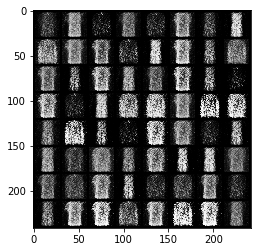

[Epoch 2/50] [Batch 201/938] [D loss: 0.364603] [G loss: 2.707774]
[Epoch 2/50] [Batch 202/938] [D loss: 0.467299] [G loss: 4.450341]
[Epoch 2/50] [Batch 203/938] [D loss: 0.761182] [G loss: 2.575116]
[Epoch 2/50] [Batch 204/938] [D loss: 0.439847] [G loss: 5.229420]
[Epoch 2/50] [Batch 205/938] [D loss: 0.588210] [G loss: 3.587453]
[Epoch 2/50] [Batch 206/938] [D loss: 0.214289] [G loss: 3.219925]
[Epoch 2/50] [Batch 207/938] [D loss: 0.578915] [G loss: 3.722807]
[Epoch 2/50] [Batch 208/938] [D loss: 0.370861] [G loss: 3.385759]
[Epoch 2/50] [Batch 209/938] [D loss: 0.422984] [G loss: 2.733491]
[Epoch 2/50] [Batch 210/938] [D loss: 0.415821] [G loss: 3.212301]
[Epoch 2/50] [Batch 211/938] [D loss: 0.340938] [G loss: 3.432427]
[Epoch 2/50] [Batch 212/938] [D loss: 0.241242] [G loss: 3.466409]
[Epoch 2/50] [Batch 213/938] [D loss: 0.433307] [G loss: 3.722450]
[Epoch 2/50] [Batch 214/938] [D loss: 0.389084] [G loss: 2.851344]
[Epoch 2/50] [Batch 215/938] [D loss: 0.392669] [G loss: 3.908

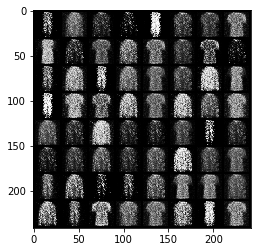

[Epoch 2/50] [Batch 401/938] [D loss: 0.323449] [G loss: 2.811488]
[Epoch 2/50] [Batch 402/938] [D loss: 0.306567] [G loss: 2.582346]
[Epoch 2/50] [Batch 403/938] [D loss: 0.331290] [G loss: 3.053100]
[Epoch 2/50] [Batch 404/938] [D loss: 0.288464] [G loss: 3.195412]
[Epoch 2/50] [Batch 405/938] [D loss: 0.488155] [G loss: 2.527612]
[Epoch 2/50] [Batch 406/938] [D loss: 0.530876] [G loss: 2.852674]
[Epoch 2/50] [Batch 407/938] [D loss: 0.381954] [G loss: 2.690435]
[Epoch 2/50] [Batch 408/938] [D loss: 0.347129] [G loss: 2.984939]
[Epoch 2/50] [Batch 409/938] [D loss: 0.387264] [G loss: 2.945219]
[Epoch 2/50] [Batch 410/938] [D loss: 0.407740] [G loss: 2.696099]
[Epoch 2/50] [Batch 411/938] [D loss: 0.376859] [G loss: 3.063467]
[Epoch 2/50] [Batch 412/938] [D loss: 0.454347] [G loss: 2.935221]
[Epoch 2/50] [Batch 413/938] [D loss: 0.395784] [G loss: 2.241152]
[Epoch 2/50] [Batch 414/938] [D loss: 0.425170] [G loss: 3.780267]
[Epoch 2/50] [Batch 415/938] [D loss: 0.381552] [G loss: 2.694

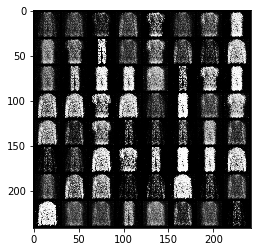

[Epoch 2/50] [Batch 601/938] [D loss: 0.448631] [G loss: 1.966256]
[Epoch 2/50] [Batch 602/938] [D loss: 0.517616] [G loss: 4.135023]
[Epoch 2/50] [Batch 603/938] [D loss: 0.471060] [G loss: 3.880899]
[Epoch 2/50] [Batch 604/938] [D loss: 0.497105] [G loss: 3.256577]
[Epoch 2/50] [Batch 605/938] [D loss: 0.511845] [G loss: 2.692527]
[Epoch 2/50] [Batch 606/938] [D loss: 0.437275] [G loss: 2.113799]
[Epoch 2/50] [Batch 607/938] [D loss: 0.437664] [G loss: 3.412838]
[Epoch 2/50] [Batch 608/938] [D loss: 0.320776] [G loss: 3.336977]
[Epoch 2/50] [Batch 609/938] [D loss: 0.343364] [G loss: 2.974290]
[Epoch 2/50] [Batch 610/938] [D loss: 0.354342] [G loss: 2.656121]
[Epoch 2/50] [Batch 611/938] [D loss: 0.422769] [G loss: 3.307878]
[Epoch 2/50] [Batch 612/938] [D loss: 0.211266] [G loss: 3.428981]
[Epoch 2/50] [Batch 613/938] [D loss: 0.373039] [G loss: 2.877679]
[Epoch 2/50] [Batch 614/938] [D loss: 0.370341] [G loss: 2.931826]
[Epoch 2/50] [Batch 615/938] [D loss: 0.395665] [G loss: 3.184

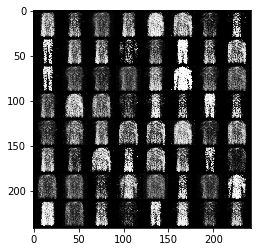

[Epoch 2/50] [Batch 801/938] [D loss: 0.436232] [G loss: 2.175531]
[Epoch 2/50] [Batch 802/938] [D loss: 0.520173] [G loss: 3.000714]
[Epoch 2/50] [Batch 803/938] [D loss: 0.507054] [G loss: 2.526148]
[Epoch 2/50] [Batch 804/938] [D loss: 0.522135] [G loss: 2.552873]
[Epoch 2/50] [Batch 805/938] [D loss: 0.452617] [G loss: 2.713358]
[Epoch 2/50] [Batch 806/938] [D loss: 0.490810] [G loss: 2.458111]
[Epoch 2/50] [Batch 807/938] [D loss: 0.678510] [G loss: 2.791085]
[Epoch 2/50] [Batch 808/938] [D loss: 0.352153] [G loss: 3.161367]
[Epoch 2/50] [Batch 809/938] [D loss: 0.472045] [G loss: 2.815892]
[Epoch 2/50] [Batch 810/938] [D loss: 0.536261] [G loss: 3.376968]
[Epoch 2/50] [Batch 811/938] [D loss: 0.572116] [G loss: 2.087414]
[Epoch 2/50] [Batch 812/938] [D loss: 0.650818] [G loss: 4.478244]
[Epoch 2/50] [Batch 813/938] [D loss: 0.570489] [G loss: 3.562675]
[Epoch 2/50] [Batch 814/938] [D loss: 0.447326] [G loss: 2.455079]
[Epoch 2/50] [Batch 815/938] [D loss: 0.478272] [G loss: 3.268

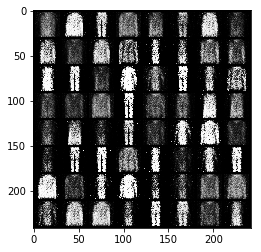

[Epoch 3/50] [Batch 1/938] [D loss: 0.423204] [G loss: 3.283893]
[Epoch 3/50] [Batch 2/938] [D loss: 0.513245] [G loss: 2.400882]
[Epoch 3/50] [Batch 3/938] [D loss: 0.407102] [G loss: 2.631312]
[Epoch 3/50] [Batch 4/938] [D loss: 0.483877] [G loss: 2.993649]
[Epoch 3/50] [Batch 5/938] [D loss: 0.323210] [G loss: 2.815298]
[Epoch 3/50] [Batch 6/938] [D loss: 0.344322] [G loss: 3.045362]
[Epoch 3/50] [Batch 7/938] [D loss: 0.402772] [G loss: 2.757166]
[Epoch 3/50] [Batch 8/938] [D loss: 0.490255] [G loss: 2.990590]
[Epoch 3/50] [Batch 9/938] [D loss: 0.340078] [G loss: 2.842553]
[Epoch 3/50] [Batch 10/938] [D loss: 0.602219] [G loss: 2.871264]
[Epoch 3/50] [Batch 11/938] [D loss: 0.396131] [G loss: 2.925168]
[Epoch 3/50] [Batch 12/938] [D loss: 0.398254] [G loss: 2.598896]
[Epoch 3/50] [Batch 13/938] [D loss: 0.443799] [G loss: 3.191366]
[Epoch 3/50] [Batch 14/938] [D loss: 0.330343] [G loss: 2.800634]
[Epoch 3/50] [Batch 15/938] [D loss: 0.568499] [G loss: 4.038642]
[Epoch 3/50] [Batch

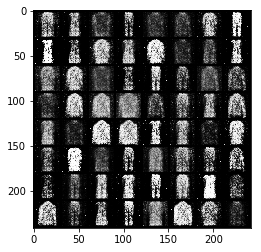

[Epoch 3/50] [Batch 201/938] [D loss: 0.461645] [G loss: 2.403004]
[Epoch 3/50] [Batch 202/938] [D loss: 0.566350] [G loss: 2.627585]
[Epoch 3/50] [Batch 203/938] [D loss: 0.491836] [G loss: 2.897754]
[Epoch 3/50] [Batch 204/938] [D loss: 0.544372] [G loss: 2.756039]
[Epoch 3/50] [Batch 205/938] [D loss: 0.572828] [G loss: 1.411314]
[Epoch 3/50] [Batch 206/938] [D loss: 0.904735] [G loss: 4.299828]
[Epoch 3/50] [Batch 207/938] [D loss: 1.014287] [G loss: 3.468670]
[Epoch 3/50] [Batch 208/938] [D loss: 0.818932] [G loss: 2.647159]
[Epoch 3/50] [Batch 209/938] [D loss: 0.462364] [G loss: 2.123930]
[Epoch 3/50] [Batch 210/938] [D loss: 0.603961] [G loss: 1.876600]
[Epoch 3/50] [Batch 211/938] [D loss: 0.511375] [G loss: 2.477688]
[Epoch 3/50] [Batch 212/938] [D loss: 0.568889] [G loss: 2.323003]
[Epoch 3/50] [Batch 213/938] [D loss: 0.493950] [G loss: 2.074585]
[Epoch 3/50] [Batch 214/938] [D loss: 0.479872] [G loss: 3.039344]
[Epoch 3/50] [Batch 215/938] [D loss: 0.468419] [G loss: 2.938

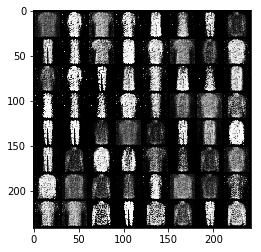

[Epoch 3/50] [Batch 401/938] [D loss: 0.701982] [G loss: 3.060696]
[Epoch 3/50] [Batch 402/938] [D loss: 0.537331] [G loss: 2.838056]
[Epoch 3/50] [Batch 403/938] [D loss: 0.715922] [G loss: 2.041088]
[Epoch 3/50] [Batch 404/938] [D loss: 0.651072] [G loss: 2.538581]
[Epoch 3/50] [Batch 405/938] [D loss: 0.406416] [G loss: 2.793983]
[Epoch 3/50] [Batch 406/938] [D loss: 0.552943] [G loss: 2.888735]
[Epoch 3/50] [Batch 407/938] [D loss: 0.698922] [G loss: 2.199136]
[Epoch 3/50] [Batch 408/938] [D loss: 0.576568] [G loss: 2.067468]
[Epoch 3/50] [Batch 409/938] [D loss: 0.546331] [G loss: 2.593747]
[Epoch 3/50] [Batch 410/938] [D loss: 0.625987] [G loss: 2.375943]
[Epoch 3/50] [Batch 411/938] [D loss: 0.463528] [G loss: 2.192139]
[Epoch 3/50] [Batch 412/938] [D loss: 0.521289] [G loss: 2.381655]
[Epoch 3/50] [Batch 413/938] [D loss: 0.721946] [G loss: 2.813168]
[Epoch 3/50] [Batch 414/938] [D loss: 0.638457] [G loss: 1.949637]
[Epoch 3/50] [Batch 415/938] [D loss: 0.711675] [G loss: 2.704

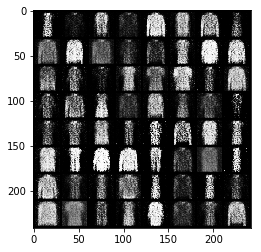

[Epoch 3/50] [Batch 601/938] [D loss: 0.704665] [G loss: 2.397158]
[Epoch 3/50] [Batch 602/938] [D loss: 0.520628] [G loss: 2.110049]
[Epoch 3/50] [Batch 603/938] [D loss: 0.597900] [G loss: 1.703029]
[Epoch 3/50] [Batch 604/938] [D loss: 0.704651] [G loss: 2.516490]
[Epoch 3/50] [Batch 605/938] [D loss: 0.543587] [G loss: 2.770869]
[Epoch 3/50] [Batch 606/938] [D loss: 0.574555] [G loss: 1.393582]
[Epoch 3/50] [Batch 607/938] [D loss: 0.747562] [G loss: 2.643771]
[Epoch 3/50] [Batch 608/938] [D loss: 0.555079] [G loss: 2.565693]
[Epoch 3/50] [Batch 609/938] [D loss: 0.478026] [G loss: 2.131533]
[Epoch 3/50] [Batch 610/938] [D loss: 0.481913] [G loss: 1.995651]
[Epoch 3/50] [Batch 611/938] [D loss: 0.477050] [G loss: 2.344073]
[Epoch 3/50] [Batch 612/938] [D loss: 0.410715] [G loss: 2.426785]
[Epoch 3/50] [Batch 613/938] [D loss: 0.624855] [G loss: 2.806791]
[Epoch 3/50] [Batch 614/938] [D loss: 0.705867] [G loss: 1.805791]
[Epoch 3/50] [Batch 615/938] [D loss: 0.774690] [G loss: 2.381

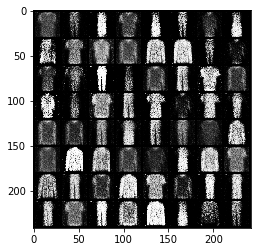

[Epoch 3/50] [Batch 801/938] [D loss: 0.795070] [G loss: 1.735350]
[Epoch 3/50] [Batch 802/938] [D loss: 0.691415] [G loss: 1.765516]
[Epoch 3/50] [Batch 803/938] [D loss: 0.879074] [G loss: 2.039100]
[Epoch 3/50] [Batch 804/938] [D loss: 0.567357] [G loss: 2.867638]
[Epoch 3/50] [Batch 805/938] [D loss: 0.735811] [G loss: 2.465642]
[Epoch 3/50] [Batch 806/938] [D loss: 0.821477] [G loss: 1.314279]
[Epoch 3/50] [Batch 807/938] [D loss: 0.898389] [G loss: 1.757540]
[Epoch 3/50] [Batch 808/938] [D loss: 0.831027] [G loss: 2.013459]
[Epoch 3/50] [Batch 809/938] [D loss: 0.830618] [G loss: 2.022062]
[Epoch 3/50] [Batch 810/938] [D loss: 0.836278] [G loss: 2.069987]
[Epoch 3/50] [Batch 811/938] [D loss: 0.709103] [G loss: 1.941692]
[Epoch 3/50] [Batch 812/938] [D loss: 0.752084] [G loss: 2.027105]
[Epoch 3/50] [Batch 813/938] [D loss: 0.617765] [G loss: 2.049023]
[Epoch 3/50] [Batch 814/938] [D loss: 0.645685] [G loss: 2.015957]
[Epoch 3/50] [Batch 815/938] [D loss: 0.571369] [G loss: 2.337

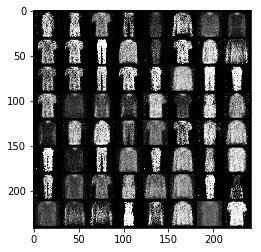

[Epoch 4/50] [Batch 1/938] [D loss: 0.826538] [G loss: 2.140850]
[Epoch 4/50] [Batch 2/938] [D loss: 0.823226] [G loss: 1.785995]
[Epoch 4/50] [Batch 3/938] [D loss: 0.772762] [G loss: 1.818852]
[Epoch 4/50] [Batch 4/938] [D loss: 0.682191] [G loss: 2.276130]
[Epoch 4/50] [Batch 5/938] [D loss: 0.488716] [G loss: 2.244070]
[Epoch 4/50] [Batch 6/938] [D loss: 0.664965] [G loss: 2.043159]
[Epoch 4/50] [Batch 7/938] [D loss: 0.741892] [G loss: 2.066616]
[Epoch 4/50] [Batch 8/938] [D loss: 0.635623] [G loss: 2.208246]
[Epoch 4/50] [Batch 9/938] [D loss: 0.797917] [G loss: 1.906825]
[Epoch 4/50] [Batch 10/938] [D loss: 0.772237] [G loss: 1.811438]
[Epoch 4/50] [Batch 11/938] [D loss: 0.812515] [G loss: 2.419154]
[Epoch 4/50] [Batch 12/938] [D loss: 0.718237] [G loss: 2.273182]
[Epoch 4/50] [Batch 13/938] [D loss: 0.603475] [G loss: 1.638568]
[Epoch 4/50] [Batch 14/938] [D loss: 0.769083] [G loss: 2.126994]
[Epoch 4/50] [Batch 15/938] [D loss: 0.680176] [G loss: 2.473598]
[Epoch 4/50] [Batch

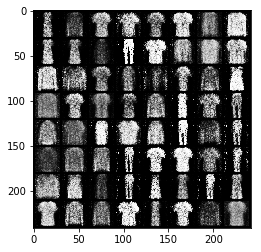

[Epoch 4/50] [Batch 201/938] [D loss: 0.712998] [G loss: 2.156958]
[Epoch 4/50] [Batch 202/938] [D loss: 0.964831] [G loss: 1.709161]
[Epoch 4/50] [Batch 203/938] [D loss: 0.769927] [G loss: 2.211657]
[Epoch 4/50] [Batch 204/938] [D loss: 0.719322] [G loss: 2.545784]
[Epoch 4/50] [Batch 205/938] [D loss: 1.021490] [G loss: 1.698601]
[Epoch 4/50] [Batch 206/938] [D loss: 0.745686] [G loss: 1.827436]
[Epoch 4/50] [Batch 207/938] [D loss: 0.858498] [G loss: 2.221446]
[Epoch 4/50] [Batch 208/938] [D loss: 0.655554] [G loss: 2.141395]
[Epoch 4/50] [Batch 209/938] [D loss: 0.773974] [G loss: 1.622195]
[Epoch 4/50] [Batch 210/938] [D loss: 0.599869] [G loss: 1.826052]
[Epoch 4/50] [Batch 211/938] [D loss: 0.659189] [G loss: 1.893945]
[Epoch 4/50] [Batch 212/938] [D loss: 0.681328] [G loss: 1.941362]
[Epoch 4/50] [Batch 213/938] [D loss: 0.741117] [G loss: 2.001526]
[Epoch 4/50] [Batch 214/938] [D loss: 0.751924] [G loss: 1.844605]
[Epoch 4/50] [Batch 215/938] [D loss: 0.718333] [G loss: 1.772

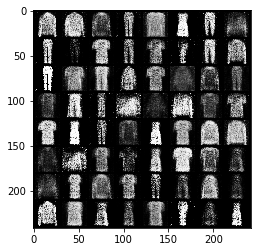

[Epoch 4/50] [Batch 401/938] [D loss: 0.783679] [G loss: 1.787848]
[Epoch 4/50] [Batch 402/938] [D loss: 0.821657] [G loss: 1.778354]
[Epoch 4/50] [Batch 403/938] [D loss: 0.675221] [G loss: 1.782505]
[Epoch 4/50] [Batch 404/938] [D loss: 0.649074] [G loss: 2.011997]
[Epoch 4/50] [Batch 405/938] [D loss: 0.695911] [G loss: 1.984700]
[Epoch 4/50] [Batch 406/938] [D loss: 0.760230] [G loss: 2.238162]
[Epoch 4/50] [Batch 407/938] [D loss: 0.686737] [G loss: 1.825873]
[Epoch 4/50] [Batch 408/938] [D loss: 0.523039] [G loss: 2.309291]
[Epoch 4/50] [Batch 409/938] [D loss: 0.610780] [G loss: 1.932501]
[Epoch 4/50] [Batch 410/938] [D loss: 0.688743] [G loss: 2.547981]
[Epoch 4/50] [Batch 411/938] [D loss: 0.601802] [G loss: 2.419197]
[Epoch 4/50] [Batch 412/938] [D loss: 0.814633] [G loss: 1.588699]
[Epoch 4/50] [Batch 413/938] [D loss: 0.844244] [G loss: 2.147869]
[Epoch 4/50] [Batch 414/938] [D loss: 0.680470] [G loss: 1.777272]
[Epoch 4/50] [Batch 415/938] [D loss: 0.632582] [G loss: 2.195

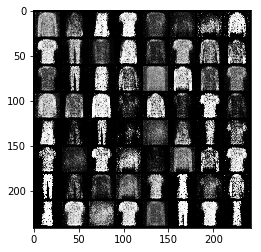

[Epoch 4/50] [Batch 601/938] [D loss: 0.714252] [G loss: 1.748275]
[Epoch 4/50] [Batch 602/938] [D loss: 0.811962] [G loss: 3.064104]
[Epoch 4/50] [Batch 603/938] [D loss: 0.837659] [G loss: 2.492075]
[Epoch 4/50] [Batch 604/938] [D loss: 0.572793] [G loss: 1.423009]
[Epoch 4/50] [Batch 605/938] [D loss: 0.671740] [G loss: 2.539041]
[Epoch 4/50] [Batch 606/938] [D loss: 0.819197] [G loss: 2.056438]
[Epoch 4/50] [Batch 607/938] [D loss: 0.757975] [G loss: 1.870743]
[Epoch 4/50] [Batch 608/938] [D loss: 0.557002] [G loss: 2.039199]
[Epoch 4/50] [Batch 609/938] [D loss: 0.671030] [G loss: 1.938799]
[Epoch 4/50] [Batch 610/938] [D loss: 0.881151] [G loss: 2.223105]
[Epoch 4/50] [Batch 611/938] [D loss: 0.739178] [G loss: 2.101467]
[Epoch 4/50] [Batch 612/938] [D loss: 0.741056] [G loss: 1.675807]
[Epoch 4/50] [Batch 613/938] [D loss: 0.788182] [G loss: 1.774238]
[Epoch 4/50] [Batch 614/938] [D loss: 0.808806] [G loss: 2.090790]
[Epoch 4/50] [Batch 615/938] [D loss: 0.801931] [G loss: 1.575

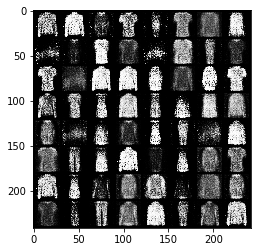

[Epoch 4/50] [Batch 801/938] [D loss: 0.771920] [G loss: 1.730355]
[Epoch 4/50] [Batch 802/938] [D loss: 0.729239] [G loss: 1.854795]
[Epoch 4/50] [Batch 803/938] [D loss: 0.878919] [G loss: 1.685040]
[Epoch 4/50] [Batch 804/938] [D loss: 0.939407] [G loss: 1.730446]
[Epoch 4/50] [Batch 805/938] [D loss: 0.662118] [G loss: 2.026108]
[Epoch 4/50] [Batch 806/938] [D loss: 0.730798] [G loss: 2.048363]
[Epoch 4/50] [Batch 807/938] [D loss: 0.679435] [G loss: 1.644578]
[Epoch 4/50] [Batch 808/938] [D loss: 0.668635] [G loss: 2.295213]
[Epoch 4/50] [Batch 809/938] [D loss: 0.877094] [G loss: 1.803690]
[Epoch 4/50] [Batch 810/938] [D loss: 0.724000] [G loss: 2.601970]
[Epoch 4/50] [Batch 811/938] [D loss: 0.778899] [G loss: 2.541994]
[Epoch 4/50] [Batch 812/938] [D loss: 0.810994] [G loss: 1.682083]
[Epoch 4/50] [Batch 813/938] [D loss: 0.759375] [G loss: 2.005498]
[Epoch 4/50] [Batch 814/938] [D loss: 0.615241] [G loss: 2.557166]
[Epoch 4/50] [Batch 815/938] [D loss: 0.711981] [G loss: 2.285

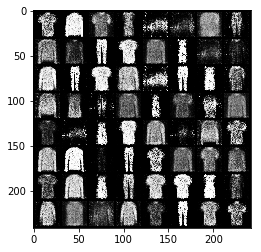

[Epoch 5/50] [Batch 1/938] [D loss: 0.798304] [G loss: 2.049970]
[Epoch 5/50] [Batch 2/938] [D loss: 0.902793] [G loss: 1.944777]
[Epoch 5/50] [Batch 3/938] [D loss: 0.792691] [G loss: 1.650555]
[Epoch 5/50] [Batch 4/938] [D loss: 0.846406] [G loss: 1.822283]
[Epoch 5/50] [Batch 5/938] [D loss: 0.717773] [G loss: 2.063971]
[Epoch 5/50] [Batch 6/938] [D loss: 0.722792] [G loss: 1.684950]
[Epoch 5/50] [Batch 7/938] [D loss: 0.986441] [G loss: 1.739461]
[Epoch 5/50] [Batch 8/938] [D loss: 0.843489] [G loss: 1.956086]
[Epoch 5/50] [Batch 9/938] [D loss: 0.914674] [G loss: 1.838206]
[Epoch 5/50] [Batch 10/938] [D loss: 0.801576] [G loss: 1.758076]
[Epoch 5/50] [Batch 11/938] [D loss: 0.784398] [G loss: 1.719408]
[Epoch 5/50] [Batch 12/938] [D loss: 0.736485] [G loss: 1.679934]
[Epoch 5/50] [Batch 13/938] [D loss: 0.734646] [G loss: 2.067193]
[Epoch 5/50] [Batch 14/938] [D loss: 0.743193] [G loss: 1.961136]
[Epoch 5/50] [Batch 15/938] [D loss: 0.767400] [G loss: 1.914479]
[Epoch 5/50] [Batch

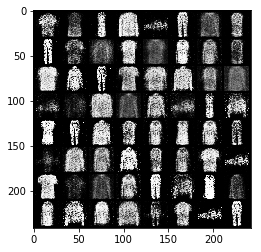

[Epoch 5/50] [Batch 201/938] [D loss: 0.794594] [G loss: 1.896702]
[Epoch 5/50] [Batch 202/938] [D loss: 0.741189] [G loss: 1.713553]
[Epoch 5/50] [Batch 203/938] [D loss: 0.751282] [G loss: 2.236880]
[Epoch 5/50] [Batch 204/938] [D loss: 0.874891] [G loss: 1.316306]
[Epoch 5/50] [Batch 205/938] [D loss: 0.925677] [G loss: 1.675028]
[Epoch 5/50] [Batch 206/938] [D loss: 0.799084] [G loss: 1.851877]
[Epoch 5/50] [Batch 207/938] [D loss: 0.720414] [G loss: 1.786888]
[Epoch 5/50] [Batch 208/938] [D loss: 0.687750] [G loss: 1.403098]
[Epoch 5/50] [Batch 209/938] [D loss: 0.758812] [G loss: 2.064379]
[Epoch 5/50] [Batch 210/938] [D loss: 0.870708] [G loss: 1.790745]
[Epoch 5/50] [Batch 211/938] [D loss: 0.770981] [G loss: 1.763447]
[Epoch 5/50] [Batch 212/938] [D loss: 0.573202] [G loss: 1.694748]
[Epoch 5/50] [Batch 213/938] [D loss: 0.790592] [G loss: 1.417364]
[Epoch 5/50] [Batch 214/938] [D loss: 0.813784] [G loss: 2.379714]
[Epoch 5/50] [Batch 215/938] [D loss: 0.790082] [G loss: 1.832

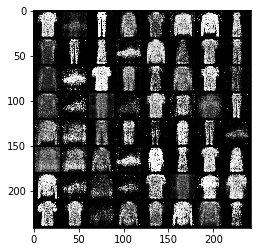

[Epoch 5/50] [Batch 401/938] [D loss: 0.783709] [G loss: 1.922734]
[Epoch 5/50] [Batch 402/938] [D loss: 0.773730] [G loss: 1.452194]
[Epoch 5/50] [Batch 403/938] [D loss: 0.751233] [G loss: 1.972695]
[Epoch 5/50] [Batch 404/938] [D loss: 0.783209] [G loss: 2.148690]
[Epoch 5/50] [Batch 405/938] [D loss: 0.836870] [G loss: 1.387575]
[Epoch 5/50] [Batch 406/938] [D loss: 0.741030] [G loss: 1.946133]
[Epoch 5/50] [Batch 407/938] [D loss: 0.892040] [G loss: 1.793544]
[Epoch 5/50] [Batch 408/938] [D loss: 0.905573] [G loss: 1.962684]
[Epoch 5/50] [Batch 409/938] [D loss: 0.781535] [G loss: 2.008817]
[Epoch 5/50] [Batch 410/938] [D loss: 0.943332] [G loss: 1.516749]
[Epoch 5/50] [Batch 411/938] [D loss: 0.899924] [G loss: 1.652334]
[Epoch 5/50] [Batch 412/938] [D loss: 0.858701] [G loss: 1.854846]
[Epoch 5/50] [Batch 413/938] [D loss: 0.789579] [G loss: 1.601986]
[Epoch 5/50] [Batch 414/938] [D loss: 0.919778] [G loss: 1.641236]
[Epoch 5/50] [Batch 415/938] [D loss: 0.907719] [G loss: 1.879

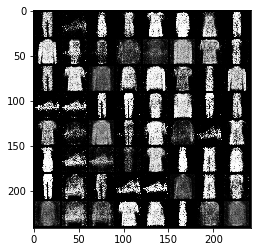

[Epoch 5/50] [Batch 601/938] [D loss: 0.859111] [G loss: 1.321010]
[Epoch 5/50] [Batch 602/938] [D loss: 0.883656] [G loss: 2.072864]
[Epoch 5/50] [Batch 603/938] [D loss: 0.996860] [G loss: 1.328966]
[Epoch 5/50] [Batch 604/938] [D loss: 0.951424] [G loss: 1.991686]
[Epoch 5/50] [Batch 605/938] [D loss: 0.719648] [G loss: 1.880305]
[Epoch 5/50] [Batch 606/938] [D loss: 1.015919] [G loss: 1.420776]
[Epoch 5/50] [Batch 607/938] [D loss: 0.855191] [G loss: 1.533407]
[Epoch 5/50] [Batch 608/938] [D loss: 0.886447] [G loss: 1.838972]
[Epoch 5/50] [Batch 609/938] [D loss: 0.884276] [G loss: 1.639146]
[Epoch 5/50] [Batch 610/938] [D loss: 0.943527] [G loss: 1.802641]
[Epoch 5/50] [Batch 611/938] [D loss: 0.731886] [G loss: 1.882113]
[Epoch 5/50] [Batch 612/938] [D loss: 0.740802] [G loss: 1.507010]
[Epoch 5/50] [Batch 613/938] [D loss: 0.932440] [G loss: 2.404853]
[Epoch 5/50] [Batch 614/938] [D loss: 1.032359] [G loss: 1.959529]
[Epoch 5/50] [Batch 615/938] [D loss: 0.911990] [G loss: 1.846

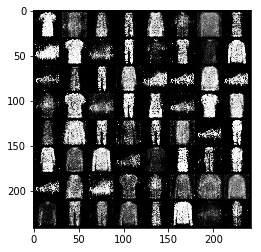

[Epoch 5/50] [Batch 801/938] [D loss: 0.789654] [G loss: 1.682309]
[Epoch 5/50] [Batch 802/938] [D loss: 1.097290] [G loss: 1.641634]
[Epoch 5/50] [Batch 803/938] [D loss: 0.762917] [G loss: 1.694966]
[Epoch 5/50] [Batch 804/938] [D loss: 0.888910] [G loss: 1.802864]
[Epoch 5/50] [Batch 805/938] [D loss: 0.883233] [G loss: 1.562443]
[Epoch 5/50] [Batch 806/938] [D loss: 0.846690] [G loss: 1.479665]
[Epoch 5/50] [Batch 807/938] [D loss: 0.889772] [G loss: 1.590240]
[Epoch 5/50] [Batch 808/938] [D loss: 0.948040] [G loss: 1.521393]
[Epoch 5/50] [Batch 809/938] [D loss: 0.973337] [G loss: 1.888521]
[Epoch 5/50] [Batch 810/938] [D loss: 0.972541] [G loss: 1.655037]
[Epoch 5/50] [Batch 811/938] [D loss: 0.946957] [G loss: 1.397407]
[Epoch 5/50] [Batch 812/938] [D loss: 0.839772] [G loss: 1.584787]
[Epoch 5/50] [Batch 813/938] [D loss: 0.802462] [G loss: 1.667305]
[Epoch 5/50] [Batch 814/938] [D loss: 0.816419] [G loss: 1.567008]
[Epoch 5/50] [Batch 815/938] [D loss: 0.948640] [G loss: 1.541

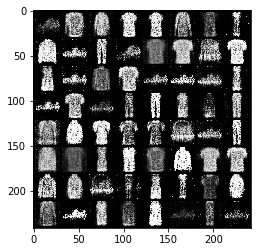

[Epoch 6/50] [Batch 1/938] [D loss: 0.859534] [G loss: 1.443605]
[Epoch 6/50] [Batch 2/938] [D loss: 0.772218] [G loss: 1.572236]
[Epoch 6/50] [Batch 3/938] [D loss: 0.810976] [G loss: 1.567272]
[Epoch 6/50] [Batch 4/938] [D loss: 0.730912] [G loss: 1.584645]
[Epoch 6/50] [Batch 5/938] [D loss: 0.888471] [G loss: 1.547499]
[Epoch 6/50] [Batch 6/938] [D loss: 0.896685] [G loss: 1.679209]
[Epoch 6/50] [Batch 7/938] [D loss: 0.873043] [G loss: 1.684332]
[Epoch 6/50] [Batch 8/938] [D loss: 0.839421] [G loss: 1.516020]
[Epoch 6/50] [Batch 9/938] [D loss: 0.974567] [G loss: 1.828590]
[Epoch 6/50] [Batch 10/938] [D loss: 0.867492] [G loss: 1.872582]
[Epoch 6/50] [Batch 11/938] [D loss: 0.963643] [G loss: 1.462450]
[Epoch 6/50] [Batch 12/938] [D loss: 0.908673] [G loss: 1.523500]
[Epoch 6/50] [Batch 13/938] [D loss: 0.948100] [G loss: 1.536100]
[Epoch 6/50] [Batch 14/938] [D loss: 0.896646] [G loss: 1.544731]
[Epoch 6/50] [Batch 15/938] [D loss: 0.778261] [G loss: 1.606913]
[Epoch 6/50] [Batch

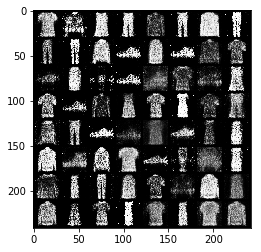

[Epoch 6/50] [Batch 201/938] [D loss: 1.028276] [G loss: 1.785793]
[Epoch 6/50] [Batch 202/938] [D loss: 0.955853] [G loss: 1.576797]
[Epoch 6/50] [Batch 203/938] [D loss: 0.935347] [G loss: 1.338500]
[Epoch 6/50] [Batch 204/938] [D loss: 0.858813] [G loss: 1.872625]
[Epoch 6/50] [Batch 205/938] [D loss: 1.063534] [G loss: 1.806647]
[Epoch 6/50] [Batch 206/938] [D loss: 1.051569] [G loss: 1.655118]
[Epoch 6/50] [Batch 207/938] [D loss: 1.086474] [G loss: 1.262631]
[Epoch 6/50] [Batch 208/938] [D loss: 1.092663] [G loss: 1.279507]
[Epoch 6/50] [Batch 209/938] [D loss: 0.823022] [G loss: 1.591530]
[Epoch 6/50] [Batch 210/938] [D loss: 0.808627] [G loss: 1.631006]
[Epoch 6/50] [Batch 211/938] [D loss: 0.850893] [G loss: 1.420202]
[Epoch 6/50] [Batch 212/938] [D loss: 0.936772] [G loss: 1.368052]
[Epoch 6/50] [Batch 213/938] [D loss: 1.018009] [G loss: 1.425270]
[Epoch 6/50] [Batch 214/938] [D loss: 0.843072] [G loss: 1.603632]
[Epoch 6/50] [Batch 215/938] [D loss: 1.052241] [G loss: 1.464

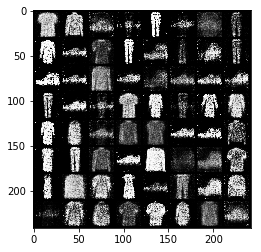

[Epoch 6/50] [Batch 401/938] [D loss: 1.015406] [G loss: 1.450236]
[Epoch 6/50] [Batch 402/938] [D loss: 1.018379] [G loss: 1.389313]
[Epoch 6/50] [Batch 403/938] [D loss: 0.953079] [G loss: 1.542986]
[Epoch 6/50] [Batch 404/938] [D loss: 0.938248] [G loss: 1.542071]
[Epoch 6/50] [Batch 405/938] [D loss: 1.110556] [G loss: 1.718872]
[Epoch 6/50] [Batch 406/938] [D loss: 1.064149] [G loss: 1.359773]
[Epoch 6/50] [Batch 407/938] [D loss: 0.855021] [G loss: 1.449921]
[Epoch 6/50] [Batch 408/938] [D loss: 0.991090] [G loss: 1.571434]
[Epoch 6/50] [Batch 409/938] [D loss: 0.875606] [G loss: 1.598408]
[Epoch 6/50] [Batch 410/938] [D loss: 1.018807] [G loss: 1.445871]
[Epoch 6/50] [Batch 411/938] [D loss: 1.149443] [G loss: 1.301096]
[Epoch 6/50] [Batch 412/938] [D loss: 1.009368] [G loss: 1.441494]
[Epoch 6/50] [Batch 413/938] [D loss: 1.194681] [G loss: 1.731661]
[Epoch 6/50] [Batch 414/938] [D loss: 0.881250] [G loss: 1.605154]
[Epoch 6/50] [Batch 415/938] [D loss: 0.963224] [G loss: 1.549

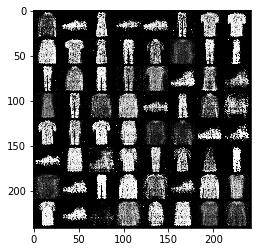

[Epoch 6/50] [Batch 601/938] [D loss: 1.121084] [G loss: 1.704880]
[Epoch 6/50] [Batch 602/938] [D loss: 1.020575] [G loss: 1.745154]
[Epoch 6/50] [Batch 603/938] [D loss: 1.141544] [G loss: 1.345314]
[Epoch 6/50] [Batch 604/938] [D loss: 1.044476] [G loss: 1.223133]
[Epoch 6/50] [Batch 605/938] [D loss: 1.045250] [G loss: 1.331344]
[Epoch 6/50] [Batch 606/938] [D loss: 0.885487] [G loss: 1.316554]
[Epoch 6/50] [Batch 607/938] [D loss: 0.978961] [G loss: 1.539237]
[Epoch 6/50] [Batch 608/938] [D loss: 0.823652] [G loss: 1.619882]
[Epoch 6/50] [Batch 609/938] [D loss: 0.695190] [G loss: 1.644300]
[Epoch 6/50] [Batch 610/938] [D loss: 0.871129] [G loss: 1.203425]
[Epoch 6/50] [Batch 611/938] [D loss: 0.902694] [G loss: 1.550075]
[Epoch 6/50] [Batch 612/938] [D loss: 0.887830] [G loss: 1.830052]
[Epoch 6/50] [Batch 613/938] [D loss: 0.899075] [G loss: 1.560582]
[Epoch 6/50] [Batch 614/938] [D loss: 0.777486] [G loss: 1.575166]
[Epoch 6/50] [Batch 615/938] [D loss: 0.804490] [G loss: 1.623

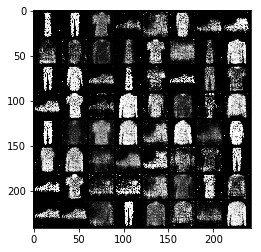

[Epoch 6/50] [Batch 801/938] [D loss: 1.055358] [G loss: 1.183516]
[Epoch 6/50] [Batch 802/938] [D loss: 0.864250] [G loss: 1.313509]
[Epoch 6/50] [Batch 803/938] [D loss: 0.997478] [G loss: 1.477544]
[Epoch 6/50] [Batch 804/938] [D loss: 1.060976] [G loss: 1.404376]
[Epoch 6/50] [Batch 805/938] [D loss: 1.039037] [G loss: 1.478194]
[Epoch 6/50] [Batch 806/938] [D loss: 0.989499] [G loss: 1.179594]
[Epoch 6/50] [Batch 807/938] [D loss: 0.969813] [G loss: 1.375776]
[Epoch 6/50] [Batch 808/938] [D loss: 0.998059] [G loss: 1.735292]
[Epoch 6/50] [Batch 809/938] [D loss: 0.996183] [G loss: 1.502351]
[Epoch 6/50] [Batch 810/938] [D loss: 1.007169] [G loss: 1.248420]
[Epoch 6/50] [Batch 811/938] [D loss: 1.126429] [G loss: 1.633006]
[Epoch 6/50] [Batch 812/938] [D loss: 0.927180] [G loss: 1.509425]
[Epoch 6/50] [Batch 813/938] [D loss: 0.942700] [G loss: 1.163607]
[Epoch 6/50] [Batch 814/938] [D loss: 0.872820] [G loss: 1.693268]
[Epoch 6/50] [Batch 815/938] [D loss: 0.859623] [G loss: 1.705

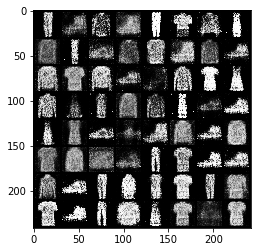

[Epoch 7/50] [Batch 1/938] [D loss: 0.998479] [G loss: 1.452276]
[Epoch 7/50] [Batch 2/938] [D loss: 0.846977] [G loss: 1.247759]
[Epoch 7/50] [Batch 3/938] [D loss: 0.932670] [G loss: 1.257457]
[Epoch 7/50] [Batch 4/938] [D loss: 0.943135] [G loss: 1.516479]
[Epoch 7/50] [Batch 5/938] [D loss: 1.074698] [G loss: 1.513786]
[Epoch 7/50] [Batch 6/938] [D loss: 1.019910] [G loss: 1.713743]
[Epoch 7/50] [Batch 7/938] [D loss: 0.886520] [G loss: 1.480713]
[Epoch 7/50] [Batch 8/938] [D loss: 0.972469] [G loss: 1.444396]
[Epoch 7/50] [Batch 9/938] [D loss: 0.804124] [G loss: 1.476679]
[Epoch 7/50] [Batch 10/938] [D loss: 0.911884] [G loss: 1.561010]
[Epoch 7/50] [Batch 11/938] [D loss: 0.922749] [G loss: 1.501291]
[Epoch 7/50] [Batch 12/938] [D loss: 0.854650] [G loss: 1.875329]
[Epoch 7/50] [Batch 13/938] [D loss: 1.136300] [G loss: 1.285343]
[Epoch 7/50] [Batch 14/938] [D loss: 0.997959] [G loss: 1.287487]
[Epoch 7/50] [Batch 15/938] [D loss: 0.982737] [G loss: 1.672572]
[Epoch 7/50] [Batch

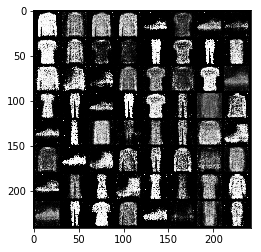

[Epoch 7/50] [Batch 201/938] [D loss: 1.206240] [G loss: 1.438473]
[Epoch 7/50] [Batch 202/938] [D loss: 0.910892] [G loss: 1.823591]
[Epoch 7/50] [Batch 203/938] [D loss: 1.174787] [G loss: 1.596487]
[Epoch 7/50] [Batch 204/938] [D loss: 0.973976] [G loss: 1.254907]
[Epoch 7/50] [Batch 205/938] [D loss: 1.112733] [G loss: 1.220612]
[Epoch 7/50] [Batch 206/938] [D loss: 1.051581] [G loss: 1.312452]
[Epoch 7/50] [Batch 207/938] [D loss: 0.936502] [G loss: 1.316828]
[Epoch 7/50] [Batch 208/938] [D loss: 1.038477] [G loss: 1.453974]
[Epoch 7/50] [Batch 209/938] [D loss: 0.953552] [G loss: 1.096343]
[Epoch 7/50] [Batch 210/938] [D loss: 0.971974] [G loss: 1.574943]
[Epoch 7/50] [Batch 211/938] [D loss: 0.848831] [G loss: 1.412705]
[Epoch 7/50] [Batch 212/938] [D loss: 0.968211] [G loss: 1.654838]
[Epoch 7/50] [Batch 213/938] [D loss: 0.796445] [G loss: 1.570717]
[Epoch 7/50] [Batch 214/938] [D loss: 0.805151] [G loss: 1.674991]
[Epoch 7/50] [Batch 215/938] [D loss: 0.944476] [G loss: 1.364

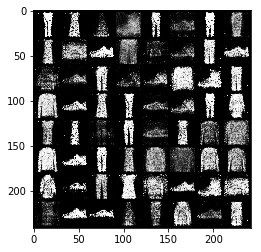

[Epoch 7/50] [Batch 401/938] [D loss: 1.058920] [G loss: 1.735559]
[Epoch 7/50] [Batch 402/938] [D loss: 1.070431] [G loss: 1.655752]
[Epoch 7/50] [Batch 403/938] [D loss: 1.038026] [G loss: 1.372190]
[Epoch 7/50] [Batch 404/938] [D loss: 0.883025] [G loss: 1.298876]
[Epoch 7/50] [Batch 405/938] [D loss: 1.034200] [G loss: 1.465136]
[Epoch 7/50] [Batch 406/938] [D loss: 1.088641] [G loss: 1.402005]
[Epoch 7/50] [Batch 407/938] [D loss: 1.086065] [G loss: 1.168392]
[Epoch 7/50] [Batch 408/938] [D loss: 1.031749] [G loss: 1.214458]
[Epoch 7/50] [Batch 409/938] [D loss: 1.084631] [G loss: 1.311388]
[Epoch 7/50] [Batch 410/938] [D loss: 1.047618] [G loss: 1.224777]
[Epoch 7/50] [Batch 411/938] [D loss: 0.960248] [G loss: 1.238124]
[Epoch 7/50] [Batch 412/938] [D loss: 0.889865] [G loss: 1.390838]
[Epoch 7/50] [Batch 413/938] [D loss: 0.999042] [G loss: 1.392043]
[Epoch 7/50] [Batch 414/938] [D loss: 0.937766] [G loss: 1.198575]
[Epoch 7/50] [Batch 415/938] [D loss: 1.035997] [G loss: 1.401

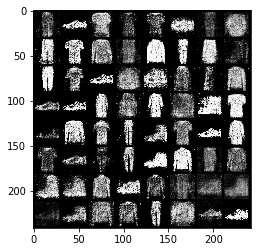

[Epoch 7/50] [Batch 601/938] [D loss: 1.179337] [G loss: 1.226642]
[Epoch 7/50] [Batch 602/938] [D loss: 1.109595] [G loss: 1.320854]
[Epoch 7/50] [Batch 603/938] [D loss: 1.012801] [G loss: 1.395818]
[Epoch 7/50] [Batch 604/938] [D loss: 0.951669] [G loss: 1.407668]
[Epoch 7/50] [Batch 605/938] [D loss: 0.962012] [G loss: 1.261602]
[Epoch 7/50] [Batch 606/938] [D loss: 1.051349] [G loss: 1.544973]
[Epoch 7/50] [Batch 607/938] [D loss: 0.997424] [G loss: 1.571159]
[Epoch 7/50] [Batch 608/938] [D loss: 1.016880] [G loss: 1.185299]
[Epoch 7/50] [Batch 609/938] [D loss: 0.953801] [G loss: 1.199462]
[Epoch 7/50] [Batch 610/938] [D loss: 1.012438] [G loss: 1.682369]
[Epoch 7/50] [Batch 611/938] [D loss: 1.081931] [G loss: 1.622973]
[Epoch 7/50] [Batch 612/938] [D loss: 0.833789] [G loss: 1.514405]
[Epoch 7/50] [Batch 613/938] [D loss: 0.938576] [G loss: 1.482445]
[Epoch 7/50] [Batch 614/938] [D loss: 1.049546] [G loss: 1.977615]
[Epoch 7/50] [Batch 615/938] [D loss: 1.113464] [G loss: 1.728

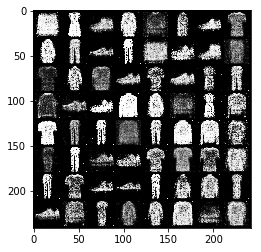

[Epoch 7/50] [Batch 801/938] [D loss: 0.999887] [G loss: 1.477483]
[Epoch 7/50] [Batch 802/938] [D loss: 1.195902] [G loss: 1.295872]
[Epoch 7/50] [Batch 803/938] [D loss: 1.205583] [G loss: 1.262253]
[Epoch 7/50] [Batch 804/938] [D loss: 1.088954] [G loss: 1.320974]
[Epoch 7/50] [Batch 805/938] [D loss: 0.955800] [G loss: 1.242640]
[Epoch 7/50] [Batch 806/938] [D loss: 0.975329] [G loss: 1.483389]
[Epoch 7/50] [Batch 807/938] [D loss: 0.972950] [G loss: 1.574359]
[Epoch 7/50] [Batch 808/938] [D loss: 1.104401] [G loss: 1.236065]
[Epoch 7/50] [Batch 809/938] [D loss: 1.127412] [G loss: 1.482615]
[Epoch 7/50] [Batch 810/938] [D loss: 1.042822] [G loss: 1.325745]
[Epoch 7/50] [Batch 811/938] [D loss: 1.113811] [G loss: 1.350200]
[Epoch 7/50] [Batch 812/938] [D loss: 1.046186] [G loss: 1.340987]
[Epoch 7/50] [Batch 813/938] [D loss: 1.020874] [G loss: 1.244087]
[Epoch 7/50] [Batch 814/938] [D loss: 1.180786] [G loss: 1.305523]
[Epoch 7/50] [Batch 815/938] [D loss: 1.032444] [G loss: 1.250

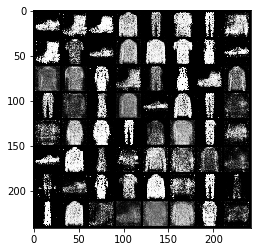

[Epoch 8/50] [Batch 1/938] [D loss: 1.017735] [G loss: 1.232241]
[Epoch 8/50] [Batch 2/938] [D loss: 1.008789] [G loss: 1.238078]
[Epoch 8/50] [Batch 3/938] [D loss: 1.052658] [G loss: 1.304426]
[Epoch 8/50] [Batch 4/938] [D loss: 1.122344] [G loss: 1.243305]
[Epoch 8/50] [Batch 5/938] [D loss: 0.964598] [G loss: 1.292245]
[Epoch 8/50] [Batch 6/938] [D loss: 1.107053] [G loss: 1.314070]
[Epoch 8/50] [Batch 7/938] [D loss: 1.159690] [G loss: 1.341427]
[Epoch 8/50] [Batch 8/938] [D loss: 1.144647] [G loss: 1.331672]
[Epoch 8/50] [Batch 9/938] [D loss: 1.130992] [G loss: 1.239271]
[Epoch 8/50] [Batch 10/938] [D loss: 1.118540] [G loss: 1.265874]
[Epoch 8/50] [Batch 11/938] [D loss: 1.232749] [G loss: 1.538574]
[Epoch 8/50] [Batch 12/938] [D loss: 1.157207] [G loss: 1.177801]
[Epoch 8/50] [Batch 13/938] [D loss: 1.052101] [G loss: 1.115399]
[Epoch 8/50] [Batch 14/938] [D loss: 1.108421] [G loss: 1.314321]
[Epoch 8/50] [Batch 15/938] [D loss: 1.009182] [G loss: 1.222977]
[Epoch 8/50] [Batch

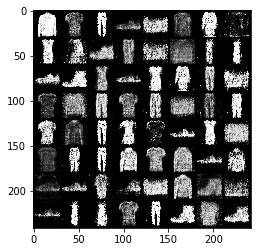

[Epoch 8/50] [Batch 201/938] [D loss: 0.885284] [G loss: 1.701937]
[Epoch 8/50] [Batch 202/938] [D loss: 0.922626] [G loss: 1.552875]
[Epoch 8/50] [Batch 203/938] [D loss: 0.945769] [G loss: 2.122425]
[Epoch 8/50] [Batch 204/938] [D loss: 1.512127] [G loss: 1.086110]
[Epoch 8/50] [Batch 205/938] [D loss: 1.181304] [G loss: 1.590276]
[Epoch 8/50] [Batch 206/938] [D loss: 1.267044] [G loss: 1.373109]
[Epoch 8/50] [Batch 207/938] [D loss: 1.107208] [G loss: 1.446265]
[Epoch 8/50] [Batch 208/938] [D loss: 1.029231] [G loss: 1.400710]
[Epoch 8/50] [Batch 209/938] [D loss: 1.078578] [G loss: 1.138772]
[Epoch 8/50] [Batch 210/938] [D loss: 1.346524] [G loss: 1.317855]
[Epoch 8/50] [Batch 211/938] [D loss: 1.311270] [G loss: 1.141792]
[Epoch 8/50] [Batch 212/938] [D loss: 1.191292] [G loss: 1.154903]
[Epoch 8/50] [Batch 213/938] [D loss: 1.123183] [G loss: 1.384136]
[Epoch 8/50] [Batch 214/938] [D loss: 1.201610] [G loss: 1.282822]
[Epoch 8/50] [Batch 215/938] [D loss: 1.208232] [G loss: 1.194

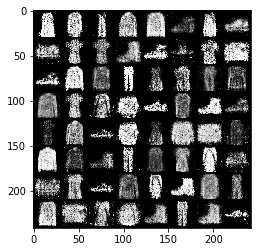

[Epoch 8/50] [Batch 401/938] [D loss: 1.211709] [G loss: 1.166360]
[Epoch 8/50] [Batch 402/938] [D loss: 1.128497] [G loss: 1.160393]
[Epoch 8/50] [Batch 403/938] [D loss: 1.114978] [G loss: 1.242291]
[Epoch 8/50] [Batch 404/938] [D loss: 1.208811] [G loss: 1.163641]
[Epoch 8/50] [Batch 405/938] [D loss: 0.975321] [G loss: 1.206592]
[Epoch 8/50] [Batch 406/938] [D loss: 1.131999] [G loss: 1.248136]
[Epoch 8/50] [Batch 407/938] [D loss: 1.127561] [G loss: 1.339609]
[Epoch 8/50] [Batch 408/938] [D loss: 1.146546] [G loss: 1.159987]
[Epoch 8/50] [Batch 409/938] [D loss: 1.171324] [G loss: 1.033159]
[Epoch 8/50] [Batch 410/938] [D loss: 1.088137] [G loss: 1.139207]
[Epoch 8/50] [Batch 411/938] [D loss: 1.239097] [G loss: 1.323487]
[Epoch 8/50] [Batch 412/938] [D loss: 1.038664] [G loss: 1.358351]
[Epoch 8/50] [Batch 413/938] [D loss: 1.090629] [G loss: 1.218292]
[Epoch 8/50] [Batch 414/938] [D loss: 1.196546] [G loss: 1.168102]
[Epoch 8/50] [Batch 415/938] [D loss: 1.286933] [G loss: 1.099

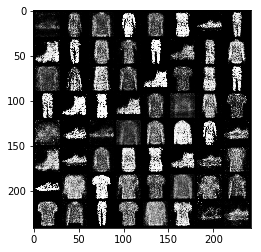

[Epoch 8/50] [Batch 601/938] [D loss: 1.256530] [G loss: 1.234205]
[Epoch 8/50] [Batch 602/938] [D loss: 1.072035] [G loss: 1.350506]
[Epoch 8/50] [Batch 603/938] [D loss: 1.167469] [G loss: 1.233386]
[Epoch 8/50] [Batch 604/938] [D loss: 1.162396] [G loss: 1.101974]
[Epoch 8/50] [Batch 605/938] [D loss: 0.965955] [G loss: 1.144433]
[Epoch 8/50] [Batch 606/938] [D loss: 1.090432] [G loss: 1.458174]
[Epoch 8/50] [Batch 607/938] [D loss: 1.074537] [G loss: 1.439245]
[Epoch 8/50] [Batch 608/938] [D loss: 1.014473] [G loss: 1.242270]
[Epoch 8/50] [Batch 609/938] [D loss: 1.067627] [G loss: 1.049433]
[Epoch 8/50] [Batch 610/938] [D loss: 1.136549] [G loss: 1.131363]
[Epoch 8/50] [Batch 611/938] [D loss: 1.071017] [G loss: 1.227858]
[Epoch 8/50] [Batch 612/938] [D loss: 1.143676] [G loss: 1.196746]
[Epoch 8/50] [Batch 613/938] [D loss: 1.152112] [G loss: 1.155061]
[Epoch 8/50] [Batch 614/938] [D loss: 1.201520] [G loss: 1.288519]
[Epoch 8/50] [Batch 615/938] [D loss: 1.082713] [G loss: 1.246

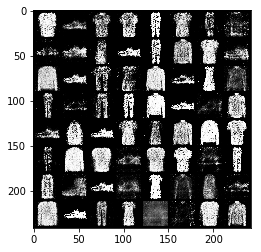

[Epoch 8/50] [Batch 801/938] [D loss: 1.056088] [G loss: 1.345749]
[Epoch 8/50] [Batch 802/938] [D loss: 0.959808] [G loss: 1.381745]
[Epoch 8/50] [Batch 803/938] [D loss: 1.022234] [G loss: 1.372272]
[Epoch 8/50] [Batch 804/938] [D loss: 1.344463] [G loss: 1.277238]
[Epoch 8/50] [Batch 805/938] [D loss: 0.910386] [G loss: 1.191683]
[Epoch 8/50] [Batch 806/938] [D loss: 1.170332] [G loss: 1.389086]
[Epoch 8/50] [Batch 807/938] [D loss: 0.963112] [G loss: 1.284776]
[Epoch 8/50] [Batch 808/938] [D loss: 0.993218] [G loss: 1.267379]
[Epoch 8/50] [Batch 809/938] [D loss: 1.095049] [G loss: 1.245513]
[Epoch 8/50] [Batch 810/938] [D loss: 1.002574] [G loss: 1.403712]
[Epoch 8/50] [Batch 811/938] [D loss: 1.200771] [G loss: 1.170615]
[Epoch 8/50] [Batch 812/938] [D loss: 0.976513] [G loss: 1.307314]
[Epoch 8/50] [Batch 813/938] [D loss: 1.072014] [G loss: 1.348084]
[Epoch 8/50] [Batch 814/938] [D loss: 0.998754] [G loss: 1.170871]
[Epoch 8/50] [Batch 815/938] [D loss: 1.145635] [G loss: 1.145

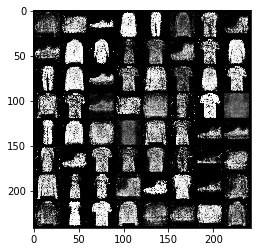

[Epoch 9/50] [Batch 1/938] [D loss: 1.124734] [G loss: 1.114201]
[Epoch 9/50] [Batch 2/938] [D loss: 1.067039] [G loss: 1.086829]
[Epoch 9/50] [Batch 3/938] [D loss: 1.160991] [G loss: 1.148541]
[Epoch 9/50] [Batch 4/938] [D loss: 1.064065] [G loss: 1.163777]
[Epoch 9/50] [Batch 5/938] [D loss: 0.966207] [G loss: 1.155684]
[Epoch 9/50] [Batch 6/938] [D loss: 1.003267] [G loss: 1.123540]
[Epoch 9/50] [Batch 7/938] [D loss: 1.056301] [G loss: 1.160988]
[Epoch 9/50] [Batch 8/938] [D loss: 1.214682] [G loss: 1.316574]
[Epoch 9/50] [Batch 9/938] [D loss: 1.010647] [G loss: 1.195403]
[Epoch 9/50] [Batch 10/938] [D loss: 1.039316] [G loss: 1.262336]
[Epoch 9/50] [Batch 11/938] [D loss: 1.075903] [G loss: 1.281375]
[Epoch 9/50] [Batch 12/938] [D loss: 1.048457] [G loss: 1.157425]
[Epoch 9/50] [Batch 13/938] [D loss: 0.975137] [G loss: 1.261528]
[Epoch 9/50] [Batch 14/938] [D loss: 1.093602] [G loss: 1.432342]
[Epoch 9/50] [Batch 15/938] [D loss: 1.110588] [G loss: 1.387888]
[Epoch 9/50] [Batch

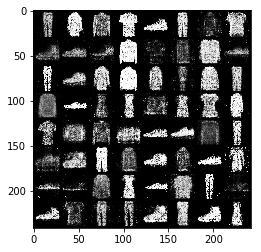

[Epoch 9/50] [Batch 201/938] [D loss: 1.056771] [G loss: 1.226261]
[Epoch 9/50] [Batch 202/938] [D loss: 1.092087] [G loss: 1.220863]
[Epoch 9/50] [Batch 203/938] [D loss: 1.112397] [G loss: 1.237254]
[Epoch 9/50] [Batch 204/938] [D loss: 1.043358] [G loss: 1.142895]
[Epoch 9/50] [Batch 205/938] [D loss: 1.390576] [G loss: 1.098200]
[Epoch 9/50] [Batch 206/938] [D loss: 1.067225] [G loss: 1.113540]
[Epoch 9/50] [Batch 207/938] [D loss: 1.151784] [G loss: 0.996984]
[Epoch 9/50] [Batch 208/938] [D loss: 1.193805] [G loss: 1.094012]
[Epoch 9/50] [Batch 209/938] [D loss: 1.072165] [G loss: 1.417791]
[Epoch 9/50] [Batch 210/938] [D loss: 1.179904] [G loss: 1.103135]
[Epoch 9/50] [Batch 211/938] [D loss: 1.070955] [G loss: 1.202027]
[Epoch 9/50] [Batch 212/938] [D loss: 1.183154] [G loss: 1.245551]
[Epoch 9/50] [Batch 213/938] [D loss: 1.009353] [G loss: 1.288816]
[Epoch 9/50] [Batch 214/938] [D loss: 1.077537] [G loss: 1.287551]
[Epoch 9/50] [Batch 215/938] [D loss: 0.996077] [G loss: 1.234

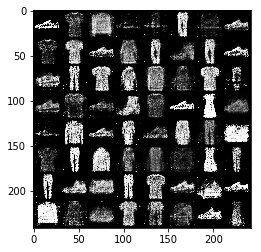

[Epoch 9/50] [Batch 401/938] [D loss: 1.076183] [G loss: 1.334872]
[Epoch 9/50] [Batch 402/938] [D loss: 1.023957] [G loss: 1.278061]
[Epoch 9/50] [Batch 403/938] [D loss: 1.100520] [G loss: 1.172710]
[Epoch 9/50] [Batch 404/938] [D loss: 0.991542] [G loss: 1.183252]
[Epoch 9/50] [Batch 405/938] [D loss: 1.132901] [G loss: 1.186204]
[Epoch 9/50] [Batch 406/938] [D loss: 1.023675] [G loss: 1.235010]
[Epoch 9/50] [Batch 407/938] [D loss: 1.175409] [G loss: 1.336747]
[Epoch 9/50] [Batch 408/938] [D loss: 1.016380] [G loss: 1.290735]
[Epoch 9/50] [Batch 409/938] [D loss: 1.193230] [G loss: 1.035063]
[Epoch 9/50] [Batch 410/938] [D loss: 1.088788] [G loss: 1.268803]
[Epoch 9/50] [Batch 411/938] [D loss: 1.060893] [G loss: 1.382624]
[Epoch 9/50] [Batch 412/938] [D loss: 1.203478] [G loss: 1.286458]
[Epoch 9/50] [Batch 413/938] [D loss: 1.027914] [G loss: 1.120490]
[Epoch 9/50] [Batch 414/938] [D loss: 1.078065] [G loss: 1.079126]
[Epoch 9/50] [Batch 415/938] [D loss: 1.107772] [G loss: 1.314

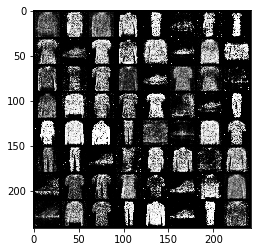

[Epoch 9/50] [Batch 601/938] [D loss: 1.042384] [G loss: 0.997913]
[Epoch 9/50] [Batch 602/938] [D loss: 1.147972] [G loss: 1.148912]
[Epoch 9/50] [Batch 603/938] [D loss: 0.961733] [G loss: 1.150607]
[Epoch 9/50] [Batch 604/938] [D loss: 1.107247] [G loss: 1.197623]
[Epoch 9/50] [Batch 605/938] [D loss: 0.986723] [G loss: 1.134645]
[Epoch 9/50] [Batch 606/938] [D loss: 1.095508] [G loss: 1.152158]
[Epoch 9/50] [Batch 607/938] [D loss: 0.974815] [G loss: 1.105607]
[Epoch 9/50] [Batch 608/938] [D loss: 1.089191] [G loss: 1.193931]
[Epoch 9/50] [Batch 609/938] [D loss: 0.998432] [G loss: 1.316041]
[Epoch 9/50] [Batch 610/938] [D loss: 0.962414] [G loss: 1.398523]
[Epoch 9/50] [Batch 611/938] [D loss: 1.039452] [G loss: 1.295316]
[Epoch 9/50] [Batch 612/938] [D loss: 1.141292] [G loss: 1.184271]
[Epoch 9/50] [Batch 613/938] [D loss: 1.082711] [G loss: 1.326081]
[Epoch 9/50] [Batch 614/938] [D loss: 1.059317] [G loss: 1.376428]
[Epoch 9/50] [Batch 615/938] [D loss: 0.929354] [G loss: 1.181

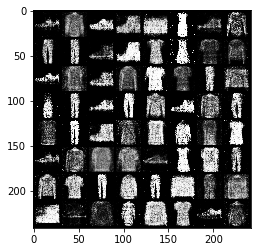

[Epoch 9/50] [Batch 801/938] [D loss: 1.156530] [G loss: 0.975395]
[Epoch 9/50] [Batch 802/938] [D loss: 1.085359] [G loss: 0.932975]
[Epoch 9/50] [Batch 803/938] [D loss: 1.125579] [G loss: 1.069763]
[Epoch 9/50] [Batch 804/938] [D loss: 1.100691] [G loss: 1.137059]
[Epoch 9/50] [Batch 805/938] [D loss: 1.179999] [G loss: 1.037086]
[Epoch 9/50] [Batch 806/938] [D loss: 1.045918] [G loss: 1.096392]
[Epoch 9/50] [Batch 807/938] [D loss: 1.029327] [G loss: 1.067677]
[Epoch 9/50] [Batch 808/938] [D loss: 1.005790] [G loss: 1.070416]
[Epoch 9/50] [Batch 809/938] [D loss: 1.050622] [G loss: 1.165349]
[Epoch 9/50] [Batch 810/938] [D loss: 1.183459] [G loss: 1.140566]
[Epoch 9/50] [Batch 811/938] [D loss: 1.116789] [G loss: 1.170764]
[Epoch 9/50] [Batch 812/938] [D loss: 1.221706] [G loss: 1.123580]
[Epoch 9/50] [Batch 813/938] [D loss: 1.116549] [G loss: 1.113997]
[Epoch 9/50] [Batch 814/938] [D loss: 1.057622] [G loss: 1.237177]
[Epoch 9/50] [Batch 815/938] [D loss: 1.044614] [G loss: 1.187

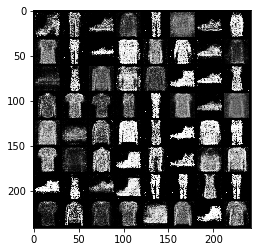

[Epoch 10/50] [Batch 1/938] [D loss: 1.106750] [G loss: 1.307090]
[Epoch 10/50] [Batch 2/938] [D loss: 1.220671] [G loss: 1.164591]
[Epoch 10/50] [Batch 3/938] [D loss: 1.093272] [G loss: 1.092720]
[Epoch 10/50] [Batch 4/938] [D loss: 1.085954] [G loss: 1.052825]
[Epoch 10/50] [Batch 5/938] [D loss: 1.244852] [G loss: 1.213845]
[Epoch 10/50] [Batch 6/938] [D loss: 1.191937] [G loss: 1.374461]
[Epoch 10/50] [Batch 7/938] [D loss: 1.285223] [G loss: 1.276580]
[Epoch 10/50] [Batch 8/938] [D loss: 1.238442] [G loss: 1.322064]
[Epoch 10/50] [Batch 9/938] [D loss: 1.105065] [G loss: 1.175804]
[Epoch 10/50] [Batch 10/938] [D loss: 1.169212] [G loss: 1.072250]
[Epoch 10/50] [Batch 11/938] [D loss: 1.048437] [G loss: 1.119630]
[Epoch 10/50] [Batch 12/938] [D loss: 1.093344] [G loss: 1.146415]
[Epoch 10/50] [Batch 13/938] [D loss: 1.151640] [G loss: 1.177843]
[Epoch 10/50] [Batch 14/938] [D loss: 1.113539] [G loss: 1.184904]
[Epoch 10/50] [Batch 15/938] [D loss: 1.129819] [G loss: 1.257086]
[Epo

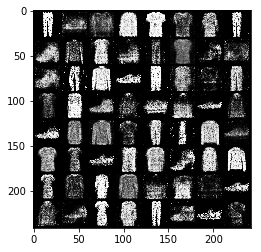

[Epoch 10/50] [Batch 201/938] [D loss: 1.132983] [G loss: 1.218668]
[Epoch 10/50] [Batch 202/938] [D loss: 1.272746] [G loss: 1.136524]
[Epoch 10/50] [Batch 203/938] [D loss: 1.187834] [G loss: 1.155963]
[Epoch 10/50] [Batch 204/938] [D loss: 1.224912] [G loss: 1.269566]
[Epoch 10/50] [Batch 205/938] [D loss: 1.106460] [G loss: 1.171408]
[Epoch 10/50] [Batch 206/938] [D loss: 1.137701] [G loss: 1.170405]
[Epoch 10/50] [Batch 207/938] [D loss: 1.164013] [G loss: 1.075452]
[Epoch 10/50] [Batch 208/938] [D loss: 1.107753] [G loss: 1.085920]
[Epoch 10/50] [Batch 209/938] [D loss: 1.034157] [G loss: 1.153403]
[Epoch 10/50] [Batch 210/938] [D loss: 1.209097] [G loss: 1.096832]
[Epoch 10/50] [Batch 211/938] [D loss: 1.048959] [G loss: 1.108244]
[Epoch 10/50] [Batch 212/938] [D loss: 1.238793] [G loss: 1.078498]
[Epoch 10/50] [Batch 213/938] [D loss: 1.155617] [G loss: 1.092181]
[Epoch 10/50] [Batch 214/938] [D loss: 1.153799] [G loss: 1.151123]
[Epoch 10/50] [Batch 215/938] [D loss: 1.171405]

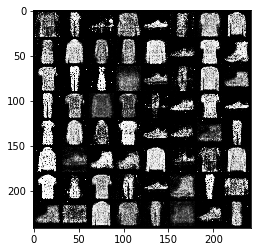

[Epoch 10/50] [Batch 401/938] [D loss: 1.004812] [G loss: 1.205289]
[Epoch 10/50] [Batch 402/938] [D loss: 1.166708] [G loss: 1.087364]
[Epoch 10/50] [Batch 403/938] [D loss: 1.194580] [G loss: 1.144683]
[Epoch 10/50] [Batch 404/938] [D loss: 1.127522] [G loss: 1.101254]
[Epoch 10/50] [Batch 405/938] [D loss: 1.179802] [G loss: 1.109219]
[Epoch 10/50] [Batch 406/938] [D loss: 1.424103] [G loss: 1.156641]
[Epoch 10/50] [Batch 407/938] [D loss: 1.154495] [G loss: 1.140610]
[Epoch 10/50] [Batch 408/938] [D loss: 1.187214] [G loss: 1.164375]
[Epoch 10/50] [Batch 409/938] [D loss: 1.181004] [G loss: 1.118384]
[Epoch 10/50] [Batch 410/938] [D loss: 1.172841] [G loss: 1.087002]
[Epoch 10/50] [Batch 411/938] [D loss: 1.108429] [G loss: 1.031196]
[Epoch 10/50] [Batch 412/938] [D loss: 1.144095] [G loss: 0.968705]
[Epoch 10/50] [Batch 413/938] [D loss: 1.371420] [G loss: 1.086188]
[Epoch 10/50] [Batch 414/938] [D loss: 1.156043] [G loss: 1.142246]
[Epoch 10/50] [Batch 415/938] [D loss: 1.201898]

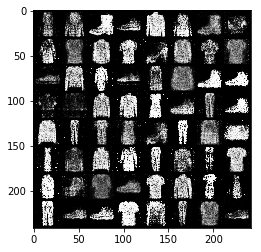

[Epoch 10/50] [Batch 601/938] [D loss: 1.159237] [G loss: 1.043770]
[Epoch 10/50] [Batch 602/938] [D loss: 1.142742] [G loss: 1.011438]
[Epoch 10/50] [Batch 603/938] [D loss: 1.171228] [G loss: 1.074722]
[Epoch 10/50] [Batch 604/938] [D loss: 1.310520] [G loss: 1.117683]
[Epoch 10/50] [Batch 605/938] [D loss: 1.100326] [G loss: 1.138029]
[Epoch 10/50] [Batch 606/938] [D loss: 1.143732] [G loss: 1.198848]
[Epoch 10/50] [Batch 607/938] [D loss: 1.131476] [G loss: 1.023514]
[Epoch 10/50] [Batch 608/938] [D loss: 1.213008] [G loss: 1.069303]
[Epoch 10/50] [Batch 609/938] [D loss: 1.302001] [G loss: 1.018115]
[Epoch 10/50] [Batch 610/938] [D loss: 1.287326] [G loss: 1.154370]
[Epoch 10/50] [Batch 611/938] [D loss: 1.086062] [G loss: 0.988516]
[Epoch 10/50] [Batch 612/938] [D loss: 1.206528] [G loss: 0.923595]
[Epoch 10/50] [Batch 613/938] [D loss: 1.153633] [G loss: 1.038978]
[Epoch 10/50] [Batch 614/938] [D loss: 1.220937] [G loss: 1.111299]
[Epoch 10/50] [Batch 615/938] [D loss: 1.161566]

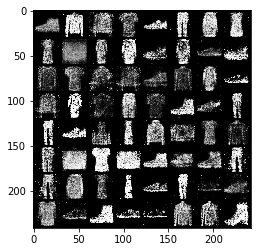

[Epoch 10/50] [Batch 801/938] [D loss: 1.147028] [G loss: 1.096893]
[Epoch 10/50] [Batch 802/938] [D loss: 1.070328] [G loss: 1.086143]
[Epoch 10/50] [Batch 803/938] [D loss: 1.183391] [G loss: 1.073215]
[Epoch 10/50] [Batch 804/938] [D loss: 1.135959] [G loss: 1.025212]
[Epoch 10/50] [Batch 805/938] [D loss: 1.158261] [G loss: 1.017844]
[Epoch 10/50] [Batch 806/938] [D loss: 1.381599] [G loss: 1.037026]
[Epoch 10/50] [Batch 807/938] [D loss: 1.141529] [G loss: 1.142957]
[Epoch 10/50] [Batch 808/938] [D loss: 1.192293] [G loss: 1.007334]
[Epoch 10/50] [Batch 809/938] [D loss: 1.146356] [G loss: 1.079467]
[Epoch 10/50] [Batch 810/938] [D loss: 1.080108] [G loss: 1.085524]
[Epoch 10/50] [Batch 811/938] [D loss: 1.223280] [G loss: 0.941550]
[Epoch 10/50] [Batch 812/938] [D loss: 1.122649] [G loss: 0.989479]
[Epoch 10/50] [Batch 813/938] [D loss: 1.137886] [G loss: 1.080410]
[Epoch 10/50] [Batch 814/938] [D loss: 1.186123] [G loss: 1.097572]
[Epoch 10/50] [Batch 815/938] [D loss: 1.174260]

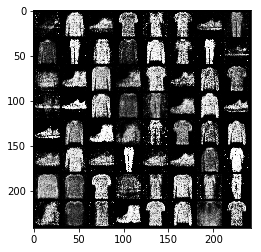

[Epoch 11/50] [Batch 1/938] [D loss: 1.108123] [G loss: 0.992477]
[Epoch 11/50] [Batch 2/938] [D loss: 1.259785] [G loss: 0.978446]
[Epoch 11/50] [Batch 3/938] [D loss: 1.147377] [G loss: 1.126289]
[Epoch 11/50] [Batch 4/938] [D loss: 1.244308] [G loss: 1.082330]
[Epoch 11/50] [Batch 5/938] [D loss: 1.100584] [G loss: 1.142194]
[Epoch 11/50] [Batch 6/938] [D loss: 1.191311] [G loss: 1.131937]
[Epoch 11/50] [Batch 7/938] [D loss: 1.102891] [G loss: 1.147907]
[Epoch 11/50] [Batch 8/938] [D loss: 1.116793] [G loss: 1.080815]
[Epoch 11/50] [Batch 9/938] [D loss: 1.221308] [G loss: 0.948987]
[Epoch 11/50] [Batch 10/938] [D loss: 1.239201] [G loss: 1.040126]
[Epoch 11/50] [Batch 11/938] [D loss: 1.324566] [G loss: 1.065950]
[Epoch 11/50] [Batch 12/938] [D loss: 1.123295] [G loss: 1.113193]
[Epoch 11/50] [Batch 13/938] [D loss: 1.239060] [G loss: 1.070804]
[Epoch 11/50] [Batch 14/938] [D loss: 1.266527] [G loss: 1.020092]
[Epoch 11/50] [Batch 15/938] [D loss: 1.120697] [G loss: 1.014696]
[Epo

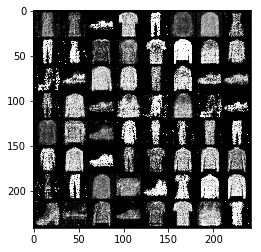

[Epoch 11/50] [Batch 201/938] [D loss: 1.275789] [G loss: 0.990711]
[Epoch 11/50] [Batch 202/938] [D loss: 1.164791] [G loss: 1.004410]
[Epoch 11/50] [Batch 203/938] [D loss: 1.116664] [G loss: 1.017903]
[Epoch 11/50] [Batch 204/938] [D loss: 1.111736] [G loss: 0.985382]
[Epoch 11/50] [Batch 205/938] [D loss: 1.233169] [G loss: 1.069264]
[Epoch 11/50] [Batch 206/938] [D loss: 1.147549] [G loss: 1.082105]
[Epoch 11/50] [Batch 207/938] [D loss: 1.366239] [G loss: 0.974428]
[Epoch 11/50] [Batch 208/938] [D loss: 1.260714] [G loss: 1.052186]
[Epoch 11/50] [Batch 209/938] [D loss: 1.182737] [G loss: 1.008602]
[Epoch 11/50] [Batch 210/938] [D loss: 1.224492] [G loss: 1.017298]
[Epoch 11/50] [Batch 211/938] [D loss: 1.089604] [G loss: 1.037852]
[Epoch 11/50] [Batch 212/938] [D loss: 1.254365] [G loss: 1.065582]
[Epoch 11/50] [Batch 213/938] [D loss: 1.120180] [G loss: 0.953334]
[Epoch 11/50] [Batch 214/938] [D loss: 1.158633] [G loss: 1.024127]
[Epoch 11/50] [Batch 215/938] [D loss: 1.256740]

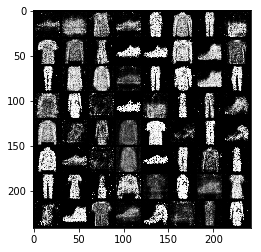

[Epoch 11/50] [Batch 401/938] [D loss: 1.119440] [G loss: 1.067622]
[Epoch 11/50] [Batch 402/938] [D loss: 1.146793] [G loss: 1.098659]
[Epoch 11/50] [Batch 403/938] [D loss: 1.147070] [G loss: 1.098733]
[Epoch 11/50] [Batch 404/938] [D loss: 1.236462] [G loss: 1.185193]
[Epoch 11/50] [Batch 405/938] [D loss: 1.167278] [G loss: 1.068002]
[Epoch 11/50] [Batch 406/938] [D loss: 1.302315] [G loss: 1.061321]
[Epoch 11/50] [Batch 407/938] [D loss: 1.391225] [G loss: 1.137164]
[Epoch 11/50] [Batch 408/938] [D loss: 1.095623] [G loss: 1.211388]
[Epoch 11/50] [Batch 409/938] [D loss: 1.318110] [G loss: 1.095066]
[Epoch 11/50] [Batch 410/938] [D loss: 1.119932] [G loss: 1.058773]
[Epoch 11/50] [Batch 411/938] [D loss: 1.269456] [G loss: 1.009123]
[Epoch 11/50] [Batch 412/938] [D loss: 1.212483] [G loss: 1.067533]
[Epoch 11/50] [Batch 413/938] [D loss: 1.124058] [G loss: 1.040431]
[Epoch 11/50] [Batch 414/938] [D loss: 1.270444] [G loss: 0.996412]
[Epoch 11/50] [Batch 415/938] [D loss: 1.287693]

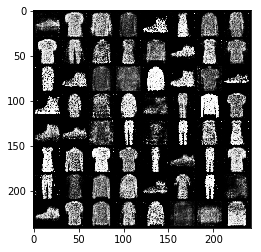

[Epoch 11/50] [Batch 601/938] [D loss: 1.266303] [G loss: 1.074364]
[Epoch 11/50] [Batch 602/938] [D loss: 1.192837] [G loss: 1.117301]
[Epoch 11/50] [Batch 603/938] [D loss: 1.275802] [G loss: 0.984745]
[Epoch 11/50] [Batch 604/938] [D loss: 1.177924] [G loss: 1.040139]
[Epoch 11/50] [Batch 605/938] [D loss: 1.240898] [G loss: 1.039727]
[Epoch 11/50] [Batch 606/938] [D loss: 1.205303] [G loss: 0.962415]
[Epoch 11/50] [Batch 607/938] [D loss: 1.390440] [G loss: 1.002962]
[Epoch 11/50] [Batch 608/938] [D loss: 1.047664] [G loss: 1.070576]
[Epoch 11/50] [Batch 609/938] [D loss: 1.188126] [G loss: 0.929531]
[Epoch 11/50] [Batch 610/938] [D loss: 1.115012] [G loss: 1.086489]
[Epoch 11/50] [Batch 611/938] [D loss: 1.250064] [G loss: 1.155229]
[Epoch 11/50] [Batch 612/938] [D loss: 1.226695] [G loss: 1.058043]
[Epoch 11/50] [Batch 613/938] [D loss: 1.192837] [G loss: 1.116387]
[Epoch 11/50] [Batch 614/938] [D loss: 1.120622] [G loss: 1.095959]
[Epoch 11/50] [Batch 615/938] [D loss: 1.180725]

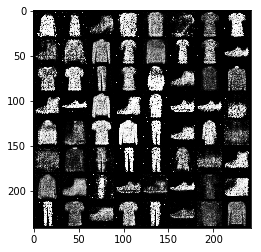

[Epoch 11/50] [Batch 801/938] [D loss: 1.172329] [G loss: 1.030585]
[Epoch 11/50] [Batch 802/938] [D loss: 1.215279] [G loss: 1.006072]
[Epoch 11/50] [Batch 803/938] [D loss: 1.297890] [G loss: 1.048720]
[Epoch 11/50] [Batch 804/938] [D loss: 1.207430] [G loss: 1.041729]
[Epoch 11/50] [Batch 805/938] [D loss: 1.233148] [G loss: 1.052820]
[Epoch 11/50] [Batch 806/938] [D loss: 1.231138] [G loss: 1.042435]
[Epoch 11/50] [Batch 807/938] [D loss: 1.155285] [G loss: 0.982403]
[Epoch 11/50] [Batch 808/938] [D loss: 1.153613] [G loss: 1.066761]
[Epoch 11/50] [Batch 809/938] [D loss: 1.084464] [G loss: 1.006512]
[Epoch 11/50] [Batch 810/938] [D loss: 1.222867] [G loss: 1.027691]
[Epoch 11/50] [Batch 811/938] [D loss: 1.104862] [G loss: 1.016203]
[Epoch 11/50] [Batch 812/938] [D loss: 1.166465] [G loss: 0.948910]
[Epoch 11/50] [Batch 813/938] [D loss: 1.147097] [G loss: 1.032672]
[Epoch 11/50] [Batch 814/938] [D loss: 1.154959] [G loss: 1.063715]
[Epoch 11/50] [Batch 815/938] [D loss: 1.125144]

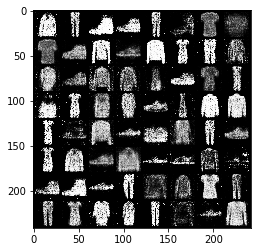

[Epoch 12/50] [Batch 1/938] [D loss: 1.151531] [G loss: 1.000223]
[Epoch 12/50] [Batch 2/938] [D loss: 1.207622] [G loss: 1.068073]
[Epoch 12/50] [Batch 3/938] [D loss: 1.174189] [G loss: 1.063593]
[Epoch 12/50] [Batch 4/938] [D loss: 1.126494] [G loss: 1.032161]
[Epoch 12/50] [Batch 5/938] [D loss: 1.196944] [G loss: 0.981570]
[Epoch 12/50] [Batch 6/938] [D loss: 1.160715] [G loss: 1.081795]
[Epoch 12/50] [Batch 7/938] [D loss: 1.214415] [G loss: 1.026120]
[Epoch 12/50] [Batch 8/938] [D loss: 1.177447] [G loss: 1.056589]
[Epoch 12/50] [Batch 9/938] [D loss: 1.118383] [G loss: 1.023050]
[Epoch 12/50] [Batch 10/938] [D loss: 1.120208] [G loss: 0.975923]
[Epoch 12/50] [Batch 11/938] [D loss: 1.178641] [G loss: 1.067714]
[Epoch 12/50] [Batch 12/938] [D loss: 1.233169] [G loss: 1.072003]
[Epoch 12/50] [Batch 13/938] [D loss: 1.133827] [G loss: 1.026934]
[Epoch 12/50] [Batch 14/938] [D loss: 1.191813] [G loss: 0.987056]
[Epoch 12/50] [Batch 15/938] [D loss: 1.235223] [G loss: 1.025797]
[Epo

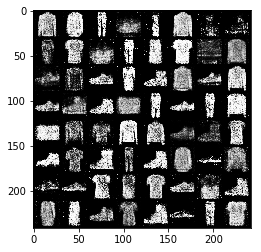

[Epoch 12/50] [Batch 201/938] [D loss: 1.169883] [G loss: 1.111013]
[Epoch 12/50] [Batch 202/938] [D loss: 1.189560] [G loss: 1.056483]
[Epoch 12/50] [Batch 203/938] [D loss: 1.070640] [G loss: 1.116222]
[Epoch 12/50] [Batch 204/938] [D loss: 1.255064] [G loss: 1.142025]
[Epoch 12/50] [Batch 205/938] [D loss: 1.198870] [G loss: 1.030494]
[Epoch 12/50] [Batch 206/938] [D loss: 1.109162] [G loss: 1.019989]
[Epoch 12/50] [Batch 207/938] [D loss: 1.194142] [G loss: 1.144677]
[Epoch 12/50] [Batch 208/938] [D loss: 1.203798] [G loss: 1.174703]
[Epoch 12/50] [Batch 209/938] [D loss: 1.217180] [G loss: 1.163809]
[Epoch 12/50] [Batch 210/938] [D loss: 1.214502] [G loss: 1.082032]
[Epoch 12/50] [Batch 211/938] [D loss: 1.160401] [G loss: 0.960447]
[Epoch 12/50] [Batch 212/938] [D loss: 1.278415] [G loss: 1.029710]
[Epoch 12/50] [Batch 213/938] [D loss: 1.238467] [G loss: 0.946344]
[Epoch 12/50] [Batch 214/938] [D loss: 1.219517] [G loss: 1.059895]
[Epoch 12/50] [Batch 215/938] [D loss: 1.102288]

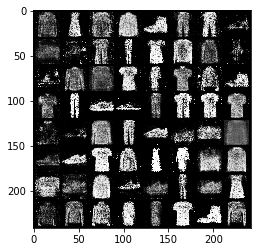

[Epoch 12/50] [Batch 401/938] [D loss: 1.149547] [G loss: 0.971009]
[Epoch 12/50] [Batch 402/938] [D loss: 1.264422] [G loss: 0.982513]
[Epoch 12/50] [Batch 403/938] [D loss: 1.194152] [G loss: 1.046655]
[Epoch 12/50] [Batch 404/938] [D loss: 1.139639] [G loss: 0.973707]
[Epoch 12/50] [Batch 405/938] [D loss: 1.182267] [G loss: 1.023718]
[Epoch 12/50] [Batch 406/938] [D loss: 1.239869] [G loss: 1.057430]
[Epoch 12/50] [Batch 407/938] [D loss: 1.218487] [G loss: 1.037554]
[Epoch 12/50] [Batch 408/938] [D loss: 1.353045] [G loss: 1.039668]
[Epoch 12/50] [Batch 409/938] [D loss: 1.251060] [G loss: 1.068958]
[Epoch 12/50] [Batch 410/938] [D loss: 1.246034] [G loss: 1.023139]
[Epoch 12/50] [Batch 411/938] [D loss: 1.104138] [G loss: 0.940682]
[Epoch 12/50] [Batch 412/938] [D loss: 1.247633] [G loss: 0.936825]
[Epoch 12/50] [Batch 413/938] [D loss: 1.225467] [G loss: 1.035351]
[Epoch 12/50] [Batch 414/938] [D loss: 1.112963] [G loss: 1.083336]
[Epoch 12/50] [Batch 415/938] [D loss: 0.999405]

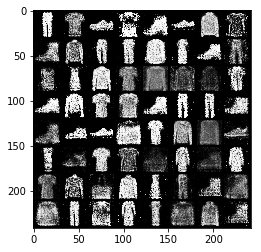

[Epoch 12/50] [Batch 601/938] [D loss: 1.198661] [G loss: 0.998896]
[Epoch 12/50] [Batch 602/938] [D loss: 1.239668] [G loss: 0.989919]
[Epoch 12/50] [Batch 603/938] [D loss: 1.311839] [G loss: 0.899496]
[Epoch 12/50] [Batch 604/938] [D loss: 1.257632] [G loss: 0.992233]
[Epoch 12/50] [Batch 605/938] [D loss: 1.208629] [G loss: 1.021790]
[Epoch 12/50] [Batch 606/938] [D loss: 1.246690] [G loss: 1.015488]
[Epoch 12/50] [Batch 607/938] [D loss: 1.198383] [G loss: 1.005433]
[Epoch 12/50] [Batch 608/938] [D loss: 1.196835] [G loss: 1.017449]
[Epoch 12/50] [Batch 609/938] [D loss: 1.314836] [G loss: 1.021178]
[Epoch 12/50] [Batch 610/938] [D loss: 1.291892] [G loss: 0.960364]
[Epoch 12/50] [Batch 611/938] [D loss: 1.101449] [G loss: 1.003128]
[Epoch 12/50] [Batch 612/938] [D loss: 1.250148] [G loss: 0.940027]
[Epoch 12/50] [Batch 613/938] [D loss: 1.169930] [G loss: 0.937703]
[Epoch 12/50] [Batch 614/938] [D loss: 1.278072] [G loss: 0.990981]
[Epoch 12/50] [Batch 615/938] [D loss: 1.187968]

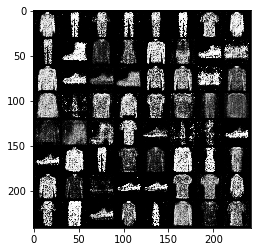

[Epoch 12/50] [Batch 801/938] [D loss: 1.225144] [G loss: 0.964631]
[Epoch 12/50] [Batch 802/938] [D loss: 1.265981] [G loss: 0.938930]
[Epoch 12/50] [Batch 803/938] [D loss: 1.278195] [G loss: 0.951055]
[Epoch 12/50] [Batch 804/938] [D loss: 1.170821] [G loss: 1.012753]
[Epoch 12/50] [Batch 805/938] [D loss: 1.171782] [G loss: 0.966580]
[Epoch 12/50] [Batch 806/938] [D loss: 1.211170] [G loss: 0.947965]
[Epoch 12/50] [Batch 807/938] [D loss: 1.176724] [G loss: 0.953037]
[Epoch 12/50] [Batch 808/938] [D loss: 1.263028] [G loss: 1.024080]
[Epoch 12/50] [Batch 809/938] [D loss: 1.163941] [G loss: 1.115241]
[Epoch 12/50] [Batch 810/938] [D loss: 1.123159] [G loss: 0.994861]
[Epoch 12/50] [Batch 811/938] [D loss: 1.235506] [G loss: 0.989613]
[Epoch 12/50] [Batch 812/938] [D loss: 1.234429] [G loss: 0.954688]
[Epoch 12/50] [Batch 813/938] [D loss: 1.233648] [G loss: 0.930388]
[Epoch 12/50] [Batch 814/938] [D loss: 1.265705] [G loss: 0.929767]
[Epoch 12/50] [Batch 815/938] [D loss: 1.259505]

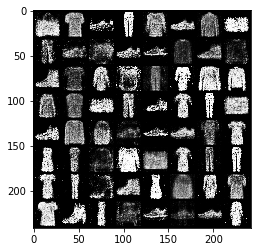

[Epoch 13/50] [Batch 1/938] [D loss: 1.306571] [G loss: 1.084351]
[Epoch 13/50] [Batch 2/938] [D loss: 1.165284] [G loss: 0.992060]
[Epoch 13/50] [Batch 3/938] [D loss: 1.240944] [G loss: 0.955505]
[Epoch 13/50] [Batch 4/938] [D loss: 1.416069] [G loss: 1.008153]
[Epoch 13/50] [Batch 5/938] [D loss: 1.248861] [G loss: 1.025569]
[Epoch 13/50] [Batch 6/938] [D loss: 1.229783] [G loss: 0.992601]
[Epoch 13/50] [Batch 7/938] [D loss: 1.267106] [G loss: 0.924897]
[Epoch 13/50] [Batch 8/938] [D loss: 1.224756] [G loss: 0.987747]
[Epoch 13/50] [Batch 9/938] [D loss: 1.189630] [G loss: 1.018872]
[Epoch 13/50] [Batch 10/938] [D loss: 1.162453] [G loss: 0.971659]
[Epoch 13/50] [Batch 11/938] [D loss: 1.171352] [G loss: 1.038362]
[Epoch 13/50] [Batch 12/938] [D loss: 1.233043] [G loss: 0.987755]
[Epoch 13/50] [Batch 13/938] [D loss: 1.183062] [G loss: 0.948611]
[Epoch 13/50] [Batch 14/938] [D loss: 1.167280] [G loss: 0.927186]
[Epoch 13/50] [Batch 15/938] [D loss: 1.230406] [G loss: 1.022820]
[Epo

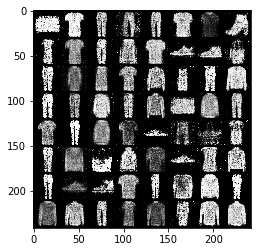

[Epoch 13/50] [Batch 201/938] [D loss: 1.151492] [G loss: 0.918675]
[Epoch 13/50] [Batch 202/938] [D loss: 1.267907] [G loss: 0.949039]
[Epoch 13/50] [Batch 203/938] [D loss: 1.286190] [G loss: 0.995040]
[Epoch 13/50] [Batch 204/938] [D loss: 1.100695] [G loss: 1.032762]
[Epoch 13/50] [Batch 205/938] [D loss: 1.255603] [G loss: 1.017332]
[Epoch 13/50] [Batch 206/938] [D loss: 1.291535] [G loss: 1.033437]
[Epoch 13/50] [Batch 207/938] [D loss: 1.206352] [G loss: 1.015766]
[Epoch 13/50] [Batch 208/938] [D loss: 1.122874] [G loss: 1.038724]
[Epoch 13/50] [Batch 209/938] [D loss: 1.284463] [G loss: 1.001122]
[Epoch 13/50] [Batch 210/938] [D loss: 1.155075] [G loss: 1.080391]
[Epoch 13/50] [Batch 211/938] [D loss: 1.236859] [G loss: 1.057546]
[Epoch 13/50] [Batch 212/938] [D loss: 1.136498] [G loss: 1.061450]
[Epoch 13/50] [Batch 213/938] [D loss: 1.180181] [G loss: 1.000342]
[Epoch 13/50] [Batch 214/938] [D loss: 1.177061] [G loss: 0.893941]
[Epoch 13/50] [Batch 215/938] [D loss: 1.140087]

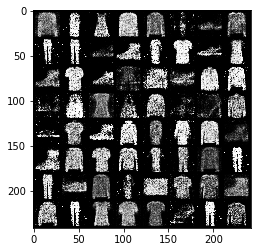

[Epoch 13/50] [Batch 401/938] [D loss: 1.142683] [G loss: 1.028334]
[Epoch 13/50] [Batch 402/938] [D loss: 1.211489] [G loss: 1.038971]
[Epoch 13/50] [Batch 403/938] [D loss: 1.211588] [G loss: 1.060637]
[Epoch 13/50] [Batch 404/938] [D loss: 1.178185] [G loss: 1.008552]
[Epoch 13/50] [Batch 405/938] [D loss: 1.298924] [G loss: 1.026162]
[Epoch 13/50] [Batch 406/938] [D loss: 1.375823] [G loss: 1.035041]
[Epoch 13/50] [Batch 407/938] [D loss: 1.263361] [G loss: 1.068349]
[Epoch 13/50] [Batch 408/938] [D loss: 1.118705] [G loss: 1.014999]
[Epoch 13/50] [Batch 409/938] [D loss: 1.272566] [G loss: 0.989885]
[Epoch 13/50] [Batch 410/938] [D loss: 1.227804] [G loss: 1.024928]
[Epoch 13/50] [Batch 411/938] [D loss: 1.368881] [G loss: 1.010354]
[Epoch 13/50] [Batch 412/938] [D loss: 1.205898] [G loss: 1.032440]
[Epoch 13/50] [Batch 413/938] [D loss: 1.256968] [G loss: 0.968859]
[Epoch 13/50] [Batch 414/938] [D loss: 1.236905] [G loss: 1.069879]
[Epoch 13/50] [Batch 415/938] [D loss: 1.309213]

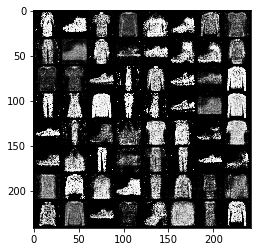

[Epoch 13/50] [Batch 601/938] [D loss: 1.312427] [G loss: 0.950892]
[Epoch 13/50] [Batch 602/938] [D loss: 1.182981] [G loss: 0.936988]
[Epoch 13/50] [Batch 603/938] [D loss: 1.210504] [G loss: 0.859398]
[Epoch 13/50] [Batch 604/938] [D loss: 1.185292] [G loss: 0.950553]
[Epoch 13/50] [Batch 605/938] [D loss: 1.203029] [G loss: 1.041262]
[Epoch 13/50] [Batch 606/938] [D loss: 1.163120] [G loss: 1.016631]
[Epoch 13/50] [Batch 607/938] [D loss: 1.282066] [G loss: 1.038816]
[Epoch 13/50] [Batch 608/938] [D loss: 1.186794] [G loss: 1.085503]
[Epoch 13/50] [Batch 609/938] [D loss: 1.223323] [G loss: 0.960582]
[Epoch 13/50] [Batch 610/938] [D loss: 1.228083] [G loss: 0.920447]
[Epoch 13/50] [Batch 611/938] [D loss: 1.260652] [G loss: 0.961928]
[Epoch 13/50] [Batch 612/938] [D loss: 1.235805] [G loss: 1.016819]
[Epoch 13/50] [Batch 613/938] [D loss: 1.317043] [G loss: 1.028526]
[Epoch 13/50] [Batch 614/938] [D loss: 1.184934] [G loss: 1.040548]
[Epoch 13/50] [Batch 615/938] [D loss: 1.125204]

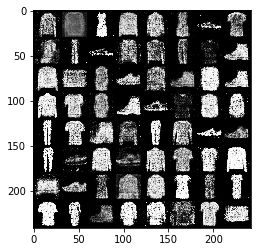

[Epoch 13/50] [Batch 801/938] [D loss: 1.235868] [G loss: 0.993926]
[Epoch 13/50] [Batch 802/938] [D loss: 1.214252] [G loss: 1.053767]
[Epoch 13/50] [Batch 803/938] [D loss: 1.317821] [G loss: 1.085321]
[Epoch 13/50] [Batch 804/938] [D loss: 1.296338] [G loss: 0.987141]
[Epoch 13/50] [Batch 805/938] [D loss: 1.271966] [G loss: 1.067191]
[Epoch 13/50] [Batch 806/938] [D loss: 1.279940] [G loss: 1.001484]
[Epoch 13/50] [Batch 807/938] [D loss: 1.358292] [G loss: 0.928070]
[Epoch 13/50] [Batch 808/938] [D loss: 1.250892] [G loss: 1.000890]
[Epoch 13/50] [Batch 809/938] [D loss: 1.251993] [G loss: 0.942350]
[Epoch 13/50] [Batch 810/938] [D loss: 1.114276] [G loss: 0.928403]
[Epoch 13/50] [Batch 811/938] [D loss: 1.140861] [G loss: 0.937582]
[Epoch 13/50] [Batch 812/938] [D loss: 1.126215] [G loss: 0.999295]
[Epoch 13/50] [Batch 813/938] [D loss: 1.171709] [G loss: 0.998920]
[Epoch 13/50] [Batch 814/938] [D loss: 1.263132] [G loss: 1.072461]
[Epoch 13/50] [Batch 815/938] [D loss: 1.154124]

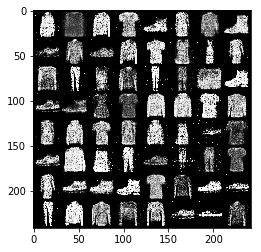

[Epoch 14/50] [Batch 1/938] [D loss: 1.015803] [G loss: 1.047747]
[Epoch 14/50] [Batch 2/938] [D loss: 1.156858] [G loss: 0.974044]
[Epoch 14/50] [Batch 3/938] [D loss: 1.231861] [G loss: 0.955415]
[Epoch 14/50] [Batch 4/938] [D loss: 1.157561] [G loss: 1.019762]
[Epoch 14/50] [Batch 5/938] [D loss: 1.216853] [G loss: 0.988609]
[Epoch 14/50] [Batch 6/938] [D loss: 1.236528] [G loss: 0.972670]
[Epoch 14/50] [Batch 7/938] [D loss: 1.233258] [G loss: 1.044542]
[Epoch 14/50] [Batch 8/938] [D loss: 1.135352] [G loss: 0.995264]
[Epoch 14/50] [Batch 9/938] [D loss: 1.346578] [G loss: 1.041382]
[Epoch 14/50] [Batch 10/938] [D loss: 1.249917] [G loss: 1.170692]
[Epoch 14/50] [Batch 11/938] [D loss: 1.302998] [G loss: 1.049034]
[Epoch 14/50] [Batch 12/938] [D loss: 1.222454] [G loss: 0.977764]
[Epoch 14/50] [Batch 13/938] [D loss: 1.158548] [G loss: 0.936044]
[Epoch 14/50] [Batch 14/938] [D loss: 1.248697] [G loss: 0.885577]
[Epoch 14/50] [Batch 15/938] [D loss: 1.209468] [G loss: 0.946635]
[Epo

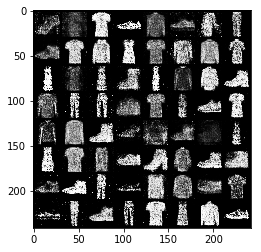

[Epoch 14/50] [Batch 201/938] [D loss: 1.238056] [G loss: 1.050211]
[Epoch 14/50] [Batch 202/938] [D loss: 1.219170] [G loss: 1.110489]
[Epoch 14/50] [Batch 203/938] [D loss: 1.262232] [G loss: 1.036780]
[Epoch 14/50] [Batch 204/938] [D loss: 1.224361] [G loss: 0.966676]
[Epoch 14/50] [Batch 205/938] [D loss: 1.318001] [G loss: 0.915952]
[Epoch 14/50] [Batch 206/938] [D loss: 1.170861] [G loss: 0.985458]
[Epoch 14/50] [Batch 207/938] [D loss: 1.302206] [G loss: 1.070034]
[Epoch 14/50] [Batch 208/938] [D loss: 1.357012] [G loss: 1.016222]
[Epoch 14/50] [Batch 209/938] [D loss: 1.257221] [G loss: 1.095437]
[Epoch 14/50] [Batch 210/938] [D loss: 1.318076] [G loss: 1.078637]
[Epoch 14/50] [Batch 211/938] [D loss: 1.313737] [G loss: 0.991088]
[Epoch 14/50] [Batch 212/938] [D loss: 1.214531] [G loss: 0.946126]
[Epoch 14/50] [Batch 213/938] [D loss: 1.232720] [G loss: 0.979210]
[Epoch 14/50] [Batch 214/938] [D loss: 1.215504] [G loss: 0.992757]
[Epoch 14/50] [Batch 215/938] [D loss: 1.122874]

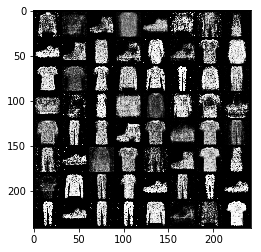

[Epoch 14/50] [Batch 401/938] [D loss: 1.369994] [G loss: 0.937768]
[Epoch 14/50] [Batch 402/938] [D loss: 1.241179] [G loss: 0.917115]
[Epoch 14/50] [Batch 403/938] [D loss: 1.420558] [G loss: 0.935125]
[Epoch 14/50] [Batch 404/938] [D loss: 1.258718] [G loss: 0.959443]
[Epoch 14/50] [Batch 405/938] [D loss: 1.281878] [G loss: 0.890311]
[Epoch 14/50] [Batch 406/938] [D loss: 1.273570] [G loss: 0.946466]
[Epoch 14/50] [Batch 407/938] [D loss: 1.239445] [G loss: 0.923356]
[Epoch 14/50] [Batch 408/938] [D loss: 1.231390] [G loss: 0.939887]
[Epoch 14/50] [Batch 409/938] [D loss: 1.341472] [G loss: 0.947436]
[Epoch 14/50] [Batch 410/938] [D loss: 1.251112] [G loss: 0.926552]
[Epoch 14/50] [Batch 411/938] [D loss: 1.248973] [G loss: 0.960185]
[Epoch 14/50] [Batch 412/938] [D loss: 1.260325] [G loss: 0.904042]
[Epoch 14/50] [Batch 413/938] [D loss: 1.265997] [G loss: 0.888620]
[Epoch 14/50] [Batch 414/938] [D loss: 1.282052] [G loss: 0.839328]
[Epoch 14/50] [Batch 415/938] [D loss: 1.192563]

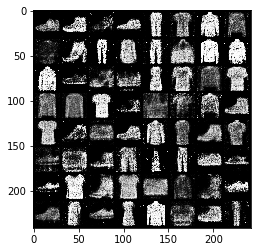

[Epoch 14/50] [Batch 601/938] [D loss: 1.067370] [G loss: 1.099239]
[Epoch 14/50] [Batch 602/938] [D loss: 1.227066] [G loss: 0.994255]
[Epoch 14/50] [Batch 603/938] [D loss: 1.237609] [G loss: 0.937205]
[Epoch 14/50] [Batch 604/938] [D loss: 1.299132] [G loss: 0.911504]
[Epoch 14/50] [Batch 605/938] [D loss: 1.246914] [G loss: 0.857250]
[Epoch 14/50] [Batch 606/938] [D loss: 1.178918] [G loss: 0.876594]
[Epoch 14/50] [Batch 607/938] [D loss: 1.289062] [G loss: 0.925094]
[Epoch 14/50] [Batch 608/938] [D loss: 1.273930] [G loss: 0.914411]
[Epoch 14/50] [Batch 609/938] [D loss: 1.241136] [G loss: 0.926378]
[Epoch 14/50] [Batch 610/938] [D loss: 1.298133] [G loss: 0.871430]
[Epoch 14/50] [Batch 611/938] [D loss: 1.304889] [G loss: 0.942250]
[Epoch 14/50] [Batch 612/938] [D loss: 1.305202] [G loss: 0.941357]
[Epoch 14/50] [Batch 613/938] [D loss: 1.276112] [G loss: 0.942365]
[Epoch 14/50] [Batch 614/938] [D loss: 1.398389] [G loss: 0.953312]
[Epoch 14/50] [Batch 615/938] [D loss: 1.312973]

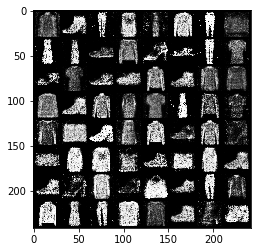

[Epoch 14/50] [Batch 801/938] [D loss: 1.267190] [G loss: 0.939350]
[Epoch 14/50] [Batch 802/938] [D loss: 1.181209] [G loss: 1.044650]
[Epoch 14/50] [Batch 803/938] [D loss: 1.398262] [G loss: 0.968390]
[Epoch 14/50] [Batch 804/938] [D loss: 1.261066] [G loss: 0.982637]
[Epoch 14/50] [Batch 805/938] [D loss: 1.318556] [G loss: 0.935160]
[Epoch 14/50] [Batch 806/938] [D loss: 1.254192] [G loss: 0.958711]
[Epoch 14/50] [Batch 807/938] [D loss: 1.234370] [G loss: 0.959148]
[Epoch 14/50] [Batch 808/938] [D loss: 1.273205] [G loss: 1.017225]
[Epoch 14/50] [Batch 809/938] [D loss: 1.225721] [G loss: 0.953853]
[Epoch 14/50] [Batch 810/938] [D loss: 1.320835] [G loss: 1.011950]
[Epoch 14/50] [Batch 811/938] [D loss: 1.262300] [G loss: 0.978800]
[Epoch 14/50] [Batch 812/938] [D loss: 1.257542] [G loss: 0.924886]
[Epoch 14/50] [Batch 813/938] [D loss: 1.272331] [G loss: 0.936402]
[Epoch 14/50] [Batch 814/938] [D loss: 1.321330] [G loss: 0.936999]
[Epoch 14/50] [Batch 815/938] [D loss: 1.225505]

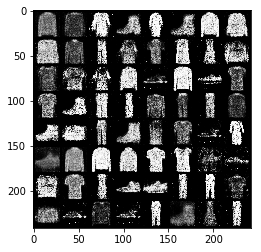

[Epoch 15/50] [Batch 1/938] [D loss: 1.303339] [G loss: 1.043012]
[Epoch 15/50] [Batch 2/938] [D loss: 1.218797] [G loss: 0.977686]
[Epoch 15/50] [Batch 3/938] [D loss: 1.153156] [G loss: 0.951739]
[Epoch 15/50] [Batch 4/938] [D loss: 1.421731] [G loss: 0.975664]
[Epoch 15/50] [Batch 5/938] [D loss: 1.362891] [G loss: 1.049194]
[Epoch 15/50] [Batch 6/938] [D loss: 1.283802] [G loss: 1.044848]
[Epoch 15/50] [Batch 7/938] [D loss: 1.264367] [G loss: 0.980096]
[Epoch 15/50] [Batch 8/938] [D loss: 1.256603] [G loss: 0.893737]
[Epoch 15/50] [Batch 9/938] [D loss: 1.276901] [G loss: 0.893772]
[Epoch 15/50] [Batch 10/938] [D loss: 1.218524] [G loss: 0.912574]
[Epoch 15/50] [Batch 11/938] [D loss: 1.268342] [G loss: 0.931063]
[Epoch 15/50] [Batch 12/938] [D loss: 1.311751] [G loss: 0.971199]
[Epoch 15/50] [Batch 13/938] [D loss: 1.264328] [G loss: 0.932155]
[Epoch 15/50] [Batch 14/938] [D loss: 1.188321] [G loss: 0.955656]
[Epoch 15/50] [Batch 15/938] [D loss: 1.262802] [G loss: 0.898979]
[Epo

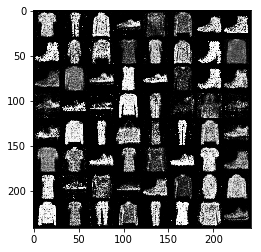

[Epoch 15/50] [Batch 201/938] [D loss: 1.235326] [G loss: 0.925923]
[Epoch 15/50] [Batch 202/938] [D loss: 1.276654] [G loss: 0.939295]
[Epoch 15/50] [Batch 203/938] [D loss: 1.258580] [G loss: 0.931448]
[Epoch 15/50] [Batch 204/938] [D loss: 1.180440] [G loss: 0.906367]
[Epoch 15/50] [Batch 205/938] [D loss: 1.392883] [G loss: 0.888935]
[Epoch 15/50] [Batch 206/938] [D loss: 1.363126] [G loss: 0.970011]
[Epoch 15/50] [Batch 207/938] [D loss: 1.179398] [G loss: 1.001999]
[Epoch 15/50] [Batch 208/938] [D loss: 1.217235] [G loss: 0.988497]
[Epoch 15/50] [Batch 209/938] [D loss: 1.190603] [G loss: 0.901709]
[Epoch 15/50] [Batch 210/938] [D loss: 1.275513] [G loss: 0.911991]
[Epoch 15/50] [Batch 211/938] [D loss: 1.293264] [G loss: 1.010886]
[Epoch 15/50] [Batch 212/938] [D loss: 1.191907] [G loss: 0.999604]
[Epoch 15/50] [Batch 213/938] [D loss: 1.321332] [G loss: 0.929909]
[Epoch 15/50] [Batch 214/938] [D loss: 1.272824] [G loss: 0.923771]
[Epoch 15/50] [Batch 215/938] [D loss: 1.434512]

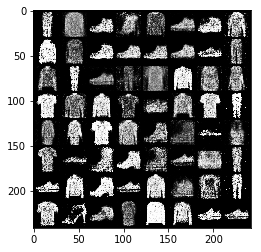

[Epoch 15/50] [Batch 401/938] [D loss: 1.241738] [G loss: 1.004758]
[Epoch 15/50] [Batch 402/938] [D loss: 1.211135] [G loss: 1.008015]
[Epoch 15/50] [Batch 403/938] [D loss: 1.264887] [G loss: 0.968949]
[Epoch 15/50] [Batch 404/938] [D loss: 1.288820] [G loss: 0.970005]
[Epoch 15/50] [Batch 405/938] [D loss: 1.229212] [G loss: 0.959377]
[Epoch 15/50] [Batch 406/938] [D loss: 1.441452] [G loss: 1.006776]
[Epoch 15/50] [Batch 407/938] [D loss: 1.284289] [G loss: 1.036574]
[Epoch 15/50] [Batch 408/938] [D loss: 1.281380] [G loss: 0.997557]
[Epoch 15/50] [Batch 409/938] [D loss: 1.309748] [G loss: 0.981966]
[Epoch 15/50] [Batch 410/938] [D loss: 1.229403] [G loss: 1.017860]
[Epoch 15/50] [Batch 411/938] [D loss: 1.270444] [G loss: 0.968552]
[Epoch 15/50] [Batch 412/938] [D loss: 1.139540] [G loss: 0.910674]
[Epoch 15/50] [Batch 413/938] [D loss: 1.281730] [G loss: 0.918451]
[Epoch 15/50] [Batch 414/938] [D loss: 1.212520] [G loss: 0.948382]
[Epoch 15/50] [Batch 415/938] [D loss: 1.194765]

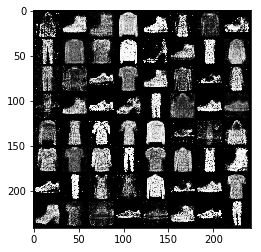

[Epoch 15/50] [Batch 601/938] [D loss: 1.161326] [G loss: 1.066551]
[Epoch 15/50] [Batch 602/938] [D loss: 1.247378] [G loss: 0.921334]
[Epoch 15/50] [Batch 603/938] [D loss: 1.320695] [G loss: 0.948305]
[Epoch 15/50] [Batch 604/938] [D loss: 1.412101] [G loss: 0.903630]
[Epoch 15/50] [Batch 605/938] [D loss: 1.269506] [G loss: 0.896433]
[Epoch 15/50] [Batch 606/938] [D loss: 1.252704] [G loss: 0.953952]
[Epoch 15/50] [Batch 607/938] [D loss: 1.175089] [G loss: 0.900306]
[Epoch 15/50] [Batch 608/938] [D loss: 1.130212] [G loss: 0.957563]
[Epoch 15/50] [Batch 609/938] [D loss: 1.112917] [G loss: 0.920194]
[Epoch 15/50] [Batch 610/938] [D loss: 1.193705] [G loss: 0.985373]
[Epoch 15/50] [Batch 611/938] [D loss: 1.276652] [G loss: 1.010244]
[Epoch 15/50] [Batch 612/938] [D loss: 1.142440] [G loss: 1.032267]
[Epoch 15/50] [Batch 613/938] [D loss: 1.118961] [G loss: 0.971736]
[Epoch 15/50] [Batch 614/938] [D loss: 1.295400] [G loss: 0.974424]
[Epoch 15/50] [Batch 615/938] [D loss: 1.334222]

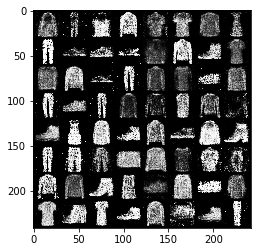

[Epoch 15/50] [Batch 801/938] [D loss: 1.301583] [G loss: 1.007827]
[Epoch 15/50] [Batch 802/938] [D loss: 1.295678] [G loss: 0.869949]
[Epoch 15/50] [Batch 803/938] [D loss: 1.231581] [G loss: 0.968861]
[Epoch 15/50] [Batch 804/938] [D loss: 1.180923] [G loss: 0.919518]
[Epoch 15/50] [Batch 805/938] [D loss: 1.233865] [G loss: 0.903943]
[Epoch 15/50] [Batch 806/938] [D loss: 1.220485] [G loss: 0.914827]
[Epoch 15/50] [Batch 807/938] [D loss: 1.300256] [G loss: 0.859650]
[Epoch 15/50] [Batch 808/938] [D loss: 1.234174] [G loss: 0.877133]
[Epoch 15/50] [Batch 809/938] [D loss: 1.324650] [G loss: 0.991172]
[Epoch 15/50] [Batch 810/938] [D loss: 1.176649] [G loss: 0.990665]
[Epoch 15/50] [Batch 811/938] [D loss: 1.280891] [G loss: 0.937056]
[Epoch 15/50] [Batch 812/938] [D loss: 1.224609] [G loss: 0.967856]
[Epoch 15/50] [Batch 813/938] [D loss: 1.317353] [G loss: 0.961504]
[Epoch 15/50] [Batch 814/938] [D loss: 1.243067] [G loss: 0.990420]
[Epoch 15/50] [Batch 815/938] [D loss: 1.275614]

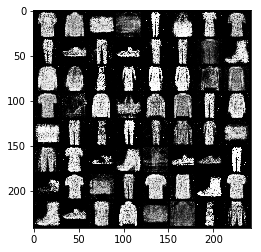

[Epoch 16/50] [Batch 1/938] [D loss: 1.181496] [G loss: 1.001762]
[Epoch 16/50] [Batch 2/938] [D loss: 1.289269] [G loss: 0.921250]
[Epoch 16/50] [Batch 3/938] [D loss: 1.349321] [G loss: 0.980811]
[Epoch 16/50] [Batch 4/938] [D loss: 1.462453] [G loss: 1.003915]
[Epoch 16/50] [Batch 5/938] [D loss: 1.263769] [G loss: 1.000622]
[Epoch 16/50] [Batch 6/938] [D loss: 1.247980] [G loss: 0.954364]
[Epoch 16/50] [Batch 7/938] [D loss: 1.353682] [G loss: 0.887398]
[Epoch 16/50] [Batch 8/938] [D loss: 1.259382] [G loss: 0.946022]
[Epoch 16/50] [Batch 9/938] [D loss: 1.306576] [G loss: 0.920863]
[Epoch 16/50] [Batch 10/938] [D loss: 1.223183] [G loss: 0.909674]
[Epoch 16/50] [Batch 11/938] [D loss: 1.198343] [G loss: 0.913431]
[Epoch 16/50] [Batch 12/938] [D loss: 1.307997] [G loss: 0.836814]
[Epoch 16/50] [Batch 13/938] [D loss: 1.169770] [G loss: 0.913786]
[Epoch 16/50] [Batch 14/938] [D loss: 1.270094] [G loss: 0.849754]
[Epoch 16/50] [Batch 15/938] [D loss: 1.264492] [G loss: 0.928802]
[Epo

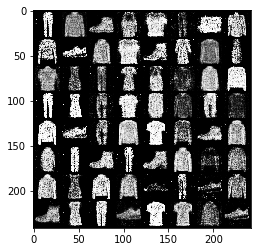

[Epoch 16/50] [Batch 201/938] [D loss: 1.345087] [G loss: 0.883834]
[Epoch 16/50] [Batch 202/938] [D loss: 1.354047] [G loss: 0.850952]
[Epoch 16/50] [Batch 203/938] [D loss: 1.269667] [G loss: 0.899507]
[Epoch 16/50] [Batch 204/938] [D loss: 1.259067] [G loss: 0.839089]
[Epoch 16/50] [Batch 205/938] [D loss: 1.243659] [G loss: 0.900291]
[Epoch 16/50] [Batch 206/938] [D loss: 1.269978] [G loss: 0.885301]
[Epoch 16/50] [Batch 207/938] [D loss: 1.287309] [G loss: 0.954492]
[Epoch 16/50] [Batch 208/938] [D loss: 1.212474] [G loss: 0.882627]
[Epoch 16/50] [Batch 209/938] [D loss: 1.325448] [G loss: 0.970967]
[Epoch 16/50] [Batch 210/938] [D loss: 1.366855] [G loss: 0.970467]
[Epoch 16/50] [Batch 211/938] [D loss: 1.251310] [G loss: 0.993343]
[Epoch 16/50] [Batch 212/938] [D loss: 1.274554] [G loss: 0.921848]
[Epoch 16/50] [Batch 213/938] [D loss: 1.407361] [G loss: 0.902414]
[Epoch 16/50] [Batch 214/938] [D loss: 1.209163] [G loss: 0.926119]
[Epoch 16/50] [Batch 215/938] [D loss: 1.200103]

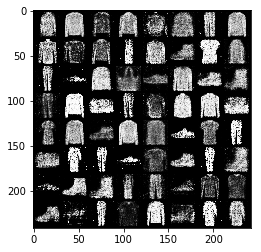

[Epoch 16/50] [Batch 401/938] [D loss: 1.147581] [G loss: 0.956518]
[Epoch 16/50] [Batch 402/938] [D loss: 1.162153] [G loss: 0.988183]
[Epoch 16/50] [Batch 403/938] [D loss: 1.269914] [G loss: 0.964341]
[Epoch 16/50] [Batch 404/938] [D loss: 1.310942] [G loss: 0.950850]
[Epoch 16/50] [Batch 405/938] [D loss: 1.335351] [G loss: 0.891270]
[Epoch 16/50] [Batch 406/938] [D loss: 1.343482] [G loss: 0.922398]
[Epoch 16/50] [Batch 407/938] [D loss: 1.294464] [G loss: 0.913871]
[Epoch 16/50] [Batch 408/938] [D loss: 1.365323] [G loss: 0.915155]
[Epoch 16/50] [Batch 409/938] [D loss: 1.307532] [G loss: 0.889261]
[Epoch 16/50] [Batch 410/938] [D loss: 1.309958] [G loss: 0.903892]
[Epoch 16/50] [Batch 411/938] [D loss: 1.276539] [G loss: 0.853348]
[Epoch 16/50] [Batch 412/938] [D loss: 1.334509] [G loss: 0.900701]
[Epoch 16/50] [Batch 413/938] [D loss: 1.199405] [G loss: 0.905858]
[Epoch 16/50] [Batch 414/938] [D loss: 1.232138] [G loss: 0.853978]
[Epoch 16/50] [Batch 415/938] [D loss: 1.337384]

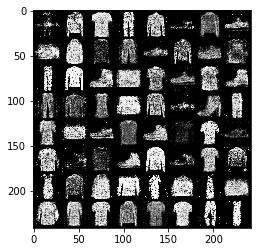

[Epoch 16/50] [Batch 601/938] [D loss: 1.092037] [G loss: 1.011501]
[Epoch 16/50] [Batch 602/938] [D loss: 1.174973] [G loss: 0.991362]
[Epoch 16/50] [Batch 603/938] [D loss: 1.201569] [G loss: 0.960913]
[Epoch 16/50] [Batch 604/938] [D loss: 1.471031] [G loss: 1.062188]
[Epoch 16/50] [Batch 605/938] [D loss: 1.288913] [G loss: 0.957391]
[Epoch 16/50] [Batch 606/938] [D loss: 1.365772] [G loss: 1.019073]
[Epoch 16/50] [Batch 607/938] [D loss: 1.087631] [G loss: 0.990424]
[Epoch 16/50] [Batch 608/938] [D loss: 1.269629] [G loss: 0.927854]
[Epoch 16/50] [Batch 609/938] [D loss: 1.185601] [G loss: 0.994099]
[Epoch 16/50] [Batch 610/938] [D loss: 1.222218] [G loss: 0.950435]
[Epoch 16/50] [Batch 611/938] [D loss: 1.279685] [G loss: 0.948690]
[Epoch 16/50] [Batch 612/938] [D loss: 1.161579] [G loss: 1.003034]
[Epoch 16/50] [Batch 613/938] [D loss: 1.307163] [G loss: 0.998849]
[Epoch 16/50] [Batch 614/938] [D loss: 1.208921] [G loss: 0.995256]
[Epoch 16/50] [Batch 615/938] [D loss: 1.235623]

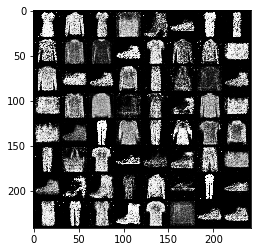

[Epoch 16/50] [Batch 801/938] [D loss: 1.179232] [G loss: 0.895968]
[Epoch 16/50] [Batch 802/938] [D loss: 1.255541] [G loss: 0.886375]
[Epoch 16/50] [Batch 803/938] [D loss: 1.260966] [G loss: 0.928977]
[Epoch 16/50] [Batch 804/938] [D loss: 1.334069] [G loss: 0.982413]
[Epoch 16/50] [Batch 805/938] [D loss: 1.242750] [G loss: 1.003091]
[Epoch 16/50] [Batch 806/938] [D loss: 1.199061] [G loss: 0.987715]
[Epoch 16/50] [Batch 807/938] [D loss: 1.245371] [G loss: 0.912165]
[Epoch 16/50] [Batch 808/938] [D loss: 1.213189] [G loss: 0.907569]
[Epoch 16/50] [Batch 809/938] [D loss: 1.159259] [G loss: 0.956565]
[Epoch 16/50] [Batch 810/938] [D loss: 1.132283] [G loss: 0.954572]
[Epoch 16/50] [Batch 811/938] [D loss: 1.210124] [G loss: 0.959298]
[Epoch 16/50] [Batch 812/938] [D loss: 1.269478] [G loss: 0.994911]
[Epoch 16/50] [Batch 813/938] [D loss: 1.290007] [G loss: 0.951129]
[Epoch 16/50] [Batch 814/938] [D loss: 1.135520] [G loss: 1.087490]
[Epoch 16/50] [Batch 815/938] [D loss: 1.168888]

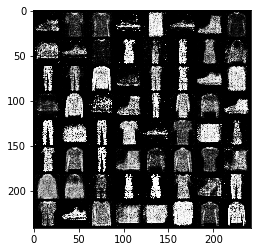

[Epoch 17/50] [Batch 1/938] [D loss: 1.247998] [G loss: 0.913824]
[Epoch 17/50] [Batch 2/938] [D loss: 1.302484] [G loss: 0.877100]
[Epoch 17/50] [Batch 3/938] [D loss: 1.311102] [G loss: 0.928194]
[Epoch 17/50] [Batch 4/938] [D loss: 1.171066] [G loss: 0.894015]
[Epoch 17/50] [Batch 5/938] [D loss: 1.201217] [G loss: 0.865999]
[Epoch 17/50] [Batch 6/938] [D loss: 1.232503] [G loss: 0.863533]
[Epoch 17/50] [Batch 7/938] [D loss: 1.278444] [G loss: 0.862312]
[Epoch 17/50] [Batch 8/938] [D loss: 1.263187] [G loss: 1.004484]
[Epoch 17/50] [Batch 9/938] [D loss: 1.254351] [G loss: 0.940462]
[Epoch 17/50] [Batch 10/938] [D loss: 1.312527] [G loss: 0.986219]
[Epoch 17/50] [Batch 11/938] [D loss: 1.208642] [G loss: 0.972622]
[Epoch 17/50] [Batch 12/938] [D loss: 1.198511] [G loss: 0.955002]
[Epoch 17/50] [Batch 13/938] [D loss: 1.274831] [G loss: 0.986484]
[Epoch 17/50] [Batch 14/938] [D loss: 1.290767] [G loss: 0.975758]
[Epoch 17/50] [Batch 15/938] [D loss: 1.194987] [G loss: 0.953723]
[Epo

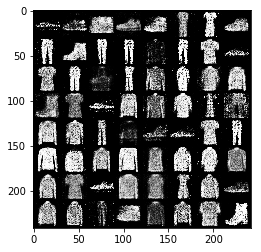

[Epoch 17/50] [Batch 201/938] [D loss: 1.374688] [G loss: 0.929769]
[Epoch 17/50] [Batch 202/938] [D loss: 1.213615] [G loss: 0.954331]
[Epoch 17/50] [Batch 203/938] [D loss: 1.344202] [G loss: 0.922389]
[Epoch 17/50] [Batch 204/938] [D loss: 1.278532] [G loss: 0.938375]
[Epoch 17/50] [Batch 205/938] [D loss: 1.206833] [G loss: 0.945484]
[Epoch 17/50] [Batch 206/938] [D loss: 1.257363] [G loss: 0.901769]
[Epoch 17/50] [Batch 207/938] [D loss: 1.371572] [G loss: 0.966476]
[Epoch 17/50] [Batch 208/938] [D loss: 1.295564] [G loss: 0.944865]
[Epoch 17/50] [Batch 209/938] [D loss: 1.232636] [G loss: 0.948751]
[Epoch 17/50] [Batch 210/938] [D loss: 1.186339] [G loss: 1.022035]
[Epoch 17/50] [Batch 211/938] [D loss: 1.179689] [G loss: 0.956911]
[Epoch 17/50] [Batch 212/938] [D loss: 1.362720] [G loss: 0.875842]
[Epoch 17/50] [Batch 213/938] [D loss: 1.302151] [G loss: 0.911494]
[Epoch 17/50] [Batch 214/938] [D loss: 1.250074] [G loss: 0.955175]
[Epoch 17/50] [Batch 215/938] [D loss: 1.277787]

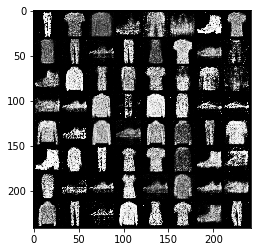

[Epoch 17/50] [Batch 401/938] [D loss: 1.246291] [G loss: 0.931919]
[Epoch 17/50] [Batch 402/938] [D loss: 1.241167] [G loss: 0.925348]
[Epoch 17/50] [Batch 403/938] [D loss: 1.316365] [G loss: 0.961504]
[Epoch 17/50] [Batch 404/938] [D loss: 1.228176] [G loss: 0.961084]
[Epoch 17/50] [Batch 405/938] [D loss: 1.176356] [G loss: 1.033272]
[Epoch 17/50] [Batch 406/938] [D loss: 1.371715] [G loss: 0.935492]
[Epoch 17/50] [Batch 407/938] [D loss: 1.322283] [G loss: 0.957261]
[Epoch 17/50] [Batch 408/938] [D loss: 1.297931] [G loss: 0.947569]
[Epoch 17/50] [Batch 409/938] [D loss: 1.212601] [G loss: 0.955558]
[Epoch 17/50] [Batch 410/938] [D loss: 1.204365] [G loss: 0.893157]
[Epoch 17/50] [Batch 411/938] [D loss: 1.281546] [G loss: 0.873360]
[Epoch 17/50] [Batch 412/938] [D loss: 1.198682] [G loss: 0.965896]
[Epoch 17/50] [Batch 413/938] [D loss: 1.200664] [G loss: 0.965120]
[Epoch 17/50] [Batch 414/938] [D loss: 1.277593] [G loss: 0.847396]
[Epoch 17/50] [Batch 415/938] [D loss: 1.264948]

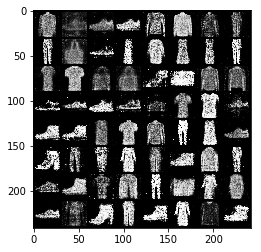

[Epoch 17/50] [Batch 601/938] [D loss: 1.296722] [G loss: 0.920182]
[Epoch 17/50] [Batch 602/938] [D loss: 1.247597] [G loss: 1.013264]
[Epoch 17/50] [Batch 603/938] [D loss: 1.215450] [G loss: 0.919317]
[Epoch 17/50] [Batch 604/938] [D loss: 1.260759] [G loss: 0.929560]
[Epoch 17/50] [Batch 605/938] [D loss: 1.336750] [G loss: 0.972789]
[Epoch 17/50] [Batch 606/938] [D loss: 1.225776] [G loss: 0.976342]
[Epoch 17/50] [Batch 607/938] [D loss: 1.213752] [G loss: 0.939162]
[Epoch 17/50] [Batch 608/938] [D loss: 1.176981] [G loss: 0.881628]
[Epoch 17/50] [Batch 609/938] [D loss: 1.315751] [G loss: 0.887957]
[Epoch 17/50] [Batch 610/938] [D loss: 1.150817] [G loss: 0.923752]
[Epoch 17/50] [Batch 611/938] [D loss: 1.192036] [G loss: 0.922152]
[Epoch 17/50] [Batch 612/938] [D loss: 1.202644] [G loss: 0.986937]
[Epoch 17/50] [Batch 613/938] [D loss: 1.208272] [G loss: 0.950764]
[Epoch 17/50] [Batch 614/938] [D loss: 1.285581] [G loss: 0.944955]
[Epoch 17/50] [Batch 615/938] [D loss: 1.315867]

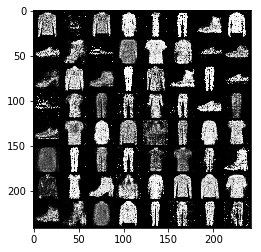

[Epoch 17/50] [Batch 801/938] [D loss: 1.344583] [G loss: 0.937688]
[Epoch 17/50] [Batch 802/938] [D loss: 1.221850] [G loss: 0.911763]
[Epoch 17/50] [Batch 803/938] [D loss: 1.250423] [G loss: 0.990023]
[Epoch 17/50] [Batch 804/938] [D loss: 1.249491] [G loss: 0.903788]
[Epoch 17/50] [Batch 805/938] [D loss: 1.141717] [G loss: 0.965605]
[Epoch 17/50] [Batch 806/938] [D loss: 1.368781] [G loss: 0.970820]
[Epoch 17/50] [Batch 807/938] [D loss: 1.246668] [G loss: 0.961551]
[Epoch 17/50] [Batch 808/938] [D loss: 1.369771] [G loss: 0.902771]
[Epoch 17/50] [Batch 809/938] [D loss: 1.182215] [G loss: 1.036452]
[Epoch 17/50] [Batch 810/938] [D loss: 1.310817] [G loss: 1.013363]
[Epoch 17/50] [Batch 811/938] [D loss: 1.229031] [G loss: 0.962449]
[Epoch 17/50] [Batch 812/938] [D loss: 1.280058] [G loss: 1.023741]
[Epoch 17/50] [Batch 813/938] [D loss: 1.339242] [G loss: 1.005782]
[Epoch 17/50] [Batch 814/938] [D loss: 1.280118] [G loss: 0.901532]
[Epoch 17/50] [Batch 815/938] [D loss: 1.229417]

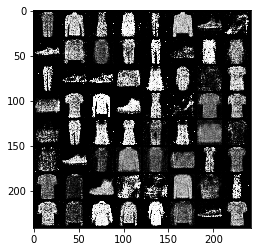

[Epoch 18/50] [Batch 1/938] [D loss: 1.222318] [G loss: 0.886620]
[Epoch 18/50] [Batch 2/938] [D loss: 1.302934] [G loss: 0.946336]
[Epoch 18/50] [Batch 3/938] [D loss: 1.290742] [G loss: 0.905747]
[Epoch 18/50] [Batch 4/938] [D loss: 1.264190] [G loss: 0.913212]
[Epoch 18/50] [Batch 5/938] [D loss: 1.261864] [G loss: 0.853266]
[Epoch 18/50] [Batch 6/938] [D loss: 1.182778] [G loss: 0.974714]
[Epoch 18/50] [Batch 7/938] [D loss: 1.282792] [G loss: 0.941086]
[Epoch 18/50] [Batch 8/938] [D loss: 1.303245] [G loss: 0.954019]
[Epoch 18/50] [Batch 9/938] [D loss: 1.231230] [G loss: 0.980900]
[Epoch 18/50] [Batch 10/938] [D loss: 1.222396] [G loss: 0.912422]
[Epoch 18/50] [Batch 11/938] [D loss: 1.255088] [G loss: 0.912483]
[Epoch 18/50] [Batch 12/938] [D loss: 1.359552] [G loss: 0.940208]
[Epoch 18/50] [Batch 13/938] [D loss: 1.258734] [G loss: 0.918025]
[Epoch 18/50] [Batch 14/938] [D loss: 1.284187] [G loss: 1.026109]
[Epoch 18/50] [Batch 15/938] [D loss: 1.230332] [G loss: 0.946619]
[Epo

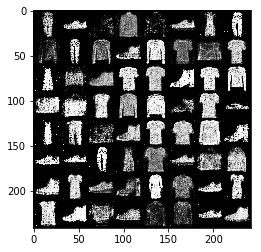

[Epoch 18/50] [Batch 201/938] [D loss: 1.195621] [G loss: 0.923289]
[Epoch 18/50] [Batch 202/938] [D loss: 1.268241] [G loss: 0.924285]
[Epoch 18/50] [Batch 203/938] [D loss: 1.310158] [G loss: 0.874865]
[Epoch 18/50] [Batch 204/938] [D loss: 1.235353] [G loss: 0.862923]
[Epoch 18/50] [Batch 205/938] [D loss: 1.228318] [G loss: 0.890102]
[Epoch 18/50] [Batch 206/938] [D loss: 1.218620] [G loss: 0.941514]
[Epoch 18/50] [Batch 207/938] [D loss: 1.322588] [G loss: 0.870307]
[Epoch 18/50] [Batch 208/938] [D loss: 1.330309] [G loss: 0.944445]
[Epoch 18/50] [Batch 209/938] [D loss: 1.204053] [G loss: 0.945013]
[Epoch 18/50] [Batch 210/938] [D loss: 1.217294] [G loss: 0.914546]
[Epoch 18/50] [Batch 211/938] [D loss: 1.249243] [G loss: 0.864042]
[Epoch 18/50] [Batch 212/938] [D loss: 1.203921] [G loss: 0.867196]
[Epoch 18/50] [Batch 213/938] [D loss: 1.214172] [G loss: 0.893260]
[Epoch 18/50] [Batch 214/938] [D loss: 1.241237] [G loss: 0.937623]
[Epoch 18/50] [Batch 215/938] [D loss: 1.345116]

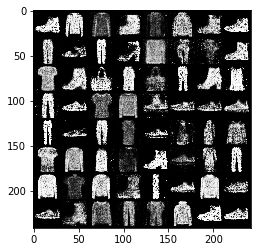

[Epoch 18/50] [Batch 401/938] [D loss: 1.282892] [G loss: 0.976405]
[Epoch 18/50] [Batch 402/938] [D loss: 1.222638] [G loss: 0.999027]
[Epoch 18/50] [Batch 403/938] [D loss: 1.292175] [G loss: 0.977026]
[Epoch 18/50] [Batch 404/938] [D loss: 1.235082] [G loss: 0.928792]
[Epoch 18/50] [Batch 405/938] [D loss: 1.225548] [G loss: 0.938327]
[Epoch 18/50] [Batch 406/938] [D loss: 1.450817] [G loss: 0.884004]
[Epoch 18/50] [Batch 407/938] [D loss: 1.255577] [G loss: 0.954034]
[Epoch 18/50] [Batch 408/938] [D loss: 1.262790] [G loss: 0.870828]
[Epoch 18/50] [Batch 409/938] [D loss: 1.195835] [G loss: 0.958675]
[Epoch 18/50] [Batch 410/938] [D loss: 1.132596] [G loss: 0.917021]
[Epoch 18/50] [Batch 411/938] [D loss: 1.235384] [G loss: 0.929139]
[Epoch 18/50] [Batch 412/938] [D loss: 1.319921] [G loss: 0.892091]
[Epoch 18/50] [Batch 413/938] [D loss: 1.216333] [G loss: 1.027932]
[Epoch 18/50] [Batch 414/938] [D loss: 1.260215] [G loss: 0.960652]
[Epoch 18/50] [Batch 415/938] [D loss: 1.237361]

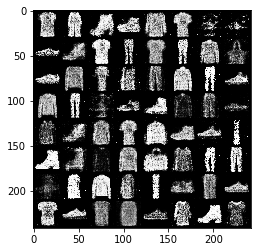

[Epoch 18/50] [Batch 601/938] [D loss: 1.287588] [G loss: 0.891713]
[Epoch 18/50] [Batch 602/938] [D loss: 1.262786] [G loss: 0.922133]
[Epoch 18/50] [Batch 603/938] [D loss: 1.338721] [G loss: 0.875717]
[Epoch 18/50] [Batch 604/938] [D loss: 1.286770] [G loss: 0.860049]
[Epoch 18/50] [Batch 605/938] [D loss: 1.283588] [G loss: 0.901456]
[Epoch 18/50] [Batch 606/938] [D loss: 1.304232] [G loss: 0.860242]
[Epoch 18/50] [Batch 607/938] [D loss: 1.257612] [G loss: 0.868017]
[Epoch 18/50] [Batch 608/938] [D loss: 1.304521] [G loss: 0.841215]
[Epoch 18/50] [Batch 609/938] [D loss: 1.339993] [G loss: 0.872488]
[Epoch 18/50] [Batch 610/938] [D loss: 1.287750] [G loss: 0.914078]
[Epoch 18/50] [Batch 611/938] [D loss: 1.273633] [G loss: 0.904653]
[Epoch 18/50] [Batch 612/938] [D loss: 1.191466] [G loss: 0.896934]
[Epoch 18/50] [Batch 613/938] [D loss: 1.334903] [G loss: 0.852807]
[Epoch 18/50] [Batch 614/938] [D loss: 1.299451] [G loss: 0.795236]
[Epoch 18/50] [Batch 615/938] [D loss: 1.287757]

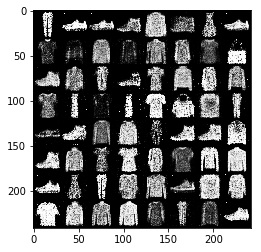

[Epoch 18/50] [Batch 801/938] [D loss: 1.220749] [G loss: 0.966076]
[Epoch 18/50] [Batch 802/938] [D loss: 1.149549] [G loss: 0.941392]
[Epoch 18/50] [Batch 803/938] [D loss: 1.187203] [G loss: 1.006595]
[Epoch 18/50] [Batch 804/938] [D loss: 1.273151] [G loss: 0.899928]
[Epoch 18/50] [Batch 805/938] [D loss: 1.225658] [G loss: 0.946462]
[Epoch 18/50] [Batch 806/938] [D loss: 1.209978] [G loss: 0.932746]
[Epoch 18/50] [Batch 807/938] [D loss: 1.159428] [G loss: 0.891652]
[Epoch 18/50] [Batch 808/938] [D loss: 1.357726] [G loss: 0.856986]
[Epoch 18/50] [Batch 809/938] [D loss: 1.236123] [G loss: 0.903776]
[Epoch 18/50] [Batch 810/938] [D loss: 1.323753] [G loss: 0.951451]
[Epoch 18/50] [Batch 811/938] [D loss: 1.181481] [G loss: 0.932113]
[Epoch 18/50] [Batch 812/938] [D loss: 1.159108] [G loss: 0.862382]
[Epoch 18/50] [Batch 813/938] [D loss: 1.270432] [G loss: 0.850542]
[Epoch 18/50] [Batch 814/938] [D loss: 1.153641] [G loss: 0.930716]
[Epoch 18/50] [Batch 815/938] [D loss: 1.246393]

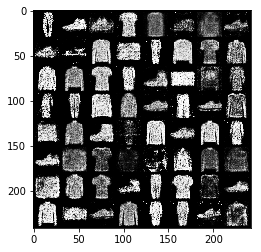

[Epoch 19/50] [Batch 1/938] [D loss: 1.302522] [G loss: 0.891332]
[Epoch 19/50] [Batch 2/938] [D loss: 1.246347] [G loss: 0.927948]
[Epoch 19/50] [Batch 3/938] [D loss: 1.233500] [G loss: 0.910945]
[Epoch 19/50] [Batch 4/938] [D loss: 1.207452] [G loss: 0.909039]
[Epoch 19/50] [Batch 5/938] [D loss: 1.263864] [G loss: 0.880509]
[Epoch 19/50] [Batch 6/938] [D loss: 1.258287] [G loss: 0.861316]
[Epoch 19/50] [Batch 7/938] [D loss: 1.340987] [G loss: 0.909706]
[Epoch 19/50] [Batch 8/938] [D loss: 1.224941] [G loss: 0.917833]
[Epoch 19/50] [Batch 9/938] [D loss: 1.226748] [G loss: 0.963786]
[Epoch 19/50] [Batch 10/938] [D loss: 1.141164] [G loss: 0.928321]
[Epoch 19/50] [Batch 11/938] [D loss: 1.253042] [G loss: 0.956704]
[Epoch 19/50] [Batch 12/938] [D loss: 1.280724] [G loss: 0.872694]
[Epoch 19/50] [Batch 13/938] [D loss: 1.214062] [G loss: 0.973470]
[Epoch 19/50] [Batch 14/938] [D loss: 1.194499] [G loss: 1.044435]
[Epoch 19/50] [Batch 15/938] [D loss: 1.276118] [G loss: 1.011319]
[Epo

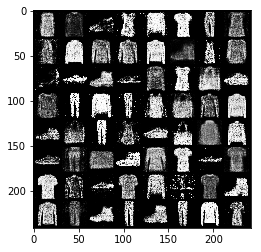

[Epoch 19/50] [Batch 201/938] [D loss: 1.196358] [G loss: 0.960051]
[Epoch 19/50] [Batch 202/938] [D loss: 1.215863] [G loss: 0.907027]
[Epoch 19/50] [Batch 203/938] [D loss: 1.201365] [G loss: 0.944556]
[Epoch 19/50] [Batch 204/938] [D loss: 1.413934] [G loss: 0.888651]
[Epoch 19/50] [Batch 205/938] [D loss: 1.247448] [G loss: 0.996601]
[Epoch 19/50] [Batch 206/938] [D loss: 1.367600] [G loss: 0.982343]
[Epoch 19/50] [Batch 207/938] [D loss: 1.337444] [G loss: 0.927228]
[Epoch 19/50] [Batch 208/938] [D loss: 1.325309] [G loss: 0.937697]
[Epoch 19/50] [Batch 209/938] [D loss: 1.261027] [G loss: 0.933217]
[Epoch 19/50] [Batch 210/938] [D loss: 1.265101] [G loss: 0.903346]
[Epoch 19/50] [Batch 211/938] [D loss: 1.264245] [G loss: 0.861212]
[Epoch 19/50] [Batch 212/938] [D loss: 1.267082] [G loss: 0.907860]
[Epoch 19/50] [Batch 213/938] [D loss: 1.243359] [G loss: 0.943789]
[Epoch 19/50] [Batch 214/938] [D loss: 1.341068] [G loss: 0.866039]
[Epoch 19/50] [Batch 215/938] [D loss: 1.231073]

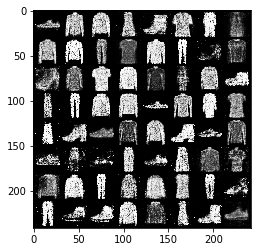

[Epoch 19/50] [Batch 401/938] [D loss: 1.242661] [G loss: 0.886182]
[Epoch 19/50] [Batch 402/938] [D loss: 1.348981] [G loss: 0.860469]
[Epoch 19/50] [Batch 403/938] [D loss: 1.290762] [G loss: 0.837309]
[Epoch 19/50] [Batch 404/938] [D loss: 1.240058] [G loss: 0.901884]
[Epoch 19/50] [Batch 405/938] [D loss: 1.239135] [G loss: 0.943331]
[Epoch 19/50] [Batch 406/938] [D loss: 1.304267] [G loss: 0.902917]
[Epoch 19/50] [Batch 407/938] [D loss: 1.239478] [G loss: 0.949424]
[Epoch 19/50] [Batch 408/938] [D loss: 1.188583] [G loss: 0.840158]
[Epoch 19/50] [Batch 409/938] [D loss: 1.220720] [G loss: 0.928390]
[Epoch 19/50] [Batch 410/938] [D loss: 1.269470] [G loss: 0.854635]
[Epoch 19/50] [Batch 411/938] [D loss: 1.247392] [G loss: 0.978724]
[Epoch 19/50] [Batch 412/938] [D loss: 1.216676] [G loss: 0.857637]
[Epoch 19/50] [Batch 413/938] [D loss: 1.260798] [G loss: 0.882306]
[Epoch 19/50] [Batch 414/938] [D loss: 1.232566] [G loss: 0.923557]
[Epoch 19/50] [Batch 415/938] [D loss: 1.178896]

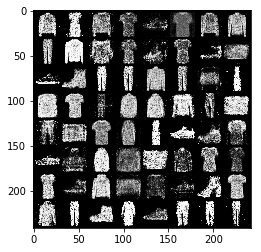

[Epoch 19/50] [Batch 601/938] [D loss: 1.280859] [G loss: 0.981410]
[Epoch 19/50] [Batch 602/938] [D loss: 1.255165] [G loss: 0.928760]
[Epoch 19/50] [Batch 603/938] [D loss: 1.364125] [G loss: 0.894838]
[Epoch 19/50] [Batch 604/938] [D loss: 1.215529] [G loss: 0.924902]
[Epoch 19/50] [Batch 605/938] [D loss: 1.297638] [G loss: 0.957459]
[Epoch 19/50] [Batch 606/938] [D loss: 1.252692] [G loss: 0.954847]
[Epoch 19/50] [Batch 607/938] [D loss: 1.288414] [G loss: 0.884864]
[Epoch 19/50] [Batch 608/938] [D loss: 1.283550] [G loss: 0.904012]
[Epoch 19/50] [Batch 609/938] [D loss: 1.302524] [G loss: 0.945921]
[Epoch 19/50] [Batch 610/938] [D loss: 1.305773] [G loss: 0.946027]
[Epoch 19/50] [Batch 611/938] [D loss: 1.287456] [G loss: 0.854245]
[Epoch 19/50] [Batch 612/938] [D loss: 1.223150] [G loss: 0.898558]
[Epoch 19/50] [Batch 613/938] [D loss: 1.347723] [G loss: 0.902645]
[Epoch 19/50] [Batch 614/938] [D loss: 1.312166] [G loss: 0.964101]
[Epoch 19/50] [Batch 615/938] [D loss: 1.316327]

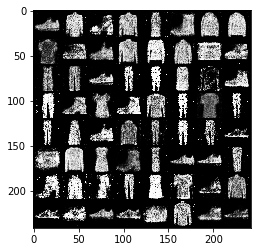

[Epoch 19/50] [Batch 801/938] [D loss: 1.349889] [G loss: 0.906813]
[Epoch 19/50] [Batch 802/938] [D loss: 1.289213] [G loss: 0.934670]
[Epoch 19/50] [Batch 803/938] [D loss: 1.375482] [G loss: 0.925565]
[Epoch 19/50] [Batch 804/938] [D loss: 1.286763] [G loss: 0.927233]
[Epoch 19/50] [Batch 805/938] [D loss: 1.271265] [G loss: 0.909665]
[Epoch 19/50] [Batch 806/938] [D loss: 1.287850] [G loss: 0.919719]
[Epoch 19/50] [Batch 807/938] [D loss: 1.187332] [G loss: 0.896999]
[Epoch 19/50] [Batch 808/938] [D loss: 1.269229] [G loss: 0.953608]
[Epoch 19/50] [Batch 809/938] [D loss: 1.264030] [G loss: 0.950586]
[Epoch 19/50] [Batch 810/938] [D loss: 1.258703] [G loss: 0.886352]
[Epoch 19/50] [Batch 811/938] [D loss: 1.239319] [G loss: 0.872680]
[Epoch 19/50] [Batch 812/938] [D loss: 1.335145] [G loss: 0.839727]
[Epoch 19/50] [Batch 813/938] [D loss: 1.264188] [G loss: 0.813746]
[Epoch 19/50] [Batch 814/938] [D loss: 1.344159] [G loss: 0.899025]
[Epoch 19/50] [Batch 815/938] [D loss: 1.266106]

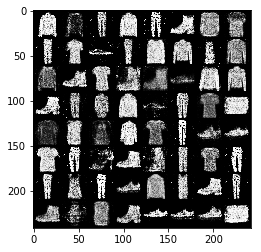

[Epoch 20/50] [Batch 1/938] [D loss: 1.257930] [G loss: 0.894396]
[Epoch 20/50] [Batch 2/938] [D loss: 1.216045] [G loss: 0.918214]
[Epoch 20/50] [Batch 3/938] [D loss: 1.238326] [G loss: 0.912058]
[Epoch 20/50] [Batch 4/938] [D loss: 1.273802] [G loss: 0.917903]
[Epoch 20/50] [Batch 5/938] [D loss: 1.252326] [G loss: 0.918520]
[Epoch 20/50] [Batch 6/938] [D loss: 1.217909] [G loss: 0.889068]
[Epoch 20/50] [Batch 7/938] [D loss: 1.285378] [G loss: 0.907435]
[Epoch 20/50] [Batch 8/938] [D loss: 1.257793] [G loss: 0.960363]
[Epoch 20/50] [Batch 9/938] [D loss: 1.353777] [G loss: 0.901930]
[Epoch 20/50] [Batch 10/938] [D loss: 1.095833] [G loss: 0.917114]
[Epoch 20/50] [Batch 11/938] [D loss: 1.389522] [G loss: 0.859661]
[Epoch 20/50] [Batch 12/938] [D loss: 1.213274] [G loss: 0.888468]
[Epoch 20/50] [Batch 13/938] [D loss: 1.213569] [G loss: 0.826533]
[Epoch 20/50] [Batch 14/938] [D loss: 1.258678] [G loss: 0.857881]
[Epoch 20/50] [Batch 15/938] [D loss: 1.198115] [G loss: 0.927922]
[Epo

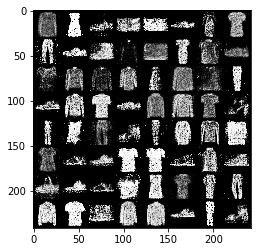

[Epoch 20/50] [Batch 201/938] [D loss: 1.201810] [G loss: 0.930015]
[Epoch 20/50] [Batch 202/938] [D loss: 1.274886] [G loss: 0.868145]
[Epoch 20/50] [Batch 203/938] [D loss: 1.146561] [G loss: 0.939398]
[Epoch 20/50] [Batch 204/938] [D loss: 1.230666] [G loss: 0.902518]
[Epoch 20/50] [Batch 205/938] [D loss: 1.315856] [G loss: 0.933452]
[Epoch 20/50] [Batch 206/938] [D loss: 1.367944] [G loss: 0.928303]
[Epoch 20/50] [Batch 207/938] [D loss: 1.255968] [G loss: 0.925750]
[Epoch 20/50] [Batch 208/938] [D loss: 1.260699] [G loss: 0.933508]
[Epoch 20/50] [Batch 209/938] [D loss: 1.296703] [G loss: 0.910221]
[Epoch 20/50] [Batch 210/938] [D loss: 1.239851] [G loss: 0.925104]
[Epoch 20/50] [Batch 211/938] [D loss: 1.300157] [G loss: 0.919980]
[Epoch 20/50] [Batch 212/938] [D loss: 1.225895] [G loss: 0.902831]
[Epoch 20/50] [Batch 213/938] [D loss: 1.320183] [G loss: 0.892510]
[Epoch 20/50] [Batch 214/938] [D loss: 1.255592] [G loss: 0.934358]
[Epoch 20/50] [Batch 215/938] [D loss: 1.345789]

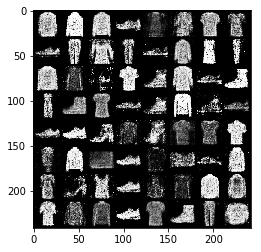

[Epoch 20/50] [Batch 401/938] [D loss: 1.253492] [G loss: 0.872481]
[Epoch 20/50] [Batch 402/938] [D loss: 1.318853] [G loss: 0.906242]
[Epoch 20/50] [Batch 403/938] [D loss: 1.206477] [G loss: 0.914458]
[Epoch 20/50] [Batch 404/938] [D loss: 1.261567] [G loss: 0.901435]
[Epoch 20/50] [Batch 405/938] [D loss: 1.252349] [G loss: 0.910637]
[Epoch 20/50] [Batch 406/938] [D loss: 1.331240] [G loss: 0.875925]
[Epoch 20/50] [Batch 407/938] [D loss: 1.241791] [G loss: 0.879914]
[Epoch 20/50] [Batch 408/938] [D loss: 1.204660] [G loss: 0.894849]
[Epoch 20/50] [Batch 409/938] [D loss: 1.254580] [G loss: 0.866575]
[Epoch 20/50] [Batch 410/938] [D loss: 1.307283] [G loss: 0.876669]
[Epoch 20/50] [Batch 411/938] [D loss: 1.222999] [G loss: 0.872249]
[Epoch 20/50] [Batch 412/938] [D loss: 1.294755] [G loss: 0.853575]
[Epoch 20/50] [Batch 413/938] [D loss: 1.246532] [G loss: 0.887966]
[Epoch 20/50] [Batch 414/938] [D loss: 1.389999] [G loss: 0.889503]
[Epoch 20/50] [Batch 415/938] [D loss: 1.306247]

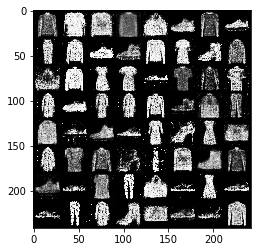

[Epoch 20/50] [Batch 601/938] [D loss: 1.218785] [G loss: 0.906220]
[Epoch 20/50] [Batch 602/938] [D loss: 1.305800] [G loss: 0.855617]
[Epoch 20/50] [Batch 603/938] [D loss: 1.254881] [G loss: 0.832680]
[Epoch 20/50] [Batch 604/938] [D loss: 1.218774] [G loss: 0.845556]
[Epoch 20/50] [Batch 605/938] [D loss: 1.244168] [G loss: 0.814043]
[Epoch 20/50] [Batch 606/938] [D loss: 1.344569] [G loss: 0.783721]
[Epoch 20/50] [Batch 607/938] [D loss: 1.317115] [G loss: 0.907748]
[Epoch 20/50] [Batch 608/938] [D loss: 1.234111] [G loss: 0.906370]
[Epoch 20/50] [Batch 609/938] [D loss: 1.318544] [G loss: 0.842858]
[Epoch 20/50] [Batch 610/938] [D loss: 1.395992] [G loss: 0.856116]
[Epoch 20/50] [Batch 611/938] [D loss: 1.334769] [G loss: 0.821453]
[Epoch 20/50] [Batch 612/938] [D loss: 1.279768] [G loss: 0.883540]
[Epoch 20/50] [Batch 613/938] [D loss: 1.330009] [G loss: 0.903270]
[Epoch 20/50] [Batch 614/938] [D loss: 1.361125] [G loss: 0.919670]
[Epoch 20/50] [Batch 615/938] [D loss: 1.251161]

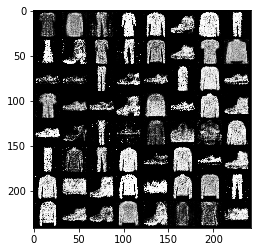

[Epoch 20/50] [Batch 801/938] [D loss: 1.231225] [G loss: 0.891954]
[Epoch 20/50] [Batch 802/938] [D loss: 1.337381] [G loss: 0.844029]
[Epoch 20/50] [Batch 803/938] [D loss: 1.259667] [G loss: 0.834898]
[Epoch 20/50] [Batch 804/938] [D loss: 1.297142] [G loss: 0.846507]
[Epoch 20/50] [Batch 805/938] [D loss: 1.285563] [G loss: 0.808749]
[Epoch 20/50] [Batch 806/938] [D loss: 1.229324] [G loss: 0.849242]
[Epoch 20/50] [Batch 807/938] [D loss: 1.386605] [G loss: 0.868095]
[Epoch 20/50] [Batch 808/938] [D loss: 1.244634] [G loss: 0.845636]
[Epoch 20/50] [Batch 809/938] [D loss: 1.251133] [G loss: 0.930408]
[Epoch 20/50] [Batch 810/938] [D loss: 1.266134] [G loss: 0.952294]
[Epoch 20/50] [Batch 811/938] [D loss: 1.268120] [G loss: 0.924387]
[Epoch 20/50] [Batch 812/938] [D loss: 1.271666] [G loss: 0.953059]
[Epoch 20/50] [Batch 813/938] [D loss: 1.316142] [G loss: 0.887162]
[Epoch 20/50] [Batch 814/938] [D loss: 1.181045] [G loss: 0.926994]
[Epoch 20/50] [Batch 815/938] [D loss: 1.214338]

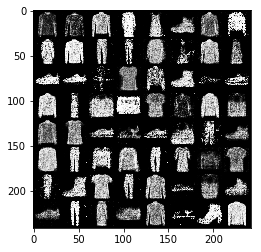

[Epoch 21/50] [Batch 1/938] [D loss: 1.283042] [G loss: 0.918707]
[Epoch 21/50] [Batch 2/938] [D loss: 1.256213] [G loss: 0.894304]
[Epoch 21/50] [Batch 3/938] [D loss: 1.266876] [G loss: 0.875259]
[Epoch 21/50] [Batch 4/938] [D loss: 1.361457] [G loss: 0.908526]
[Epoch 21/50] [Batch 5/938] [D loss: 1.288231] [G loss: 0.907223]
[Epoch 21/50] [Batch 6/938] [D loss: 1.260980] [G loss: 0.894133]
[Epoch 21/50] [Batch 7/938] [D loss: 1.314555] [G loss: 0.887287]
[Epoch 21/50] [Batch 8/938] [D loss: 1.248444] [G loss: 0.917181]
[Epoch 21/50] [Batch 9/938] [D loss: 1.246676] [G loss: 0.856796]
[Epoch 21/50] [Batch 10/938] [D loss: 1.163787] [G loss: 0.922299]
[Epoch 21/50] [Batch 11/938] [D loss: 1.331367] [G loss: 0.895762]
[Epoch 21/50] [Batch 12/938] [D loss: 1.194726] [G loss: 0.913132]
[Epoch 21/50] [Batch 13/938] [D loss: 1.211350] [G loss: 0.846329]
[Epoch 21/50] [Batch 14/938] [D loss: 1.188465] [G loss: 0.852050]
[Epoch 21/50] [Batch 15/938] [D loss: 1.260189] [G loss: 0.903435]
[Epo

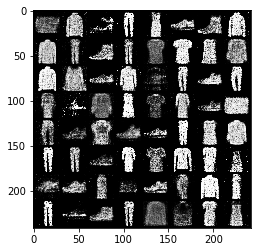

[Epoch 21/50] [Batch 201/938] [D loss: 1.302090] [G loss: 0.930416]
[Epoch 21/50] [Batch 202/938] [D loss: 1.243442] [G loss: 0.904807]
[Epoch 21/50] [Batch 203/938] [D loss: 1.220915] [G loss: 0.846514]
[Epoch 21/50] [Batch 204/938] [D loss: 1.306653] [G loss: 0.846383]
[Epoch 21/50] [Batch 205/938] [D loss: 1.328881] [G loss: 0.905956]
[Epoch 21/50] [Batch 206/938] [D loss: 1.294361] [G loss: 0.911441]
[Epoch 21/50] [Batch 207/938] [D loss: 1.301949] [G loss: 0.904898]
[Epoch 21/50] [Batch 208/938] [D loss: 1.276046] [G loss: 0.930012]
[Epoch 21/50] [Batch 209/938] [D loss: 1.237994] [G loss: 0.868977]
[Epoch 21/50] [Batch 210/938] [D loss: 1.261500] [G loss: 0.863522]
[Epoch 21/50] [Batch 211/938] [D loss: 1.328554] [G loss: 0.840698]
[Epoch 21/50] [Batch 212/938] [D loss: 1.231284] [G loss: 0.846976]
[Epoch 21/50] [Batch 213/938] [D loss: 1.263698] [G loss: 0.863606]
[Epoch 21/50] [Batch 214/938] [D loss: 1.328428] [G loss: 0.873238]
[Epoch 21/50] [Batch 215/938] [D loss: 1.213430]

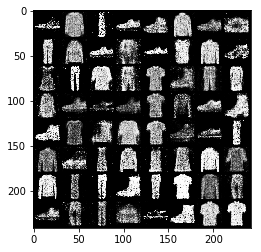

[Epoch 21/50] [Batch 401/938] [D loss: 1.373957] [G loss: 0.862876]
[Epoch 21/50] [Batch 402/938] [D loss: 1.190878] [G loss: 0.944708]
[Epoch 21/50] [Batch 403/938] [D loss: 1.251961] [G loss: 0.965332]
[Epoch 21/50] [Batch 404/938] [D loss: 1.254833] [G loss: 0.879037]
[Epoch 21/50] [Batch 405/938] [D loss: 1.305447] [G loss: 0.925501]
[Epoch 21/50] [Batch 406/938] [D loss: 1.175846] [G loss: 0.883020]
[Epoch 21/50] [Batch 407/938] [D loss: 1.312178] [G loss: 0.868982]
[Epoch 21/50] [Batch 408/938] [D loss: 1.222707] [G loss: 0.863473]
[Epoch 21/50] [Batch 409/938] [D loss: 1.295853] [G loss: 0.874176]
[Epoch 21/50] [Batch 410/938] [D loss: 1.258030] [G loss: 0.854452]
[Epoch 21/50] [Batch 411/938] [D loss: 1.330536] [G loss: 0.836852]
[Epoch 21/50] [Batch 412/938] [D loss: 1.219198] [G loss: 0.851439]
[Epoch 21/50] [Batch 413/938] [D loss: 1.300502] [G loss: 0.862081]
[Epoch 21/50] [Batch 414/938] [D loss: 1.224087] [G loss: 0.842740]
[Epoch 21/50] [Batch 415/938] [D loss: 1.212337]

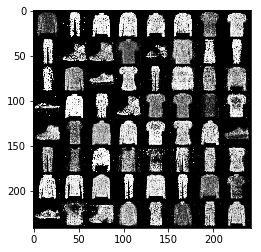

[Epoch 21/50] [Batch 601/938] [D loss: 1.288897] [G loss: 0.915537]
[Epoch 21/50] [Batch 602/938] [D loss: 1.203252] [G loss: 0.933021]
[Epoch 21/50] [Batch 603/938] [D loss: 1.383566] [G loss: 0.862452]
[Epoch 21/50] [Batch 604/938] [D loss: 1.212447] [G loss: 0.902209]
[Epoch 21/50] [Batch 605/938] [D loss: 1.236137] [G loss: 0.888970]
[Epoch 21/50] [Batch 606/938] [D loss: 1.196233] [G loss: 0.904250]
[Epoch 21/50] [Batch 607/938] [D loss: 1.165522] [G loss: 0.843980]
[Epoch 21/50] [Batch 608/938] [D loss: 1.241502] [G loss: 0.874331]
[Epoch 21/50] [Batch 609/938] [D loss: 1.178692] [G loss: 0.946862]
[Epoch 21/50] [Batch 610/938] [D loss: 1.234073] [G loss: 0.856741]
[Epoch 21/50] [Batch 611/938] [D loss: 1.207495] [G loss: 0.845755]
[Epoch 21/50] [Batch 612/938] [D loss: 1.401782] [G loss: 0.894224]
[Epoch 21/50] [Batch 613/938] [D loss: 1.222493] [G loss: 0.951095]
[Epoch 21/50] [Batch 614/938] [D loss: 1.252216] [G loss: 0.945685]
[Epoch 21/50] [Batch 615/938] [D loss: 1.260166]

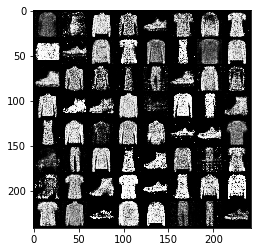

[Epoch 21/50] [Batch 801/938] [D loss: 1.290479] [G loss: 0.881647]
[Epoch 21/50] [Batch 802/938] [D loss: 1.148942] [G loss: 0.966501]
[Epoch 21/50] [Batch 803/938] [D loss: 1.228641] [G loss: 0.918363]
[Epoch 21/50] [Batch 804/938] [D loss: 1.242624] [G loss: 0.833784]
[Epoch 21/50] [Batch 805/938] [D loss: 1.289912] [G loss: 0.937768]
[Epoch 21/50] [Batch 806/938] [D loss: 1.278489] [G loss: 0.840635]
[Epoch 21/50] [Batch 807/938] [D loss: 1.312304] [G loss: 0.860760]
[Epoch 21/50] [Batch 808/938] [D loss: 1.278392] [G loss: 0.851198]
[Epoch 21/50] [Batch 809/938] [D loss: 1.267304] [G loss: 0.924164]
[Epoch 21/50] [Batch 810/938] [D loss: 1.224110] [G loss: 0.915177]
[Epoch 21/50] [Batch 811/938] [D loss: 1.281432] [G loss: 0.947735]
[Epoch 21/50] [Batch 812/938] [D loss: 1.300287] [G loss: 0.966513]
[Epoch 21/50] [Batch 813/938] [D loss: 1.276893] [G loss: 0.903390]
[Epoch 21/50] [Batch 814/938] [D loss: 1.372193] [G loss: 0.880279]
[Epoch 21/50] [Batch 815/938] [D loss: 1.288147]

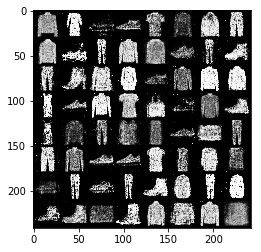

[Epoch 22/50] [Batch 1/938] [D loss: 1.350343] [G loss: 0.887421]
[Epoch 22/50] [Batch 2/938] [D loss: 1.271886] [G loss: 0.914176]
[Epoch 22/50] [Batch 3/938] [D loss: 1.268177] [G loss: 0.927787]
[Epoch 22/50] [Batch 4/938] [D loss: 1.200869] [G loss: 0.944188]
[Epoch 22/50] [Batch 5/938] [D loss: 1.227192] [G loss: 0.955094]
[Epoch 22/50] [Batch 6/938] [D loss: 1.247061] [G loss: 1.008011]
[Epoch 22/50] [Batch 7/938] [D loss: 1.249865] [G loss: 0.936027]
[Epoch 22/50] [Batch 8/938] [D loss: 1.235887] [G loss: 0.919056]
[Epoch 22/50] [Batch 9/938] [D loss: 1.220606] [G loss: 0.854162]
[Epoch 22/50] [Batch 10/938] [D loss: 1.246342] [G loss: 0.940503]
[Epoch 22/50] [Batch 11/938] [D loss: 1.320615] [G loss: 0.903759]
[Epoch 22/50] [Batch 12/938] [D loss: 1.225838] [G loss: 0.911721]
[Epoch 22/50] [Batch 13/938] [D loss: 1.286469] [G loss: 0.950438]
[Epoch 22/50] [Batch 14/938] [D loss: 1.259641] [G loss: 0.918365]
[Epoch 22/50] [Batch 15/938] [D loss: 1.313327] [G loss: 0.923518]
[Epo

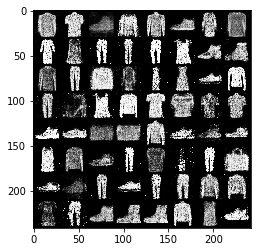

[Epoch 22/50] [Batch 201/938] [D loss: 1.168833] [G loss: 0.952697]
[Epoch 22/50] [Batch 202/938] [D loss: 1.224452] [G loss: 0.917684]
[Epoch 22/50] [Batch 203/938] [D loss: 1.331882] [G loss: 0.932086]
[Epoch 22/50] [Batch 204/938] [D loss: 1.226649] [G loss: 0.959174]
[Epoch 22/50] [Batch 205/938] [D loss: 1.291734] [G loss: 0.939474]
[Epoch 22/50] [Batch 206/938] [D loss: 1.374569] [G loss: 0.913425]
[Epoch 22/50] [Batch 207/938] [D loss: 1.347248] [G loss: 0.973851]
[Epoch 22/50] [Batch 208/938] [D loss: 1.302294] [G loss: 0.916340]
[Epoch 22/50] [Batch 209/938] [D loss: 1.219620] [G loss: 0.945561]
[Epoch 22/50] [Batch 210/938] [D loss: 1.283400] [G loss: 0.954750]
[Epoch 22/50] [Batch 211/938] [D loss: 1.233074] [G loss: 0.901221]
[Epoch 22/50] [Batch 212/938] [D loss: 1.312282] [G loss: 0.898311]
[Epoch 22/50] [Batch 213/938] [D loss: 1.312853] [G loss: 0.854862]
[Epoch 22/50] [Batch 214/938] [D loss: 1.245910] [G loss: 0.898705]
[Epoch 22/50] [Batch 215/938] [D loss: 1.344685]

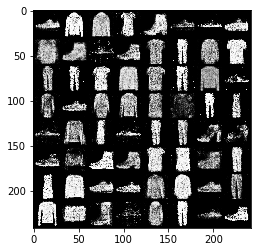

[Epoch 22/50] [Batch 401/938] [D loss: 1.395003] [G loss: 0.919587]
[Epoch 22/50] [Batch 402/938] [D loss: 1.304780] [G loss: 0.921949]
[Epoch 22/50] [Batch 403/938] [D loss: 1.292025] [G loss: 0.887368]
[Epoch 22/50] [Batch 404/938] [D loss: 1.320267] [G loss: 0.855114]
[Epoch 22/50] [Batch 405/938] [D loss: 1.208165] [G loss: 0.916836]
[Epoch 22/50] [Batch 406/938] [D loss: 1.313344] [G loss: 0.906218]
[Epoch 22/50] [Batch 407/938] [D loss: 1.289338] [G loss: 0.840915]
[Epoch 22/50] [Batch 408/938] [D loss: 1.283601] [G loss: 0.889021]
[Epoch 22/50] [Batch 409/938] [D loss: 1.307277] [G loss: 0.905536]
[Epoch 22/50] [Batch 410/938] [D loss: 1.256240] [G loss: 0.869107]
[Epoch 22/50] [Batch 411/938] [D loss: 1.283298] [G loss: 0.928246]
[Epoch 22/50] [Batch 412/938] [D loss: 1.325838] [G loss: 0.894650]
[Epoch 22/50] [Batch 413/938] [D loss: 1.138235] [G loss: 0.894488]
[Epoch 22/50] [Batch 414/938] [D loss: 1.221562] [G loss: 0.896336]
[Epoch 22/50] [Batch 415/938] [D loss: 1.276627]

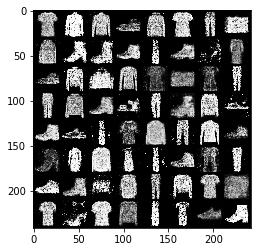

[Epoch 22/50] [Batch 601/938] [D loss: 1.308963] [G loss: 0.926894]
[Epoch 22/50] [Batch 602/938] [D loss: 1.321477] [G loss: 0.901335]
[Epoch 22/50] [Batch 603/938] [D loss: 1.265452] [G loss: 0.937627]
[Epoch 22/50] [Batch 604/938] [D loss: 1.367427] [G loss: 0.901244]
[Epoch 22/50] [Batch 605/938] [D loss: 1.316091] [G loss: 0.845378]
[Epoch 22/50] [Batch 606/938] [D loss: 1.332119] [G loss: 0.880758]
[Epoch 22/50] [Batch 607/938] [D loss: 1.313503] [G loss: 0.881319]
[Epoch 22/50] [Batch 608/938] [D loss: 1.277404] [G loss: 0.901402]
[Epoch 22/50] [Batch 609/938] [D loss: 1.409393] [G loss: 0.883623]
[Epoch 22/50] [Batch 610/938] [D loss: 1.297080] [G loss: 0.894532]
[Epoch 22/50] [Batch 611/938] [D loss: 1.239082] [G loss: 0.895793]
[Epoch 22/50] [Batch 612/938] [D loss: 1.252299] [G loss: 0.847087]
[Epoch 22/50] [Batch 613/938] [D loss: 1.320199] [G loss: 0.889742]
[Epoch 22/50] [Batch 614/938] [D loss: 1.296479] [G loss: 0.902540]
[Epoch 22/50] [Batch 615/938] [D loss: 1.309089]

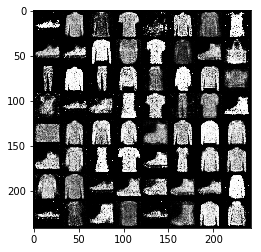

[Epoch 22/50] [Batch 801/938] [D loss: 1.256269] [G loss: 0.915997]
[Epoch 22/50] [Batch 802/938] [D loss: 1.283673] [G loss: 0.873216]
[Epoch 22/50] [Batch 803/938] [D loss: 1.264507] [G loss: 0.871148]
[Epoch 22/50] [Batch 804/938] [D loss: 1.266894] [G loss: 0.853467]
[Epoch 22/50] [Batch 805/938] [D loss: 1.301259] [G loss: 0.889462]
[Epoch 22/50] [Batch 806/938] [D loss: 1.215423] [G loss: 0.896108]
[Epoch 22/50] [Batch 807/938] [D loss: 1.298252] [G loss: 0.893846]
[Epoch 22/50] [Batch 808/938] [D loss: 1.315440] [G loss: 0.929190]
[Epoch 22/50] [Batch 809/938] [D loss: 1.257989] [G loss: 0.876590]
[Epoch 22/50] [Batch 810/938] [D loss: 1.249856] [G loss: 0.876640]
[Epoch 22/50] [Batch 811/938] [D loss: 1.228661] [G loss: 0.897807]
[Epoch 22/50] [Batch 812/938] [D loss: 1.250250] [G loss: 0.850210]
[Epoch 22/50] [Batch 813/938] [D loss: 1.331259] [G loss: 0.879891]
[Epoch 22/50] [Batch 814/938] [D loss: 1.285111] [G loss: 0.862003]
[Epoch 22/50] [Batch 815/938] [D loss: 1.333089]

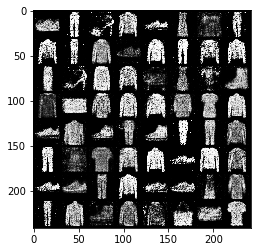

[Epoch 23/50] [Batch 1/938] [D loss: 1.328461] [G loss: 0.810956]
[Epoch 23/50] [Batch 2/938] [D loss: 1.316393] [G loss: 0.885151]
[Epoch 23/50] [Batch 3/938] [D loss: 1.236866] [G loss: 0.931423]
[Epoch 23/50] [Batch 4/938] [D loss: 1.207088] [G loss: 0.935138]
[Epoch 23/50] [Batch 5/938] [D loss: 1.286366] [G loss: 0.865805]
[Epoch 23/50] [Batch 6/938] [D loss: 1.275706] [G loss: 0.829734]
[Epoch 23/50] [Batch 7/938] [D loss: 1.310160] [G loss: 0.892990]
[Epoch 23/50] [Batch 8/938] [D loss: 1.264725] [G loss: 0.837907]
[Epoch 23/50] [Batch 9/938] [D loss: 1.353530] [G loss: 0.830317]
[Epoch 23/50] [Batch 10/938] [D loss: 1.291154] [G loss: 0.895070]
[Epoch 23/50] [Batch 11/938] [D loss: 1.285992] [G loss: 0.927842]
[Epoch 23/50] [Batch 12/938] [D loss: 1.203352] [G loss: 0.941825]
[Epoch 23/50] [Batch 13/938] [D loss: 1.291690] [G loss: 0.925166]
[Epoch 23/50] [Batch 14/938] [D loss: 1.369790] [G loss: 0.909835]
[Epoch 23/50] [Batch 15/938] [D loss: 1.273204] [G loss: 0.899872]
[Epo

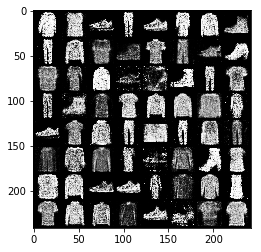

[Epoch 23/50] [Batch 201/938] [D loss: 1.344794] [G loss: 0.813825]
[Epoch 23/50] [Batch 202/938] [D loss: 1.307764] [G loss: 0.852733]
[Epoch 23/50] [Batch 203/938] [D loss: 1.237182] [G loss: 0.883232]
[Epoch 23/50] [Batch 204/938] [D loss: 1.291942] [G loss: 0.809626]
[Epoch 23/50] [Batch 205/938] [D loss: 1.220992] [G loss: 0.861387]
[Epoch 23/50] [Batch 206/938] [D loss: 1.380063] [G loss: 0.915177]
[Epoch 23/50] [Batch 207/938] [D loss: 1.206061] [G loss: 0.989744]
[Epoch 23/50] [Batch 208/938] [D loss: 1.267386] [G loss: 0.933483]
[Epoch 23/50] [Batch 209/938] [D loss: 1.247353] [G loss: 0.935123]
[Epoch 23/50] [Batch 210/938] [D loss: 1.186798] [G loss: 0.864874]
[Epoch 23/50] [Batch 211/938] [D loss: 1.335468] [G loss: 0.851752]
[Epoch 23/50] [Batch 212/938] [D loss: 1.337758] [G loss: 0.836914]
[Epoch 23/50] [Batch 213/938] [D loss: 1.305338] [G loss: 0.859260]
[Epoch 23/50] [Batch 214/938] [D loss: 1.237823] [G loss: 0.926153]
[Epoch 23/50] [Batch 215/938] [D loss: 1.240306]

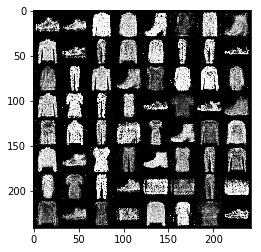

[Epoch 23/50] [Batch 401/938] [D loss: 1.267381] [G loss: 0.894990]
[Epoch 23/50] [Batch 402/938] [D loss: 1.241082] [G loss: 0.904089]
[Epoch 23/50] [Batch 403/938] [D loss: 1.294666] [G loss: 0.870928]
[Epoch 23/50] [Batch 404/938] [D loss: 1.324089] [G loss: 0.898059]
[Epoch 23/50] [Batch 405/938] [D loss: 1.269542] [G loss: 0.917930]
[Epoch 23/50] [Batch 406/938] [D loss: 1.336072] [G loss: 0.884543]
[Epoch 23/50] [Batch 407/938] [D loss: 1.270025] [G loss: 0.853516]
[Epoch 23/50] [Batch 408/938] [D loss: 1.288105] [G loss: 0.894396]
[Epoch 23/50] [Batch 409/938] [D loss: 1.283491] [G loss: 0.863215]
[Epoch 23/50] [Batch 410/938] [D loss: 1.322387] [G loss: 0.837696]
[Epoch 23/50] [Batch 411/938] [D loss: 1.372473] [G loss: 0.869170]
[Epoch 23/50] [Batch 412/938] [D loss: 1.206936] [G loss: 0.851249]
[Epoch 23/50] [Batch 413/938] [D loss: 1.198534] [G loss: 0.877273]
[Epoch 23/50] [Batch 414/938] [D loss: 1.154808] [G loss: 0.922455]
[Epoch 23/50] [Batch 415/938] [D loss: 1.258204]

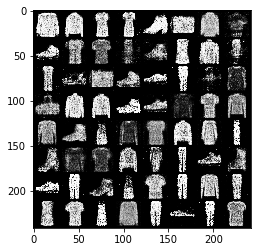

[Epoch 23/50] [Batch 601/938] [D loss: 1.318968] [G loss: 0.953377]
[Epoch 23/50] [Batch 602/938] [D loss: 1.216149] [G loss: 0.899462]
[Epoch 23/50] [Batch 603/938] [D loss: 1.197740] [G loss: 0.825510]
[Epoch 23/50] [Batch 604/938] [D loss: 1.251371] [G loss: 0.891325]
[Epoch 23/50] [Batch 605/938] [D loss: 1.283394] [G loss: 0.796386]
[Epoch 23/50] [Batch 606/938] [D loss: 1.345703] [G loss: 0.817990]
[Epoch 23/50] [Batch 607/938] [D loss: 1.192654] [G loss: 0.899216]
[Epoch 23/50] [Batch 608/938] [D loss: 1.163239] [G loss: 0.927822]
[Epoch 23/50] [Batch 609/938] [D loss: 1.315199] [G loss: 0.841974]
[Epoch 23/50] [Batch 610/938] [D loss: 1.305110] [G loss: 0.882663]
[Epoch 23/50] [Batch 611/938] [D loss: 1.271358] [G loss: 0.919687]
[Epoch 23/50] [Batch 612/938] [D loss: 1.291282] [G loss: 0.901325]
[Epoch 23/50] [Batch 613/938] [D loss: 1.206726] [G loss: 0.885121]
[Epoch 23/50] [Batch 614/938] [D loss: 1.324318] [G loss: 0.928543]
[Epoch 23/50] [Batch 615/938] [D loss: 1.321098]

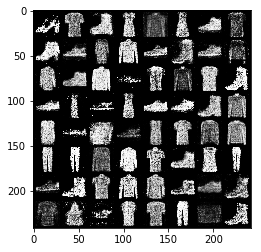

[Epoch 23/50] [Batch 801/938] [D loss: 1.252364] [G loss: 0.851124]
[Epoch 23/50] [Batch 802/938] [D loss: 1.208346] [G loss: 0.882553]
[Epoch 23/50] [Batch 803/938] [D loss: 1.206174] [G loss: 0.834051]
[Epoch 23/50] [Batch 804/938] [D loss: 1.220869] [G loss: 0.917255]
[Epoch 23/50] [Batch 805/938] [D loss: 1.215051] [G loss: 0.979748]
[Epoch 23/50] [Batch 806/938] [D loss: 1.240070] [G loss: 0.867995]
[Epoch 23/50] [Batch 807/938] [D loss: 1.291398] [G loss: 0.870775]
[Epoch 23/50] [Batch 808/938] [D loss: 1.277002] [G loss: 0.974906]
[Epoch 23/50] [Batch 809/938] [D loss: 1.201296] [G loss: 0.979434]
[Epoch 23/50] [Batch 810/938] [D loss: 1.205581] [G loss: 0.947726]
[Epoch 23/50] [Batch 811/938] [D loss: 1.293964] [G loss: 0.915301]
[Epoch 23/50] [Batch 812/938] [D loss: 1.348068] [G loss: 0.890215]
[Epoch 23/50] [Batch 813/938] [D loss: 1.259232] [G loss: 0.884896]
[Epoch 23/50] [Batch 814/938] [D loss: 1.215623] [G loss: 0.949740]
[Epoch 23/50] [Batch 815/938] [D loss: 1.215667]

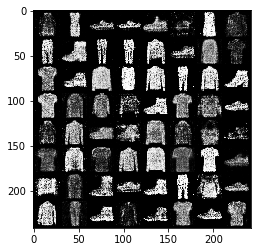

[Epoch 24/50] [Batch 1/938] [D loss: 1.376837] [G loss: 0.935757]
[Epoch 24/50] [Batch 2/938] [D loss: 1.280260] [G loss: 0.904490]
[Epoch 24/50] [Batch 3/938] [D loss: 1.320976] [G loss: 0.843461]
[Epoch 24/50] [Batch 4/938] [D loss: 1.277284] [G loss: 0.853220]
[Epoch 24/50] [Batch 5/938] [D loss: 1.208854] [G loss: 0.797742]
[Epoch 24/50] [Batch 6/938] [D loss: 1.291604] [G loss: 0.837976]
[Epoch 24/50] [Batch 7/938] [D loss: 1.335913] [G loss: 0.865786]
[Epoch 24/50] [Batch 8/938] [D loss: 1.281641] [G loss: 0.863568]
[Epoch 24/50] [Batch 9/938] [D loss: 1.246556] [G loss: 0.893837]
[Epoch 24/50] [Batch 10/938] [D loss: 1.303688] [G loss: 0.868491]
[Epoch 24/50] [Batch 11/938] [D loss: 1.287116] [G loss: 0.865305]
[Epoch 24/50] [Batch 12/938] [D loss: 1.342417] [G loss: 0.835725]
[Epoch 24/50] [Batch 13/938] [D loss: 1.230852] [G loss: 0.834863]
[Epoch 24/50] [Batch 14/938] [D loss: 1.298397] [G loss: 0.856428]
[Epoch 24/50] [Batch 15/938] [D loss: 1.185925] [G loss: 0.842177]
[Epo

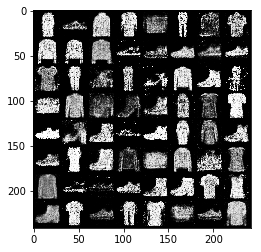

[Epoch 24/50] [Batch 201/938] [D loss: 1.335417] [G loss: 0.836021]
[Epoch 24/50] [Batch 202/938] [D loss: 1.352174] [G loss: 0.856673]
[Epoch 24/50] [Batch 203/938] [D loss: 1.236967] [G loss: 0.821934]
[Epoch 24/50] [Batch 204/938] [D loss: 1.319706] [G loss: 0.843616]
[Epoch 24/50] [Batch 205/938] [D loss: 1.266699] [G loss: 0.873708]
[Epoch 24/50] [Batch 206/938] [D loss: 1.290836] [G loss: 0.915195]
[Epoch 24/50] [Batch 207/938] [D loss: 1.315544] [G loss: 0.840153]
[Epoch 24/50] [Batch 208/938] [D loss: 1.264198] [G loss: 0.786914]
[Epoch 24/50] [Batch 209/938] [D loss: 1.204685] [G loss: 0.822126]
[Epoch 24/50] [Batch 210/938] [D loss: 1.302752] [G loss: 0.829408]
[Epoch 24/50] [Batch 211/938] [D loss: 1.283731] [G loss: 0.870013]
[Epoch 24/50] [Batch 212/938] [D loss: 1.195807] [G loss: 0.840282]
[Epoch 24/50] [Batch 213/938] [D loss: 1.280503] [G loss: 0.806691]
[Epoch 24/50] [Batch 214/938] [D loss: 1.162961] [G loss: 0.845996]
[Epoch 24/50] [Batch 215/938] [D loss: 1.406369]

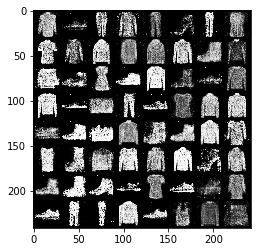

[Epoch 24/50] [Batch 401/938] [D loss: 1.289482] [G loss: 0.906807]
[Epoch 24/50] [Batch 402/938] [D loss: 1.233298] [G loss: 0.915262]
[Epoch 24/50] [Batch 403/938] [D loss: 1.242433] [G loss: 0.909414]
[Epoch 24/50] [Batch 404/938] [D loss: 1.393914] [G loss: 0.855990]
[Epoch 24/50] [Batch 405/938] [D loss: 1.288377] [G loss: 0.901960]
[Epoch 24/50] [Batch 406/938] [D loss: 1.303646] [G loss: 0.862931]
[Epoch 24/50] [Batch 407/938] [D loss: 1.208052] [G loss: 0.915955]
[Epoch 24/50] [Batch 408/938] [D loss: 1.265119] [G loss: 0.886507]
[Epoch 24/50] [Batch 409/938] [D loss: 1.376338] [G loss: 0.815567]
[Epoch 24/50] [Batch 410/938] [D loss: 1.287353] [G loss: 0.906078]
[Epoch 24/50] [Batch 411/938] [D loss: 1.254683] [G loss: 0.887529]
[Epoch 24/50] [Batch 412/938] [D loss: 1.200874] [G loss: 0.834781]
[Epoch 24/50] [Batch 413/938] [D loss: 1.213889] [G loss: 0.904856]
[Epoch 24/50] [Batch 414/938] [D loss: 1.358608] [G loss: 0.887889]
[Epoch 24/50] [Batch 415/938] [D loss: 1.328704]

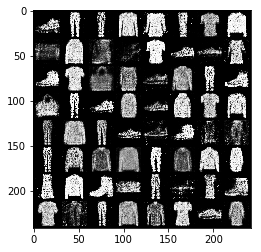

[Epoch 24/50] [Batch 601/938] [D loss: 1.298790] [G loss: 0.884718]
[Epoch 24/50] [Batch 602/938] [D loss: 1.327189] [G loss: 0.895004]
[Epoch 24/50] [Batch 603/938] [D loss: 1.306602] [G loss: 0.936997]
[Epoch 24/50] [Batch 604/938] [D loss: 1.282462] [G loss: 0.947669]
[Epoch 24/50] [Batch 605/938] [D loss: 1.232779] [G loss: 0.859685]
[Epoch 24/50] [Batch 606/938] [D loss: 1.164079] [G loss: 0.932680]
[Epoch 24/50] [Batch 607/938] [D loss: 1.305301] [G loss: 0.897149]
[Epoch 24/50] [Batch 608/938] [D loss: 1.175823] [G loss: 0.870465]
[Epoch 24/50] [Batch 609/938] [D loss: 1.166013] [G loss: 0.884372]
[Epoch 24/50] [Batch 610/938] [D loss: 1.295220] [G loss: 0.917319]
[Epoch 24/50] [Batch 611/938] [D loss: 1.228259] [G loss: 0.919330]
[Epoch 24/50] [Batch 612/938] [D loss: 1.277538] [G loss: 0.957352]
[Epoch 24/50] [Batch 613/938] [D loss: 1.182492] [G loss: 0.961737]
[Epoch 24/50] [Batch 614/938] [D loss: 1.271817] [G loss: 0.918705]
[Epoch 24/50] [Batch 615/938] [D loss: 1.313614]

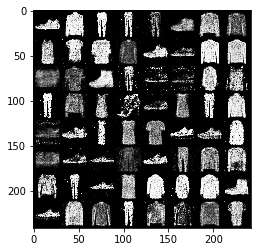

[Epoch 24/50] [Batch 801/938] [D loss: 1.352626] [G loss: 0.848087]
[Epoch 24/50] [Batch 802/938] [D loss: 1.407511] [G loss: 0.893374]
[Epoch 24/50] [Batch 803/938] [D loss: 1.207479] [G loss: 0.902743]
[Epoch 24/50] [Batch 804/938] [D loss: 1.247723] [G loss: 0.852020]
[Epoch 24/50] [Batch 805/938] [D loss: 1.279731] [G loss: 0.869831]
[Epoch 24/50] [Batch 806/938] [D loss: 1.306051] [G loss: 0.828140]
[Epoch 24/50] [Batch 807/938] [D loss: 1.274324] [G loss: 0.864905]
[Epoch 24/50] [Batch 808/938] [D loss: 1.259376] [G loss: 0.860286]
[Epoch 24/50] [Batch 809/938] [D loss: 1.212359] [G loss: 0.902655]
[Epoch 24/50] [Batch 810/938] [D loss: 1.173747] [G loss: 0.898189]
[Epoch 24/50] [Batch 811/938] [D loss: 1.294999] [G loss: 0.883591]
[Epoch 24/50] [Batch 812/938] [D loss: 1.306743] [G loss: 0.902374]
[Epoch 24/50] [Batch 813/938] [D loss: 1.359971] [G loss: 0.891241]
[Epoch 24/50] [Batch 814/938] [D loss: 1.296571] [G loss: 0.872127]
[Epoch 24/50] [Batch 815/938] [D loss: 1.291384]

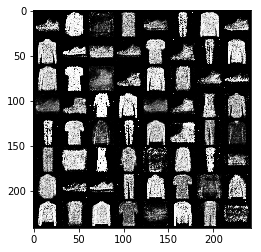

[Epoch 25/50] [Batch 1/938] [D loss: 1.223121] [G loss: 0.888353]
[Epoch 25/50] [Batch 2/938] [D loss: 1.310735] [G loss: 0.859399]
[Epoch 25/50] [Batch 3/938] [D loss: 1.299777] [G loss: 0.892844]
[Epoch 25/50] [Batch 4/938] [D loss: 1.273450] [G loss: 0.848729]
[Epoch 25/50] [Batch 5/938] [D loss: 1.252513] [G loss: 0.850305]
[Epoch 25/50] [Batch 6/938] [D loss: 1.301880] [G loss: 0.908715]
[Epoch 25/50] [Batch 7/938] [D loss: 1.229981] [G loss: 0.908762]
[Epoch 25/50] [Batch 8/938] [D loss: 1.199220] [G loss: 0.899697]
[Epoch 25/50] [Batch 9/938] [D loss: 1.154581] [G loss: 0.947960]
[Epoch 25/50] [Batch 10/938] [D loss: 1.247619] [G loss: 0.908102]
[Epoch 25/50] [Batch 11/938] [D loss: 1.303586] [G loss: 0.844021]
[Epoch 25/50] [Batch 12/938] [D loss: 1.270597] [G loss: 0.904161]
[Epoch 25/50] [Batch 13/938] [D loss: 1.278582] [G loss: 0.918886]
[Epoch 25/50] [Batch 14/938] [D loss: 1.265404] [G loss: 0.882876]
[Epoch 25/50] [Batch 15/938] [D loss: 1.256927] [G loss: 0.911517]
[Epo

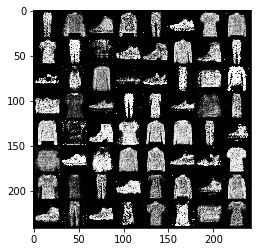

[Epoch 25/50] [Batch 201/938] [D loss: 1.270350] [G loss: 0.868015]
[Epoch 25/50] [Batch 202/938] [D loss: 1.266218] [G loss: 0.831364]
[Epoch 25/50] [Batch 203/938] [D loss: 1.254400] [G loss: 0.851139]
[Epoch 25/50] [Batch 204/938] [D loss: 1.287438] [G loss: 0.850227]
[Epoch 25/50] [Batch 205/938] [D loss: 1.210335] [G loss: 0.845021]
[Epoch 25/50] [Batch 206/938] [D loss: 1.284862] [G loss: 0.826176]
[Epoch 25/50] [Batch 207/938] [D loss: 1.292362] [G loss: 0.887342]
[Epoch 25/50] [Batch 208/938] [D loss: 1.354049] [G loss: 0.916580]
[Epoch 25/50] [Batch 209/938] [D loss: 1.293603] [G loss: 0.850888]
[Epoch 25/50] [Batch 210/938] [D loss: 1.374776] [G loss: 0.833482]
[Epoch 25/50] [Batch 211/938] [D loss: 1.266122] [G loss: 0.921628]
[Epoch 25/50] [Batch 212/938] [D loss: 1.350556] [G loss: 0.937209]
[Epoch 25/50] [Batch 213/938] [D loss: 1.272291] [G loss: 0.912461]
[Epoch 25/50] [Batch 214/938] [D loss: 1.214581] [G loss: 0.922020]
[Epoch 25/50] [Batch 215/938] [D loss: 1.233464]

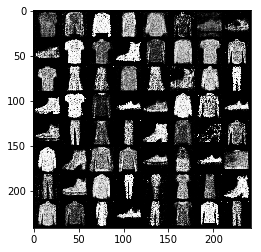

[Epoch 25/50] [Batch 401/938] [D loss: 1.228617] [G loss: 0.897248]
[Epoch 25/50] [Batch 402/938] [D loss: 1.178750] [G loss: 0.881314]
[Epoch 25/50] [Batch 403/938] [D loss: 1.187647] [G loss: 0.878550]
[Epoch 25/50] [Batch 404/938] [D loss: 1.217031] [G loss: 0.858145]
[Epoch 25/50] [Batch 405/938] [D loss: 1.239547] [G loss: 0.922751]
[Epoch 25/50] [Batch 406/938] [D loss: 1.273128] [G loss: 0.911467]
[Epoch 25/50] [Batch 407/938] [D loss: 1.352322] [G loss: 0.922837]
[Epoch 25/50] [Batch 408/938] [D loss: 1.334449] [G loss: 0.939855]
[Epoch 25/50] [Batch 409/938] [D loss: 1.231163] [G loss: 0.906855]
[Epoch 25/50] [Batch 410/938] [D loss: 1.337976] [G loss: 0.856997]
[Epoch 25/50] [Batch 411/938] [D loss: 1.230738] [G loss: 0.882044]
[Epoch 25/50] [Batch 412/938] [D loss: 1.292426] [G loss: 0.877568]
[Epoch 25/50] [Batch 413/938] [D loss: 1.216641] [G loss: 0.905597]
[Epoch 25/50] [Batch 414/938] [D loss: 1.187862] [G loss: 1.024356]
[Epoch 25/50] [Batch 415/938] [D loss: 1.251294]

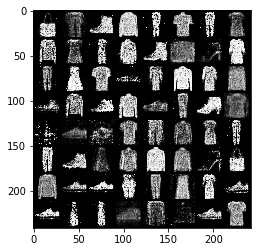

[Epoch 25/50] [Batch 601/938] [D loss: 1.255528] [G loss: 0.874547]
[Epoch 25/50] [Batch 602/938] [D loss: 1.279075] [G loss: 0.893499]
[Epoch 25/50] [Batch 603/938] [D loss: 1.314773] [G loss: 0.871027]
[Epoch 25/50] [Batch 604/938] [D loss: 1.290282] [G loss: 0.897142]
[Epoch 25/50] [Batch 605/938] [D loss: 1.263571] [G loss: 0.897014]
[Epoch 25/50] [Batch 606/938] [D loss: 1.224855] [G loss: 0.854348]
[Epoch 25/50] [Batch 607/938] [D loss: 1.336883] [G loss: 0.845625]
[Epoch 25/50] [Batch 608/938] [D loss: 1.342576] [G loss: 0.846460]
[Epoch 25/50] [Batch 609/938] [D loss: 1.220074] [G loss: 0.826454]
[Epoch 25/50] [Batch 610/938] [D loss: 1.298996] [G loss: 0.828064]
[Epoch 25/50] [Batch 611/938] [D loss: 1.323734] [G loss: 0.852685]
[Epoch 25/50] [Batch 612/938] [D loss: 1.264858] [G loss: 0.798768]
[Epoch 25/50] [Batch 613/938] [D loss: 1.374220] [G loss: 0.876901]
[Epoch 25/50] [Batch 614/938] [D loss: 1.238614] [G loss: 0.939686]
[Epoch 25/50] [Batch 615/938] [D loss: 1.289035]

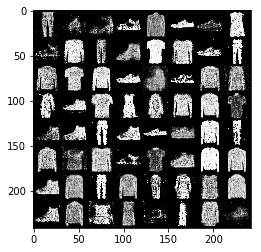

[Epoch 25/50] [Batch 801/938] [D loss: 1.248021] [G loss: 0.905625]
[Epoch 25/50] [Batch 802/938] [D loss: 1.330882] [G loss: 0.860938]
[Epoch 25/50] [Batch 803/938] [D loss: 1.308667] [G loss: 0.922010]
[Epoch 25/50] [Batch 804/938] [D loss: 1.266978] [G loss: 0.907917]
[Epoch 25/50] [Batch 805/938] [D loss: 1.267040] [G loss: 0.832887]
[Epoch 25/50] [Batch 806/938] [D loss: 1.350850] [G loss: 0.866969]
[Epoch 25/50] [Batch 807/938] [D loss: 1.274462] [G loss: 0.879763]
[Epoch 25/50] [Batch 808/938] [D loss: 1.216703] [G loss: 0.904095]
[Epoch 25/50] [Batch 809/938] [D loss: 1.318624] [G loss: 0.918201]
[Epoch 25/50] [Batch 810/938] [D loss: 1.220505] [G loss: 0.932279]
[Epoch 25/50] [Batch 811/938] [D loss: 1.253611] [G loss: 0.862167]
[Epoch 25/50] [Batch 812/938] [D loss: 1.299896] [G loss: 0.860568]
[Epoch 25/50] [Batch 813/938] [D loss: 1.296684] [G loss: 0.886996]
[Epoch 25/50] [Batch 814/938] [D loss: 1.250664] [G loss: 0.947767]
[Epoch 25/50] [Batch 815/938] [D loss: 1.391163]

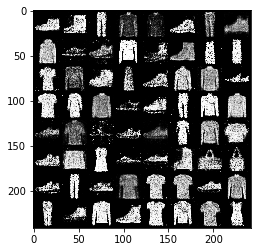

[Epoch 26/50] [Batch 1/938] [D loss: 1.255911] [G loss: 0.817124]
[Epoch 26/50] [Batch 2/938] [D loss: 1.336814] [G loss: 0.866391]
[Epoch 26/50] [Batch 3/938] [D loss: 1.242812] [G loss: 0.881705]
[Epoch 26/50] [Batch 4/938] [D loss: 1.217121] [G loss: 0.903511]
[Epoch 26/50] [Batch 5/938] [D loss: 1.340592] [G loss: 0.873372]
[Epoch 26/50] [Batch 6/938] [D loss: 1.275515] [G loss: 0.910297]
[Epoch 26/50] [Batch 7/938] [D loss: 1.226109] [G loss: 0.973048]
[Epoch 26/50] [Batch 8/938] [D loss: 1.288875] [G loss: 0.864485]
[Epoch 26/50] [Batch 9/938] [D loss: 1.212139] [G loss: 0.827612]
[Epoch 26/50] [Batch 10/938] [D loss: 1.291320] [G loss: 0.888730]
[Epoch 26/50] [Batch 11/938] [D loss: 1.255178] [G loss: 0.903144]
[Epoch 26/50] [Batch 12/938] [D loss: 1.206678] [G loss: 0.874704]
[Epoch 26/50] [Batch 13/938] [D loss: 1.325656] [G loss: 0.863039]
[Epoch 26/50] [Batch 14/938] [D loss: 1.337468] [G loss: 0.859673]
[Epoch 26/50] [Batch 15/938] [D loss: 1.233820] [G loss: 0.909666]
[Epo

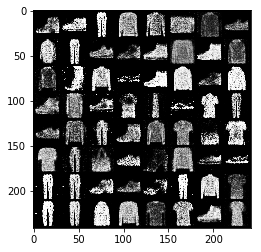

[Epoch 26/50] [Batch 201/938] [D loss: 1.219584] [G loss: 0.946875]
[Epoch 26/50] [Batch 202/938] [D loss: 1.251748] [G loss: 0.832847]
[Epoch 26/50] [Batch 203/938] [D loss: 1.407483] [G loss: 0.865861]
[Epoch 26/50] [Batch 204/938] [D loss: 1.375671] [G loss: 0.870809]
[Epoch 26/50] [Batch 205/938] [D loss: 1.258955] [G loss: 0.868508]
[Epoch 26/50] [Batch 206/938] [D loss: 1.228783] [G loss: 0.913653]
[Epoch 26/50] [Batch 207/938] [D loss: 1.238857] [G loss: 0.910392]
[Epoch 26/50] [Batch 208/938] [D loss: 1.346451] [G loss: 0.866550]
[Epoch 26/50] [Batch 209/938] [D loss: 1.227207] [G loss: 0.917990]
[Epoch 26/50] [Batch 210/938] [D loss: 1.312845] [G loss: 0.906086]
[Epoch 26/50] [Batch 211/938] [D loss: 1.254101] [G loss: 0.909523]
[Epoch 26/50] [Batch 212/938] [D loss: 1.226686] [G loss: 0.857144]
[Epoch 26/50] [Batch 213/938] [D loss: 1.209762] [G loss: 0.939503]
[Epoch 26/50] [Batch 214/938] [D loss: 1.328787] [G loss: 0.923725]
[Epoch 26/50] [Batch 215/938] [D loss: 1.211244]

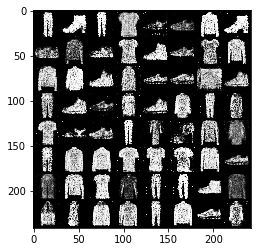

[Epoch 26/50] [Batch 401/938] [D loss: 1.416181] [G loss: 0.812952]
[Epoch 26/50] [Batch 402/938] [D loss: 1.291753] [G loss: 0.855363]
[Epoch 26/50] [Batch 403/938] [D loss: 1.248786] [G loss: 0.907959]
[Epoch 26/50] [Batch 404/938] [D loss: 1.335834] [G loss: 0.871674]
[Epoch 26/50] [Batch 405/938] [D loss: 1.261471] [G loss: 0.862633]
[Epoch 26/50] [Batch 406/938] [D loss: 1.319085] [G loss: 0.891246]
[Epoch 26/50] [Batch 407/938] [D loss: 1.258822] [G loss: 0.887395]
[Epoch 26/50] [Batch 408/938] [D loss: 1.282960] [G loss: 0.875036]
[Epoch 26/50] [Batch 409/938] [D loss: 1.263633] [G loss: 0.898333]
[Epoch 26/50] [Batch 410/938] [D loss: 1.339142] [G loss: 0.806379]
[Epoch 26/50] [Batch 411/938] [D loss: 1.291256] [G loss: 0.843184]
[Epoch 26/50] [Batch 412/938] [D loss: 1.234237] [G loss: 0.875424]
[Epoch 26/50] [Batch 413/938] [D loss: 1.283868] [G loss: 0.888401]
[Epoch 26/50] [Batch 414/938] [D loss: 1.285105] [G loss: 0.903571]
[Epoch 26/50] [Batch 415/938] [D loss: 1.334986]

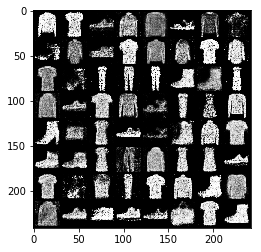

[Epoch 26/50] [Batch 601/938] [D loss: 1.381220] [G loss: 0.978480]
[Epoch 26/50] [Batch 602/938] [D loss: 1.324750] [G loss: 0.899082]
[Epoch 26/50] [Batch 603/938] [D loss: 1.338053] [G loss: 0.882716]
[Epoch 26/50] [Batch 604/938] [D loss: 1.300179] [G loss: 0.833432]
[Epoch 26/50] [Batch 605/938] [D loss: 1.312283] [G loss: 0.880941]
[Epoch 26/50] [Batch 606/938] [D loss: 1.284692] [G loss: 0.811896]
[Epoch 26/50] [Batch 607/938] [D loss: 1.312072] [G loss: 0.818892]
[Epoch 26/50] [Batch 608/938] [D loss: 1.257598] [G loss: 0.795501]
[Epoch 26/50] [Batch 609/938] [D loss: 1.345487] [G loss: 0.839600]
[Epoch 26/50] [Batch 610/938] [D loss: 1.248582] [G loss: 0.850152]
[Epoch 26/50] [Batch 611/938] [D loss: 1.322356] [G loss: 0.875876]
[Epoch 26/50] [Batch 612/938] [D loss: 1.379041] [G loss: 0.863254]
[Epoch 26/50] [Batch 613/938] [D loss: 1.302664] [G loss: 0.898112]
[Epoch 26/50] [Batch 614/938] [D loss: 1.344779] [G loss: 0.850484]
[Epoch 26/50] [Batch 615/938] [D loss: 1.258545]

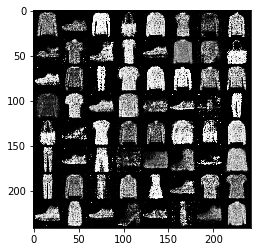

[Epoch 26/50] [Batch 801/938] [D loss: 1.252241] [G loss: 0.895891]
[Epoch 26/50] [Batch 802/938] [D loss: 1.277808] [G loss: 0.903587]
[Epoch 26/50] [Batch 803/938] [D loss: 1.303805] [G loss: 0.854452]
[Epoch 26/50] [Batch 804/938] [D loss: 1.302269] [G loss: 0.831795]
[Epoch 26/50] [Batch 805/938] [D loss: 1.355048] [G loss: 0.818998]
[Epoch 26/50] [Batch 806/938] [D loss: 1.270255] [G loss: 0.845577]
[Epoch 26/50] [Batch 807/938] [D loss: 1.217741] [G loss: 0.888441]
[Epoch 26/50] [Batch 808/938] [D loss: 1.317519] [G loss: 0.852241]
[Epoch 26/50] [Batch 809/938] [D loss: 1.208327] [G loss: 0.877551]
[Epoch 26/50] [Batch 810/938] [D loss: 1.178311] [G loss: 0.964120]
[Epoch 26/50] [Batch 811/938] [D loss: 1.289277] [G loss: 0.832572]
[Epoch 26/50] [Batch 812/938] [D loss: 1.407048] [G loss: 0.867520]
[Epoch 26/50] [Batch 813/938] [D loss: 1.340894] [G loss: 0.884638]
[Epoch 26/50] [Batch 814/938] [D loss: 1.297240] [G loss: 0.934997]
[Epoch 26/50] [Batch 815/938] [D loss: 1.278355]

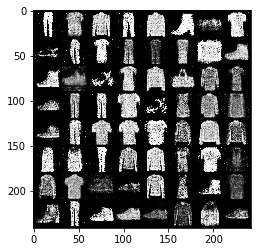

[Epoch 27/50] [Batch 1/938] [D loss: 1.208068] [G loss: 0.948167]
[Epoch 27/50] [Batch 2/938] [D loss: 1.240792] [G loss: 0.840021]
[Epoch 27/50] [Batch 3/938] [D loss: 1.308663] [G loss: 0.837745]
[Epoch 27/50] [Batch 4/938] [D loss: 1.273632] [G loss: 0.848871]
[Epoch 27/50] [Batch 5/938] [D loss: 1.349989] [G loss: 0.853640]
[Epoch 27/50] [Batch 6/938] [D loss: 1.353436] [G loss: 0.825292]
[Epoch 27/50] [Batch 7/938] [D loss: 1.331668] [G loss: 0.857163]
[Epoch 27/50] [Batch 8/938] [D loss: 1.313491] [G loss: 0.862399]
[Epoch 27/50] [Batch 9/938] [D loss: 1.240909] [G loss: 0.894670]
[Epoch 27/50] [Batch 10/938] [D loss: 1.380368] [G loss: 0.849826]
[Epoch 27/50] [Batch 11/938] [D loss: 1.268746] [G loss: 0.854400]
[Epoch 27/50] [Batch 12/938] [D loss: 1.304388] [G loss: 0.836805]
[Epoch 27/50] [Batch 13/938] [D loss: 1.268487] [G loss: 0.816144]
[Epoch 27/50] [Batch 14/938] [D loss: 1.286571] [G loss: 0.843394]
[Epoch 27/50] [Batch 15/938] [D loss: 1.303246] [G loss: 0.890467]
[Epo

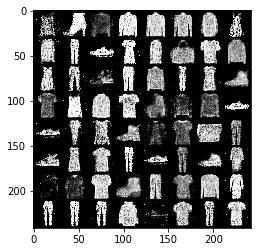

[Epoch 27/50] [Batch 201/938] [D loss: 1.272557] [G loss: 0.867547]
[Epoch 27/50] [Batch 202/938] [D loss: 1.308506] [G loss: 0.919091]
[Epoch 27/50] [Batch 203/938] [D loss: 1.255966] [G loss: 0.906693]
[Epoch 27/50] [Batch 204/938] [D loss: 1.232388] [G loss: 0.896591]
[Epoch 27/50] [Batch 205/938] [D loss: 1.287838] [G loss: 0.908026]
[Epoch 27/50] [Batch 206/938] [D loss: 1.290639] [G loss: 0.877628]
[Epoch 27/50] [Batch 207/938] [D loss: 1.268784] [G loss: 0.864646]
[Epoch 27/50] [Batch 208/938] [D loss: 1.359698] [G loss: 0.842398]
[Epoch 27/50] [Batch 209/938] [D loss: 1.289834] [G loss: 0.872107]
[Epoch 27/50] [Batch 210/938] [D loss: 1.312302] [G loss: 0.867462]
[Epoch 27/50] [Batch 211/938] [D loss: 1.289811] [G loss: 0.835893]
[Epoch 27/50] [Batch 212/938] [D loss: 1.304002] [G loss: 0.834982]
[Epoch 27/50] [Batch 213/938] [D loss: 1.302909] [G loss: 0.813745]
[Epoch 27/50] [Batch 214/938] [D loss: 1.360345] [G loss: 0.800876]
[Epoch 27/50] [Batch 215/938] [D loss: 1.254243]

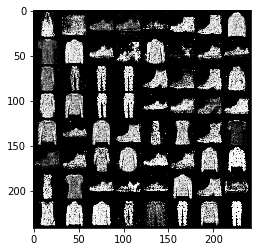

[Epoch 27/50] [Batch 401/938] [D loss: 1.193219] [G loss: 0.850253]
[Epoch 27/50] [Batch 402/938] [D loss: 1.160710] [G loss: 0.881454]
[Epoch 27/50] [Batch 403/938] [D loss: 1.240702] [G loss: 0.803466]
[Epoch 27/50] [Batch 404/938] [D loss: 1.248362] [G loss: 0.860154]
[Epoch 27/50] [Batch 405/938] [D loss: 1.353254] [G loss: 0.928348]
[Epoch 27/50] [Batch 406/938] [D loss: 1.268269] [G loss: 0.883202]
[Epoch 27/50] [Batch 407/938] [D loss: 1.190046] [G loss: 0.918499]
[Epoch 27/50] [Batch 408/938] [D loss: 1.237043] [G loss: 0.873902]
[Epoch 27/50] [Batch 409/938] [D loss: 1.146583] [G loss: 0.880881]
[Epoch 27/50] [Batch 410/938] [D loss: 1.191462] [G loss: 0.846546]
[Epoch 27/50] [Batch 411/938] [D loss: 1.323873] [G loss: 0.897462]
[Epoch 27/50] [Batch 412/938] [D loss: 1.225993] [G loss: 0.861632]
[Epoch 27/50] [Batch 413/938] [D loss: 1.258017] [G loss: 0.873779]
[Epoch 27/50] [Batch 414/938] [D loss: 1.393115] [G loss: 0.893529]
[Epoch 27/50] [Batch 415/938] [D loss: 1.275627]

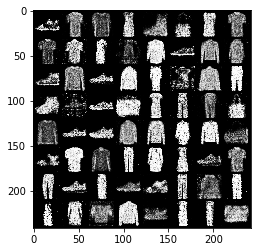

[Epoch 27/50] [Batch 601/938] [D loss: 1.265848] [G loss: 0.924245]
[Epoch 27/50] [Batch 602/938] [D loss: 1.446200] [G loss: 0.920019]
[Epoch 27/50] [Batch 603/938] [D loss: 1.252287] [G loss: 0.843498]
[Epoch 27/50] [Batch 604/938] [D loss: 1.313068] [G loss: 0.873810]
[Epoch 27/50] [Batch 605/938] [D loss: 1.299878] [G loss: 0.864091]
[Epoch 27/50] [Batch 606/938] [D loss: 1.332359] [G loss: 0.836130]
[Epoch 27/50] [Batch 607/938] [D loss: 1.304743] [G loss: 0.851085]
[Epoch 27/50] [Batch 608/938] [D loss: 1.301551] [G loss: 0.827311]
[Epoch 27/50] [Batch 609/938] [D loss: 1.219160] [G loss: 0.860639]
[Epoch 27/50] [Batch 610/938] [D loss: 1.202843] [G loss: 0.826792]
[Epoch 27/50] [Batch 611/938] [D loss: 1.329957] [G loss: 0.811053]
[Epoch 27/50] [Batch 612/938] [D loss: 1.227528] [G loss: 0.836109]
[Epoch 27/50] [Batch 613/938] [D loss: 1.281819] [G loss: 0.852610]
[Epoch 27/50] [Batch 614/938] [D loss: 1.263031] [G loss: 0.795829]
[Epoch 27/50] [Batch 615/938] [D loss: 1.320593]

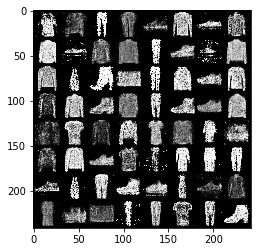

[Epoch 27/50] [Batch 801/938] [D loss: 1.262994] [G loss: 0.904545]
[Epoch 27/50] [Batch 802/938] [D loss: 1.175085] [G loss: 0.952437]
[Epoch 27/50] [Batch 803/938] [D loss: 1.234674] [G loss: 0.969360]
[Epoch 27/50] [Batch 804/938] [D loss: 1.264857] [G loss: 0.840473]
[Epoch 27/50] [Batch 805/938] [D loss: 1.319337] [G loss: 0.854648]
[Epoch 27/50] [Batch 806/938] [D loss: 1.326781] [G loss: 0.877741]
[Epoch 27/50] [Batch 807/938] [D loss: 1.349210] [G loss: 0.830630]
[Epoch 27/50] [Batch 808/938] [D loss: 1.266329] [G loss: 0.810055]
[Epoch 27/50] [Batch 809/938] [D loss: 1.310385] [G loss: 0.923998]
[Epoch 27/50] [Batch 810/938] [D loss: 1.263711] [G loss: 0.954414]
[Epoch 27/50] [Batch 811/938] [D loss: 1.188569] [G loss: 0.888247]
[Epoch 27/50] [Batch 812/938] [D loss: 1.386343] [G loss: 0.911642]
[Epoch 27/50] [Batch 813/938] [D loss: 1.346029] [G loss: 0.910644]
[Epoch 27/50] [Batch 814/938] [D loss: 1.209350] [G loss: 0.820581]
[Epoch 27/50] [Batch 815/938] [D loss: 1.240292]

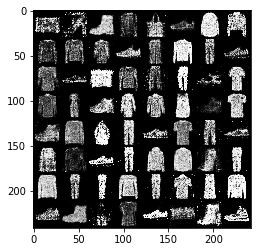

[Epoch 28/50] [Batch 1/938] [D loss: 1.289836] [G loss: 0.814439]
[Epoch 28/50] [Batch 2/938] [D loss: 1.257207] [G loss: 0.808704]
[Epoch 28/50] [Batch 3/938] [D loss: 1.315508] [G loss: 0.820009]
[Epoch 28/50] [Batch 4/938] [D loss: 1.311342] [G loss: 0.889187]
[Epoch 28/50] [Batch 5/938] [D loss: 1.272666] [G loss: 0.861164]
[Epoch 28/50] [Batch 6/938] [D loss: 1.283431] [G loss: 0.864793]
[Epoch 28/50] [Batch 7/938] [D loss: 1.243068] [G loss: 0.889811]
[Epoch 28/50] [Batch 8/938] [D loss: 1.345015] [G loss: 0.859514]
[Epoch 28/50] [Batch 9/938] [D loss: 1.301051] [G loss: 0.865974]
[Epoch 28/50] [Batch 10/938] [D loss: 1.300017] [G loss: 0.892400]
[Epoch 28/50] [Batch 11/938] [D loss: 1.322801] [G loss: 0.867420]
[Epoch 28/50] [Batch 12/938] [D loss: 1.238950] [G loss: 0.861409]
[Epoch 28/50] [Batch 13/938] [D loss: 1.235425] [G loss: 0.897506]
[Epoch 28/50] [Batch 14/938] [D loss: 1.266255] [G loss: 0.834491]
[Epoch 28/50] [Batch 15/938] [D loss: 1.230378] [G loss: 0.847080]
[Epo

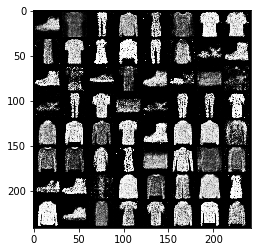

[Epoch 28/50] [Batch 201/938] [D loss: 1.300684] [G loss: 0.780143]
[Epoch 28/50] [Batch 202/938] [D loss: 1.204573] [G loss: 0.872179]
[Epoch 28/50] [Batch 203/938] [D loss: 1.230699] [G loss: 0.889137]
[Epoch 28/50] [Batch 204/938] [D loss: 1.223262] [G loss: 0.811840]
[Epoch 28/50] [Batch 205/938] [D loss: 1.214656] [G loss: 0.863689]
[Epoch 28/50] [Batch 206/938] [D loss: 1.236077] [G loss: 0.934885]
[Epoch 28/50] [Batch 207/938] [D loss: 1.199840] [G loss: 0.922696]
[Epoch 28/50] [Batch 208/938] [D loss: 1.296828] [G loss: 0.955425]
[Epoch 28/50] [Batch 209/938] [D loss: 1.203247] [G loss: 0.896698]
[Epoch 28/50] [Batch 210/938] [D loss: 1.237182] [G loss: 0.901269]
[Epoch 28/50] [Batch 211/938] [D loss: 1.277003] [G loss: 0.957822]
[Epoch 28/50] [Batch 212/938] [D loss: 1.231671] [G loss: 0.873383]
[Epoch 28/50] [Batch 213/938] [D loss: 1.197113] [G loss: 0.924045]
[Epoch 28/50] [Batch 214/938] [D loss: 1.419115] [G loss: 0.845686]
[Epoch 28/50] [Batch 215/938] [D loss: 1.297898]

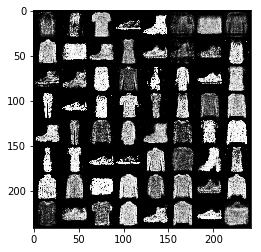

[Epoch 28/50] [Batch 401/938] [D loss: 1.266080] [G loss: 0.831653]
[Epoch 28/50] [Batch 402/938] [D loss: 1.384887] [G loss: 0.832557]
[Epoch 28/50] [Batch 403/938] [D loss: 1.199723] [G loss: 0.867797]
[Epoch 28/50] [Batch 404/938] [D loss: 1.315744] [G loss: 0.854568]
[Epoch 28/50] [Batch 405/938] [D loss: 1.384456] [G loss: 0.839072]
[Epoch 28/50] [Batch 406/938] [D loss: 1.247186] [G loss: 0.923403]
[Epoch 28/50] [Batch 407/938] [D loss: 1.313366] [G loss: 0.873650]
[Epoch 28/50] [Batch 408/938] [D loss: 1.295431] [G loss: 0.862143]
[Epoch 28/50] [Batch 409/938] [D loss: 1.238986] [G loss: 0.865035]
[Epoch 28/50] [Batch 410/938] [D loss: 1.359506] [G loss: 0.869485]
[Epoch 28/50] [Batch 411/938] [D loss: 1.345193] [G loss: 0.901396]
[Epoch 28/50] [Batch 412/938] [D loss: 1.303832] [G loss: 0.878459]
[Epoch 28/50] [Batch 413/938] [D loss: 1.350704] [G loss: 0.863278]
[Epoch 28/50] [Batch 414/938] [D loss: 1.284190] [G loss: 0.893600]
[Epoch 28/50] [Batch 415/938] [D loss: 1.344277]

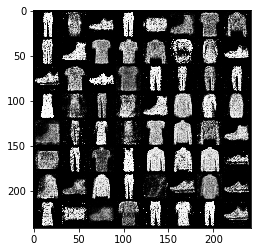

[Epoch 28/50] [Batch 601/938] [D loss: 1.285168] [G loss: 0.875195]
[Epoch 28/50] [Batch 602/938] [D loss: 1.267092] [G loss: 0.878806]
[Epoch 28/50] [Batch 603/938] [D loss: 1.198769] [G loss: 0.865687]
[Epoch 28/50] [Batch 604/938] [D loss: 1.386655] [G loss: 0.893979]
[Epoch 28/50] [Batch 605/938] [D loss: 1.330203] [G loss: 0.944386]
[Epoch 28/50] [Batch 606/938] [D loss: 1.246588] [G loss: 0.925210]
[Epoch 28/50] [Batch 607/938] [D loss: 1.310372] [G loss: 0.850542]
[Epoch 28/50] [Batch 608/938] [D loss: 1.238807] [G loss: 0.915549]
[Epoch 28/50] [Batch 609/938] [D loss: 1.229206] [G loss: 0.846057]
[Epoch 28/50] [Batch 610/938] [D loss: 1.198295] [G loss: 0.827877]
[Epoch 28/50] [Batch 611/938] [D loss: 1.291250] [G loss: 0.810507]
[Epoch 28/50] [Batch 612/938] [D loss: 1.207603] [G loss: 0.873049]
[Epoch 28/50] [Batch 613/938] [D loss: 1.267499] [G loss: 0.942403]
[Epoch 28/50] [Batch 614/938] [D loss: 1.288720] [G loss: 0.957522]
[Epoch 28/50] [Batch 615/938] [D loss: 1.440012]

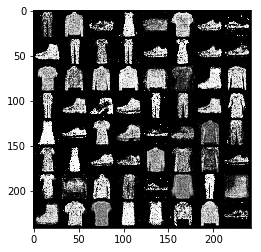

[Epoch 28/50] [Batch 801/938] [D loss: 1.210341] [G loss: 0.908538]
[Epoch 28/50] [Batch 802/938] [D loss: 1.289342] [G loss: 0.853969]
[Epoch 28/50] [Batch 803/938] [D loss: 1.241788] [G loss: 0.888481]
[Epoch 28/50] [Batch 804/938] [D loss: 1.287773] [G loss: 0.873365]
[Epoch 28/50] [Batch 805/938] [D loss: 1.421118] [G loss: 0.891317]
[Epoch 28/50] [Batch 806/938] [D loss: 1.296045] [G loss: 0.910638]
[Epoch 28/50] [Batch 807/938] [D loss: 1.222246] [G loss: 0.899331]
[Epoch 28/50] [Batch 808/938] [D loss: 1.243241] [G loss: 0.837980]
[Epoch 28/50] [Batch 809/938] [D loss: 1.304493] [G loss: 0.801859]
[Epoch 28/50] [Batch 810/938] [D loss: 1.227380] [G loss: 0.818135]
[Epoch 28/50] [Batch 811/938] [D loss: 1.326446] [G loss: 0.966489]
[Epoch 28/50] [Batch 812/938] [D loss: 1.169865] [G loss: 0.908441]
[Epoch 28/50] [Batch 813/938] [D loss: 1.239892] [G loss: 0.872152]
[Epoch 28/50] [Batch 814/938] [D loss: 1.279184] [G loss: 0.883974]
[Epoch 28/50] [Batch 815/938] [D loss: 1.292644]

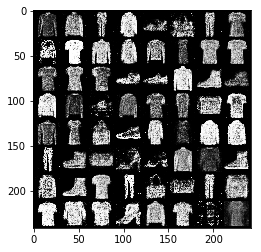

[Epoch 29/50] [Batch 1/938] [D loss: 1.258467] [G loss: 0.856183]
[Epoch 29/50] [Batch 2/938] [D loss: 1.323610] [G loss: 0.939174]
[Epoch 29/50] [Batch 3/938] [D loss: 1.305421] [G loss: 0.879192]
[Epoch 29/50] [Batch 4/938] [D loss: 1.282981] [G loss: 0.943798]
[Epoch 29/50] [Batch 5/938] [D loss: 1.237222] [G loss: 0.962704]
[Epoch 29/50] [Batch 6/938] [D loss: 1.282163] [G loss: 0.899639]
[Epoch 29/50] [Batch 7/938] [D loss: 1.220965] [G loss: 0.913424]
[Epoch 29/50] [Batch 8/938] [D loss: 1.297835] [G loss: 0.917041]
[Epoch 29/50] [Batch 9/938] [D loss: 1.331171] [G loss: 0.875360]
[Epoch 29/50] [Batch 10/938] [D loss: 1.263102] [G loss: 0.873348]
[Epoch 29/50] [Batch 11/938] [D loss: 1.244904] [G loss: 0.879091]
[Epoch 29/50] [Batch 12/938] [D loss: 1.255737] [G loss: 0.867022]
[Epoch 29/50] [Batch 13/938] [D loss: 1.283479] [G loss: 0.824011]
[Epoch 29/50] [Batch 14/938] [D loss: 1.275445] [G loss: 0.904531]
[Epoch 29/50] [Batch 15/938] [D loss: 1.197714] [G loss: 0.929304]
[Epo

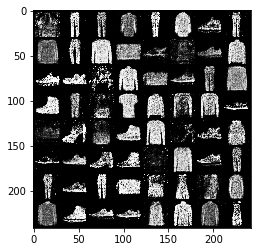

[Epoch 29/50] [Batch 201/938] [D loss: 1.271501] [G loss: 0.918157]
[Epoch 29/50] [Batch 202/938] [D loss: 1.350412] [G loss: 0.911183]
[Epoch 29/50] [Batch 203/938] [D loss: 1.308814] [G loss: 0.891468]
[Epoch 29/50] [Batch 204/938] [D loss: 1.192530] [G loss: 0.928511]
[Epoch 29/50] [Batch 205/938] [D loss: 1.338124] [G loss: 0.912848]
[Epoch 29/50] [Batch 206/938] [D loss: 1.210518] [G loss: 0.957543]
[Epoch 29/50] [Batch 207/938] [D loss: 1.218041] [G loss: 0.894394]
[Epoch 29/50] [Batch 208/938] [D loss: 1.240094] [G loss: 0.873529]
[Epoch 29/50] [Batch 209/938] [D loss: 1.392332] [G loss: 0.885743]
[Epoch 29/50] [Batch 210/938] [D loss: 1.404016] [G loss: 0.950028]
[Epoch 29/50] [Batch 211/938] [D loss: 1.285492] [G loss: 0.942121]
[Epoch 29/50] [Batch 212/938] [D loss: 1.316621] [G loss: 0.869913]
[Epoch 29/50] [Batch 213/938] [D loss: 1.242975] [G loss: 0.908406]
[Epoch 29/50] [Batch 214/938] [D loss: 1.336291] [G loss: 0.886249]
[Epoch 29/50] [Batch 215/938] [D loss: 1.320861]

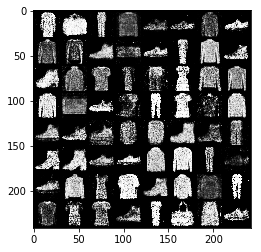

[Epoch 29/50] [Batch 401/938] [D loss: 1.271302] [G loss: 0.865160]
[Epoch 29/50] [Batch 402/938] [D loss: 1.189457] [G loss: 0.889762]
[Epoch 29/50] [Batch 403/938] [D loss: 1.307190] [G loss: 0.886939]
[Epoch 29/50] [Batch 404/938] [D loss: 1.335205] [G loss: 0.933027]
[Epoch 29/50] [Batch 405/938] [D loss: 1.269564] [G loss: 0.884128]
[Epoch 29/50] [Batch 406/938] [D loss: 1.324034] [G loss: 0.873328]
[Epoch 29/50] [Batch 407/938] [D loss: 1.354663] [G loss: 0.913166]
[Epoch 29/50] [Batch 408/938] [D loss: 1.280689] [G loss: 0.875989]
[Epoch 29/50] [Batch 409/938] [D loss: 1.309761] [G loss: 0.923596]
[Epoch 29/50] [Batch 410/938] [D loss: 1.242680] [G loss: 0.882196]
[Epoch 29/50] [Batch 411/938] [D loss: 1.291130] [G loss: 0.849660]
[Epoch 29/50] [Batch 412/938] [D loss: 1.265620] [G loss: 0.844241]
[Epoch 29/50] [Batch 413/938] [D loss: 1.223356] [G loss: 0.847304]
[Epoch 29/50] [Batch 414/938] [D loss: 1.392624] [G loss: 0.822301]
[Epoch 29/50] [Batch 415/938] [D loss: 1.397982]

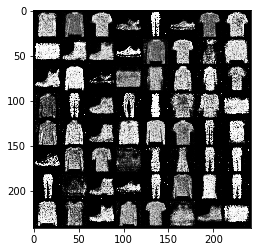

[Epoch 29/50] [Batch 601/938] [D loss: 1.229353] [G loss: 0.903350]
[Epoch 29/50] [Batch 602/938] [D loss: 1.193040] [G loss: 0.888570]
[Epoch 29/50] [Batch 603/938] [D loss: 1.294227] [G loss: 0.895877]
[Epoch 29/50] [Batch 604/938] [D loss: 1.268496] [G loss: 0.892095]
[Epoch 29/50] [Batch 605/938] [D loss: 1.228249] [G loss: 0.836905]
[Epoch 29/50] [Batch 606/938] [D loss: 1.310603] [G loss: 0.880864]
[Epoch 29/50] [Batch 607/938] [D loss: 1.359554] [G loss: 0.867330]
[Epoch 29/50] [Batch 608/938] [D loss: 1.226232] [G loss: 0.931315]
[Epoch 29/50] [Batch 609/938] [D loss: 1.221288] [G loss: 0.957873]
[Epoch 29/50] [Batch 610/938] [D loss: 1.225466] [G loss: 0.909997]
[Epoch 29/50] [Batch 611/938] [D loss: 1.308264] [G loss: 0.926937]
[Epoch 29/50] [Batch 612/938] [D loss: 1.283921] [G loss: 0.910152]
[Epoch 29/50] [Batch 613/938] [D loss: 1.200833] [G loss: 0.901191]
[Epoch 29/50] [Batch 614/938] [D loss: 1.304715] [G loss: 0.895564]
[Epoch 29/50] [Batch 615/938] [D loss: 1.295048]

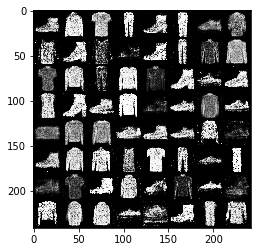

[Epoch 29/50] [Batch 801/938] [D loss: 1.283191] [G loss: 0.886255]
[Epoch 29/50] [Batch 802/938] [D loss: 1.250205] [G loss: 0.892626]
[Epoch 29/50] [Batch 803/938] [D loss: 1.214653] [G loss: 0.858491]
[Epoch 29/50] [Batch 804/938] [D loss: 1.293671] [G loss: 0.850038]
[Epoch 29/50] [Batch 805/938] [D loss: 1.315728] [G loss: 0.845405]
[Epoch 29/50] [Batch 806/938] [D loss: 1.252708] [G loss: 0.895419]
[Epoch 29/50] [Batch 807/938] [D loss: 1.334444] [G loss: 0.913429]
[Epoch 29/50] [Batch 808/938] [D loss: 1.228132] [G loss: 0.872733]
[Epoch 29/50] [Batch 809/938] [D loss: 1.201263] [G loss: 0.885348]
[Epoch 29/50] [Batch 810/938] [D loss: 1.235332] [G loss: 0.888451]
[Epoch 29/50] [Batch 811/938] [D loss: 1.350939] [G loss: 0.875124]
[Epoch 29/50] [Batch 812/938] [D loss: 1.196948] [G loss: 0.885024]
[Epoch 29/50] [Batch 813/938] [D loss: 1.347727] [G loss: 0.833025]
[Epoch 29/50] [Batch 814/938] [D loss: 1.261478] [G loss: 0.907617]
[Epoch 29/50] [Batch 815/938] [D loss: 1.340945]

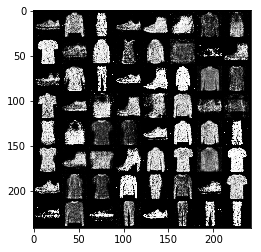

[Epoch 30/50] [Batch 1/938] [D loss: 1.255985] [G loss: 0.891474]
[Epoch 30/50] [Batch 2/938] [D loss: 1.253270] [G loss: 0.857731]
[Epoch 30/50] [Batch 3/938] [D loss: 1.324030] [G loss: 0.851122]
[Epoch 30/50] [Batch 4/938] [D loss: 1.292735] [G loss: 0.837760]
[Epoch 30/50] [Batch 5/938] [D loss: 1.236537] [G loss: 0.874293]
[Epoch 30/50] [Batch 6/938] [D loss: 1.243908] [G loss: 0.835282]
[Epoch 30/50] [Batch 7/938] [D loss: 1.382810] [G loss: 0.860050]
[Epoch 30/50] [Batch 8/938] [D loss: 1.303905] [G loss: 0.886774]
[Epoch 30/50] [Batch 9/938] [D loss: 1.225713] [G loss: 0.888550]
[Epoch 30/50] [Batch 10/938] [D loss: 1.276412] [G loss: 0.869181]
[Epoch 30/50] [Batch 11/938] [D loss: 1.177438] [G loss: 0.872780]
[Epoch 30/50] [Batch 12/938] [D loss: 1.334258] [G loss: 0.816391]
[Epoch 30/50] [Batch 13/938] [D loss: 1.300395] [G loss: 0.913974]
[Epoch 30/50] [Batch 14/938] [D loss: 1.278868] [G loss: 0.831847]
[Epoch 30/50] [Batch 15/938] [D loss: 1.299088] [G loss: 0.873927]
[Epo

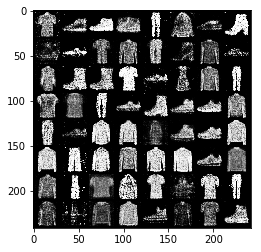

[Epoch 30/50] [Batch 201/938] [D loss: 1.238386] [G loss: 0.901516]
[Epoch 30/50] [Batch 202/938] [D loss: 1.315912] [G loss: 0.871447]
[Epoch 30/50] [Batch 203/938] [D loss: 1.264187] [G loss: 0.908947]
[Epoch 30/50] [Batch 204/938] [D loss: 1.403411] [G loss: 0.886745]
[Epoch 30/50] [Batch 205/938] [D loss: 1.154204] [G loss: 0.934550]
[Epoch 30/50] [Batch 206/938] [D loss: 1.306020] [G loss: 0.908127]
[Epoch 30/50] [Batch 207/938] [D loss: 1.250624] [G loss: 0.885197]
[Epoch 30/50] [Batch 208/938] [D loss: 1.300072] [G loss: 0.888156]
[Epoch 30/50] [Batch 209/938] [D loss: 1.238384] [G loss: 0.885067]
[Epoch 30/50] [Batch 210/938] [D loss: 1.298593] [G loss: 0.909879]
[Epoch 30/50] [Batch 211/938] [D loss: 1.372895] [G loss: 0.870228]
[Epoch 30/50] [Batch 212/938] [D loss: 1.211719] [G loss: 0.897630]
[Epoch 30/50] [Batch 213/938] [D loss: 1.270300] [G loss: 0.857611]
[Epoch 30/50] [Batch 214/938] [D loss: 1.364795] [G loss: 0.832791]
[Epoch 30/50] [Batch 215/938] [D loss: 1.262545]

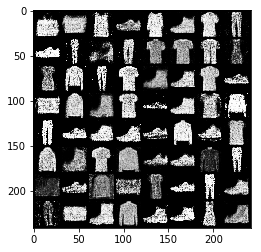

[Epoch 30/50] [Batch 401/938] [D loss: 1.247573] [G loss: 0.854685]
[Epoch 30/50] [Batch 402/938] [D loss: 1.299427] [G loss: 0.897937]
[Epoch 30/50] [Batch 403/938] [D loss: 1.303336] [G loss: 0.869801]
[Epoch 30/50] [Batch 404/938] [D loss: 1.182896] [G loss: 0.888956]
[Epoch 30/50] [Batch 405/938] [D loss: 1.285456] [G loss: 0.915316]
[Epoch 30/50] [Batch 406/938] [D loss: 1.174824] [G loss: 0.918543]
[Epoch 30/50] [Batch 407/938] [D loss: 1.391109] [G loss: 0.870359]
[Epoch 30/50] [Batch 408/938] [D loss: 1.371130] [G loss: 0.880771]
[Epoch 30/50] [Batch 409/938] [D loss: 1.245771] [G loss: 0.899852]
[Epoch 30/50] [Batch 410/938] [D loss: 1.239790] [G loss: 0.890741]
[Epoch 30/50] [Batch 411/938] [D loss: 1.250582] [G loss: 0.877386]
[Epoch 30/50] [Batch 412/938] [D loss: 1.272133] [G loss: 0.886865]
[Epoch 30/50] [Batch 413/938] [D loss: 1.203776] [G loss: 0.878394]
[Epoch 30/50] [Batch 414/938] [D loss: 1.283042] [G loss: 0.855571]
[Epoch 30/50] [Batch 415/938] [D loss: 1.294217]

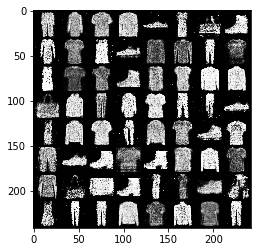

[Epoch 30/50] [Batch 601/938] [D loss: 1.339518] [G loss: 0.842805]
[Epoch 30/50] [Batch 602/938] [D loss: 1.200488] [G loss: 0.898860]
[Epoch 30/50] [Batch 603/938] [D loss: 1.333598] [G loss: 0.886968]
[Epoch 30/50] [Batch 604/938] [D loss: 1.359618] [G loss: 0.846086]
[Epoch 30/50] [Batch 605/938] [D loss: 1.321428] [G loss: 0.852832]
[Epoch 30/50] [Batch 606/938] [D loss: 1.376979] [G loss: 0.841390]
[Epoch 30/50] [Batch 607/938] [D loss: 1.367529] [G loss: 0.859233]
[Epoch 30/50] [Batch 608/938] [D loss: 1.363533] [G loss: 0.937893]
[Epoch 30/50] [Batch 609/938] [D loss: 1.305605] [G loss: 0.928462]
[Epoch 30/50] [Batch 610/938] [D loss: 1.383246] [G loss: 0.879508]
[Epoch 30/50] [Batch 611/938] [D loss: 1.236898] [G loss: 0.859837]
[Epoch 30/50] [Batch 612/938] [D loss: 1.228139] [G loss: 0.908622]
[Epoch 30/50] [Batch 613/938] [D loss: 1.325184] [G loss: 0.833210]
[Epoch 30/50] [Batch 614/938] [D loss: 1.279349] [G loss: 0.841553]
[Epoch 30/50] [Batch 615/938] [D loss: 1.302628]

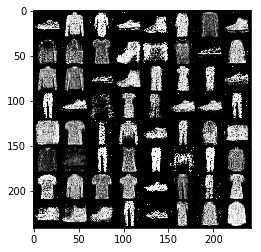

[Epoch 30/50] [Batch 801/938] [D loss: 1.263689] [G loss: 0.809614]
[Epoch 30/50] [Batch 802/938] [D loss: 1.269421] [G loss: 0.857830]
[Epoch 30/50] [Batch 803/938] [D loss: 1.302828] [G loss: 0.822789]
[Epoch 30/50] [Batch 804/938] [D loss: 1.334449] [G loss: 0.857223]
[Epoch 30/50] [Batch 805/938] [D loss: 1.255506] [G loss: 0.879700]
[Epoch 30/50] [Batch 806/938] [D loss: 1.322423] [G loss: 0.882043]
[Epoch 30/50] [Batch 807/938] [D loss: 1.279928] [G loss: 0.859300]
[Epoch 30/50] [Batch 808/938] [D loss: 1.231513] [G loss: 0.851063]
[Epoch 30/50] [Batch 809/938] [D loss: 1.222899] [G loss: 0.884467]
[Epoch 30/50] [Batch 810/938] [D loss: 1.251118] [G loss: 0.839577]
[Epoch 30/50] [Batch 811/938] [D loss: 1.357173] [G loss: 0.813227]
[Epoch 30/50] [Batch 812/938] [D loss: 1.116424] [G loss: 0.850210]
[Epoch 30/50] [Batch 813/938] [D loss: 1.202855] [G loss: 0.870676]
[Epoch 30/50] [Batch 814/938] [D loss: 1.190464] [G loss: 0.874134]
[Epoch 30/50] [Batch 815/938] [D loss: 1.297863]

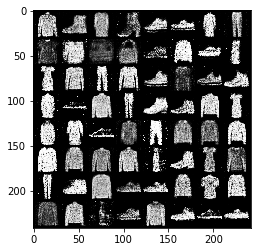

[Epoch 31/50] [Batch 1/938] [D loss: 1.312050] [G loss: 0.851495]
[Epoch 31/50] [Batch 2/938] [D loss: 1.269274] [G loss: 0.914940]
[Epoch 31/50] [Batch 3/938] [D loss: 1.275215] [G loss: 0.882480]
[Epoch 31/50] [Batch 4/938] [D loss: 1.280069] [G loss: 0.906363]
[Epoch 31/50] [Batch 5/938] [D loss: 1.249217] [G loss: 0.880191]
[Epoch 31/50] [Batch 6/938] [D loss: 1.273307] [G loss: 0.853842]
[Epoch 31/50] [Batch 7/938] [D loss: 1.287557] [G loss: 0.841965]
[Epoch 31/50] [Batch 8/938] [D loss: 1.301156] [G loss: 0.872814]
[Epoch 31/50] [Batch 9/938] [D loss: 1.279639] [G loss: 0.838012]
[Epoch 31/50] [Batch 10/938] [D loss: 1.310840] [G loss: 0.912402]
[Epoch 31/50] [Batch 11/938] [D loss: 1.219996] [G loss: 0.925265]
[Epoch 31/50] [Batch 12/938] [D loss: 1.272134] [G loss: 0.868521]
[Epoch 31/50] [Batch 13/938] [D loss: 1.295433] [G loss: 0.840195]
[Epoch 31/50] [Batch 14/938] [D loss: 1.263797] [G loss: 0.871115]
[Epoch 31/50] [Batch 15/938] [D loss: 1.224677] [G loss: 0.824903]
[Epo

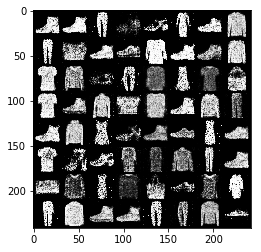

[Epoch 31/50] [Batch 201/938] [D loss: 1.419244] [G loss: 0.871763]
[Epoch 31/50] [Batch 202/938] [D loss: 1.196577] [G loss: 0.917720]
[Epoch 31/50] [Batch 203/938] [D loss: 1.297159] [G loss: 0.916888]
[Epoch 31/50] [Batch 204/938] [D loss: 1.274931] [G loss: 0.908085]
[Epoch 31/50] [Batch 205/938] [D loss: 1.251767] [G loss: 0.903504]
[Epoch 31/50] [Batch 206/938] [D loss: 1.318845] [G loss: 0.897409]
[Epoch 31/50] [Batch 207/938] [D loss: 1.289853] [G loss: 0.877004]
[Epoch 31/50] [Batch 208/938] [D loss: 1.244386] [G loss: 0.971195]
[Epoch 31/50] [Batch 209/938] [D loss: 1.261657] [G loss: 0.919647]
[Epoch 31/50] [Batch 210/938] [D loss: 1.238812] [G loss: 0.849618]
[Epoch 31/50] [Batch 211/938] [D loss: 1.371459] [G loss: 0.890031]
[Epoch 31/50] [Batch 212/938] [D loss: 1.348444] [G loss: 0.916678]
[Epoch 31/50] [Batch 213/938] [D loss: 1.336766] [G loss: 0.979858]
[Epoch 31/50] [Batch 214/938] [D loss: 1.233595] [G loss: 0.966361]
[Epoch 31/50] [Batch 215/938] [D loss: 1.234875]

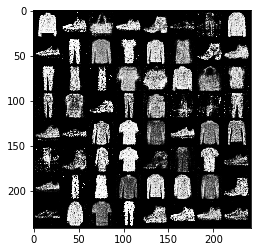

[Epoch 31/50] [Batch 401/938] [D loss: 1.227943] [G loss: 0.929848]
[Epoch 31/50] [Batch 402/938] [D loss: 1.271802] [G loss: 0.935666]
[Epoch 31/50] [Batch 403/938] [D loss: 1.188948] [G loss: 0.894857]
[Epoch 31/50] [Batch 404/938] [D loss: 1.294810] [G loss: 0.882330]
[Epoch 31/50] [Batch 405/938] [D loss: 1.294509] [G loss: 0.850204]
[Epoch 31/50] [Batch 406/938] [D loss: 1.309850] [G loss: 0.902222]
[Epoch 31/50] [Batch 407/938] [D loss: 1.395005] [G loss: 0.889060]
[Epoch 31/50] [Batch 408/938] [D loss: 1.331934] [G loss: 0.919644]
[Epoch 31/50] [Batch 409/938] [D loss: 1.250242] [G loss: 0.975083]
[Epoch 31/50] [Batch 410/938] [D loss: 1.253783] [G loss: 0.909370]
[Epoch 31/50] [Batch 411/938] [D loss: 1.253112] [G loss: 0.961031]
[Epoch 31/50] [Batch 412/938] [D loss: 1.298211] [G loss: 0.878773]
[Epoch 31/50] [Batch 413/938] [D loss: 1.259023] [G loss: 0.897699]
[Epoch 31/50] [Batch 414/938] [D loss: 1.333695] [G loss: 0.899947]
[Epoch 31/50] [Batch 415/938] [D loss: 1.293803]

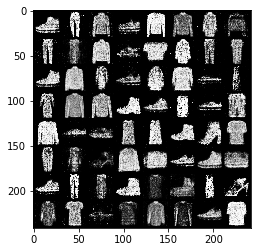

[Epoch 31/50] [Batch 601/938] [D loss: 1.314052] [G loss: 0.866099]
[Epoch 31/50] [Batch 602/938] [D loss: 1.271258] [G loss: 0.893650]
[Epoch 31/50] [Batch 603/938] [D loss: 1.307732] [G loss: 0.845964]
[Epoch 31/50] [Batch 604/938] [D loss: 1.338578] [G loss: 0.848929]
[Epoch 31/50] [Batch 605/938] [D loss: 1.314669] [G loss: 0.839428]
[Epoch 31/50] [Batch 606/938] [D loss: 1.277642] [G loss: 0.880369]
[Epoch 31/50] [Batch 607/938] [D loss: 1.369439] [G loss: 0.841970]
[Epoch 31/50] [Batch 608/938] [D loss: 1.293235] [G loss: 0.848126]
[Epoch 31/50] [Batch 609/938] [D loss: 1.432499] [G loss: 0.825163]
[Epoch 31/50] [Batch 610/938] [D loss: 1.211663] [G loss: 0.882878]
[Epoch 31/50] [Batch 611/938] [D loss: 1.312855] [G loss: 0.861725]
[Epoch 31/50] [Batch 612/938] [D loss: 1.319304] [G loss: 0.835921]
[Epoch 31/50] [Batch 613/938] [D loss: 1.356430] [G loss: 0.812768]
[Epoch 31/50] [Batch 614/938] [D loss: 1.322511] [G loss: 0.845325]
[Epoch 31/50] [Batch 615/938] [D loss: 1.401554]

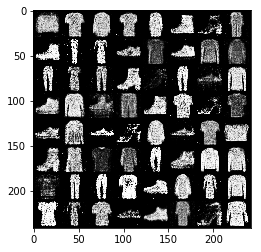

[Epoch 31/50] [Batch 801/938] [D loss: 1.313037] [G loss: 0.841943]
[Epoch 31/50] [Batch 802/938] [D loss: 1.289337] [G loss: 0.823916]
[Epoch 31/50] [Batch 803/938] [D loss: 1.275812] [G loss: 0.862976]
[Epoch 31/50] [Batch 804/938] [D loss: 1.307603] [G loss: 0.934409]
[Epoch 31/50] [Batch 805/938] [D loss: 1.302837] [G loss: 0.871337]
[Epoch 31/50] [Batch 806/938] [D loss: 1.230279] [G loss: 0.866102]
[Epoch 31/50] [Batch 807/938] [D loss: 1.199583] [G loss: 0.847933]
[Epoch 31/50] [Batch 808/938] [D loss: 1.247474] [G loss: 0.872844]
[Epoch 31/50] [Batch 809/938] [D loss: 1.324594] [G loss: 0.870404]
[Epoch 31/50] [Batch 810/938] [D loss: 1.352865] [G loss: 0.863090]
[Epoch 31/50] [Batch 811/938] [D loss: 1.279520] [G loss: 0.893534]
[Epoch 31/50] [Batch 812/938] [D loss: 1.270996] [G loss: 0.863975]
[Epoch 31/50] [Batch 813/938] [D loss: 1.241901] [G loss: 0.856538]
[Epoch 31/50] [Batch 814/938] [D loss: 1.306214] [G loss: 0.885707]
[Epoch 31/50] [Batch 815/938] [D loss: 1.238997]

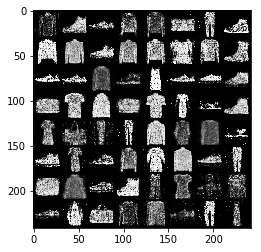

[Epoch 32/50] [Batch 1/938] [D loss: 1.283378] [G loss: 0.842501]
[Epoch 32/50] [Batch 2/938] [D loss: 1.221843] [G loss: 0.851628]
[Epoch 32/50] [Batch 3/938] [D loss: 1.226371] [G loss: 0.824949]
[Epoch 32/50] [Batch 4/938] [D loss: 1.231197] [G loss: 0.842259]
[Epoch 32/50] [Batch 5/938] [D loss: 1.247298] [G loss: 0.974054]
[Epoch 32/50] [Batch 6/938] [D loss: 1.204753] [G loss: 0.936706]
[Epoch 32/50] [Batch 7/938] [D loss: 1.284024] [G loss: 0.930841]
[Epoch 32/50] [Batch 8/938] [D loss: 1.326192] [G loss: 0.942177]
[Epoch 32/50] [Batch 9/938] [D loss: 1.270325] [G loss: 0.992256]
[Epoch 32/50] [Batch 10/938] [D loss: 1.277100] [G loss: 0.922951]
[Epoch 32/50] [Batch 11/938] [D loss: 1.220049] [G loss: 0.919488]
[Epoch 32/50] [Batch 12/938] [D loss: 1.226910] [G loss: 0.934787]
[Epoch 32/50] [Batch 13/938] [D loss: 1.227037] [G loss: 0.932529]
[Epoch 32/50] [Batch 14/938] [D loss: 1.274590] [G loss: 0.831914]
[Epoch 32/50] [Batch 15/938] [D loss: 1.375765] [G loss: 0.855047]
[Epo

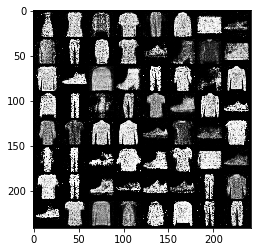

[Epoch 32/50] [Batch 201/938] [D loss: 1.310678] [G loss: 0.838285]
[Epoch 32/50] [Batch 202/938] [D loss: 1.224548] [G loss: 0.903729]
[Epoch 32/50] [Batch 203/938] [D loss: 1.243837] [G loss: 0.769044]
[Epoch 32/50] [Batch 204/938] [D loss: 1.171684] [G loss: 0.884604]
[Epoch 32/50] [Batch 205/938] [D loss: 1.193561] [G loss: 0.897206]
[Epoch 32/50] [Batch 206/938] [D loss: 1.345871] [G loss: 0.892872]
[Epoch 32/50] [Batch 207/938] [D loss: 1.265772] [G loss: 0.943095]
[Epoch 32/50] [Batch 208/938] [D loss: 1.233128] [G loss: 0.987193]
[Epoch 32/50] [Batch 209/938] [D loss: 1.235305] [G loss: 0.932657]
[Epoch 32/50] [Batch 210/938] [D loss: 1.285904] [G loss: 0.872081]
[Epoch 32/50] [Batch 211/938] [D loss: 1.368812] [G loss: 0.881121]
[Epoch 32/50] [Batch 212/938] [D loss: 1.299485] [G loss: 0.893497]
[Epoch 32/50] [Batch 213/938] [D loss: 1.241498] [G loss: 0.918998]
[Epoch 32/50] [Batch 214/938] [D loss: 1.315167] [G loss: 0.905824]
[Epoch 32/50] [Batch 215/938] [D loss: 1.392494]

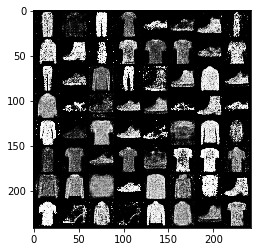

[Epoch 32/50] [Batch 401/938] [D loss: 1.338622] [G loss: 0.892857]
[Epoch 32/50] [Batch 402/938] [D loss: 1.227948] [G loss: 0.912723]
[Epoch 32/50] [Batch 403/938] [D loss: 1.304142] [G loss: 0.959048]
[Epoch 32/50] [Batch 404/938] [D loss: 1.355311] [G loss: 0.926442]
[Epoch 32/50] [Batch 405/938] [D loss: 1.230074] [G loss: 1.001645]
[Epoch 32/50] [Batch 406/938] [D loss: 1.229514] [G loss: 0.898352]
[Epoch 32/50] [Batch 407/938] [D loss: 1.309529] [G loss: 0.881626]
[Epoch 32/50] [Batch 408/938] [D loss: 1.200353] [G loss: 0.851883]
[Epoch 32/50] [Batch 409/938] [D loss: 1.168582] [G loss: 0.817291]
[Epoch 32/50] [Batch 410/938] [D loss: 1.223182] [G loss: 0.832262]
[Epoch 32/50] [Batch 411/938] [D loss: 1.246161] [G loss: 0.845809]
[Epoch 32/50] [Batch 412/938] [D loss: 1.371849] [G loss: 0.844698]
[Epoch 32/50] [Batch 413/938] [D loss: 1.335335] [G loss: 0.892749]
[Epoch 32/50] [Batch 414/938] [D loss: 1.254359] [G loss: 0.861439]
[Epoch 32/50] [Batch 415/938] [D loss: 1.278364]

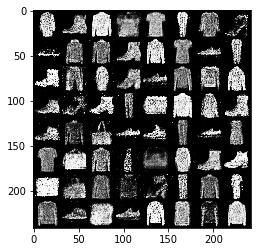

[Epoch 32/50] [Batch 601/938] [D loss: 1.232483] [G loss: 0.916008]
[Epoch 32/50] [Batch 602/938] [D loss: 1.240057] [G loss: 0.873367]
[Epoch 32/50] [Batch 603/938] [D loss: 1.299929] [G loss: 0.881924]
[Epoch 32/50] [Batch 604/938] [D loss: 1.250485] [G loss: 0.929375]
[Epoch 32/50] [Batch 605/938] [D loss: 1.290416] [G loss: 0.872899]
[Epoch 32/50] [Batch 606/938] [D loss: 1.298934] [G loss: 0.908317]
[Epoch 32/50] [Batch 607/938] [D loss: 1.308530] [G loss: 0.850568]
[Epoch 32/50] [Batch 608/938] [D loss: 1.269442] [G loss: 0.903058]
[Epoch 32/50] [Batch 609/938] [D loss: 1.189141] [G loss: 0.896192]
[Epoch 32/50] [Batch 610/938] [D loss: 1.347177] [G loss: 0.823646]
[Epoch 32/50] [Batch 611/938] [D loss: 1.349054] [G loss: 0.804798]
[Epoch 32/50] [Batch 612/938] [D loss: 1.315443] [G loss: 0.863813]
[Epoch 32/50] [Batch 613/938] [D loss: 1.370172] [G loss: 0.859073]
[Epoch 32/50] [Batch 614/938] [D loss: 1.179029] [G loss: 0.918649]
[Epoch 32/50] [Batch 615/938] [D loss: 1.372676]

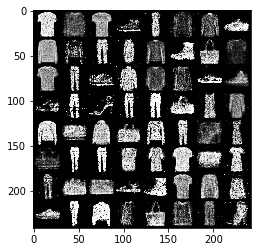

[Epoch 32/50] [Batch 801/938] [D loss: 1.290645] [G loss: 0.858506]
[Epoch 32/50] [Batch 802/938] [D loss: 1.261532] [G loss: 0.842748]
[Epoch 32/50] [Batch 803/938] [D loss: 1.301475] [G loss: 0.921840]
[Epoch 32/50] [Batch 804/938] [D loss: 1.314909] [G loss: 0.870455]
[Epoch 32/50] [Batch 805/938] [D loss: 1.222984] [G loss: 0.888745]
[Epoch 32/50] [Batch 806/938] [D loss: 1.244150] [G loss: 0.905084]
[Epoch 32/50] [Batch 807/938] [D loss: 1.354277] [G loss: 0.814825]
[Epoch 32/50] [Batch 808/938] [D loss: 1.258001] [G loss: 0.830260]
[Epoch 32/50] [Batch 809/938] [D loss: 1.274224] [G loss: 0.909053]
[Epoch 32/50] [Batch 810/938] [D loss: 1.339783] [G loss: 0.836010]
[Epoch 32/50] [Batch 811/938] [D loss: 1.310215] [G loss: 0.818500]
[Epoch 32/50] [Batch 812/938] [D loss: 1.234890] [G loss: 0.876821]
[Epoch 32/50] [Batch 813/938] [D loss: 1.379511] [G loss: 0.866181]
[Epoch 32/50] [Batch 814/938] [D loss: 1.317849] [G loss: 0.886227]
[Epoch 32/50] [Batch 815/938] [D loss: 1.233570]

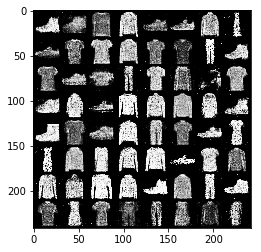

[Epoch 33/50] [Batch 1/938] [D loss: 1.250622] [G loss: 0.903066]
[Epoch 33/50] [Batch 2/938] [D loss: 1.335474] [G loss: 0.869955]
[Epoch 33/50] [Batch 3/938] [D loss: 1.215837] [G loss: 0.898810]
[Epoch 33/50] [Batch 4/938] [D loss: 1.191024] [G loss: 0.881418]
[Epoch 33/50] [Batch 5/938] [D loss: 1.305302] [G loss: 0.833795]
[Epoch 33/50] [Batch 6/938] [D loss: 1.214258] [G loss: 0.959601]
[Epoch 33/50] [Batch 7/938] [D loss: 1.344223] [G loss: 0.893925]
[Epoch 33/50] [Batch 8/938] [D loss: 1.303002] [G loss: 0.889259]
[Epoch 33/50] [Batch 9/938] [D loss: 1.168019] [G loss: 0.883108]
[Epoch 33/50] [Batch 10/938] [D loss: 1.222921] [G loss: 0.989790]
[Epoch 33/50] [Batch 11/938] [D loss: 1.410077] [G loss: 0.882798]
[Epoch 33/50] [Batch 12/938] [D loss: 1.263124] [G loss: 0.881094]
[Epoch 33/50] [Batch 13/938] [D loss: 1.189877] [G loss: 0.892318]
[Epoch 33/50] [Batch 14/938] [D loss: 1.232980] [G loss: 0.830133]
[Epoch 33/50] [Batch 15/938] [D loss: 1.392279] [G loss: 0.850454]
[Epo

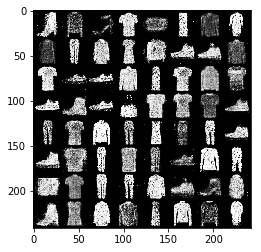

[Epoch 33/50] [Batch 201/938] [D loss: 1.263520] [G loss: 0.835586]
[Epoch 33/50] [Batch 202/938] [D loss: 1.222263] [G loss: 0.883618]
[Epoch 33/50] [Batch 203/938] [D loss: 1.294175] [G loss: 0.871496]
[Epoch 33/50] [Batch 204/938] [D loss: 1.267732] [G loss: 0.846615]
[Epoch 33/50] [Batch 205/938] [D loss: 1.217797] [G loss: 0.884596]
[Epoch 33/50] [Batch 206/938] [D loss: 1.239310] [G loss: 0.864872]
[Epoch 33/50] [Batch 207/938] [D loss: 1.325331] [G loss: 0.826791]
[Epoch 33/50] [Batch 208/938] [D loss: 1.256649] [G loss: 0.781341]
[Epoch 33/50] [Batch 209/938] [D loss: 1.263383] [G loss: 0.889951]
[Epoch 33/50] [Batch 210/938] [D loss: 1.210287] [G loss: 0.828255]
[Epoch 33/50] [Batch 211/938] [D loss: 1.252218] [G loss: 0.899240]
[Epoch 33/50] [Batch 212/938] [D loss: 1.218192] [G loss: 0.859998]
[Epoch 33/50] [Batch 213/938] [D loss: 1.258991] [G loss: 0.833230]
[Epoch 33/50] [Batch 214/938] [D loss: 1.202124] [G loss: 0.855656]
[Epoch 33/50] [Batch 215/938] [D loss: 1.266039]

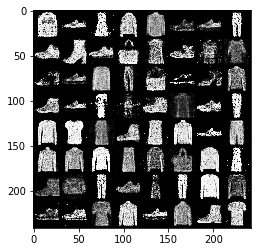

[Epoch 33/50] [Batch 401/938] [D loss: 1.304864] [G loss: 0.814052]
[Epoch 33/50] [Batch 402/938] [D loss: 1.219667] [G loss: 0.884418]
[Epoch 33/50] [Batch 403/938] [D loss: 1.275525] [G loss: 0.857161]
[Epoch 33/50] [Batch 404/938] [D loss: 1.217180] [G loss: 0.832903]
[Epoch 33/50] [Batch 405/938] [D loss: 1.241132] [G loss: 0.913964]
[Epoch 33/50] [Batch 406/938] [D loss: 1.249213] [G loss: 0.842640]
[Epoch 33/50] [Batch 407/938] [D loss: 1.404768] [G loss: 0.900917]
[Epoch 33/50] [Batch 408/938] [D loss: 1.246073] [G loss: 0.895522]
[Epoch 33/50] [Batch 409/938] [D loss: 1.284138] [G loss: 0.865891]
[Epoch 33/50] [Batch 410/938] [D loss: 1.217410] [G loss: 0.876320]
[Epoch 33/50] [Batch 411/938] [D loss: 1.234642] [G loss: 0.879694]
[Epoch 33/50] [Batch 412/938] [D loss: 1.250078] [G loss: 0.856629]
[Epoch 33/50] [Batch 413/938] [D loss: 1.196435] [G loss: 0.851655]
[Epoch 33/50] [Batch 414/938] [D loss: 1.261770] [G loss: 0.905386]
[Epoch 33/50] [Batch 415/938] [D loss: 1.195194]

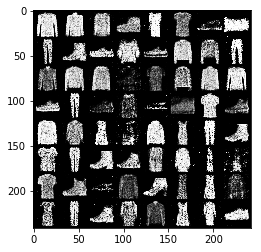

[Epoch 33/50] [Batch 601/938] [D loss: 1.317619] [G loss: 0.857009]
[Epoch 33/50] [Batch 602/938] [D loss: 1.301021] [G loss: 0.929966]
[Epoch 33/50] [Batch 603/938] [D loss: 1.290025] [G loss: 0.873279]
[Epoch 33/50] [Batch 604/938] [D loss: 1.292113] [G loss: 0.893808]
[Epoch 33/50] [Batch 605/938] [D loss: 1.251887] [G loss: 0.855170]
[Epoch 33/50] [Batch 606/938] [D loss: 1.327850] [G loss: 0.815227]
[Epoch 33/50] [Batch 607/938] [D loss: 1.251334] [G loss: 0.883530]
[Epoch 33/50] [Batch 608/938] [D loss: 1.296953] [G loss: 0.906879]
[Epoch 33/50] [Batch 609/938] [D loss: 1.248057] [G loss: 0.877491]
[Epoch 33/50] [Batch 610/938] [D loss: 1.350487] [G loss: 0.892436]
[Epoch 33/50] [Batch 611/938] [D loss: 1.330827] [G loss: 0.863220]
[Epoch 33/50] [Batch 612/938] [D loss: 1.272542] [G loss: 0.891037]
[Epoch 33/50] [Batch 613/938] [D loss: 1.385926] [G loss: 0.825795]
[Epoch 33/50] [Batch 614/938] [D loss: 1.284112] [G loss: 0.857296]
[Epoch 33/50] [Batch 615/938] [D loss: 1.188833]

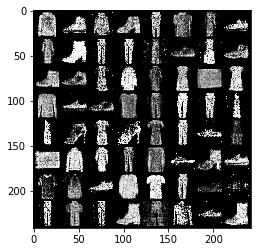

[Epoch 33/50] [Batch 801/938] [D loss: 1.304442] [G loss: 0.895557]
[Epoch 33/50] [Batch 802/938] [D loss: 1.275147] [G loss: 0.903024]
[Epoch 33/50] [Batch 803/938] [D loss: 1.321700] [G loss: 0.926177]
[Epoch 33/50] [Batch 804/938] [D loss: 1.206228] [G loss: 0.945362]
[Epoch 33/50] [Batch 805/938] [D loss: 1.219322] [G loss: 0.859570]
[Epoch 33/50] [Batch 806/938] [D loss: 1.238962] [G loss: 0.895314]
[Epoch 33/50] [Batch 807/938] [D loss: 1.214509] [G loss: 0.888392]
[Epoch 33/50] [Batch 808/938] [D loss: 1.402742] [G loss: 0.851294]
[Epoch 33/50] [Batch 809/938] [D loss: 1.348789] [G loss: 0.862132]
[Epoch 33/50] [Batch 810/938] [D loss: 1.321099] [G loss: 0.909759]
[Epoch 33/50] [Batch 811/938] [D loss: 1.247828] [G loss: 0.915015]
[Epoch 33/50] [Batch 812/938] [D loss: 1.295452] [G loss: 0.927170]
[Epoch 33/50] [Batch 813/938] [D loss: 1.356153] [G loss: 0.880973]
[Epoch 33/50] [Batch 814/938] [D loss: 1.302066] [G loss: 0.803683]
[Epoch 33/50] [Batch 815/938] [D loss: 1.275331]

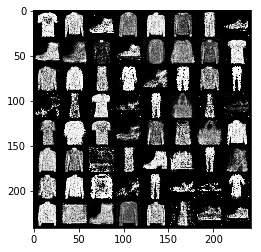

[Epoch 34/50] [Batch 1/938] [D loss: 1.254609] [G loss: 0.844890]
[Epoch 34/50] [Batch 2/938] [D loss: 1.372887] [G loss: 0.870119]
[Epoch 34/50] [Batch 3/938] [D loss: 1.250458] [G loss: 0.872523]
[Epoch 34/50] [Batch 4/938] [D loss: 1.308170] [G loss: 0.899806]
[Epoch 34/50] [Batch 5/938] [D loss: 1.359463] [G loss: 0.862556]
[Epoch 34/50] [Batch 6/938] [D loss: 1.303805] [G loss: 0.877193]
[Epoch 34/50] [Batch 7/938] [D loss: 1.232369] [G loss: 0.897767]
[Epoch 34/50] [Batch 8/938] [D loss: 1.233138] [G loss: 0.919214]
[Epoch 34/50] [Batch 9/938] [D loss: 1.220046] [G loss: 0.919342]
[Epoch 34/50] [Batch 10/938] [D loss: 1.262156] [G loss: 0.895519]
[Epoch 34/50] [Batch 11/938] [D loss: 1.291919] [G loss: 0.819947]
[Epoch 34/50] [Batch 12/938] [D loss: 1.359309] [G loss: 0.857072]
[Epoch 34/50] [Batch 13/938] [D loss: 1.297372] [G loss: 0.843303]
[Epoch 34/50] [Batch 14/938] [D loss: 1.373337] [G loss: 0.928652]
[Epoch 34/50] [Batch 15/938] [D loss: 1.222318] [G loss: 0.853680]
[Epo

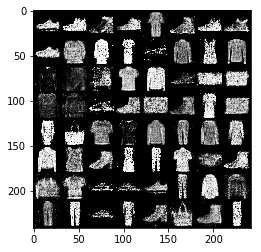

[Epoch 34/50] [Batch 201/938] [D loss: 1.312137] [G loss: 0.892328]
[Epoch 34/50] [Batch 202/938] [D loss: 1.322229] [G loss: 0.917469]
[Epoch 34/50] [Batch 203/938] [D loss: 1.348772] [G loss: 0.835351]
[Epoch 34/50] [Batch 204/938] [D loss: 1.378521] [G loss: 0.876658]
[Epoch 34/50] [Batch 205/938] [D loss: 1.247293] [G loss: 0.845499]
[Epoch 34/50] [Batch 206/938] [D loss: 1.301721] [G loss: 0.849336]
[Epoch 34/50] [Batch 207/938] [D loss: 1.367494] [G loss: 0.871279]
[Epoch 34/50] [Batch 208/938] [D loss: 1.329745] [G loss: 0.901510]
[Epoch 34/50] [Batch 209/938] [D loss: 1.307844] [G loss: 0.890886]
[Epoch 34/50] [Batch 210/938] [D loss: 1.336392] [G loss: 0.874997]
[Epoch 34/50] [Batch 211/938] [D loss: 1.321973] [G loss: 0.814342]
[Epoch 34/50] [Batch 212/938] [D loss: 1.294356] [G loss: 0.876419]
[Epoch 34/50] [Batch 213/938] [D loss: 1.276489] [G loss: 0.872280]
[Epoch 34/50] [Batch 214/938] [D loss: 1.311922] [G loss: 0.869967]
[Epoch 34/50] [Batch 215/938] [D loss: 1.318371]

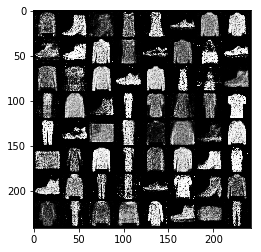

[Epoch 34/50] [Batch 401/938] [D loss: 1.315546] [G loss: 0.872551]
[Epoch 34/50] [Batch 402/938] [D loss: 1.242353] [G loss: 0.875094]
[Epoch 34/50] [Batch 403/938] [D loss: 1.217868] [G loss: 0.860520]
[Epoch 34/50] [Batch 404/938] [D loss: 1.232069] [G loss: 0.857551]
[Epoch 34/50] [Batch 405/938] [D loss: 1.359879] [G loss: 0.854233]
[Epoch 34/50] [Batch 406/938] [D loss: 1.315880] [G loss: 0.856257]
[Epoch 34/50] [Batch 407/938] [D loss: 1.312414] [G loss: 0.826292]
[Epoch 34/50] [Batch 408/938] [D loss: 1.245095] [G loss: 0.839857]
[Epoch 34/50] [Batch 409/938] [D loss: 1.313779] [G loss: 0.828295]
[Epoch 34/50] [Batch 410/938] [D loss: 1.356925] [G loss: 0.863349]
[Epoch 34/50] [Batch 411/938] [D loss: 1.305423] [G loss: 0.857343]
[Epoch 34/50] [Batch 412/938] [D loss: 1.208238] [G loss: 0.919029]
[Epoch 34/50] [Batch 413/938] [D loss: 1.287648] [G loss: 0.935150]
[Epoch 34/50] [Batch 414/938] [D loss: 1.278605] [G loss: 0.929033]
[Epoch 34/50] [Batch 415/938] [D loss: 1.294103]

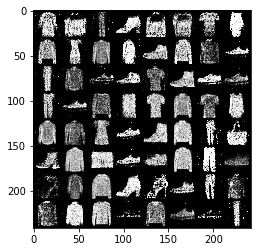

[Epoch 34/50] [Batch 601/938] [D loss: 1.306481] [G loss: 0.838386]
[Epoch 34/50] [Batch 602/938] [D loss: 1.221121] [G loss: 0.919301]
[Epoch 34/50] [Batch 603/938] [D loss: 1.194514] [G loss: 0.872342]
[Epoch 34/50] [Batch 604/938] [D loss: 1.202308] [G loss: 0.896667]
[Epoch 34/50] [Batch 605/938] [D loss: 1.300124] [G loss: 0.859076]
[Epoch 34/50] [Batch 606/938] [D loss: 1.206134] [G loss: 0.887011]
[Epoch 34/50] [Batch 607/938] [D loss: 1.191001] [G loss: 0.839480]
[Epoch 34/50] [Batch 608/938] [D loss: 1.270881] [G loss: 0.866730]
[Epoch 34/50] [Batch 609/938] [D loss: 1.321816] [G loss: 0.838125]
[Epoch 34/50] [Batch 610/938] [D loss: 1.318105] [G loss: 0.853218]
[Epoch 34/50] [Batch 611/938] [D loss: 1.261559] [G loss: 0.901838]
[Epoch 34/50] [Batch 612/938] [D loss: 1.306439] [G loss: 0.907196]
[Epoch 34/50] [Batch 613/938] [D loss: 1.195905] [G loss: 0.884709]
[Epoch 34/50] [Batch 614/938] [D loss: 1.223202] [G loss: 0.892652]
[Epoch 34/50] [Batch 615/938] [D loss: 1.321841]

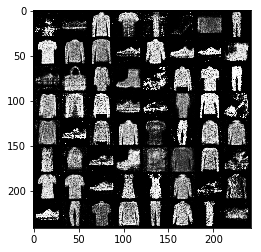

[Epoch 34/50] [Batch 801/938] [D loss: 1.310242] [G loss: 0.952551]
[Epoch 34/50] [Batch 802/938] [D loss: 1.246895] [G loss: 0.922396]
[Epoch 34/50] [Batch 803/938] [D loss: 1.281371] [G loss: 0.868698]
[Epoch 34/50] [Batch 804/938] [D loss: 1.248654] [G loss: 0.883788]
[Epoch 34/50] [Batch 805/938] [D loss: 1.406389] [G loss: 0.940959]
[Epoch 34/50] [Batch 806/938] [D loss: 1.388411] [G loss: 0.850929]
[Epoch 34/50] [Batch 807/938] [D loss: 1.290934] [G loss: 0.920557]
[Epoch 34/50] [Batch 808/938] [D loss: 1.252439] [G loss: 0.900375]
[Epoch 34/50] [Batch 809/938] [D loss: 1.307833] [G loss: 0.859508]
[Epoch 34/50] [Batch 810/938] [D loss: 1.341205] [G loss: 0.829515]
[Epoch 34/50] [Batch 811/938] [D loss: 1.231893] [G loss: 0.945156]
[Epoch 34/50] [Batch 812/938] [D loss: 1.234762] [G loss: 0.832554]
[Epoch 34/50] [Batch 813/938] [D loss: 1.256516] [G loss: 0.828721]
[Epoch 34/50] [Batch 814/938] [D loss: 1.324312] [G loss: 0.859827]
[Epoch 34/50] [Batch 815/938] [D loss: 1.312814]

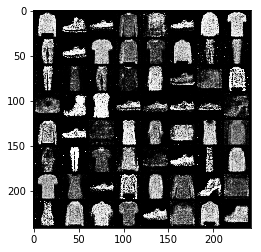

[Epoch 35/50] [Batch 1/938] [D loss: 1.377229] [G loss: 0.849933]
[Epoch 35/50] [Batch 2/938] [D loss: 1.380113] [G loss: 0.824703]
[Epoch 35/50] [Batch 3/938] [D loss: 1.293390] [G loss: 0.852728]
[Epoch 35/50] [Batch 4/938] [D loss: 1.276494] [G loss: 0.909142]
[Epoch 35/50] [Batch 5/938] [D loss: 1.291661] [G loss: 0.877343]
[Epoch 35/50] [Batch 6/938] [D loss: 1.328429] [G loss: 0.872094]
[Epoch 35/50] [Batch 7/938] [D loss: 1.270970] [G loss: 0.862333]
[Epoch 35/50] [Batch 8/938] [D loss: 1.292236] [G loss: 0.863167]
[Epoch 35/50] [Batch 9/938] [D loss: 1.354837] [G loss: 0.833242]
[Epoch 35/50] [Batch 10/938] [D loss: 1.271439] [G loss: 0.866878]
[Epoch 35/50] [Batch 11/938] [D loss: 1.312761] [G loss: 0.859953]
[Epoch 35/50] [Batch 12/938] [D loss: 1.271116] [G loss: 0.883550]
[Epoch 35/50] [Batch 13/938] [D loss: 1.314103] [G loss: 0.876382]
[Epoch 35/50] [Batch 14/938] [D loss: 1.333676] [G loss: 0.850925]
[Epoch 35/50] [Batch 15/938] [D loss: 1.249258] [G loss: 0.896021]
[Epo

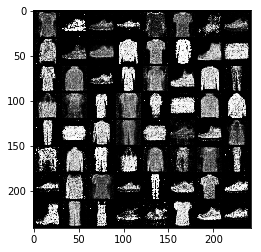

[Epoch 35/50] [Batch 201/938] [D loss: 1.245685] [G loss: 0.854836]
[Epoch 35/50] [Batch 202/938] [D loss: 1.310157] [G loss: 0.858093]
[Epoch 35/50] [Batch 203/938] [D loss: 1.309288] [G loss: 0.811529]
[Epoch 35/50] [Batch 204/938] [D loss: 1.263418] [G loss: 0.838018]
[Epoch 35/50] [Batch 205/938] [D loss: 1.240881] [G loss: 0.851478]
[Epoch 35/50] [Batch 206/938] [D loss: 1.223362] [G loss: 0.843116]
[Epoch 35/50] [Batch 207/938] [D loss: 1.232982] [G loss: 0.850666]
[Epoch 35/50] [Batch 208/938] [D loss: 1.306127] [G loss: 0.882359]
[Epoch 35/50] [Batch 209/938] [D loss: 1.258955] [G loss: 0.807144]
[Epoch 35/50] [Batch 210/938] [D loss: 1.304521] [G loss: 0.843939]
[Epoch 35/50] [Batch 211/938] [D loss: 1.341540] [G loss: 0.872404]
[Epoch 35/50] [Batch 212/938] [D loss: 1.321893] [G loss: 0.865357]
[Epoch 35/50] [Batch 213/938] [D loss: 1.129693] [G loss: 0.899169]
[Epoch 35/50] [Batch 214/938] [D loss: 1.279273] [G loss: 0.907119]
[Epoch 35/50] [Batch 215/938] [D loss: 1.297945]

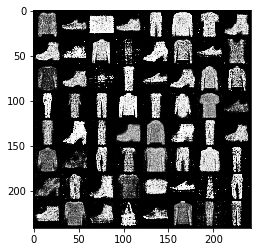

[Epoch 35/50] [Batch 401/938] [D loss: 1.243683] [G loss: 0.891283]
[Epoch 35/50] [Batch 402/938] [D loss: 1.204422] [G loss: 0.916080]
[Epoch 35/50] [Batch 403/938] [D loss: 1.184102] [G loss: 0.952050]
[Epoch 35/50] [Batch 404/938] [D loss: 1.377127] [G loss: 0.867171]
[Epoch 35/50] [Batch 405/938] [D loss: 1.384313] [G loss: 0.854360]
[Epoch 35/50] [Batch 406/938] [D loss: 1.423530] [G loss: 0.855300]
[Epoch 35/50] [Batch 407/938] [D loss: 1.254735] [G loss: 0.884396]
[Epoch 35/50] [Batch 408/938] [D loss: 1.326859] [G loss: 0.910717]
[Epoch 35/50] [Batch 409/938] [D loss: 1.348690] [G loss: 0.899594]
[Epoch 35/50] [Batch 410/938] [D loss: 1.288752] [G loss: 0.845714]
[Epoch 35/50] [Batch 411/938] [D loss: 1.283629] [G loss: 0.902233]
[Epoch 35/50] [Batch 412/938] [D loss: 1.211167] [G loss: 0.860169]
[Epoch 35/50] [Batch 413/938] [D loss: 1.261879] [G loss: 0.908708]
[Epoch 35/50] [Batch 414/938] [D loss: 1.238544] [G loss: 0.863668]
[Epoch 35/50] [Batch 415/938] [D loss: 1.323199]

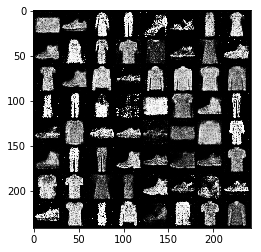

[Epoch 35/50] [Batch 601/938] [D loss: 1.263759] [G loss: 0.919330]
[Epoch 35/50] [Batch 602/938] [D loss: 1.287791] [G loss: 0.845614]
[Epoch 35/50] [Batch 603/938] [D loss: 1.263783] [G loss: 0.931033]
[Epoch 35/50] [Batch 604/938] [D loss: 1.292304] [G loss: 0.924528]
[Epoch 35/50] [Batch 605/938] [D loss: 1.181746] [G loss: 0.959704]
[Epoch 35/50] [Batch 606/938] [D loss: 1.233182] [G loss: 0.916813]
[Epoch 35/50] [Batch 607/938] [D loss: 1.288979] [G loss: 0.950713]
[Epoch 35/50] [Batch 608/938] [D loss: 1.293531] [G loss: 0.871675]
[Epoch 35/50] [Batch 609/938] [D loss: 1.231847] [G loss: 0.888799]
[Epoch 35/50] [Batch 610/938] [D loss: 1.223270] [G loss: 0.843242]
[Epoch 35/50] [Batch 611/938] [D loss: 1.292511] [G loss: 0.842191]
[Epoch 35/50] [Batch 612/938] [D loss: 1.277860] [G loss: 0.864017]
[Epoch 35/50] [Batch 613/938] [D loss: 1.214499] [G loss: 0.913161]
[Epoch 35/50] [Batch 614/938] [D loss: 1.207759] [G loss: 0.896485]
[Epoch 35/50] [Batch 615/938] [D loss: 1.218914]

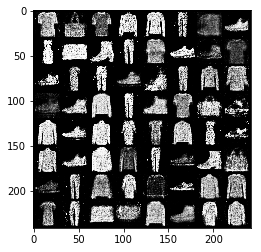

[Epoch 35/50] [Batch 801/938] [D loss: 1.292167] [G loss: 0.883886]
[Epoch 35/50] [Batch 802/938] [D loss: 1.177900] [G loss: 0.916702]
[Epoch 35/50] [Batch 803/938] [D loss: 1.248473] [G loss: 0.879034]
[Epoch 35/50] [Batch 804/938] [D loss: 1.279721] [G loss: 0.910351]
[Epoch 35/50] [Batch 805/938] [D loss: 1.312862] [G loss: 0.849278]
[Epoch 35/50] [Batch 806/938] [D loss: 1.270479] [G loss: 0.818412]
[Epoch 35/50] [Batch 807/938] [D loss: 1.289071] [G loss: 0.873075]
[Epoch 35/50] [Batch 808/938] [D loss: 1.296879] [G loss: 0.853238]
[Epoch 35/50] [Batch 809/938] [D loss: 1.277807] [G loss: 0.906610]
[Epoch 35/50] [Batch 810/938] [D loss: 1.309396] [G loss: 0.920249]
[Epoch 35/50] [Batch 811/938] [D loss: 1.223904] [G loss: 0.875805]
[Epoch 35/50] [Batch 812/938] [D loss: 1.203596] [G loss: 0.878694]
[Epoch 35/50] [Batch 813/938] [D loss: 1.303060] [G loss: 0.918179]
[Epoch 35/50] [Batch 814/938] [D loss: 1.243497] [G loss: 0.827407]
[Epoch 35/50] [Batch 815/938] [D loss: 1.281606]

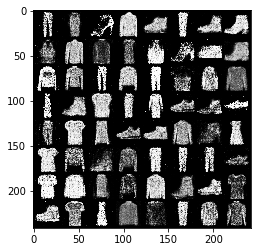

[Epoch 36/50] [Batch 1/938] [D loss: 1.243952] [G loss: 0.840030]
[Epoch 36/50] [Batch 2/938] [D loss: 1.258760] [G loss: 0.806241]
[Epoch 36/50] [Batch 3/938] [D loss: 1.301447] [G loss: 0.845006]
[Epoch 36/50] [Batch 4/938] [D loss: 1.226719] [G loss: 0.923442]
[Epoch 36/50] [Batch 5/938] [D loss: 1.217856] [G loss: 0.849538]
[Epoch 36/50] [Batch 6/938] [D loss: 1.256469] [G loss: 0.844288]
[Epoch 36/50] [Batch 7/938] [D loss: 1.343974] [G loss: 0.797736]
[Epoch 36/50] [Batch 8/938] [D loss: 1.252550] [G loss: 0.828422]
[Epoch 36/50] [Batch 9/938] [D loss: 1.245533] [G loss: 0.842468]
[Epoch 36/50] [Batch 10/938] [D loss: 1.318596] [G loss: 0.848959]
[Epoch 36/50] [Batch 11/938] [D loss: 1.231903] [G loss: 0.897451]
[Epoch 36/50] [Batch 12/938] [D loss: 1.252305] [G loss: 0.904549]
[Epoch 36/50] [Batch 13/938] [D loss: 1.287905] [G loss: 0.868973]
[Epoch 36/50] [Batch 14/938] [D loss: 1.293481] [G loss: 0.870151]
[Epoch 36/50] [Batch 15/938] [D loss: 1.268129] [G loss: 0.918791]
[Epo

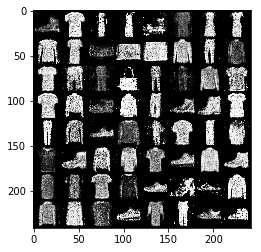

[Epoch 36/50] [Batch 201/938] [D loss: 1.283103] [G loss: 0.903840]
[Epoch 36/50] [Batch 202/938] [D loss: 1.364233] [G loss: 0.930963]
[Epoch 36/50] [Batch 203/938] [D loss: 1.344257] [G loss: 0.899760]
[Epoch 36/50] [Batch 204/938] [D loss: 1.387987] [G loss: 0.833752]
[Epoch 36/50] [Batch 205/938] [D loss: 1.251144] [G loss: 0.846334]
[Epoch 36/50] [Batch 206/938] [D loss: 1.243860] [G loss: 0.905375]
[Epoch 36/50] [Batch 207/938] [D loss: 1.282702] [G loss: 0.888904]
[Epoch 36/50] [Batch 208/938] [D loss: 1.267511] [G loss: 0.879787]
[Epoch 36/50] [Batch 209/938] [D loss: 1.350273] [G loss: 0.872147]
[Epoch 36/50] [Batch 210/938] [D loss: 1.308718] [G loss: 0.821406]
[Epoch 36/50] [Batch 211/938] [D loss: 1.294358] [G loss: 0.812491]
[Epoch 36/50] [Batch 212/938] [D loss: 1.369262] [G loss: 0.862369]
[Epoch 36/50] [Batch 213/938] [D loss: 1.353322] [G loss: 0.819688]
[Epoch 36/50] [Batch 214/938] [D loss: 1.270182] [G loss: 0.963368]
[Epoch 36/50] [Batch 215/938] [D loss: 1.347233]

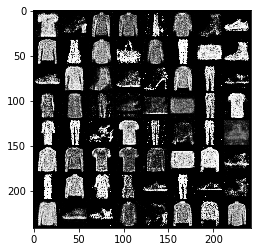

[Epoch 36/50] [Batch 401/938] [D loss: 1.244465] [G loss: 0.817409]
[Epoch 36/50] [Batch 402/938] [D loss: 1.288269] [G loss: 0.784454]
[Epoch 36/50] [Batch 403/938] [D loss: 1.194732] [G loss: 0.849963]
[Epoch 36/50] [Batch 404/938] [D loss: 1.188188] [G loss: 0.856971]
[Epoch 36/50] [Batch 405/938] [D loss: 1.246078] [G loss: 0.899530]
[Epoch 36/50] [Batch 406/938] [D loss: 1.176432] [G loss: 0.906356]
[Epoch 36/50] [Batch 407/938] [D loss: 1.212075] [G loss: 0.861844]
[Epoch 36/50] [Batch 408/938] [D loss: 1.335383] [G loss: 0.807447]
[Epoch 36/50] [Batch 409/938] [D loss: 1.223671] [G loss: 0.832239]
[Epoch 36/50] [Batch 410/938] [D loss: 1.230986] [G loss: 0.875029]
[Epoch 36/50] [Batch 411/938] [D loss: 1.263187] [G loss: 0.866152]
[Epoch 36/50] [Batch 412/938] [D loss: 1.293355] [G loss: 0.793543]
[Epoch 36/50] [Batch 413/938] [D loss: 1.216403] [G loss: 0.923323]
[Epoch 36/50] [Batch 414/938] [D loss: 1.345957] [G loss: 0.865334]
[Epoch 36/50] [Batch 415/938] [D loss: 1.376071]

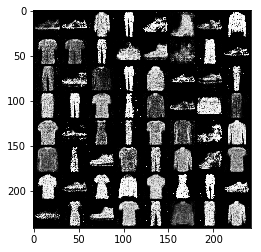

[Epoch 36/50] [Batch 601/938] [D loss: 1.255020] [G loss: 0.876470]
[Epoch 36/50] [Batch 602/938] [D loss: 1.311810] [G loss: 0.847632]
[Epoch 36/50] [Batch 603/938] [D loss: 1.218189] [G loss: 0.851659]
[Epoch 36/50] [Batch 604/938] [D loss: 1.272630] [G loss: 0.855386]
[Epoch 36/50] [Batch 605/938] [D loss: 1.366340] [G loss: 0.831945]
[Epoch 36/50] [Batch 606/938] [D loss: 1.242035] [G loss: 0.800901]
[Epoch 36/50] [Batch 607/938] [D loss: 1.260932] [G loss: 0.883330]
[Epoch 36/50] [Batch 608/938] [D loss: 1.248415] [G loss: 0.913566]
[Epoch 36/50] [Batch 609/938] [D loss: 1.205399] [G loss: 0.872464]
[Epoch 36/50] [Batch 610/938] [D loss: 1.319848] [G loss: 0.879587]
[Epoch 36/50] [Batch 611/938] [D loss: 1.293589] [G loss: 0.869427]
[Epoch 36/50] [Batch 612/938] [D loss: 1.313776] [G loss: 0.882117]
[Epoch 36/50] [Batch 613/938] [D loss: 1.241460] [G loss: 0.874294]
[Epoch 36/50] [Batch 614/938] [D loss: 1.212693] [G loss: 0.873938]
[Epoch 36/50] [Batch 615/938] [D loss: 1.413624]

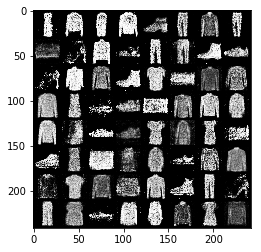

[Epoch 36/50] [Batch 801/938] [D loss: 1.345818] [G loss: 0.844386]
[Epoch 36/50] [Batch 802/938] [D loss: 1.224132] [G loss: 0.840238]
[Epoch 36/50] [Batch 803/938] [D loss: 1.180647] [G loss: 0.869370]
[Epoch 36/50] [Batch 804/938] [D loss: 1.249214] [G loss: 0.883095]
[Epoch 36/50] [Batch 805/938] [D loss: 1.235236] [G loss: 0.914827]
[Epoch 36/50] [Batch 806/938] [D loss: 1.337459] [G loss: 0.907868]
[Epoch 36/50] [Batch 807/938] [D loss: 1.356314] [G loss: 0.922647]
[Epoch 36/50] [Batch 808/938] [D loss: 1.278240] [G loss: 0.931523]
[Epoch 36/50] [Batch 809/938] [D loss: 1.357626] [G loss: 0.858297]
[Epoch 36/50] [Batch 810/938] [D loss: 1.338393] [G loss: 0.878008]
[Epoch 36/50] [Batch 811/938] [D loss: 1.193009] [G loss: 0.843050]
[Epoch 36/50] [Batch 812/938] [D loss: 1.174773] [G loss: 0.919129]
[Epoch 36/50] [Batch 813/938] [D loss: 1.296513] [G loss: 0.821975]
[Epoch 36/50] [Batch 814/938] [D loss: 1.225184] [G loss: 0.853707]
[Epoch 36/50] [Batch 815/938] [D loss: 1.178561]

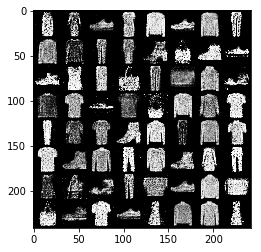

[Epoch 37/50] [Batch 1/938] [D loss: 1.277949] [G loss: 0.790603]
[Epoch 37/50] [Batch 2/938] [D loss: 1.338335] [G loss: 0.826565]
[Epoch 37/50] [Batch 3/938] [D loss: 1.377083] [G loss: 0.934665]
[Epoch 37/50] [Batch 4/938] [D loss: 1.340572] [G loss: 0.851396]
[Epoch 37/50] [Batch 5/938] [D loss: 1.317055] [G loss: 0.903685]
[Epoch 37/50] [Batch 6/938] [D loss: 1.358558] [G loss: 0.882271]
[Epoch 37/50] [Batch 7/938] [D loss: 1.299223] [G loss: 0.852998]
[Epoch 37/50] [Batch 8/938] [D loss: 1.367943] [G loss: 0.801967]
[Epoch 37/50] [Batch 9/938] [D loss: 1.257591] [G loss: 0.853532]
[Epoch 37/50] [Batch 10/938] [D loss: 1.242292] [G loss: 0.789510]
[Epoch 37/50] [Batch 11/938] [D loss: 1.311366] [G loss: 0.839858]
[Epoch 37/50] [Batch 12/938] [D loss: 1.252969] [G loss: 0.828288]
[Epoch 37/50] [Batch 13/938] [D loss: 1.307699] [G loss: 0.799754]
[Epoch 37/50] [Batch 14/938] [D loss: 1.216129] [G loss: 0.857137]
[Epoch 37/50] [Batch 15/938] [D loss: 1.248390] [G loss: 0.848214]
[Epo

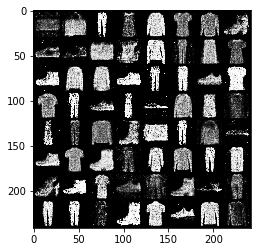

[Epoch 37/50] [Batch 201/938] [D loss: 1.304677] [G loss: 0.866988]
[Epoch 37/50] [Batch 202/938] [D loss: 1.244094] [G loss: 0.915874]
[Epoch 37/50] [Batch 203/938] [D loss: 1.210129] [G loss: 0.901613]
[Epoch 37/50] [Batch 204/938] [D loss: 1.303236] [G loss: 0.878542]
[Epoch 37/50] [Batch 205/938] [D loss: 1.208719] [G loss: 0.872833]
[Epoch 37/50] [Batch 206/938] [D loss: 1.209422] [G loss: 0.854356]
[Epoch 37/50] [Batch 207/938] [D loss: 1.234997] [G loss: 0.878573]
[Epoch 37/50] [Batch 208/938] [D loss: 1.270896] [G loss: 0.875690]
[Epoch 37/50] [Batch 209/938] [D loss: 1.229735] [G loss: 0.874444]
[Epoch 37/50] [Batch 210/938] [D loss: 1.304333] [G loss: 0.878592]
[Epoch 37/50] [Batch 211/938] [D loss: 1.274436] [G loss: 0.880416]
[Epoch 37/50] [Batch 212/938] [D loss: 1.285330] [G loss: 0.916434]
[Epoch 37/50] [Batch 213/938] [D loss: 1.232678] [G loss: 0.912917]
[Epoch 37/50] [Batch 214/938] [D loss: 1.241633] [G loss: 0.873573]
[Epoch 37/50] [Batch 215/938] [D loss: 1.326139]

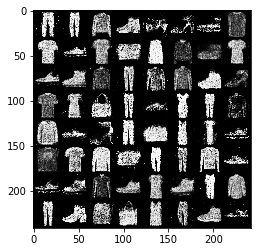

[Epoch 37/50] [Batch 401/938] [D loss: 1.243798] [G loss: 0.845600]
[Epoch 37/50] [Batch 402/938] [D loss: 1.323115] [G loss: 0.846496]
[Epoch 37/50] [Batch 403/938] [D loss: 1.231857] [G loss: 0.854183]
[Epoch 37/50] [Batch 404/938] [D loss: 1.256624] [G loss: 0.883916]
[Epoch 37/50] [Batch 405/938] [D loss: 1.293961] [G loss: 0.850681]
[Epoch 37/50] [Batch 406/938] [D loss: 1.228758] [G loss: 0.836407]
[Epoch 37/50] [Batch 407/938] [D loss: 1.214231] [G loss: 0.839545]
[Epoch 37/50] [Batch 408/938] [D loss: 1.384101] [G loss: 0.836819]
[Epoch 37/50] [Batch 409/938] [D loss: 1.201916] [G loss: 0.876945]
[Epoch 37/50] [Batch 410/938] [D loss: 1.229821] [G loss: 0.903956]
[Epoch 37/50] [Batch 411/938] [D loss: 1.300750] [G loss: 0.875317]
[Epoch 37/50] [Batch 412/938] [D loss: 1.171642] [G loss: 0.853441]
[Epoch 37/50] [Batch 413/938] [D loss: 1.309771] [G loss: 0.910538]
[Epoch 37/50] [Batch 414/938] [D loss: 1.272575] [G loss: 0.835273]
[Epoch 37/50] [Batch 415/938] [D loss: 1.287886]

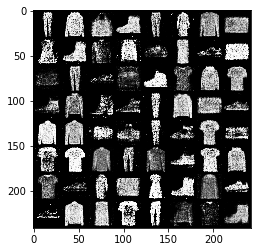

[Epoch 37/50] [Batch 601/938] [D loss: 1.219976] [G loss: 0.940083]
[Epoch 37/50] [Batch 602/938] [D loss: 1.202889] [G loss: 0.944265]
[Epoch 37/50] [Batch 603/938] [D loss: 1.403725] [G loss: 0.956580]
[Epoch 37/50] [Batch 604/938] [D loss: 1.358055] [G loss: 0.939808]
[Epoch 37/50] [Batch 605/938] [D loss: 1.306976] [G loss: 0.882902]
[Epoch 37/50] [Batch 606/938] [D loss: 1.217970] [G loss: 0.912466]
[Epoch 37/50] [Batch 607/938] [D loss: 1.201290] [G loss: 0.969344]
[Epoch 37/50] [Batch 608/938] [D loss: 1.303703] [G loss: 0.937389]
[Epoch 37/50] [Batch 609/938] [D loss: 1.274508] [G loss: 0.980985]
[Epoch 37/50] [Batch 610/938] [D loss: 1.361608] [G loss: 0.950404]
[Epoch 37/50] [Batch 611/938] [D loss: 1.249733] [G loss: 1.009706]
[Epoch 37/50] [Batch 612/938] [D loss: 1.271999] [G loss: 0.905950]
[Epoch 37/50] [Batch 613/938] [D loss: 1.222132] [G loss: 0.918894]
[Epoch 37/50] [Batch 614/938] [D loss: 1.280857] [G loss: 0.875175]
[Epoch 37/50] [Batch 615/938] [D loss: 1.207249]

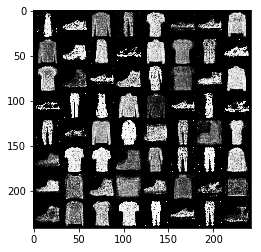

[Epoch 37/50] [Batch 801/938] [D loss: 1.415149] [G loss: 0.870260]
[Epoch 37/50] [Batch 802/938] [D loss: 1.308947] [G loss: 0.894131]
[Epoch 37/50] [Batch 803/938] [D loss: 1.210753] [G loss: 0.898454]
[Epoch 37/50] [Batch 804/938] [D loss: 1.409966] [G loss: 0.852690]
[Epoch 37/50] [Batch 805/938] [D loss: 1.312966] [G loss: 0.882286]
[Epoch 37/50] [Batch 806/938] [D loss: 1.357440] [G loss: 0.876058]
[Epoch 37/50] [Batch 807/938] [D loss: 1.193410] [G loss: 0.891747]
[Epoch 37/50] [Batch 808/938] [D loss: 1.222602] [G loss: 0.851538]
[Epoch 37/50] [Batch 809/938] [D loss: 1.264487] [G loss: 0.834406]
[Epoch 37/50] [Batch 810/938] [D loss: 1.365490] [G loss: 0.858859]
[Epoch 37/50] [Batch 811/938] [D loss: 1.386590] [G loss: 0.852997]
[Epoch 37/50] [Batch 812/938] [D loss: 1.309079] [G loss: 0.846666]
[Epoch 37/50] [Batch 813/938] [D loss: 1.216954] [G loss: 0.892316]
[Epoch 37/50] [Batch 814/938] [D loss: 1.278604] [G loss: 0.931380]
[Epoch 37/50] [Batch 815/938] [D loss: 1.283245]

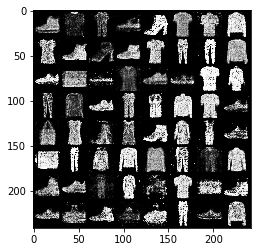

[Epoch 38/50] [Batch 1/938] [D loss: 1.264902] [G loss: 0.841100]
[Epoch 38/50] [Batch 2/938] [D loss: 1.262319] [G loss: 0.842103]
[Epoch 38/50] [Batch 3/938] [D loss: 1.174646] [G loss: 0.941096]
[Epoch 38/50] [Batch 4/938] [D loss: 1.220578] [G loss: 0.850038]
[Epoch 38/50] [Batch 5/938] [D loss: 1.258802] [G loss: 0.819763]
[Epoch 38/50] [Batch 6/938] [D loss: 1.212657] [G loss: 0.878778]
[Epoch 38/50] [Batch 7/938] [D loss: 1.225384] [G loss: 0.881353]
[Epoch 38/50] [Batch 8/938] [D loss: 1.296195] [G loss: 0.896680]
[Epoch 38/50] [Batch 9/938] [D loss: 1.304518] [G loss: 0.870817]
[Epoch 38/50] [Batch 10/938] [D loss: 1.278688] [G loss: 0.904166]
[Epoch 38/50] [Batch 11/938] [D loss: 1.249416] [G loss: 0.876700]
[Epoch 38/50] [Batch 12/938] [D loss: 1.212799] [G loss: 0.881311]
[Epoch 38/50] [Batch 13/938] [D loss: 1.220515] [G loss: 0.867112]
[Epoch 38/50] [Batch 14/938] [D loss: 1.283027] [G loss: 0.822804]
[Epoch 38/50] [Batch 15/938] [D loss: 1.276103] [G loss: 0.869380]
[Epo

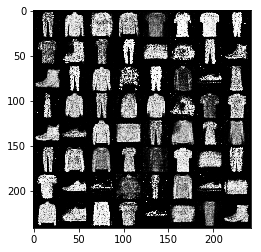

[Epoch 38/50] [Batch 201/938] [D loss: 1.348153] [G loss: 0.876070]
[Epoch 38/50] [Batch 202/938] [D loss: 1.219030] [G loss: 0.863278]
[Epoch 38/50] [Batch 203/938] [D loss: 1.277161] [G loss: 0.886247]
[Epoch 38/50] [Batch 204/938] [D loss: 1.195391] [G loss: 0.913941]
[Epoch 38/50] [Batch 205/938] [D loss: 1.230198] [G loss: 0.957013]
[Epoch 38/50] [Batch 206/938] [D loss: 1.238951] [G loss: 0.867699]
[Epoch 38/50] [Batch 207/938] [D loss: 1.287222] [G loss: 0.911566]
[Epoch 38/50] [Batch 208/938] [D loss: 1.288669] [G loss: 0.979109]
[Epoch 38/50] [Batch 209/938] [D loss: 1.149877] [G loss: 0.894549]
[Epoch 38/50] [Batch 210/938] [D loss: 1.253200] [G loss: 0.937118]
[Epoch 38/50] [Batch 211/938] [D loss: 1.225759] [G loss: 0.947810]
[Epoch 38/50] [Batch 212/938] [D loss: 1.209583] [G loss: 0.883918]
[Epoch 38/50] [Batch 213/938] [D loss: 1.265766] [G loss: 0.896968]
[Epoch 38/50] [Batch 214/938] [D loss: 1.392455] [G loss: 0.915618]
[Epoch 38/50] [Batch 215/938] [D loss: 1.283202]

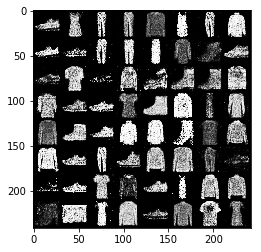

[Epoch 38/50] [Batch 401/938] [D loss: 1.219332] [G loss: 0.830880]
[Epoch 38/50] [Batch 402/938] [D loss: 1.235854] [G loss: 0.847566]
[Epoch 38/50] [Batch 403/938] [D loss: 1.281353] [G loss: 0.863277]
[Epoch 38/50] [Batch 404/938] [D loss: 1.240698] [G loss: 0.866896]
[Epoch 38/50] [Batch 405/938] [D loss: 1.342241] [G loss: 0.870993]
[Epoch 38/50] [Batch 406/938] [D loss: 1.218861] [G loss: 0.862408]
[Epoch 38/50] [Batch 407/938] [D loss: 1.339572] [G loss: 0.875569]
[Epoch 38/50] [Batch 408/938] [D loss: 1.260871] [G loss: 0.871871]
[Epoch 38/50] [Batch 409/938] [D loss: 1.367265] [G loss: 0.867305]
[Epoch 38/50] [Batch 410/938] [D loss: 1.264353] [G loss: 0.884339]
[Epoch 38/50] [Batch 411/938] [D loss: 1.281510] [G loss: 0.914182]
[Epoch 38/50] [Batch 412/938] [D loss: 1.266338] [G loss: 0.893237]
[Epoch 38/50] [Batch 413/938] [D loss: 1.237808] [G loss: 0.906661]
[Epoch 38/50] [Batch 414/938] [D loss: 1.211905] [G loss: 0.897741]
[Epoch 38/50] [Batch 415/938] [D loss: 1.198451]

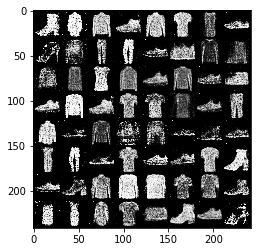

[Epoch 38/50] [Batch 601/938] [D loss: 1.306615] [G loss: 0.871527]
[Epoch 38/50] [Batch 602/938] [D loss: 1.304820] [G loss: 0.867657]
[Epoch 38/50] [Batch 603/938] [D loss: 1.377312] [G loss: 0.940335]
[Epoch 38/50] [Batch 604/938] [D loss: 1.299304] [G loss: 0.886121]
[Epoch 38/50] [Batch 605/938] [D loss: 1.228682] [G loss: 0.936697]
[Epoch 38/50] [Batch 606/938] [D loss: 1.273397] [G loss: 0.935701]
[Epoch 38/50] [Batch 607/938] [D loss: 1.373818] [G loss: 0.830240]
[Epoch 38/50] [Batch 608/938] [D loss: 1.245405] [G loss: 0.891022]
[Epoch 38/50] [Batch 609/938] [D loss: 1.316028] [G loss: 0.878720]
[Epoch 38/50] [Batch 610/938] [D loss: 1.309081] [G loss: 0.863702]
[Epoch 38/50] [Batch 611/938] [D loss: 1.308289] [G loss: 0.835464]
[Epoch 38/50] [Batch 612/938] [D loss: 1.283910] [G loss: 0.860139]
[Epoch 38/50] [Batch 613/938] [D loss: 1.240427] [G loss: 0.858057]
[Epoch 38/50] [Batch 614/938] [D loss: 1.276842] [G loss: 0.899600]
[Epoch 38/50] [Batch 615/938] [D loss: 1.255467]

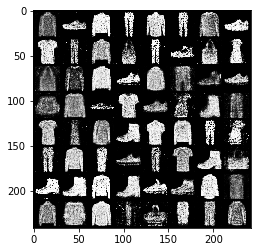

[Epoch 38/50] [Batch 801/938] [D loss: 1.228318] [G loss: 0.909727]
[Epoch 38/50] [Batch 802/938] [D loss: 1.332607] [G loss: 0.924380]
[Epoch 38/50] [Batch 803/938] [D loss: 1.292692] [G loss: 0.936247]
[Epoch 38/50] [Batch 804/938] [D loss: 1.301349] [G loss: 0.856942]
[Epoch 38/50] [Batch 805/938] [D loss: 1.339469] [G loss: 0.892485]
[Epoch 38/50] [Batch 806/938] [D loss: 1.370062] [G loss: 0.885545]
[Epoch 38/50] [Batch 807/938] [D loss: 1.238882] [G loss: 0.921154]
[Epoch 38/50] [Batch 808/938] [D loss: 1.345681] [G loss: 0.873890]
[Epoch 38/50] [Batch 809/938] [D loss: 1.263341] [G loss: 0.847566]
[Epoch 38/50] [Batch 810/938] [D loss: 1.239668] [G loss: 0.888004]
[Epoch 38/50] [Batch 811/938] [D loss: 1.301204] [G loss: 0.877037]
[Epoch 38/50] [Batch 812/938] [D loss: 1.287580] [G loss: 0.900497]
[Epoch 38/50] [Batch 813/938] [D loss: 1.269774] [G loss: 0.858040]
[Epoch 38/50] [Batch 814/938] [D loss: 1.225258] [G loss: 0.859266]
[Epoch 38/50] [Batch 815/938] [D loss: 1.312753]

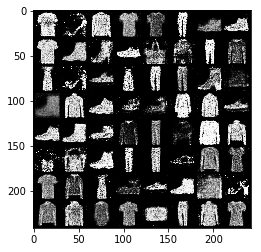

[Epoch 39/50] [Batch 1/938] [D loss: 1.246693] [G loss: 0.885463]
[Epoch 39/50] [Batch 2/938] [D loss: 1.192031] [G loss: 0.935950]
[Epoch 39/50] [Batch 3/938] [D loss: 1.211477] [G loss: 0.906857]
[Epoch 39/50] [Batch 4/938] [D loss: 1.284208] [G loss: 0.895616]
[Epoch 39/50] [Batch 5/938] [D loss: 1.266506] [G loss: 0.906860]
[Epoch 39/50] [Batch 6/938] [D loss: 1.267225] [G loss: 0.864013]
[Epoch 39/50] [Batch 7/938] [D loss: 1.302682] [G loss: 0.828372]
[Epoch 39/50] [Batch 8/938] [D loss: 1.261992] [G loss: 0.932618]
[Epoch 39/50] [Batch 9/938] [D loss: 1.270462] [G loss: 0.917348]
[Epoch 39/50] [Batch 10/938] [D loss: 1.229183] [G loss: 0.938961]
[Epoch 39/50] [Batch 11/938] [D loss: 1.356254] [G loss: 0.935616]
[Epoch 39/50] [Batch 12/938] [D loss: 1.312030] [G loss: 0.905715]
[Epoch 39/50] [Batch 13/938] [D loss: 1.339309] [G loss: 0.878010]
[Epoch 39/50] [Batch 14/938] [D loss: 1.228562] [G loss: 1.000175]
[Epoch 39/50] [Batch 15/938] [D loss: 1.328279] [G loss: 0.922444]
[Epo

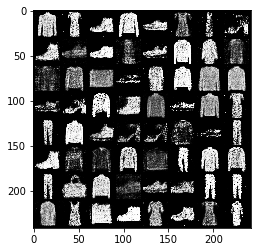

[Epoch 39/50] [Batch 201/938] [D loss: 1.262640] [G loss: 0.911096]
[Epoch 39/50] [Batch 202/938] [D loss: 1.252728] [G loss: 0.885243]
[Epoch 39/50] [Batch 203/938] [D loss: 1.282435] [G loss: 0.927066]
[Epoch 39/50] [Batch 204/938] [D loss: 1.304172] [G loss: 0.817255]
[Epoch 39/50] [Batch 205/938] [D loss: 1.254214] [G loss: 0.879249]
[Epoch 39/50] [Batch 206/938] [D loss: 1.308531] [G loss: 0.864924]
[Epoch 39/50] [Batch 207/938] [D loss: 1.305509] [G loss: 0.875093]
[Epoch 39/50] [Batch 208/938] [D loss: 1.323415] [G loss: 0.899311]
[Epoch 39/50] [Batch 209/938] [D loss: 1.244003] [G loss: 0.922971]
[Epoch 39/50] [Batch 210/938] [D loss: 1.249502] [G loss: 0.886410]
[Epoch 39/50] [Batch 211/938] [D loss: 1.296382] [G loss: 0.884912]
[Epoch 39/50] [Batch 212/938] [D loss: 1.211080] [G loss: 0.854239]
[Epoch 39/50] [Batch 213/938] [D loss: 1.266543] [G loss: 0.903916]
[Epoch 39/50] [Batch 214/938] [D loss: 1.310288] [G loss: 0.879751]
[Epoch 39/50] [Batch 215/938] [D loss: 1.249500]

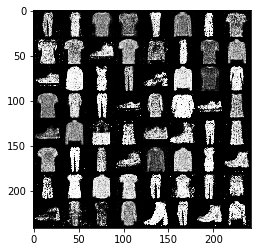

[Epoch 39/50] [Batch 401/938] [D loss: 1.470978] [G loss: 0.911581]
[Epoch 39/50] [Batch 402/938] [D loss: 1.231263] [G loss: 0.942188]
[Epoch 39/50] [Batch 403/938] [D loss: 1.252873] [G loss: 0.919655]
[Epoch 39/50] [Batch 404/938] [D loss: 1.248726] [G loss: 0.923744]
[Epoch 39/50] [Batch 405/938] [D loss: 1.229598] [G loss: 0.902328]
[Epoch 39/50] [Batch 406/938] [D loss: 1.336123] [G loss: 0.834588]
[Epoch 39/50] [Batch 407/938] [D loss: 1.259778] [G loss: 0.884891]
[Epoch 39/50] [Batch 408/938] [D loss: 1.276692] [G loss: 0.843877]
[Epoch 39/50] [Batch 409/938] [D loss: 1.241512] [G loss: 0.823189]
[Epoch 39/50] [Batch 410/938] [D loss: 1.359045] [G loss: 0.827613]
[Epoch 39/50] [Batch 411/938] [D loss: 1.264178] [G loss: 0.861721]
[Epoch 39/50] [Batch 412/938] [D loss: 1.262542] [G loss: 0.918384]
[Epoch 39/50] [Batch 413/938] [D loss: 1.317458] [G loss: 0.888973]
[Epoch 39/50] [Batch 414/938] [D loss: 1.315239] [G loss: 0.873190]
[Epoch 39/50] [Batch 415/938] [D loss: 1.407643]

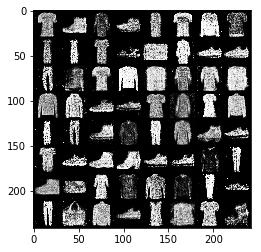

[Epoch 39/50] [Batch 601/938] [D loss: 1.239896] [G loss: 0.885455]
[Epoch 39/50] [Batch 602/938] [D loss: 1.277466] [G loss: 0.854594]
[Epoch 39/50] [Batch 603/938] [D loss: 1.239356] [G loss: 0.907341]
[Epoch 39/50] [Batch 604/938] [D loss: 1.220186] [G loss: 0.860901]
[Epoch 39/50] [Batch 605/938] [D loss: 1.259911] [G loss: 0.847648]
[Epoch 39/50] [Batch 606/938] [D loss: 1.261358] [G loss: 0.900605]
[Epoch 39/50] [Batch 607/938] [D loss: 1.278908] [G loss: 0.879593]
[Epoch 39/50] [Batch 608/938] [D loss: 1.225926] [G loss: 0.922789]
[Epoch 39/50] [Batch 609/938] [D loss: 1.267891] [G loss: 0.838199]
[Epoch 39/50] [Batch 610/938] [D loss: 1.288713] [G loss: 0.858971]
[Epoch 39/50] [Batch 611/938] [D loss: 1.324547] [G loss: 0.902787]
[Epoch 39/50] [Batch 612/938] [D loss: 1.234294] [G loss: 0.861256]
[Epoch 39/50] [Batch 613/938] [D loss: 1.292373] [G loss: 0.855716]
[Epoch 39/50] [Batch 614/938] [D loss: 1.283810] [G loss: 0.862893]
[Epoch 39/50] [Batch 615/938] [D loss: 1.223245]

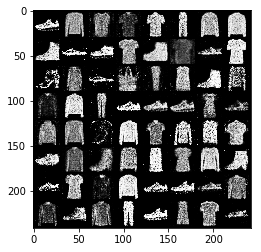

[Epoch 39/50] [Batch 801/938] [D loss: 1.235893] [G loss: 0.885933]
[Epoch 39/50] [Batch 802/938] [D loss: 1.252687] [G loss: 0.838913]
[Epoch 39/50] [Batch 803/938] [D loss: 1.228686] [G loss: 0.877461]
[Epoch 39/50] [Batch 804/938] [D loss: 1.216974] [G loss: 0.935737]
[Epoch 39/50] [Batch 805/938] [D loss: 1.240165] [G loss: 0.889053]
[Epoch 39/50] [Batch 806/938] [D loss: 1.283113] [G loss: 0.885771]
[Epoch 39/50] [Batch 807/938] [D loss: 1.357940] [G loss: 0.866240]
[Epoch 39/50] [Batch 808/938] [D loss: 1.299652] [G loss: 0.851881]
[Epoch 39/50] [Batch 809/938] [D loss: 1.325266] [G loss: 0.951447]
[Epoch 39/50] [Batch 810/938] [D loss: 1.350321] [G loss: 0.913029]
[Epoch 39/50] [Batch 811/938] [D loss: 1.317398] [G loss: 0.919161]
[Epoch 39/50] [Batch 812/938] [D loss: 1.183348] [G loss: 0.901500]
[Epoch 39/50] [Batch 813/938] [D loss: 1.219034] [G loss: 0.926649]
[Epoch 39/50] [Batch 814/938] [D loss: 1.316988] [G loss: 0.895614]
[Epoch 39/50] [Batch 815/938] [D loss: 1.180824]

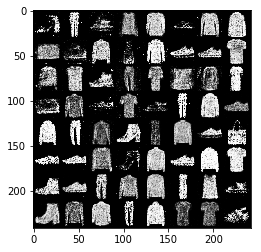

[Epoch 40/50] [Batch 1/938] [D loss: 1.276218] [G loss: 0.889808]
[Epoch 40/50] [Batch 2/938] [D loss: 1.230016] [G loss: 0.839923]
[Epoch 40/50] [Batch 3/938] [D loss: 1.253376] [G loss: 0.940240]
[Epoch 40/50] [Batch 4/938] [D loss: 1.169851] [G loss: 0.953612]
[Epoch 40/50] [Batch 5/938] [D loss: 1.334817] [G loss: 0.886624]
[Epoch 40/50] [Batch 6/938] [D loss: 1.224192] [G loss: 0.906338]
[Epoch 40/50] [Batch 7/938] [D loss: 1.194483] [G loss: 0.839968]
[Epoch 40/50] [Batch 8/938] [D loss: 1.363890] [G loss: 0.779412]
[Epoch 40/50] [Batch 9/938] [D loss: 1.280479] [G loss: 0.875794]
[Epoch 40/50] [Batch 10/938] [D loss: 1.227159] [G loss: 0.841855]
[Epoch 40/50] [Batch 11/938] [D loss: 1.257631] [G loss: 0.872334]
[Epoch 40/50] [Batch 12/938] [D loss: 1.225706] [G loss: 0.885800]
[Epoch 40/50] [Batch 13/938] [D loss: 1.360224] [G loss: 0.846569]
[Epoch 40/50] [Batch 14/938] [D loss: 1.231345] [G loss: 0.847591]
[Epoch 40/50] [Batch 15/938] [D loss: 1.240697] [G loss: 0.823995]
[Epo

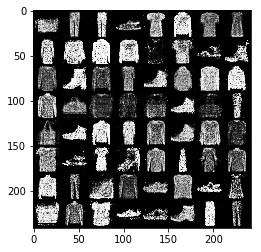

[Epoch 40/50] [Batch 201/938] [D loss: 1.188097] [G loss: 0.909504]
[Epoch 40/50] [Batch 202/938] [D loss: 1.281230] [G loss: 0.845043]
[Epoch 40/50] [Batch 203/938] [D loss: 1.259701] [G loss: 0.891407]
[Epoch 40/50] [Batch 204/938] [D loss: 1.328215] [G loss: 0.864571]
[Epoch 40/50] [Batch 205/938] [D loss: 1.296547] [G loss: 0.892010]
[Epoch 40/50] [Batch 206/938] [D loss: 1.302545] [G loss: 0.890804]
[Epoch 40/50] [Batch 207/938] [D loss: 1.234251] [G loss: 0.944047]
[Epoch 40/50] [Batch 208/938] [D loss: 1.311065] [G loss: 0.901951]
[Epoch 40/50] [Batch 209/938] [D loss: 1.234826] [G loss: 0.928670]
[Epoch 40/50] [Batch 210/938] [D loss: 1.377122] [G loss: 0.913623]
[Epoch 40/50] [Batch 211/938] [D loss: 1.188644] [G loss: 0.911192]
[Epoch 40/50] [Batch 212/938] [D loss: 1.281853] [G loss: 0.825386]
[Epoch 40/50] [Batch 213/938] [D loss: 1.261294] [G loss: 0.864693]
[Epoch 40/50] [Batch 214/938] [D loss: 1.230092] [G loss: 0.920914]
[Epoch 40/50] [Batch 215/938] [D loss: 1.310707]

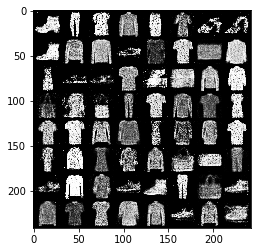

[Epoch 40/50] [Batch 401/938] [D loss: 1.289756] [G loss: 0.879528]
[Epoch 40/50] [Batch 402/938] [D loss: 1.349010] [G loss: 0.889399]
[Epoch 40/50] [Batch 403/938] [D loss: 1.381068] [G loss: 0.878081]
[Epoch 40/50] [Batch 404/938] [D loss: 1.309335] [G loss: 0.870172]
[Epoch 40/50] [Batch 405/938] [D loss: 1.252300] [G loss: 0.889261]
[Epoch 40/50] [Batch 406/938] [D loss: 1.393670] [G loss: 0.900899]
[Epoch 40/50] [Batch 407/938] [D loss: 1.271375] [G loss: 0.885303]
[Epoch 40/50] [Batch 408/938] [D loss: 1.338666] [G loss: 0.878060]
[Epoch 40/50] [Batch 409/938] [D loss: 1.279801] [G loss: 0.891885]
[Epoch 40/50] [Batch 410/938] [D loss: 1.401527] [G loss: 0.864466]
[Epoch 40/50] [Batch 411/938] [D loss: 1.225907] [G loss: 0.890520]
[Epoch 40/50] [Batch 412/938] [D loss: 1.290849] [G loss: 0.811918]
[Epoch 40/50] [Batch 413/938] [D loss: 1.291803] [G loss: 0.913973]
[Epoch 40/50] [Batch 414/938] [D loss: 1.350373] [G loss: 0.850877]
[Epoch 40/50] [Batch 415/938] [D loss: 1.259466]

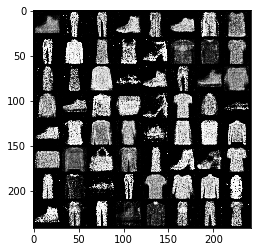

[Epoch 40/50] [Batch 601/938] [D loss: 1.240201] [G loss: 0.863812]
[Epoch 40/50] [Batch 602/938] [D loss: 1.246527] [G loss: 0.896878]
[Epoch 40/50] [Batch 603/938] [D loss: 1.364790] [G loss: 0.822989]
[Epoch 40/50] [Batch 604/938] [D loss: 1.197821] [G loss: 0.843673]
[Epoch 40/50] [Batch 605/938] [D loss: 1.386042] [G loss: 0.854778]
[Epoch 40/50] [Batch 606/938] [D loss: 1.084883] [G loss: 0.894106]
[Epoch 40/50] [Batch 607/938] [D loss: 1.217609] [G loss: 0.829957]
[Epoch 40/50] [Batch 608/938] [D loss: 1.306636] [G loss: 0.846936]
[Epoch 40/50] [Batch 609/938] [D loss: 1.248949] [G loss: 0.906314]
[Epoch 40/50] [Batch 610/938] [D loss: 1.295928] [G loss: 0.928725]
[Epoch 40/50] [Batch 611/938] [D loss: 1.238405] [G loss: 0.846929]
[Epoch 40/50] [Batch 612/938] [D loss: 1.275711] [G loss: 0.856676]
[Epoch 40/50] [Batch 613/938] [D loss: 1.325493] [G loss: 0.830486]
[Epoch 40/50] [Batch 614/938] [D loss: 1.231179] [G loss: 0.801241]
[Epoch 40/50] [Batch 615/938] [D loss: 1.287057]

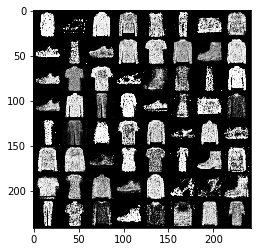

[Epoch 40/50] [Batch 801/938] [D loss: 1.211666] [G loss: 0.915057]
[Epoch 40/50] [Batch 802/938] [D loss: 1.368111] [G loss: 0.890318]
[Epoch 40/50] [Batch 803/938] [D loss: 1.376574] [G loss: 0.889293]
[Epoch 40/50] [Batch 804/938] [D loss: 1.238156] [G loss: 0.903025]
[Epoch 40/50] [Batch 805/938] [D loss: 1.267439] [G loss: 0.846816]
[Epoch 40/50] [Batch 806/938] [D loss: 1.215991] [G loss: 0.893866]
[Epoch 40/50] [Batch 807/938] [D loss: 1.345081] [G loss: 0.889139]
[Epoch 40/50] [Batch 808/938] [D loss: 1.212718] [G loss: 0.892064]
[Epoch 40/50] [Batch 809/938] [D loss: 1.257450] [G loss: 0.838859]
[Epoch 40/50] [Batch 810/938] [D loss: 1.226921] [G loss: 0.895485]
[Epoch 40/50] [Batch 811/938] [D loss: 1.230206] [G loss: 0.927895]
[Epoch 40/50] [Batch 812/938] [D loss: 1.294111] [G loss: 0.939161]
[Epoch 40/50] [Batch 813/938] [D loss: 1.277130] [G loss: 0.905230]
[Epoch 40/50] [Batch 814/938] [D loss: 1.263790] [G loss: 0.899913]
[Epoch 40/50] [Batch 815/938] [D loss: 1.333845]

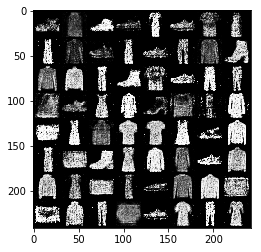

[Epoch 41/50] [Batch 1/938] [D loss: 1.268881] [G loss: 0.855800]
[Epoch 41/50] [Batch 2/938] [D loss: 1.256055] [G loss: 0.832463]
[Epoch 41/50] [Batch 3/938] [D loss: 1.294138] [G loss: 0.833300]
[Epoch 41/50] [Batch 4/938] [D loss: 1.159443] [G loss: 0.901303]
[Epoch 41/50] [Batch 5/938] [D loss: 1.227837] [G loss: 0.864747]
[Epoch 41/50] [Batch 6/938] [D loss: 1.126845] [G loss: 0.872461]
[Epoch 41/50] [Batch 7/938] [D loss: 1.291249] [G loss: 0.937711]
[Epoch 41/50] [Batch 8/938] [D loss: 1.217718] [G loss: 0.962974]
[Epoch 41/50] [Batch 9/938] [D loss: 1.460165] [G loss: 0.920199]
[Epoch 41/50] [Batch 10/938] [D loss: 1.325633] [G loss: 0.957647]
[Epoch 41/50] [Batch 11/938] [D loss: 1.310733] [G loss: 0.913611]
[Epoch 41/50] [Batch 12/938] [D loss: 1.368051] [G loss: 0.932314]
[Epoch 41/50] [Batch 13/938] [D loss: 1.288119] [G loss: 0.850834]
[Epoch 41/50] [Batch 14/938] [D loss: 1.197960] [G loss: 0.884772]
[Epoch 41/50] [Batch 15/938] [D loss: 1.269156] [G loss: 0.887385]
[Epo

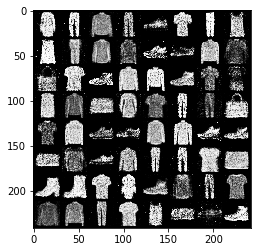

[Epoch 41/50] [Batch 201/938] [D loss: 1.388247] [G loss: 0.869444]
[Epoch 41/50] [Batch 202/938] [D loss: 1.188942] [G loss: 0.916384]
[Epoch 41/50] [Batch 203/938] [D loss: 1.305096] [G loss: 0.889651]
[Epoch 41/50] [Batch 204/938] [D loss: 1.177531] [G loss: 0.898071]
[Epoch 41/50] [Batch 205/938] [D loss: 1.314416] [G loss: 0.859533]
[Epoch 41/50] [Batch 206/938] [D loss: 1.232826] [G loss: 0.825992]
[Epoch 41/50] [Batch 207/938] [D loss: 1.329446] [G loss: 0.794528]
[Epoch 41/50] [Batch 208/938] [D loss: 1.309086] [G loss: 0.891868]
[Epoch 41/50] [Batch 209/938] [D loss: 1.269150] [G loss: 0.929744]
[Epoch 41/50] [Batch 210/938] [D loss: 1.355284] [G loss: 0.940444]
[Epoch 41/50] [Batch 211/938] [D loss: 1.227860] [G loss: 0.911614]
[Epoch 41/50] [Batch 212/938] [D loss: 1.297354] [G loss: 0.931800]
[Epoch 41/50] [Batch 213/938] [D loss: 1.280675] [G loss: 0.871524]
[Epoch 41/50] [Batch 214/938] [D loss: 1.310429] [G loss: 0.893741]
[Epoch 41/50] [Batch 215/938] [D loss: 1.317635]

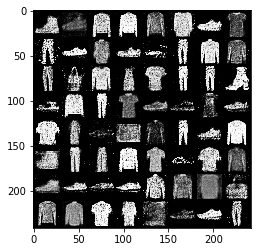

[Epoch 41/50] [Batch 401/938] [D loss: 1.166695] [G loss: 0.856023]
[Epoch 41/50] [Batch 402/938] [D loss: 1.145958] [G loss: 0.959856]
[Epoch 41/50] [Batch 403/938] [D loss: 1.189047] [G loss: 0.937162]
[Epoch 41/50] [Batch 404/938] [D loss: 1.283856] [G loss: 0.917146]
[Epoch 41/50] [Batch 405/938] [D loss: 1.246977] [G loss: 0.829483]
[Epoch 41/50] [Batch 406/938] [D loss: 1.251709] [G loss: 0.894927]
[Epoch 41/50] [Batch 407/938] [D loss: 1.296749] [G loss: 0.879499]
[Epoch 41/50] [Batch 408/938] [D loss: 1.260235] [G loss: 0.944713]
[Epoch 41/50] [Batch 409/938] [D loss: 1.238513] [G loss: 0.835954]
[Epoch 41/50] [Batch 410/938] [D loss: 1.299679] [G loss: 0.819031]
[Epoch 41/50] [Batch 411/938] [D loss: 1.259388] [G loss: 0.874532]
[Epoch 41/50] [Batch 412/938] [D loss: 1.333917] [G loss: 0.904579]
[Epoch 41/50] [Batch 413/938] [D loss: 1.198651] [G loss: 0.972286]
[Epoch 41/50] [Batch 414/938] [D loss: 1.255546] [G loss: 0.933932]
[Epoch 41/50] [Batch 415/938] [D loss: 1.259274]

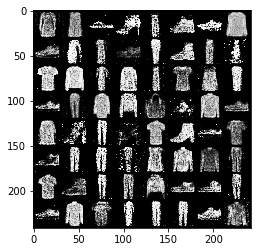

[Epoch 41/50] [Batch 601/938] [D loss: 1.263281] [G loss: 0.867261]
[Epoch 41/50] [Batch 602/938] [D loss: 1.148408] [G loss: 0.845194]
[Epoch 41/50] [Batch 603/938] [D loss: 1.206579] [G loss: 0.895990]
[Epoch 41/50] [Batch 604/938] [D loss: 1.282908] [G loss: 0.916686]
[Epoch 41/50] [Batch 605/938] [D loss: 1.246168] [G loss: 0.904263]
[Epoch 41/50] [Batch 606/938] [D loss: 1.273796] [G loss: 0.829056]
[Epoch 41/50] [Batch 607/938] [D loss: 1.303691] [G loss: 0.871011]
[Epoch 41/50] [Batch 608/938] [D loss: 1.285980] [G loss: 0.851456]
[Epoch 41/50] [Batch 609/938] [D loss: 1.229747] [G loss: 0.858170]
[Epoch 41/50] [Batch 610/938] [D loss: 1.163209] [G loss: 0.831157]
[Epoch 41/50] [Batch 611/938] [D loss: 1.188532] [G loss: 0.829077]
[Epoch 41/50] [Batch 612/938] [D loss: 1.227217] [G loss: 0.875361]
[Epoch 41/50] [Batch 613/938] [D loss: 1.115400] [G loss: 0.861317]
[Epoch 41/50] [Batch 614/938] [D loss: 1.247391] [G loss: 0.858943]
[Epoch 41/50] [Batch 615/938] [D loss: 1.256798]

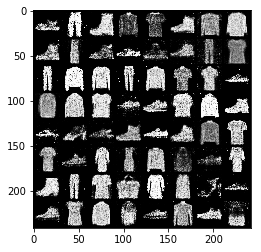

[Epoch 41/50] [Batch 801/938] [D loss: 1.279313] [G loss: 0.835952]
[Epoch 41/50] [Batch 802/938] [D loss: 1.200342] [G loss: 0.931242]
[Epoch 41/50] [Batch 803/938] [D loss: 1.287848] [G loss: 0.883204]
[Epoch 41/50] [Batch 804/938] [D loss: 1.420341] [G loss: 0.855563]
[Epoch 41/50] [Batch 805/938] [D loss: 1.307167] [G loss: 0.857268]
[Epoch 41/50] [Batch 806/938] [D loss: 1.276470] [G loss: 0.874668]
[Epoch 41/50] [Batch 807/938] [D loss: 1.237176] [G loss: 0.872177]
[Epoch 41/50] [Batch 808/938] [D loss: 1.210300] [G loss: 0.894276]
[Epoch 41/50] [Batch 809/938] [D loss: 1.318849] [G loss: 0.852239]
[Epoch 41/50] [Batch 810/938] [D loss: 1.298252] [G loss: 0.846389]
[Epoch 41/50] [Batch 811/938] [D loss: 1.285890] [G loss: 0.869658]
[Epoch 41/50] [Batch 812/938] [D loss: 1.216290] [G loss: 0.874025]
[Epoch 41/50] [Batch 813/938] [D loss: 1.325360] [G loss: 0.865303]
[Epoch 41/50] [Batch 814/938] [D loss: 1.192281] [G loss: 0.950523]
[Epoch 41/50] [Batch 815/938] [D loss: 1.271430]

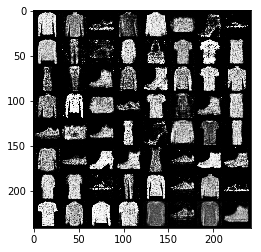

[Epoch 42/50] [Batch 1/938] [D loss: 1.273212] [G loss: 0.854370]
[Epoch 42/50] [Batch 2/938] [D loss: 1.219586] [G loss: 0.874193]
[Epoch 42/50] [Batch 3/938] [D loss: 1.292374] [G loss: 0.902897]
[Epoch 42/50] [Batch 4/938] [D loss: 1.239493] [G loss: 0.888958]
[Epoch 42/50] [Batch 5/938] [D loss: 1.220574] [G loss: 0.895167]
[Epoch 42/50] [Batch 6/938] [D loss: 1.275414] [G loss: 0.845521]
[Epoch 42/50] [Batch 7/938] [D loss: 1.209989] [G loss: 0.877224]
[Epoch 42/50] [Batch 8/938] [D loss: 1.279710] [G loss: 0.858269]
[Epoch 42/50] [Batch 9/938] [D loss: 1.383445] [G loss: 0.851953]
[Epoch 42/50] [Batch 10/938] [D loss: 1.195418] [G loss: 0.862897]
[Epoch 42/50] [Batch 11/938] [D loss: 1.259525] [G loss: 0.852776]
[Epoch 42/50] [Batch 12/938] [D loss: 1.229071] [G loss: 0.867364]
[Epoch 42/50] [Batch 13/938] [D loss: 1.333317] [G loss: 0.857373]
[Epoch 42/50] [Batch 14/938] [D loss: 1.235320] [G loss: 0.859778]
[Epoch 42/50] [Batch 15/938] [D loss: 1.267076] [G loss: 0.858806]
[Epo

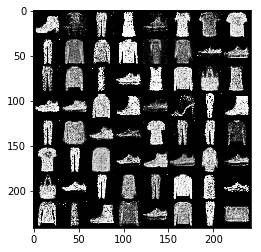

[Epoch 42/50] [Batch 201/938] [D loss: 1.276995] [G loss: 0.880193]
[Epoch 42/50] [Batch 202/938] [D loss: 1.287199] [G loss: 0.791077]
[Epoch 42/50] [Batch 203/938] [D loss: 1.234062] [G loss: 0.829111]
[Epoch 42/50] [Batch 204/938] [D loss: 1.237705] [G loss: 0.878727]
[Epoch 42/50] [Batch 205/938] [D loss: 1.321612] [G loss: 0.889554]
[Epoch 42/50] [Batch 206/938] [D loss: 1.250089] [G loss: 0.861870]
[Epoch 42/50] [Batch 207/938] [D loss: 1.234589] [G loss: 0.876793]
[Epoch 42/50] [Batch 208/938] [D loss: 1.228671] [G loss: 0.858728]
[Epoch 42/50] [Batch 209/938] [D loss: 1.335767] [G loss: 0.869637]
[Epoch 42/50] [Batch 210/938] [D loss: 1.325282] [G loss: 0.862181]
[Epoch 42/50] [Batch 211/938] [D loss: 1.204444] [G loss: 0.863925]
[Epoch 42/50] [Batch 212/938] [D loss: 1.199072] [G loss: 0.894557]
[Epoch 42/50] [Batch 213/938] [D loss: 1.283604] [G loss: 0.842113]
[Epoch 42/50] [Batch 214/938] [D loss: 1.349960] [G loss: 0.939174]
[Epoch 42/50] [Batch 215/938] [D loss: 1.214462]

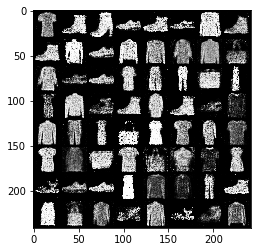

[Epoch 42/50] [Batch 401/938] [D loss: 1.246722] [G loss: 0.902535]
[Epoch 42/50] [Batch 402/938] [D loss: 1.174789] [G loss: 0.892796]
[Epoch 42/50] [Batch 403/938] [D loss: 1.381068] [G loss: 0.814222]
[Epoch 42/50] [Batch 404/938] [D loss: 1.309298] [G loss: 0.866738]
[Epoch 42/50] [Batch 405/938] [D loss: 1.334477] [G loss: 0.848844]
[Epoch 42/50] [Batch 406/938] [D loss: 1.265797] [G loss: 0.913134]
[Epoch 42/50] [Batch 407/938] [D loss: 1.246315] [G loss: 0.868721]
[Epoch 42/50] [Batch 408/938] [D loss: 1.361404] [G loss: 0.835294]
[Epoch 42/50] [Batch 409/938] [D loss: 1.317410] [G loss: 0.867955]
[Epoch 42/50] [Batch 410/938] [D loss: 1.236620] [G loss: 0.920296]
[Epoch 42/50] [Batch 411/938] [D loss: 1.241115] [G loss: 0.846749]
[Epoch 42/50] [Batch 412/938] [D loss: 1.307305] [G loss: 0.892868]
[Epoch 42/50] [Batch 413/938] [D loss: 1.310225] [G loss: 0.867422]
[Epoch 42/50] [Batch 414/938] [D loss: 1.334338] [G loss: 0.911777]
[Epoch 42/50] [Batch 415/938] [D loss: 1.310718]

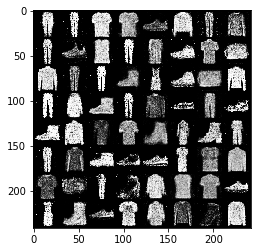

[Epoch 42/50] [Batch 601/938] [D loss: 1.254693] [G loss: 0.884923]
[Epoch 42/50] [Batch 602/938] [D loss: 1.289947] [G loss: 0.881135]
[Epoch 42/50] [Batch 603/938] [D loss: 1.331293] [G loss: 0.881066]
[Epoch 42/50] [Batch 604/938] [D loss: 1.268400] [G loss: 0.885289]
[Epoch 42/50] [Batch 605/938] [D loss: 1.303516] [G loss: 0.887058]
[Epoch 42/50] [Batch 606/938] [D loss: 1.237238] [G loss: 0.890932]
[Epoch 42/50] [Batch 607/938] [D loss: 1.261189] [G loss: 0.847608]
[Epoch 42/50] [Batch 608/938] [D loss: 1.363921] [G loss: 0.864843]
[Epoch 42/50] [Batch 609/938] [D loss: 1.271275] [G loss: 0.884706]
[Epoch 42/50] [Batch 610/938] [D loss: 1.347903] [G loss: 0.868357]
[Epoch 42/50] [Batch 611/938] [D loss: 1.245396] [G loss: 0.854530]
[Epoch 42/50] [Batch 612/938] [D loss: 1.309416] [G loss: 0.852086]
[Epoch 42/50] [Batch 613/938] [D loss: 1.276235] [G loss: 0.883187]
[Epoch 42/50] [Batch 614/938] [D loss: 1.252608] [G loss: 0.851131]
[Epoch 42/50] [Batch 615/938] [D loss: 1.379656]

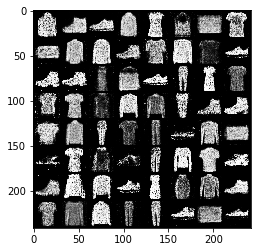

[Epoch 42/50] [Batch 801/938] [D loss: 1.321451] [G loss: 0.922222]
[Epoch 42/50] [Batch 802/938] [D loss: 1.296691] [G loss: 0.899331]
[Epoch 42/50] [Batch 803/938] [D loss: 1.257231] [G loss: 0.911736]
[Epoch 42/50] [Batch 804/938] [D loss: 1.245546] [G loss: 0.878913]
[Epoch 42/50] [Batch 805/938] [D loss: 1.255192] [G loss: 0.874842]
[Epoch 42/50] [Batch 806/938] [D loss: 1.279508] [G loss: 0.885804]
[Epoch 42/50] [Batch 807/938] [D loss: 1.258718] [G loss: 0.864788]
[Epoch 42/50] [Batch 808/938] [D loss: 1.285013] [G loss: 0.875989]
[Epoch 42/50] [Batch 809/938] [D loss: 1.323895] [G loss: 0.883538]
[Epoch 42/50] [Batch 810/938] [D loss: 1.288065] [G loss: 0.846231]
[Epoch 42/50] [Batch 811/938] [D loss: 1.282391] [G loss: 0.904434]
[Epoch 42/50] [Batch 812/938] [D loss: 1.198951] [G loss: 0.924768]
[Epoch 42/50] [Batch 813/938] [D loss: 1.220066] [G loss: 0.896307]
[Epoch 42/50] [Batch 814/938] [D loss: 1.272646] [G loss: 0.882357]
[Epoch 42/50] [Batch 815/938] [D loss: 1.339035]

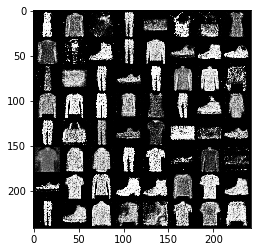

[Epoch 43/50] [Batch 1/938] [D loss: 1.258209] [G loss: 0.907295]
[Epoch 43/50] [Batch 2/938] [D loss: 1.204558] [G loss: 0.851569]
[Epoch 43/50] [Batch 3/938] [D loss: 1.262400] [G loss: 0.858085]
[Epoch 43/50] [Batch 4/938] [D loss: 1.177721] [G loss: 0.949044]
[Epoch 43/50] [Batch 5/938] [D loss: 1.338495] [G loss: 0.882119]
[Epoch 43/50] [Batch 6/938] [D loss: 1.312464] [G loss: 0.884537]
[Epoch 43/50] [Batch 7/938] [D loss: 1.271086] [G loss: 0.950620]
[Epoch 43/50] [Batch 8/938] [D loss: 1.191353] [G loss: 0.909675]
[Epoch 43/50] [Batch 9/938] [D loss: 1.197826] [G loss: 0.918018]
[Epoch 43/50] [Batch 10/938] [D loss: 1.161610] [G loss: 0.887544]
[Epoch 43/50] [Batch 11/938] [D loss: 1.305164] [G loss: 0.938412]
[Epoch 43/50] [Batch 12/938] [D loss: 1.287511] [G loss: 0.864491]
[Epoch 43/50] [Batch 13/938] [D loss: 1.216742] [G loss: 0.865907]
[Epoch 43/50] [Batch 14/938] [D loss: 1.239597] [G loss: 0.900041]
[Epoch 43/50] [Batch 15/938] [D loss: 1.356792] [G loss: 0.896469]
[Epo

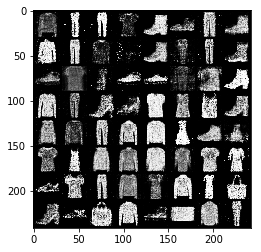

[Epoch 43/50] [Batch 201/938] [D loss: 1.279828] [G loss: 0.902640]
[Epoch 43/50] [Batch 202/938] [D loss: 1.272678] [G loss: 0.874000]
[Epoch 43/50] [Batch 203/938] [D loss: 1.201366] [G loss: 0.964028]
[Epoch 43/50] [Batch 204/938] [D loss: 1.271867] [G loss: 0.903980]
[Epoch 43/50] [Batch 205/938] [D loss: 1.216670] [G loss: 0.931007]
[Epoch 43/50] [Batch 206/938] [D loss: 1.223276] [G loss: 0.890953]
[Epoch 43/50] [Batch 207/938] [D loss: 1.265295] [G loss: 0.959306]
[Epoch 43/50] [Batch 208/938] [D loss: 1.197979] [G loss: 0.875389]
[Epoch 43/50] [Batch 209/938] [D loss: 1.223368] [G loss: 0.871516]
[Epoch 43/50] [Batch 210/938] [D loss: 1.277952] [G loss: 0.981255]
[Epoch 43/50] [Batch 211/938] [D loss: 1.321732] [G loss: 0.905754]
[Epoch 43/50] [Batch 212/938] [D loss: 1.333309] [G loss: 0.899826]
[Epoch 43/50] [Batch 213/938] [D loss: 1.171287] [G loss: 0.919272]
[Epoch 43/50] [Batch 214/938] [D loss: 1.296872] [G loss: 0.916668]
[Epoch 43/50] [Batch 215/938] [D loss: 1.229002]

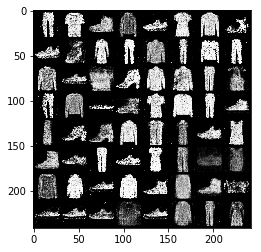

[Epoch 43/50] [Batch 401/938] [D loss: 1.332242] [G loss: 0.891231]
[Epoch 43/50] [Batch 402/938] [D loss: 1.356560] [G loss: 0.835180]
[Epoch 43/50] [Batch 403/938] [D loss: 1.280977] [G loss: 0.860127]
[Epoch 43/50] [Batch 404/938] [D loss: 1.301796] [G loss: 0.861246]
[Epoch 43/50] [Batch 405/938] [D loss: 1.265252] [G loss: 0.865092]
[Epoch 43/50] [Batch 406/938] [D loss: 1.299421] [G loss: 0.885749]
[Epoch 43/50] [Batch 407/938] [D loss: 1.265385] [G loss: 0.848727]
[Epoch 43/50] [Batch 408/938] [D loss: 1.336242] [G loss: 0.838812]
[Epoch 43/50] [Batch 409/938] [D loss: 1.252137] [G loss: 0.874131]
[Epoch 43/50] [Batch 410/938] [D loss: 1.236929] [G loss: 0.884745]
[Epoch 43/50] [Batch 411/938] [D loss: 1.226610] [G loss: 0.863146]
[Epoch 43/50] [Batch 412/938] [D loss: 1.303567] [G loss: 0.863982]
[Epoch 43/50] [Batch 413/938] [D loss: 1.220336] [G loss: 0.866630]
[Epoch 43/50] [Batch 414/938] [D loss: 1.192641] [G loss: 0.887246]
[Epoch 43/50] [Batch 415/938] [D loss: 1.243201]

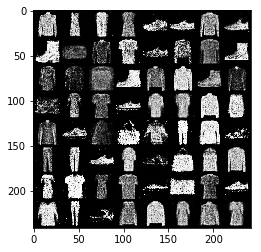

[Epoch 43/50] [Batch 601/938] [D loss: 1.251999] [G loss: 0.969547]
[Epoch 43/50] [Batch 602/938] [D loss: 1.257880] [G loss: 0.904495]
[Epoch 43/50] [Batch 603/938] [D loss: 1.261934] [G loss: 0.971531]
[Epoch 43/50] [Batch 604/938] [D loss: 1.266556] [G loss: 0.910810]
[Epoch 43/50] [Batch 605/938] [D loss: 1.250700] [G loss: 0.897809]
[Epoch 43/50] [Batch 606/938] [D loss: 1.280400] [G loss: 0.848308]
[Epoch 43/50] [Batch 607/938] [D loss: 1.326933] [G loss: 0.831796]
[Epoch 43/50] [Batch 608/938] [D loss: 1.204830] [G loss: 0.867064]
[Epoch 43/50] [Batch 609/938] [D loss: 1.283171] [G loss: 0.903467]
[Epoch 43/50] [Batch 610/938] [D loss: 1.193223] [G loss: 0.866353]
[Epoch 43/50] [Batch 611/938] [D loss: 1.202212] [G loss: 0.902708]
[Epoch 43/50] [Batch 612/938] [D loss: 1.325617] [G loss: 0.890542]
[Epoch 43/50] [Batch 613/938] [D loss: 1.271291] [G loss: 0.898808]
[Epoch 43/50] [Batch 614/938] [D loss: 1.226317] [G loss: 0.922707]
[Epoch 43/50] [Batch 615/938] [D loss: 1.266681]

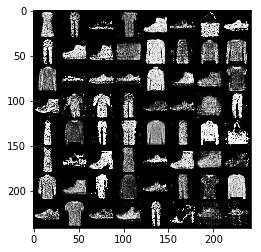

[Epoch 43/50] [Batch 801/938] [D loss: 1.326309] [G loss: 0.996264]
[Epoch 43/50] [Batch 802/938] [D loss: 1.337741] [G loss: 0.946743]
[Epoch 43/50] [Batch 803/938] [D loss: 1.335490] [G loss: 0.921924]
[Epoch 43/50] [Batch 804/938] [D loss: 1.300200] [G loss: 0.972285]
[Epoch 43/50] [Batch 805/938] [D loss: 1.319907] [G loss: 0.899892]
[Epoch 43/50] [Batch 806/938] [D loss: 1.201459] [G loss: 0.887504]
[Epoch 43/50] [Batch 807/938] [D loss: 1.339268] [G loss: 0.877041]
[Epoch 43/50] [Batch 808/938] [D loss: 1.364793] [G loss: 0.872449]
[Epoch 43/50] [Batch 809/938] [D loss: 1.217129] [G loss: 0.865646]
[Epoch 43/50] [Batch 810/938] [D loss: 1.279488] [G loss: 0.881588]
[Epoch 43/50] [Batch 811/938] [D loss: 1.251465] [G loss: 0.920575]
[Epoch 43/50] [Batch 812/938] [D loss: 1.241350] [G loss: 0.860144]
[Epoch 43/50] [Batch 813/938] [D loss: 1.269853] [G loss: 0.831495]
[Epoch 43/50] [Batch 814/938] [D loss: 1.283898] [G loss: 0.879245]
[Epoch 43/50] [Batch 815/938] [D loss: 1.284947]

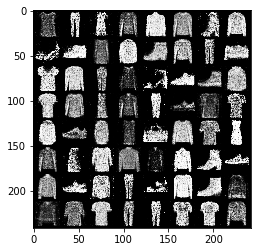

[Epoch 44/50] [Batch 1/938] [D loss: 1.204167] [G loss: 0.856947]
[Epoch 44/50] [Batch 2/938] [D loss: 1.230055] [G loss: 0.904411]
[Epoch 44/50] [Batch 3/938] [D loss: 1.353324] [G loss: 0.890083]
[Epoch 44/50] [Batch 4/938] [D loss: 1.189421] [G loss: 0.901851]
[Epoch 44/50] [Batch 5/938] [D loss: 1.342151] [G loss: 0.928751]
[Epoch 44/50] [Batch 6/938] [D loss: 1.255222] [G loss: 0.952583]
[Epoch 44/50] [Batch 7/938] [D loss: 1.293341] [G loss: 0.908325]
[Epoch 44/50] [Batch 8/938] [D loss: 1.200689] [G loss: 0.970333]
[Epoch 44/50] [Batch 9/938] [D loss: 1.265962] [G loss: 0.846631]
[Epoch 44/50] [Batch 10/938] [D loss: 1.211003] [G loss: 0.887547]
[Epoch 44/50] [Batch 11/938] [D loss: 1.285439] [G loss: 0.899366]
[Epoch 44/50] [Batch 12/938] [D loss: 1.200903] [G loss: 0.858021]
[Epoch 44/50] [Batch 13/938] [D loss: 1.173034] [G loss: 0.897367]
[Epoch 44/50] [Batch 14/938] [D loss: 1.246630] [G loss: 0.907394]
[Epoch 44/50] [Batch 15/938] [D loss: 1.349126] [G loss: 0.871708]
[Epo

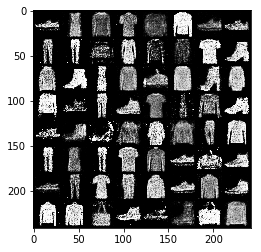

[Epoch 44/50] [Batch 201/938] [D loss: 1.232076] [G loss: 0.936424]
[Epoch 44/50] [Batch 202/938] [D loss: 1.273288] [G loss: 0.910426]
[Epoch 44/50] [Batch 203/938] [D loss: 1.244973] [G loss: 0.835638]
[Epoch 44/50] [Batch 204/938] [D loss: 1.276229] [G loss: 0.876792]
[Epoch 44/50] [Batch 205/938] [D loss: 1.189595] [G loss: 0.927276]
[Epoch 44/50] [Batch 206/938] [D loss: 1.255795] [G loss: 0.904230]
[Epoch 44/50] [Batch 207/938] [D loss: 1.216068] [G loss: 0.922966]
[Epoch 44/50] [Batch 208/938] [D loss: 1.395235] [G loss: 0.822345]
[Epoch 44/50] [Batch 209/938] [D loss: 1.133204] [G loss: 0.957724]
[Epoch 44/50] [Batch 210/938] [D loss: 1.245473] [G loss: 0.916258]
[Epoch 44/50] [Batch 211/938] [D loss: 1.313612] [G loss: 0.903746]
[Epoch 44/50] [Batch 212/938] [D loss: 1.262036] [G loss: 0.963092]
[Epoch 44/50] [Batch 213/938] [D loss: 1.196017] [G loss: 0.967932]
[Epoch 44/50] [Batch 214/938] [D loss: 1.231600] [G loss: 0.902760]
[Epoch 44/50] [Batch 215/938] [D loss: 1.244192]

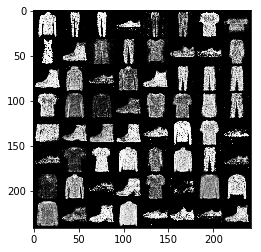

[Epoch 44/50] [Batch 401/938] [D loss: 1.268660] [G loss: 0.892323]
[Epoch 44/50] [Batch 402/938] [D loss: 1.342876] [G loss: 0.914146]
[Epoch 44/50] [Batch 403/938] [D loss: 1.208454] [G loss: 0.937358]
[Epoch 44/50] [Batch 404/938] [D loss: 1.191383] [G loss: 0.977767]
[Epoch 44/50] [Batch 405/938] [D loss: 1.242448] [G loss: 0.964642]
[Epoch 44/50] [Batch 406/938] [D loss: 1.314657] [G loss: 0.951574]
[Epoch 44/50] [Batch 407/938] [D loss: 1.288111] [G loss: 0.944937]
[Epoch 44/50] [Batch 408/938] [D loss: 1.242303] [G loss: 0.917715]
[Epoch 44/50] [Batch 409/938] [D loss: 1.275515] [G loss: 0.886753]
[Epoch 44/50] [Batch 410/938] [D loss: 1.200168] [G loss: 0.854389]
[Epoch 44/50] [Batch 411/938] [D loss: 1.166942] [G loss: 0.931819]
[Epoch 44/50] [Batch 412/938] [D loss: 1.201140] [G loss: 0.897979]
[Epoch 44/50] [Batch 413/938] [D loss: 1.443200] [G loss: 0.916252]
[Epoch 44/50] [Batch 414/938] [D loss: 1.274726] [G loss: 0.914810]
[Epoch 44/50] [Batch 415/938] [D loss: 1.254950]

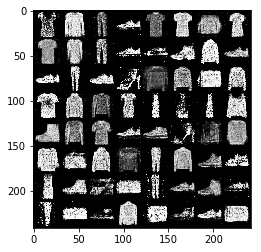

[Epoch 44/50] [Batch 601/938] [D loss: 1.262924] [G loss: 0.915750]
[Epoch 44/50] [Batch 602/938] [D loss: 1.240757] [G loss: 0.881566]
[Epoch 44/50] [Batch 603/938] [D loss: 1.290815] [G loss: 0.870614]
[Epoch 44/50] [Batch 604/938] [D loss: 1.210036] [G loss: 0.889691]
[Epoch 44/50] [Batch 605/938] [D loss: 1.208830] [G loss: 0.854187]
[Epoch 44/50] [Batch 606/938] [D loss: 1.325999] [G loss: 0.870529]
[Epoch 44/50] [Batch 607/938] [D loss: 1.297718] [G loss: 0.892487]
[Epoch 44/50] [Batch 608/938] [D loss: 1.263522] [G loss: 0.892548]
[Epoch 44/50] [Batch 609/938] [D loss: 1.315455] [G loss: 0.849676]
[Epoch 44/50] [Batch 610/938] [D loss: 1.310884] [G loss: 0.884471]
[Epoch 44/50] [Batch 611/938] [D loss: 1.219745] [G loss: 0.917156]
[Epoch 44/50] [Batch 612/938] [D loss: 1.276504] [G loss: 0.927292]
[Epoch 44/50] [Batch 613/938] [D loss: 1.227944] [G loss: 0.850483]
[Epoch 44/50] [Batch 614/938] [D loss: 1.300388] [G loss: 0.809477]
[Epoch 44/50] [Batch 615/938] [D loss: 1.325947]

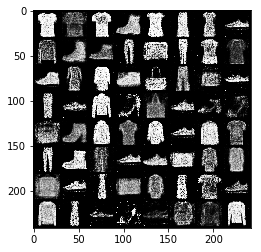

[Epoch 44/50] [Batch 801/938] [D loss: 1.246338] [G loss: 0.880435]
[Epoch 44/50] [Batch 802/938] [D loss: 1.263067] [G loss: 0.845617]
[Epoch 44/50] [Batch 803/938] [D loss: 1.204991] [G loss: 0.847489]
[Epoch 44/50] [Batch 804/938] [D loss: 1.257700] [G loss: 0.841316]
[Epoch 44/50] [Batch 805/938] [D loss: 1.246017] [G loss: 0.862009]
[Epoch 44/50] [Batch 806/938] [D loss: 1.244841] [G loss: 0.866972]
[Epoch 44/50] [Batch 807/938] [D loss: 1.362326] [G loss: 0.866622]
[Epoch 44/50] [Batch 808/938] [D loss: 1.237112] [G loss: 0.879719]
[Epoch 44/50] [Batch 809/938] [D loss: 1.273724] [G loss: 0.806330]
[Epoch 44/50] [Batch 810/938] [D loss: 1.245378] [G loss: 0.844742]
[Epoch 44/50] [Batch 811/938] [D loss: 1.242331] [G loss: 0.820616]
[Epoch 44/50] [Batch 812/938] [D loss: 1.220485] [G loss: 0.817578]
[Epoch 44/50] [Batch 813/938] [D loss: 1.321091] [G loss: 0.844948]
[Epoch 44/50] [Batch 814/938] [D loss: 1.272801] [G loss: 0.923230]
[Epoch 44/50] [Batch 815/938] [D loss: 1.340278]

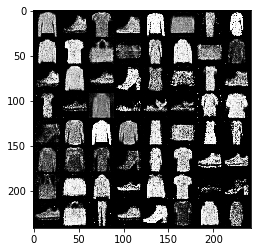

[Epoch 45/50] [Batch 1/938] [D loss: 1.225713] [G loss: 0.841254]
[Epoch 45/50] [Batch 2/938] [D loss: 1.260233] [G loss: 0.891090]
[Epoch 45/50] [Batch 3/938] [D loss: 1.289821] [G loss: 0.816357]
[Epoch 45/50] [Batch 4/938] [D loss: 1.293774] [G loss: 0.894971]
[Epoch 45/50] [Batch 5/938] [D loss: 1.271598] [G loss: 0.897156]
[Epoch 45/50] [Batch 6/938] [D loss: 1.183328] [G loss: 0.863825]
[Epoch 45/50] [Batch 7/938] [D loss: 1.271235] [G loss: 0.875559]
[Epoch 45/50] [Batch 8/938] [D loss: 1.313707] [G loss: 0.860906]
[Epoch 45/50] [Batch 9/938] [D loss: 1.191418] [G loss: 0.893139]
[Epoch 45/50] [Batch 10/938] [D loss: 1.371729] [G loss: 0.867969]
[Epoch 45/50] [Batch 11/938] [D loss: 1.201800] [G loss: 0.927314]
[Epoch 45/50] [Batch 12/938] [D loss: 1.268328] [G loss: 0.937195]
[Epoch 45/50] [Batch 13/938] [D loss: 1.279741] [G loss: 0.871237]
[Epoch 45/50] [Batch 14/938] [D loss: 1.284064] [G loss: 0.871215]
[Epoch 45/50] [Batch 15/938] [D loss: 1.241070] [G loss: 0.854286]
[Epo

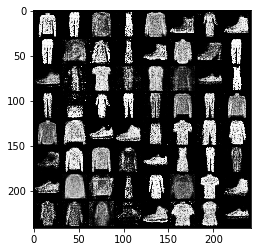

[Epoch 45/50] [Batch 201/938] [D loss: 1.259633] [G loss: 0.916995]
[Epoch 45/50] [Batch 202/938] [D loss: 1.244506] [G loss: 0.878347]
[Epoch 45/50] [Batch 203/938] [D loss: 1.268634] [G loss: 0.880930]
[Epoch 45/50] [Batch 204/938] [D loss: 1.268204] [G loss: 0.910038]
[Epoch 45/50] [Batch 205/938] [D loss: 1.231017] [G loss: 0.898225]
[Epoch 45/50] [Batch 206/938] [D loss: 1.269077] [G loss: 0.917149]
[Epoch 45/50] [Batch 207/938] [D loss: 1.262472] [G loss: 0.804237]
[Epoch 45/50] [Batch 208/938] [D loss: 1.273347] [G loss: 0.968307]
[Epoch 45/50] [Batch 209/938] [D loss: 1.223737] [G loss: 0.896115]
[Epoch 45/50] [Batch 210/938] [D loss: 1.300273] [G loss: 0.953628]
[Epoch 45/50] [Batch 211/938] [D loss: 1.275586] [G loss: 0.901933]
[Epoch 45/50] [Batch 212/938] [D loss: 1.235595] [G loss: 0.903140]
[Epoch 45/50] [Batch 213/938] [D loss: 1.261205] [G loss: 0.927117]
[Epoch 45/50] [Batch 214/938] [D loss: 1.257026] [G loss: 0.856640]
[Epoch 45/50] [Batch 215/938] [D loss: 1.216009]

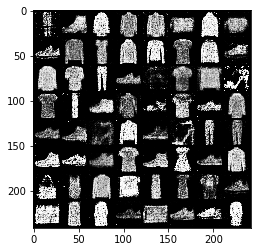

[Epoch 45/50] [Batch 401/938] [D loss: 1.246138] [G loss: 0.920940]
[Epoch 45/50] [Batch 402/938] [D loss: 1.307044] [G loss: 0.841331]
[Epoch 45/50] [Batch 403/938] [D loss: 1.397146] [G loss: 0.886744]
[Epoch 45/50] [Batch 404/938] [D loss: 1.272273] [G loss: 0.841143]
[Epoch 45/50] [Batch 405/938] [D loss: 1.200581] [G loss: 0.870160]
[Epoch 45/50] [Batch 406/938] [D loss: 1.260496] [G loss: 0.911322]
[Epoch 45/50] [Batch 407/938] [D loss: 1.312272] [G loss: 0.853363]
[Epoch 45/50] [Batch 408/938] [D loss: 1.273967] [G loss: 0.878849]
[Epoch 45/50] [Batch 409/938] [D loss: 1.301540] [G loss: 0.912611]
[Epoch 45/50] [Batch 410/938] [D loss: 1.150494] [G loss: 0.840023]
[Epoch 45/50] [Batch 411/938] [D loss: 1.205363] [G loss: 0.854595]
[Epoch 45/50] [Batch 412/938] [D loss: 1.229439] [G loss: 0.836958]
[Epoch 45/50] [Batch 413/938] [D loss: 1.313016] [G loss: 0.923197]
[Epoch 45/50] [Batch 414/938] [D loss: 1.225481] [G loss: 0.858349]
[Epoch 45/50] [Batch 415/938] [D loss: 1.349584]

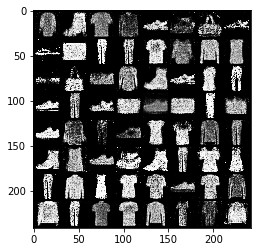

[Epoch 45/50] [Batch 601/938] [D loss: 1.286689] [G loss: 0.794812]
[Epoch 45/50] [Batch 602/938] [D loss: 1.193625] [G loss: 0.912135]
[Epoch 45/50] [Batch 603/938] [D loss: 1.282789] [G loss: 0.822079]
[Epoch 45/50] [Batch 604/938] [D loss: 1.264597] [G loss: 0.847990]
[Epoch 45/50] [Batch 605/938] [D loss: 1.289379] [G loss: 0.880453]
[Epoch 45/50] [Batch 606/938] [D loss: 1.252632] [G loss: 0.893050]
[Epoch 45/50] [Batch 607/938] [D loss: 1.257567] [G loss: 0.942624]
[Epoch 45/50] [Batch 608/938] [D loss: 1.268870] [G loss: 0.868801]
[Epoch 45/50] [Batch 609/938] [D loss: 1.263853] [G loss: 0.845058]
[Epoch 45/50] [Batch 610/938] [D loss: 1.232897] [G loss: 0.863548]
[Epoch 45/50] [Batch 611/938] [D loss: 1.284940] [G loss: 0.875051]
[Epoch 45/50] [Batch 612/938] [D loss: 1.252550] [G loss: 0.892807]
[Epoch 45/50] [Batch 613/938] [D loss: 1.290129] [G loss: 0.874628]
[Epoch 45/50] [Batch 614/938] [D loss: 1.319394] [G loss: 0.854758]
[Epoch 45/50] [Batch 615/938] [D loss: 1.187983]

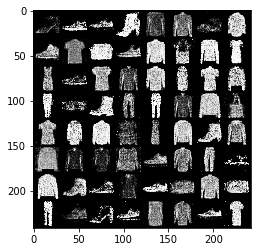

[Epoch 45/50] [Batch 801/938] [D loss: 1.195401] [G loss: 0.895455]
[Epoch 45/50] [Batch 802/938] [D loss: 1.236533] [G loss: 0.891654]
[Epoch 45/50] [Batch 803/938] [D loss: 1.309432] [G loss: 0.848230]
[Epoch 45/50] [Batch 804/938] [D loss: 1.306825] [G loss: 0.845965]
[Epoch 45/50] [Batch 805/938] [D loss: 1.294881] [G loss: 0.867539]
[Epoch 45/50] [Batch 806/938] [D loss: 1.246208] [G loss: 0.877915]
[Epoch 45/50] [Batch 807/938] [D loss: 1.267594] [G loss: 0.856065]
[Epoch 45/50] [Batch 808/938] [D loss: 1.292777] [G loss: 0.858579]
[Epoch 45/50] [Batch 809/938] [D loss: 1.254011] [G loss: 0.833896]
[Epoch 45/50] [Batch 810/938] [D loss: 1.296954] [G loss: 0.843126]
[Epoch 45/50] [Batch 811/938] [D loss: 1.272909] [G loss: 0.899244]
[Epoch 45/50] [Batch 812/938] [D loss: 1.350774] [G loss: 0.856773]
[Epoch 45/50] [Batch 813/938] [D loss: 1.131509] [G loss: 0.890793]
[Epoch 45/50] [Batch 814/938] [D loss: 1.283745] [G loss: 0.809652]
[Epoch 45/50] [Batch 815/938] [D loss: 1.276087]

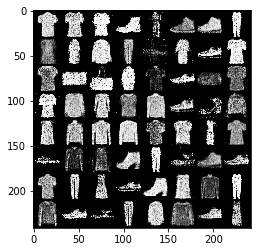

[Epoch 46/50] [Batch 1/938] [D loss: 1.331007] [G loss: 0.885253]
[Epoch 46/50] [Batch 2/938] [D loss: 1.235073] [G loss: 0.921189]
[Epoch 46/50] [Batch 3/938] [D loss: 1.205179] [G loss: 0.869418]
[Epoch 46/50] [Batch 4/938] [D loss: 1.247711] [G loss: 0.874599]
[Epoch 46/50] [Batch 5/938] [D loss: 1.269392] [G loss: 0.879283]
[Epoch 46/50] [Batch 6/938] [D loss: 1.286721] [G loss: 0.891672]
[Epoch 46/50] [Batch 7/938] [D loss: 1.291585] [G loss: 0.983278]
[Epoch 46/50] [Batch 8/938] [D loss: 1.369434] [G loss: 0.884707]
[Epoch 46/50] [Batch 9/938] [D loss: 1.253314] [G loss: 0.904139]
[Epoch 46/50] [Batch 10/938] [D loss: 1.212472] [G loss: 0.897735]
[Epoch 46/50] [Batch 11/938] [D loss: 1.215760] [G loss: 0.935002]
[Epoch 46/50] [Batch 12/938] [D loss: 1.167503] [G loss: 0.885749]
[Epoch 46/50] [Batch 13/938] [D loss: 1.273063] [G loss: 0.921291]
[Epoch 46/50] [Batch 14/938] [D loss: 1.272547] [G loss: 0.895335]
[Epoch 46/50] [Batch 15/938] [D loss: 1.121618] [G loss: 0.911813]
[Epo

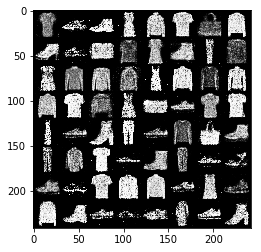

[Epoch 46/50] [Batch 201/938] [D loss: 1.213488] [G loss: 0.953642]
[Epoch 46/50] [Batch 202/938] [D loss: 1.415328] [G loss: 0.905650]
[Epoch 46/50] [Batch 203/938] [D loss: 1.339069] [G loss: 0.907074]
[Epoch 46/50] [Batch 204/938] [D loss: 1.248603] [G loss: 0.866719]
[Epoch 46/50] [Batch 205/938] [D loss: 1.255016] [G loss: 0.927831]
[Epoch 46/50] [Batch 206/938] [D loss: 1.300267] [G loss: 0.909203]
[Epoch 46/50] [Batch 207/938] [D loss: 1.312068] [G loss: 0.891466]
[Epoch 46/50] [Batch 208/938] [D loss: 1.242907] [G loss: 0.937520]
[Epoch 46/50] [Batch 209/938] [D loss: 1.315893] [G loss: 0.861043]
[Epoch 46/50] [Batch 210/938] [D loss: 1.214426] [G loss: 0.885397]
[Epoch 46/50] [Batch 211/938] [D loss: 1.224512] [G loss: 0.883836]
[Epoch 46/50] [Batch 212/938] [D loss: 1.242986] [G loss: 0.930741]
[Epoch 46/50] [Batch 213/938] [D loss: 1.255967] [G loss: 0.874761]
[Epoch 46/50] [Batch 214/938] [D loss: 1.231193] [G loss: 0.925980]
[Epoch 46/50] [Batch 215/938] [D loss: 1.313480]

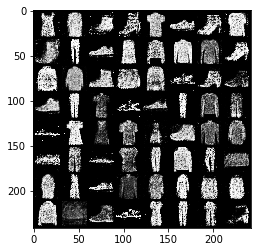

[Epoch 46/50] [Batch 401/938] [D loss: 1.321221] [G loss: 0.923348]
[Epoch 46/50] [Batch 402/938] [D loss: 1.317707] [G loss: 0.910849]
[Epoch 46/50] [Batch 403/938] [D loss: 1.281395] [G loss: 0.976919]
[Epoch 46/50] [Batch 404/938] [D loss: 1.337482] [G loss: 0.951260]
[Epoch 46/50] [Batch 405/938] [D loss: 1.266833] [G loss: 0.874082]
[Epoch 46/50] [Batch 406/938] [D loss: 1.344625] [G loss: 0.907055]
[Epoch 46/50] [Batch 407/938] [D loss: 1.215279] [G loss: 0.939071]
[Epoch 46/50] [Batch 408/938] [D loss: 1.202463] [G loss: 0.890063]
[Epoch 46/50] [Batch 409/938] [D loss: 1.378228] [G loss: 0.893816]
[Epoch 46/50] [Batch 410/938] [D loss: 1.097246] [G loss: 0.903303]
[Epoch 46/50] [Batch 411/938] [D loss: 1.333554] [G loss: 0.887814]
[Epoch 46/50] [Batch 412/938] [D loss: 1.194813] [G loss: 0.994654]
[Epoch 46/50] [Batch 413/938] [D loss: 1.202602] [G loss: 0.846066]
[Epoch 46/50] [Batch 414/938] [D loss: 1.250540] [G loss: 0.866690]
[Epoch 46/50] [Batch 415/938] [D loss: 1.158622]

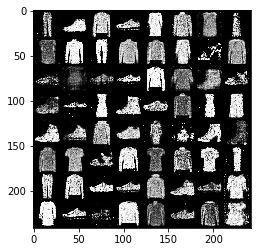

[Epoch 46/50] [Batch 601/938] [D loss: 1.214206] [G loss: 0.836460]
[Epoch 46/50] [Batch 602/938] [D loss: 1.212110] [G loss: 0.878604]
[Epoch 46/50] [Batch 603/938] [D loss: 1.229154] [G loss: 0.881643]
[Epoch 46/50] [Batch 604/938] [D loss: 1.287821] [G loss: 0.908706]
[Epoch 46/50] [Batch 605/938] [D loss: 1.206727] [G loss: 0.931934]
[Epoch 46/50] [Batch 606/938] [D loss: 1.237295] [G loss: 0.882951]
[Epoch 46/50] [Batch 607/938] [D loss: 1.264354] [G loss: 0.822577]
[Epoch 46/50] [Batch 608/938] [D loss: 1.300014] [G loss: 0.857058]
[Epoch 46/50] [Batch 609/938] [D loss: 1.217602] [G loss: 0.932596]
[Epoch 46/50] [Batch 610/938] [D loss: 1.262216] [G loss: 0.923738]
[Epoch 46/50] [Batch 611/938] [D loss: 1.342201] [G loss: 0.872916]
[Epoch 46/50] [Batch 612/938] [D loss: 1.179298] [G loss: 0.976651]
[Epoch 46/50] [Batch 613/938] [D loss: 1.163418] [G loss: 0.919892]
[Epoch 46/50] [Batch 614/938] [D loss: 1.268839] [G loss: 0.867208]
[Epoch 46/50] [Batch 615/938] [D loss: 1.210028]

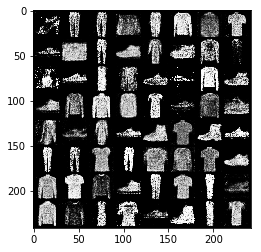

[Epoch 46/50] [Batch 801/938] [D loss: 1.246403] [G loss: 0.896748]
[Epoch 46/50] [Batch 802/938] [D loss: 1.267371] [G loss: 0.862215]
[Epoch 46/50] [Batch 803/938] [D loss: 1.230301] [G loss: 0.934579]
[Epoch 46/50] [Batch 804/938] [D loss: 1.228981] [G loss: 0.930505]
[Epoch 46/50] [Batch 805/938] [D loss: 1.223046] [G loss: 0.886548]
[Epoch 46/50] [Batch 806/938] [D loss: 1.268309] [G loss: 0.860875]
[Epoch 46/50] [Batch 807/938] [D loss: 1.284571] [G loss: 0.933390]
[Epoch 46/50] [Batch 808/938] [D loss: 1.223745] [G loss: 0.904953]
[Epoch 46/50] [Batch 809/938] [D loss: 1.269505] [G loss: 0.932777]
[Epoch 46/50] [Batch 810/938] [D loss: 1.189292] [G loss: 0.882340]
[Epoch 46/50] [Batch 811/938] [D loss: 1.252420] [G loss: 0.871213]
[Epoch 46/50] [Batch 812/938] [D loss: 1.336813] [G loss: 0.857570]
[Epoch 46/50] [Batch 813/938] [D loss: 1.268591] [G loss: 0.890249]
[Epoch 46/50] [Batch 814/938] [D loss: 1.201088] [G loss: 0.958571]
[Epoch 46/50] [Batch 815/938] [D loss: 1.250447]

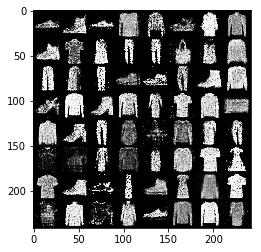

[Epoch 47/50] [Batch 1/938] [D loss: 1.150130] [G loss: 0.914838]
[Epoch 47/50] [Batch 2/938] [D loss: 1.354363] [G loss: 0.877979]
[Epoch 47/50] [Batch 3/938] [D loss: 1.125843] [G loss: 0.870660]
[Epoch 47/50] [Batch 4/938] [D loss: 1.090956] [G loss: 0.942880]
[Epoch 47/50] [Batch 5/938] [D loss: 1.329408] [G loss: 0.949066]
[Epoch 47/50] [Batch 6/938] [D loss: 1.233162] [G loss: 0.932267]
[Epoch 47/50] [Batch 7/938] [D loss: 1.250768] [G loss: 0.940661]
[Epoch 47/50] [Batch 8/938] [D loss: 1.230584] [G loss: 0.901986]
[Epoch 47/50] [Batch 9/938] [D loss: 1.247913] [G loss: 0.971620]
[Epoch 47/50] [Batch 10/938] [D loss: 1.251642] [G loss: 0.954222]
[Epoch 47/50] [Batch 11/938] [D loss: 1.230977] [G loss: 0.951703]
[Epoch 47/50] [Batch 12/938] [D loss: 1.254219] [G loss: 0.930358]
[Epoch 47/50] [Batch 13/938] [D loss: 1.216884] [G loss: 0.950898]
[Epoch 47/50] [Batch 14/938] [D loss: 1.288023] [G loss: 0.981593]
[Epoch 47/50] [Batch 15/938] [D loss: 1.194775] [G loss: 0.874430]
[Epo

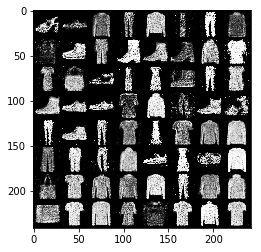

[Epoch 47/50] [Batch 201/938] [D loss: 1.319764] [G loss: 0.864714]
[Epoch 47/50] [Batch 202/938] [D loss: 1.296519] [G loss: 0.960782]
[Epoch 47/50] [Batch 203/938] [D loss: 1.124370] [G loss: 0.911621]
[Epoch 47/50] [Batch 204/938] [D loss: 1.138083] [G loss: 0.912923]
[Epoch 47/50] [Batch 205/938] [D loss: 1.198869] [G loss: 0.927281]
[Epoch 47/50] [Batch 206/938] [D loss: 1.349294] [G loss: 0.916433]
[Epoch 47/50] [Batch 207/938] [D loss: 1.313984] [G loss: 0.934276]
[Epoch 47/50] [Batch 208/938] [D loss: 1.071763] [G loss: 0.854493]
[Epoch 47/50] [Batch 209/938] [D loss: 1.221410] [G loss: 0.975922]
[Epoch 47/50] [Batch 210/938] [D loss: 1.288020] [G loss: 0.950553]
[Epoch 47/50] [Batch 211/938] [D loss: 1.188838] [G loss: 0.938889]
[Epoch 47/50] [Batch 212/938] [D loss: 1.180803] [G loss: 0.956089]
[Epoch 47/50] [Batch 213/938] [D loss: 1.339363] [G loss: 0.873218]
[Epoch 47/50] [Batch 214/938] [D loss: 1.326181] [G loss: 0.934103]
[Epoch 47/50] [Batch 215/938] [D loss: 1.262314]

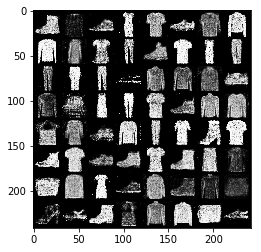

[Epoch 47/50] [Batch 401/938] [D loss: 1.190573] [G loss: 0.920739]
[Epoch 47/50] [Batch 402/938] [D loss: 1.210124] [G loss: 0.843327]
[Epoch 47/50] [Batch 403/938] [D loss: 1.288492] [G loss: 0.905237]
[Epoch 47/50] [Batch 404/938] [D loss: 1.311217] [G loss: 0.913747]
[Epoch 47/50] [Batch 405/938] [D loss: 1.212832] [G loss: 0.873146]
[Epoch 47/50] [Batch 406/938] [D loss: 1.312739] [G loss: 0.864169]
[Epoch 47/50] [Batch 407/938] [D loss: 1.353668] [G loss: 0.893188]
[Epoch 47/50] [Batch 408/938] [D loss: 1.250882] [G loss: 0.971962]
[Epoch 47/50] [Batch 409/938] [D loss: 1.282799] [G loss: 0.907220]
[Epoch 47/50] [Batch 410/938] [D loss: 1.258289] [G loss: 0.917904]
[Epoch 47/50] [Batch 411/938] [D loss: 1.229753] [G loss: 0.918134]
[Epoch 47/50] [Batch 412/938] [D loss: 1.265472] [G loss: 0.876249]
[Epoch 47/50] [Batch 413/938] [D loss: 1.281798] [G loss: 0.815697]
[Epoch 47/50] [Batch 414/938] [D loss: 1.328910] [G loss: 0.859119]
[Epoch 47/50] [Batch 415/938] [D loss: 1.169701]

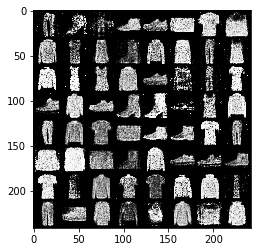

[Epoch 47/50] [Batch 601/938] [D loss: 1.288927] [G loss: 0.952176]
[Epoch 47/50] [Batch 602/938] [D loss: 1.203770] [G loss: 0.912896]
[Epoch 47/50] [Batch 603/938] [D loss: 1.215971] [G loss: 0.888203]
[Epoch 47/50] [Batch 604/938] [D loss: 1.294746] [G loss: 0.860541]
[Epoch 47/50] [Batch 605/938] [D loss: 1.292660] [G loss: 0.849212]
[Epoch 47/50] [Batch 606/938] [D loss: 1.187192] [G loss: 0.865385]
[Epoch 47/50] [Batch 607/938] [D loss: 1.159712] [G loss: 0.912588]
[Epoch 47/50] [Batch 608/938] [D loss: 1.149226] [G loss: 0.993215]
[Epoch 47/50] [Batch 609/938] [D loss: 1.202106] [G loss: 0.869824]
[Epoch 47/50] [Batch 610/938] [D loss: 1.265256] [G loss: 0.895830]
[Epoch 47/50] [Batch 611/938] [D loss: 1.275872] [G loss: 0.954022]
[Epoch 47/50] [Batch 612/938] [D loss: 1.258489] [G loss: 0.875909]
[Epoch 47/50] [Batch 613/938] [D loss: 1.293967] [G loss: 0.850859]
[Epoch 47/50] [Batch 614/938] [D loss: 1.211896] [G loss: 0.881509]
[Epoch 47/50] [Batch 615/938] [D loss: 1.252129]

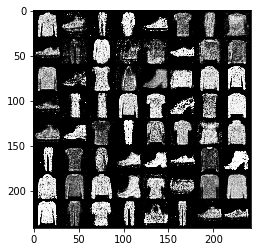

[Epoch 47/50] [Batch 801/938] [D loss: 1.270555] [G loss: 0.978089]
[Epoch 47/50] [Batch 802/938] [D loss: 1.243642] [G loss: 0.981967]
[Epoch 47/50] [Batch 803/938] [D loss: 1.224939] [G loss: 0.942297]
[Epoch 47/50] [Batch 804/938] [D loss: 1.278286] [G loss: 0.892533]
[Epoch 47/50] [Batch 805/938] [D loss: 1.377856] [G loss: 0.864693]
[Epoch 47/50] [Batch 806/938] [D loss: 1.321336] [G loss: 0.979000]
[Epoch 47/50] [Batch 807/938] [D loss: 1.217735] [G loss: 0.943593]
[Epoch 47/50] [Batch 808/938] [D loss: 1.214365] [G loss: 0.962740]
[Epoch 47/50] [Batch 809/938] [D loss: 1.270220] [G loss: 0.885355]
[Epoch 47/50] [Batch 810/938] [D loss: 1.317957] [G loss: 0.865665]
[Epoch 47/50] [Batch 811/938] [D loss: 1.185058] [G loss: 0.878213]
[Epoch 47/50] [Batch 812/938] [D loss: 1.311922] [G loss: 0.875945]
[Epoch 47/50] [Batch 813/938] [D loss: 1.273328] [G loss: 0.889686]
[Epoch 47/50] [Batch 814/938] [D loss: 1.271051] [G loss: 0.913149]
[Epoch 47/50] [Batch 815/938] [D loss: 1.350066]

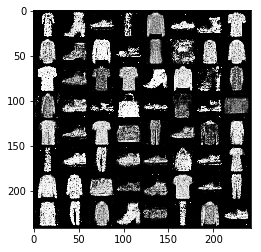

[Epoch 48/50] [Batch 1/938] [D loss: 1.205323] [G loss: 0.931723]
[Epoch 48/50] [Batch 2/938] [D loss: 1.187728] [G loss: 0.923403]
[Epoch 48/50] [Batch 3/938] [D loss: 1.375994] [G loss: 0.876387]
[Epoch 48/50] [Batch 4/938] [D loss: 1.296620] [G loss: 0.906747]
[Epoch 48/50] [Batch 5/938] [D loss: 1.324919] [G loss: 0.899947]
[Epoch 48/50] [Batch 6/938] [D loss: 1.186881] [G loss: 0.879185]
[Epoch 48/50] [Batch 7/938] [D loss: 1.181289] [G loss: 0.947346]
[Epoch 48/50] [Batch 8/938] [D loss: 1.259401] [G loss: 0.868197]
[Epoch 48/50] [Batch 9/938] [D loss: 1.209929] [G loss: 0.909900]
[Epoch 48/50] [Batch 10/938] [D loss: 1.404055] [G loss: 0.936473]
[Epoch 48/50] [Batch 11/938] [D loss: 1.312853] [G loss: 0.929558]
[Epoch 48/50] [Batch 12/938] [D loss: 1.362198] [G loss: 0.963728]
[Epoch 48/50] [Batch 13/938] [D loss: 1.251004] [G loss: 0.959673]
[Epoch 48/50] [Batch 14/938] [D loss: 1.358081] [G loss: 0.883819]
[Epoch 48/50] [Batch 15/938] [D loss: 1.279773] [G loss: 0.913079]
[Epo

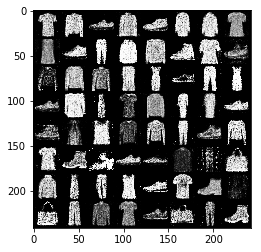

[Epoch 48/50] [Batch 201/938] [D loss: 1.332942] [G loss: 0.940669]
[Epoch 48/50] [Batch 202/938] [D loss: 1.252012] [G loss: 0.960778]
[Epoch 48/50] [Batch 203/938] [D loss: 1.169439] [G loss: 0.901810]
[Epoch 48/50] [Batch 204/938] [D loss: 1.208626] [G loss: 0.865619]
[Epoch 48/50] [Batch 205/938] [D loss: 1.286823] [G loss: 0.866286]
[Epoch 48/50] [Batch 206/938] [D loss: 1.213439] [G loss: 0.921450]
[Epoch 48/50] [Batch 207/938] [D loss: 1.294376] [G loss: 0.909162]
[Epoch 48/50] [Batch 208/938] [D loss: 1.297475] [G loss: 0.897622]
[Epoch 48/50] [Batch 209/938] [D loss: 1.265528] [G loss: 0.906146]
[Epoch 48/50] [Batch 210/938] [D loss: 1.245953] [G loss: 0.946924]
[Epoch 48/50] [Batch 211/938] [D loss: 1.150960] [G loss: 0.988681]
[Epoch 48/50] [Batch 212/938] [D loss: 1.209951] [G loss: 0.902991]
[Epoch 48/50] [Batch 213/938] [D loss: 1.283894] [G loss: 0.870647]
[Epoch 48/50] [Batch 214/938] [D loss: 1.309031] [G loss: 0.886549]
[Epoch 48/50] [Batch 215/938] [D loss: 1.237213]

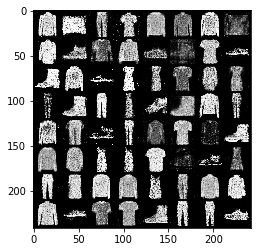

[Epoch 48/50] [Batch 401/938] [D loss: 1.221134] [G loss: 0.903676]
[Epoch 48/50] [Batch 402/938] [D loss: 1.306973] [G loss: 0.890667]
[Epoch 48/50] [Batch 403/938] [D loss: 1.345648] [G loss: 0.869139]
[Epoch 48/50] [Batch 404/938] [D loss: 1.308959] [G loss: 0.899568]
[Epoch 48/50] [Batch 405/938] [D loss: 1.213538] [G loss: 0.894965]
[Epoch 48/50] [Batch 406/938] [D loss: 1.339421] [G loss: 0.927406]
[Epoch 48/50] [Batch 407/938] [D loss: 1.222525] [G loss: 0.864728]
[Epoch 48/50] [Batch 408/938] [D loss: 1.186806] [G loss: 0.920843]
[Epoch 48/50] [Batch 409/938] [D loss: 1.316417] [G loss: 0.895532]
[Epoch 48/50] [Batch 410/938] [D loss: 1.176146] [G loss: 0.858951]
[Epoch 48/50] [Batch 411/938] [D loss: 1.349977] [G loss: 0.847152]
[Epoch 48/50] [Batch 412/938] [D loss: 1.281548] [G loss: 0.874578]
[Epoch 48/50] [Batch 413/938] [D loss: 1.239647] [G loss: 0.889441]
[Epoch 48/50] [Batch 414/938] [D loss: 1.160494] [G loss: 0.945798]
[Epoch 48/50] [Batch 415/938] [D loss: 1.208619]

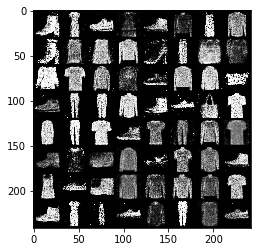

[Epoch 48/50] [Batch 601/938] [D loss: 1.325704] [G loss: 0.910992]
[Epoch 48/50] [Batch 602/938] [D loss: 1.207048] [G loss: 0.907594]
[Epoch 48/50] [Batch 603/938] [D loss: 1.213240] [G loss: 0.930757]
[Epoch 48/50] [Batch 604/938] [D loss: 1.306129] [G loss: 0.938190]
[Epoch 48/50] [Batch 605/938] [D loss: 1.242873] [G loss: 0.922292]
[Epoch 48/50] [Batch 606/938] [D loss: 1.263397] [G loss: 0.899098]
[Epoch 48/50] [Batch 607/938] [D loss: 1.223689] [G loss: 0.933537]
[Epoch 48/50] [Batch 608/938] [D loss: 1.211409] [G loss: 0.905559]
[Epoch 48/50] [Batch 609/938] [D loss: 1.230603] [G loss: 0.849016]
[Epoch 48/50] [Batch 610/938] [D loss: 1.244640] [G loss: 0.907221]
[Epoch 48/50] [Batch 611/938] [D loss: 1.189713] [G loss: 0.902732]
[Epoch 48/50] [Batch 612/938] [D loss: 1.345477] [G loss: 0.952951]
[Epoch 48/50] [Batch 613/938] [D loss: 1.262124] [G loss: 0.979550]
[Epoch 48/50] [Batch 614/938] [D loss: 1.259324] [G loss: 0.979272]
[Epoch 48/50] [Batch 615/938] [D loss: 1.365617]

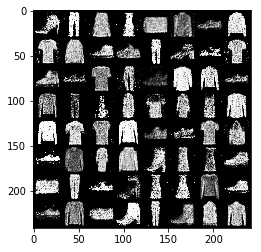

[Epoch 48/50] [Batch 801/938] [D loss: 1.298617] [G loss: 0.844685]
[Epoch 48/50] [Batch 802/938] [D loss: 1.331899] [G loss: 0.930852]
[Epoch 48/50] [Batch 803/938] [D loss: 1.441981] [G loss: 0.877135]
[Epoch 48/50] [Batch 804/938] [D loss: 1.253620] [G loss: 0.991304]
[Epoch 48/50] [Batch 805/938] [D loss: 1.295535] [G loss: 0.877018]
[Epoch 48/50] [Batch 806/938] [D loss: 1.318517] [G loss: 0.907604]
[Epoch 48/50] [Batch 807/938] [D loss: 1.284063] [G loss: 0.894233]
[Epoch 48/50] [Batch 808/938] [D loss: 1.268034] [G loss: 0.911184]
[Epoch 48/50] [Batch 809/938] [D loss: 1.198662] [G loss: 0.863722]
[Epoch 48/50] [Batch 810/938] [D loss: 1.308511] [G loss: 0.926383]
[Epoch 48/50] [Batch 811/938] [D loss: 1.270605] [G loss: 0.877564]
[Epoch 48/50] [Batch 812/938] [D loss: 1.218663] [G loss: 0.923139]
[Epoch 48/50] [Batch 813/938] [D loss: 1.245737] [G loss: 0.904482]
[Epoch 48/50] [Batch 814/938] [D loss: 1.310097] [G loss: 0.911670]
[Epoch 48/50] [Batch 815/938] [D loss: 1.216622]

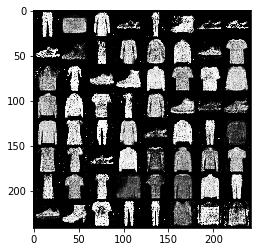

[Epoch 49/50] [Batch 1/938] [D loss: 1.270731] [G loss: 0.915450]
[Epoch 49/50] [Batch 2/938] [D loss: 1.323751] [G loss: 0.857750]
[Epoch 49/50] [Batch 3/938] [D loss: 1.268438] [G loss: 0.865593]
[Epoch 49/50] [Batch 4/938] [D loss: 1.268871] [G loss: 0.899097]
[Epoch 49/50] [Batch 5/938] [D loss: 1.266245] [G loss: 0.817041]
[Epoch 49/50] [Batch 6/938] [D loss: 1.198838] [G loss: 0.894819]
[Epoch 49/50] [Batch 7/938] [D loss: 1.232450] [G loss: 0.910332]
[Epoch 49/50] [Batch 8/938] [D loss: 1.156836] [G loss: 0.883544]
[Epoch 49/50] [Batch 9/938] [D loss: 1.319060] [G loss: 0.846539]
[Epoch 49/50] [Batch 10/938] [D loss: 1.222745] [G loss: 0.876145]
[Epoch 49/50] [Batch 11/938] [D loss: 1.307892] [G loss: 0.890575]
[Epoch 49/50] [Batch 12/938] [D loss: 1.263151] [G loss: 0.866244]
[Epoch 49/50] [Batch 13/938] [D loss: 1.267641] [G loss: 0.903895]
[Epoch 49/50] [Batch 14/938] [D loss: 1.263173] [G loss: 0.958026]
[Epoch 49/50] [Batch 15/938] [D loss: 1.233979] [G loss: 1.019696]
[Epo

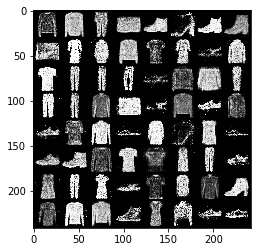

[Epoch 49/50] [Batch 201/938] [D loss: 1.190079] [G loss: 0.923336]
[Epoch 49/50] [Batch 202/938] [D loss: 1.124377] [G loss: 0.932133]
[Epoch 49/50] [Batch 203/938] [D loss: 1.199922] [G loss: 0.955141]
[Epoch 49/50] [Batch 204/938] [D loss: 1.219222] [G loss: 0.875465]
[Epoch 49/50] [Batch 205/938] [D loss: 1.259989] [G loss: 0.901829]
[Epoch 49/50] [Batch 206/938] [D loss: 1.155388] [G loss: 0.966596]
[Epoch 49/50] [Batch 207/938] [D loss: 1.307922] [G loss: 0.843049]
[Epoch 49/50] [Batch 208/938] [D loss: 1.311378] [G loss: 0.881870]
[Epoch 49/50] [Batch 209/938] [D loss: 1.158332] [G loss: 0.921263]
[Epoch 49/50] [Batch 210/938] [D loss: 1.269726] [G loss: 0.813021]
[Epoch 49/50] [Batch 211/938] [D loss: 1.278607] [G loss: 0.918858]
[Epoch 49/50] [Batch 212/938] [D loss: 1.293068] [G loss: 0.927686]
[Epoch 49/50] [Batch 213/938] [D loss: 1.190328] [G loss: 0.850069]
[Epoch 49/50] [Batch 214/938] [D loss: 1.171529] [G loss: 0.924301]
[Epoch 49/50] [Batch 215/938] [D loss: 1.184872]

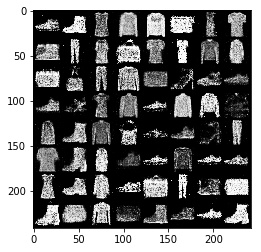

[Epoch 49/50] [Batch 401/938] [D loss: 1.351981] [G loss: 0.919639]
[Epoch 49/50] [Batch 402/938] [D loss: 1.312590] [G loss: 0.874950]
[Epoch 49/50] [Batch 403/938] [D loss: 1.243725] [G loss: 0.894692]
[Epoch 49/50] [Batch 404/938] [D loss: 1.316470] [G loss: 0.932052]
[Epoch 49/50] [Batch 405/938] [D loss: 1.350029] [G loss: 0.893335]
[Epoch 49/50] [Batch 406/938] [D loss: 1.321377] [G loss: 0.878546]
[Epoch 49/50] [Batch 407/938] [D loss: 1.200222] [G loss: 0.978109]
[Epoch 49/50] [Batch 408/938] [D loss: 1.198367] [G loss: 0.969006]
[Epoch 49/50] [Batch 409/938] [D loss: 1.301251] [G loss: 0.923912]
[Epoch 49/50] [Batch 410/938] [D loss: 1.348673] [G loss: 0.957680]
[Epoch 49/50] [Batch 411/938] [D loss: 1.277572] [G loss: 0.869669]
[Epoch 49/50] [Batch 412/938] [D loss: 1.229949] [G loss: 0.949549]
[Epoch 49/50] [Batch 413/938] [D loss: 1.225335] [G loss: 1.047073]
[Epoch 49/50] [Batch 414/938] [D loss: 1.241361] [G loss: 0.895253]
[Epoch 49/50] [Batch 415/938] [D loss: 1.155977]

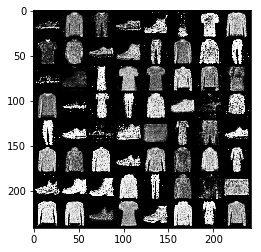

[Epoch 49/50] [Batch 601/938] [D loss: 1.207720] [G loss: 0.916237]
[Epoch 49/50] [Batch 602/938] [D loss: 1.193942] [G loss: 0.877994]
[Epoch 49/50] [Batch 603/938] [D loss: 1.345528] [G loss: 0.843068]
[Epoch 49/50] [Batch 604/938] [D loss: 1.233104] [G loss: 0.925619]
[Epoch 49/50] [Batch 605/938] [D loss: 1.187177] [G loss: 0.886432]
[Epoch 49/50] [Batch 606/938] [D loss: 1.186267] [G loss: 0.871990]
[Epoch 49/50] [Batch 607/938] [D loss: 1.308346] [G loss: 0.902950]
[Epoch 49/50] [Batch 608/938] [D loss: 1.177598] [G loss: 0.939289]
[Epoch 49/50] [Batch 609/938] [D loss: 1.339670] [G loss: 0.853463]
[Epoch 49/50] [Batch 610/938] [D loss: 1.296503] [G loss: 0.862845]
[Epoch 49/50] [Batch 611/938] [D loss: 1.212252] [G loss: 0.900838]
[Epoch 49/50] [Batch 612/938] [D loss: 1.192360] [G loss: 0.895309]
[Epoch 49/50] [Batch 613/938] [D loss: 1.372656] [G loss: 0.882931]
[Epoch 49/50] [Batch 614/938] [D loss: 1.269556] [G loss: 0.913455]
[Epoch 49/50] [Batch 615/938] [D loss: 1.219775]

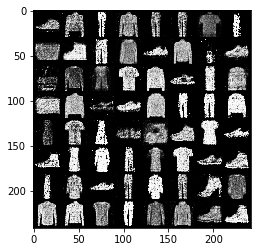

[Epoch 49/50] [Batch 801/938] [D loss: 1.190010] [G loss: 0.917788]
[Epoch 49/50] [Batch 802/938] [D loss: 1.245837] [G loss: 0.942041]
[Epoch 49/50] [Batch 803/938] [D loss: 1.306731] [G loss: 0.938885]
[Epoch 49/50] [Batch 804/938] [D loss: 1.333484] [G loss: 0.903343]
[Epoch 49/50] [Batch 805/938] [D loss: 1.216407] [G loss: 0.983402]
[Epoch 49/50] [Batch 806/938] [D loss: 1.170082] [G loss: 0.983439]
[Epoch 49/50] [Batch 807/938] [D loss: 1.312027] [G loss: 0.900327]
[Epoch 49/50] [Batch 808/938] [D loss: 1.321471] [G loss: 0.837385]
[Epoch 49/50] [Batch 809/938] [D loss: 1.246243] [G loss: 0.926124]
[Epoch 49/50] [Batch 810/938] [D loss: 1.306359] [G loss: 0.873270]
[Epoch 49/50] [Batch 811/938] [D loss: 1.370692] [G loss: 0.786032]
[Epoch 49/50] [Batch 812/938] [D loss: 1.235439] [G loss: 0.886222]
[Epoch 49/50] [Batch 813/938] [D loss: 1.205838] [G loss: 0.910690]
[Epoch 49/50] [Batch 814/938] [D loss: 1.386527] [G loss: 0.916387]
[Epoch 49/50] [Batch 815/938] [D loss: 1.282254]

In [0]:
num_epochs = 50

for epoch in range(num_epochs):
  
  for i, data in enumerate(dataloader, 0): #data -> mini batchs
    
    # ----- Train Descriminator ------
    netD.zero_grad() #Initialise to 0 the Grad of the netD
    

    #Train Descriminator w/ Real Images
    real,_ = data
    input = Variable(real).cuda()
    target = Variable(torch.ones(input.size()[0])).cuda() #real images -> label = 1 
    output = netD(input)
    lossD_real = criterion(output, target)
    
    #Train Descriminator w/ fake Images
    noise = Variable(torch.randn(input.size()[0], 100, 1, 1)).cuda() 
    fake = netG(noise).unsqueeze(1)
    target = Variable(torch.zeros(input.size()[0])).cuda() #fake images -> label = 0
    output = netD(fake.detach())
    lossD_fake = criterion(output, target)
    
    #Descriminator Backpropagation
    lossD = lossD_real + lossD_fake
    lossD.backward()
    optimizerD.step() #Update the weights of the Descriminator
    
    
    # ----- Train Generator ------
    netG.zero_grad() #Initialise to 0 the Grad of the netG
    target = Variable(torch.ones(input.size()[0])).cuda()
    output = netD(fake) #check btw 0 and 1 validity of the generated image
    lossG = criterion(output, target)
    
    #Generator Backpropagation
    lossG.backward()
    optimizerG.step() #Update the weights of the Generator
    
    
    # ----- Visualize the trainning -----   
    print("[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"
            % (epoch, num_epochs, i, len(dataloader), lossD.data, lossG.data))

    
    if i % 200 == 0:
        vutils.save_image(real, '%s/Real_samples.png' % "./results", normalize = True)
        fake = netG(noise).unsqueeze(1).data.cpu()
        vutils.save_image(fake.data, '%s/fake_samples_epoch_%03d_batch_%d.png' % ("./results", epoch,i), normalize=True)
        grid = make_grid(fake, normalize=True).permute(1,2,0).numpy()
        plt.imshow(grid)
        plt.show()   
        
    
        

# Save the Model

In [0]:
# Save trained models
save(netG.state_dict(), './saved_models/netG.weight')
save(netD.state_dict(), './saved_models/netD.weight')

# Load the Model / Test

In [0]:
netG_test = G()
netG_test.load_state_dict(load('./saved_models/netG.weight'))
noise = Variable(torch.randn(input.size()[0], 100, 1, 1))

output_test = netG_test(noise)

for image in output_test:
    image = image.view(28,28).data
    plt.imshow(image, cmap='Greys')
    plt.axis('off')
plt.show()

NameError: ignored